<a href="https://colab.research.google.com/github/deniseiras/Time-Series-Credit-BCB/blob/main/Time_Series_credit_BCB.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Time Series - Predição de inadimplentes da carteira da crédito bcb

https://colab.research.google.com/drive/10kjCcOBwHzkxoH0QqzbWqp5719H1DVVC?usp=sharing

Autor: Denis M. A. Eiras

contato: denis.eiras@gmail.com

Atualizado em: 06/09/2023

**Time series**

A partir da série de inadimplência, disponível em:
https://dadosabertos.bcb.gov.br/dataset/21082-inadimplencia-dacarteira-de-credito---total :
1. Projete a taxa de inadimplência dos próximos 12 meses;
2. Como você defenderia essa projeção? Quais
são, provavelmente, os principais drivers desses valores?

---



# Introdução

Os grandes mercados do sistema financeiro são interligados - qualquer acontecimento
em qualquer um dos mercados afetam indiretamente ou diretamente os outros; mesmos os
eventos internacionais afetam o sistema financeiro brasileiro através da globalização, um exemplo disso é a crise do Subprime que aconteceu nos Estados Unidos em julho de 2007.O sistema financeiro também é muito sensível às decisões políticas e fatores políticos, um exemplo disso é o Plano Real adotado no Brasil na década dos 90, que foi uma decisão política que influenciou bastante no mercado de crédito do Brasil [1].

A Serasa Experian, em janeiro de 2016, apontou que cerca de 59 milhões de
brasileiros começaram o ano na lista de inadimplentes, sendo maior número registrado desde 2012. Segundo os economistas da Serasa Experian, a alta da inadimplência é causada pelo cenário econômico bastante adverso à quitação das dívidas do consumidor: desemprego, taxas de inflação e juros se mantiveram em alta no ano 2015 [1].

Considerando-se a apenas fatores históricos, algumas abordagens tem sido utilizadas para previsão de séries temporais. As metodologias de Redes Neurais Recorrentes (RNNs), recentemente se tornaram uma técnica de previsão viável e poderosa. GRU(Gated Recurrent Unit) e LSTM (Long Short Term Memory) são um tipo de RRN que se adaptam melhor a diferentes séries temporais, ao comparar com uma RNN simples, por serem capazes de guardar mais nuances das séries. GRU geralmente se adaptam melhor para séries mais curtas, enquanto que as LSTM são mais capazes para séries longas [2]. Métodos clássicos de previsão como ARIMA e HWES ainda são populares e poderosos, mas carecem da generalização que modelos baseados em memória como LSTM oferecem. Ainda, estes métodos se aplicam à séries estacionárias e requerem um trabalho de análise e pré-processamento, como a quebra da série em sub séries, o que não é necessário nas RNNs [3].

Na previsão de séries temporais com Machine Learning, existe uma regra geral de que um modelo RNN decente deve sempre ter mais observações do que parâmetros na série temporal. Para a maioria das aplicações de séries temporais, isto significa que os dados submetidos devem ter tantas observações quanto o período da sazonalidade máxima esperada. Por exemplo, se você tiver dados de vendas diárias e espera que eles apresentem sazonalidade anual, deverá ter mais de 365 pontos de dados para treinar um modelo bem-sucedido. No entanto, esse é o número mínimo de pontos necessários para treinar esses tipos de modelos – mais dados são necessários se você quiser testar com eficácia a precisão do desempenho do seu modelo ao fazer previsões [4].

# Metodologia

A série temporal em estudo registra o percentual da carteira de crédito do Sistema Financeiro Nacional com pelo menos uma parcela com atraso superior a 90 dias. Inclui operações contratadas no segmento de crédito livre e no segmento de crédito direcionado. Foram registrados 149 valores mensais entre 01/03/2011 e 01/07/2023.

Devido ao curto tempo de estudo das séries, não serão utilizados modelos estatísticos como ARIMA e ARIMAX, ou a combinação destes com RNNs.

A prévia análise da série em um gráfico mostra que, aparentemente, há uma sazonalidade aproximada a cada 4 ou 5 anos, entre 2011 e 2019, o que sugere a possibilidade de aplicação de uma RNN, apesar da série apresentar mais um período conturbado pelos efeitos da Covid-19, após 2019.

A metodologia consiste em:
1. Análise da série temporal
2. Divisão em base de testes e treinamento
3. Pré-processamento para adequação às arquiteturas RNNs
4. Uso de diferentes arquiteturas RNNs para avaliação sobre a base de avaliação do treinamento
5. Avaliação das melhores arquiteturas sobre a base de testes e escolha das melhores arquiteturas.

Os passos da metodologia são detalhados em cada sub seção.

Os resultados são as predições dos próximos 12 meses utilizando a melhores arquiteturas.



Inicialização de bibliotecas


In [1]:
import numpy as np
from keras.models import Model, Sequential
from keras.layers import LSTM, Input, Dropout, Dense, RepeatVector, TimeDistributed, Conv1D, Flatten, MaxPooling1D, \
  BatchNormalization, Activation, GRU
from keras.regularizers import l2
import tensorflow as tf
import pandas as pd
from matplotlib import pyplot as plt
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import seaborn as sns
from IPython import display as dsp
import sys
from time import time
from datetime import datetime, timedelta
from random import uniform

print('Python version:')
print (sys.version)
print('\nTensorflow version:')
print(tf.__version__)
print('')

# import warnings
# from sklearn import metrics
# import pickle
# import glob
# from google.colab import drive
# warnings.filterwarnings('ignore')

Python version:
3.10.12 (main, Jun 11 2023, 05:26:28) [GCC 11.4.0]

Tensorflow version:
2.12.0



## 1) Análise da série temporal
As série foi copiada para uma pasta púbilica do Dropbox, para evitar mudanças no arquivo fornecido na api



In [2]:
# df_original = pd.read_csv('https://api.bcb.gov.br/dados/serie/bcdata.sgs.21082/dados?formato=csv',  sep=';', decimal=',' , index_col='data')
df_original = pd.read_csv('https://www.dropbox.com/scl/fi/2usyl2f7r2clwlggkoliz/bcdata.sgs.21082.csv?rlkey=0umia8sc3xl2irmlodwa01z9j&dl=1',  sep=';', decimal=',' , index_col='data')
df = df_original

df.index = pd.to_datetime(df.index, format='%d/%m/%Y')
print('Data Inicial: ', df.index.min())
print('Data Final  : ', df.index.max())
print('Tamanho     : ', len(df))
dsp.display(df.describe())

feature='valor'


Data Inicial:  2011-03-01 00:00:00
Data Final  :  2023-07-01 00:00:00
Tamanho     :  149


,valor
count,149.000000
mean,3.143087
std,0.453813
min,2.120000
25%,2.890000
50%,3.120000
75%,3.540000
max,4.040000


## 2) Divisão da base em base de testes e treinamento e visualização

Data Inicial Treino:  2011-03-01 00:00:00
Data Final   Treino:  2022-07-01 00:00:00
Tamanho      Treino:  137

Data Inicial Teste:  2022-08-01 00:00:00
Data Final   Teste:  2023-07-01 00:00:00
Tamanho      Teste:  12


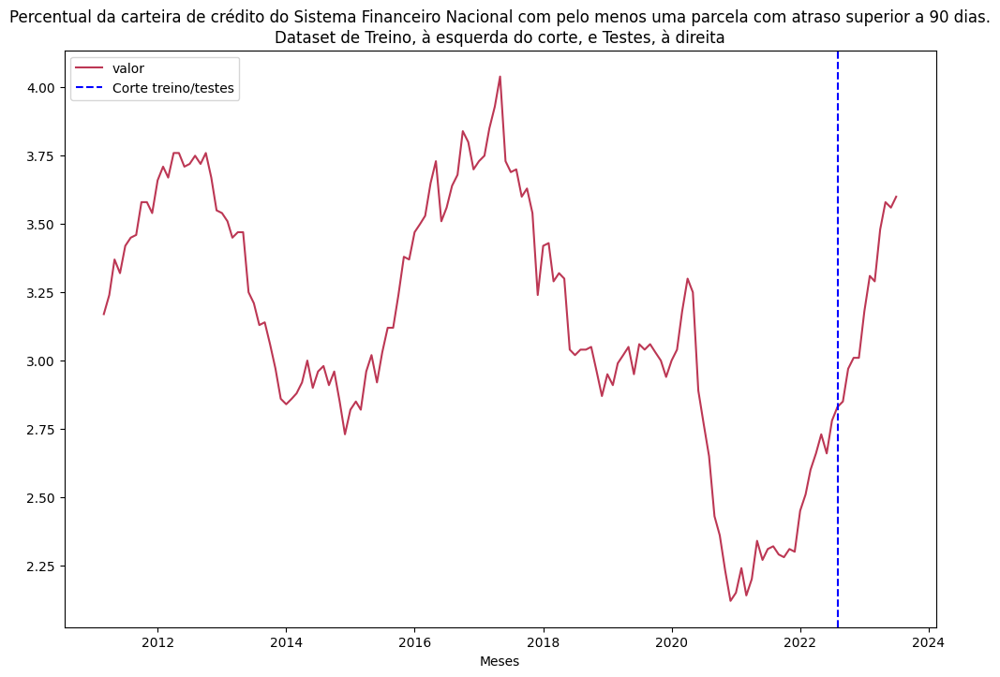

In [3]:
today = datetime.today()

# A base de testes serão os últimos 12 meses
meses_teste = 12
data_corte_treino = df.index[-meses_teste]
data_treino = df.loc[(df.index < data_corte_treino)]
data_teste = df.loc[(df.index >= data_corte_treino)]

print('Data Inicial Treino: ', data_treino.index.min())
print('Data Final   Treino: ', data_treino.index.max())
print('Tamanho      Treino: ', len(data_treino))
print('')

print('Data Inicial Teste: ', data_teste.index.min())
print('Data Final   Teste: ', data_teste.index.max())
print('Tamanho      Teste: ', len(data_teste))

fig, ax = plt.subplots(figsize=(12, 8), nrows=1, ncols=1)
sns.lineplot(data=df, palette='inferno', ax=ax)
plt.axvline(x=data_corte_treino, color='blue', linestyle='--', label='Corte treino/testes', )
ax.set_xlabel('Meses')
ax.set_title('Percentual da carteira de crédito do Sistema Financeiro Nacional com pelo menos uma parcela com atraso superior a 90 dias.\nDataset de Treino, à esquerda do corte, e Testes, à direita')
# ax.set_ylim([0, 80])
plt.legend()

## 3) Pré Processamento
- função preprocess_rnn: usada para transformação da série em subseries de treinamento

In [4]:
def preprocess(dataset, feature, timesteps, TesteLen):
# Função utilizada para transformação da série em subseries:
#
# 1. Uma sequência para treinamento do tamanho Batch Size;
# 2. Um ponto de observação para a sequência de treinamento

    n = len(dataset[[feature]])
    scaler = StandardScaler()
    scaler = scaler.fit(dataset[[feature]])

    df_scal = scaler.transform(dataset[[feature]])
    df_scal = df_scal.reshape(n, 1)

    X = df_scal
    X_samples = list()
    y_samples = list()

    NumerOfRows = len(X)
    for i in range(int(timesteps) , NumerOfRows , 1):
        x_sample = X[i-timesteps:i]
        y_sample = X[i]
        X_samples.append(x_sample)
        y_samples.append(y_sample)

    X_data=np.array(X_samples)
    X_data=X_data.reshape(X_data.shape[0],X_data.shape[1], 1)

    y_data=np.array(y_samples)
    y_data=y_data.reshape(y_data.shape[0], 1)

    # Separando dataset entre treino e teste
    if TesteLen > 0:
      X_train=X_data[:-TesteLen]
      X_test=X_data[-TesteLen:]
      y_train=y_data[:-TesteLen]
      y_test=y_data[-TesteLen:]
    else:
      X_train=X_data
      X_test=[]
      y_train=y_data
      y_test=[]
    return scaler, X_train, X_test, y_train, y_test


def preprocess_CNN1D(dataset, feature, TesteLen):

    n = len(dataset[[feature]])
    scaler = StandardScaler()
    scaler = scaler.fit(dataset[[feature]])

    df_scal = scaler.transform(dataset[[feature]])
    df_scal = df_scal.reshape(n, 1)

    X = np.array(df_scal)
    # Separando dataset entre treino e teste
    if TesteLen > 0:
      X_train = X[:-TesteLen]
      X_test = X[-TesteLen:]
    else:
      X_train = X_train
      X_test = []

    y_train, y_test = X_train, X_test
    X_train = X_train.reshape(X_train.shape[0], 1, 1)
    X_test = X_test.reshape(X_test.shape[0], 1, 1)

    return scaler, X_train, X_test, y_train, y_test

Exemplo de transformação do dataset, utilizando sequência de 10 observações por batch, separando os ultimos len(data_teste) registros como base de testes



In [5]:
timesteps = 6
print('RNN data\n')
scaler, X_train, X_test, y_train, y_test = preprocess(df, feature, timesteps, len(data_teste))
for inp, out in zip(X_train[0:3], y_train[0:2]):
  print(inp,'--', out)

print('\n\nCNN1D data\n')
scaler, X_train, X_test, y_train, y_test = preprocess_CNN1D(df, feature, len(data_teste))
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)
for inp, out in zip(X_train[0:3], y_train[0:2]):
  print(inp,'--', out)

RNN data

[[0.05950369]
 [0.21427264]
 [0.50170069]
 [0.39115144]
 [0.61224994]
 [0.67857949]] -- [0.70068934]
[[0.21427264]
 [0.50170069]
 [0.39115144]
 [0.61224994]
 [0.67857949]
 [0.70068934]] -- [0.96600754]


CNN1D data

(137, 1, 1) (12, 1, 1) (137, 1) (12, 1)
[[0.05950369]] -- [0.05950369]
[[0.21427264]] -- [0.21427264]


## 4) Construção dos modelos RNN

Para desenvolvimento do projeto foram testados os modelos LSTM e GRU abaixo.

O modelo GRU foi testada uma arquitetura simples, enquanto que os LSTMS foram avaliadas arquiteturas com regularização e dropouts para evitar o overfitting e curvas tendenciosas ao usar o modelo iterativamente

In [6]:
def GRU_v1(unit, optimizer, timesteps, X, y, epochs, batch_size, patience):

  mod = Sequential()
  mod.add(GRU(unit, input_shape=(timesteps, 1)))
  mod.add(Dense(1, activation='linear'))
  return mod


def LSTM_v1(unit, optimizer, timesteps, X, y, epochs, batch_size, patience):

    mod = Sequential()
    mod.add(LSTM(int(unit), activation='relu', input_shape=(timesteps, 1), return_sequences=False))
    mod.add(Dense(1, activation='linear'))
    return mod


def LSTM_v2(unit, optimizer, timesteps, X, y, epochs, batch_size, patience, l2_reg=0.001):

    mod = Sequential()
    mod.add(LSTM(int(unit), activation='relu', input_shape=(timesteps, 1), kernel_regularizer=l2(l2_reg),
                 return_sequences=False))
    mod.add(Dense(1, activation='linear'))
    return mod


def LSTM_v3(unit, optimizer, timesteps, X, y, epochs, batch_size, patience, dropout_rate=0.3, l2_reg=0.001):

    mod = Sequential()
    mod.add(LSTM(int(unit), activation='relu', input_shape=(timesteps, 1), kernel_regularizer=l2(l2_reg),
                 return_sequences=False))
    mod.add(Dropout(dropout_rate))
    mod.add(Dense(1, activation='linear'))
    return mod


def model_type(mod_type, unit, optimizer, timesteps, X, y, epochs=60, batch_size=32, patience=20, train=True):
  func = globals()[mod_type]
  mod = func(unit, optimizer, timesteps, X, y, epochs, batch_size, patience)
  hist = None
  if train:
    mod, hist = train_model(mod, optimizer, X, y, batch_size, patience, epochs)
  return mod, hist


def train_model(mod, optimizer, X, y, batch_size, patience, epochs):

  callback = tf.keras.callbacks.EarlyStopping(monitor='val_mean_absolute_error', patience=patience, mode='min',
                                              restore_best_weights=True)

  # only Adam implemented
  if optimizer == 'Adam':
    adam = tf.keras.optimizers.Adam()
    mod.compile(loss=tf.losses.MeanSquaredError(),optimizer=adam, metrics=[tf.metrics.MeanAbsoluteError()])

  hist = mod.fit(X, y, batch_size=batch_size, epochs=epochs, validation_split=0.1, callbacks=[callback], verbose=0,
                  shuffle=False)

  loss_metric_train = mod.evaluate(X, y, verbose=0, batch_size=batch_size, use_multiprocessing=True)
  dsp.display( 'TRAINING set. Loss = {} , MAE = {}'.format(loss_metric_train[0], loss_metric_train[1]))

  plt.figure(figsize=(3,3))
  plt.xlabel('Epochs')
  plt.ylabel('Loss')
  plt.plot(hist.history['loss'], label='Loss Treino')
  plt.plot(hist.history['val_loss'], label='Loss Validação')
  plt.plot(hist.history['mean_absolute_error'], label='MAE Treino')
  plt.ylim([0.0, 2])
  plt.xlim([0.0, epochs])
  plt.legend()
  plt.show()

  return mod, hist

### Treinamento e Hiperparâmetrização

A metodologia de escolha de melhor modelo consiste em variar modelos e parâmetros das RNNs e testar na base de testes. Os treinamentos serão executados 3 vezes para cada combinanação, e uma média sobre o MAE será feita. A melhor combinação de modelos e parâmetros, em razão da média calculada, determinará o melhor modelo.

Parâmetros variados

1. Modelos
2. Timesteps (tamanho da subséries de treinamento): será de semestres, anuais e bianuais, para encontrar padrões das sazonalidades
3. Numéro de Neurônios nas camadas ocultas
4. Batch size


X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=6, units=4, batch=4


'TRAINING set. Loss = 0.12677764892578125 , MAE = 0.2713703215122223'

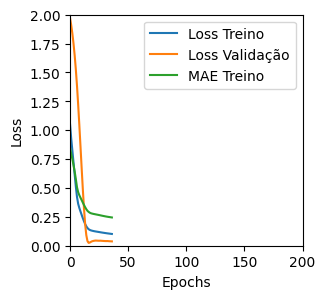

Tempo de treino: 0.24377569754918416 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v1 , timesteps=6, units=4, batch=8


'TRAINING set. Loss = 0.12370863556861877 , MAE = 0.2734244763851166'

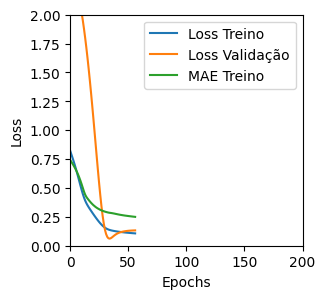

Tempo de treino: 0.40830657482147215 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3246636986732483 , MAE = 0.3824338912963867'

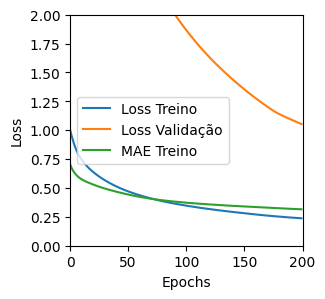

Tempo de treino: 0.22984553178151448 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5605499148368835 , MAE = 0.5815151929855347'

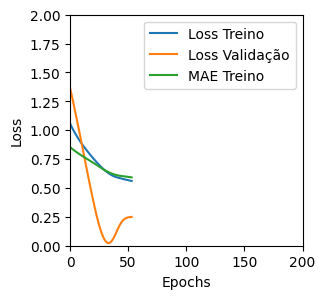

Tempo de treino: 0.0880201816558838 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1402643769979477 , MAE = 0.2822650372982025'

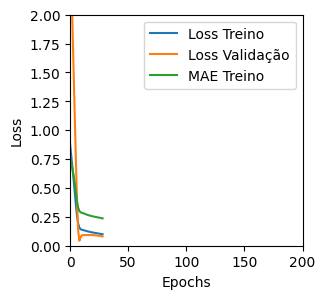

Tempo de treino: 0.11720834573109945 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32379150390625 , MAE = 0.4426262378692627'

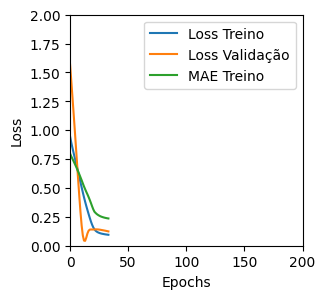

Tempo de treino: 0.09456615845362346 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15587452054023743 , MAE = 0.31908971071243286'

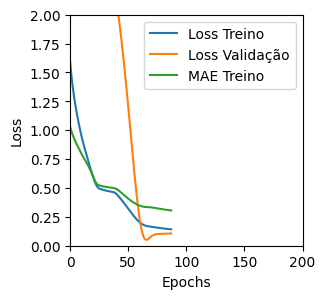

Tempo de treino: 0.20099494059880574 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15531501173973083 , MAE = 0.3103541433811188'

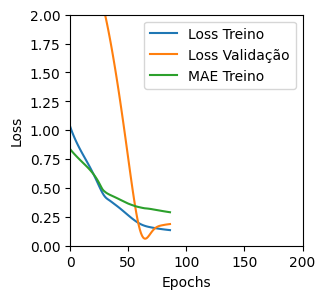

Tempo de treino: 0.09670325517654418 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22615733742713928 , MAE = 0.3734859228134155'

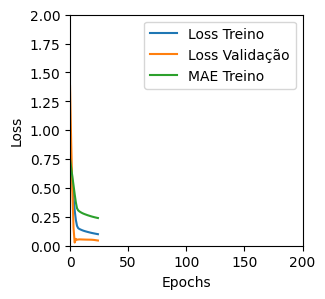

Tempo de treino: 0.1156762957572937 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.156316339969635 , MAE = 0.30336806178092957'

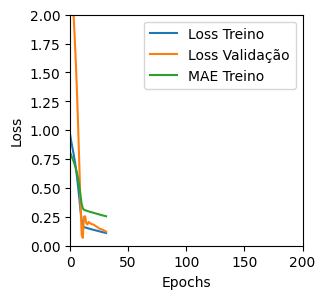

Tempo de treino: 0.11593174934387207 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16146071255207062 , MAE = 0.29856470227241516'

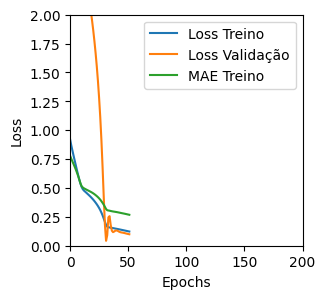

Tempo de treino: 0.12352114915847778 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.131553515791893 , MAE = 0.2731836438179016'

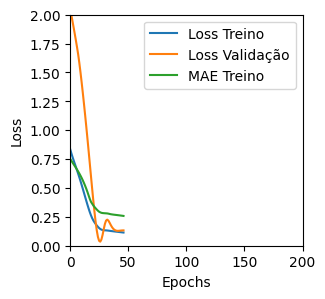

Tempo de treino: 0.0714367945988973 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07454811781644821 , MAE = 0.22709989547729492'

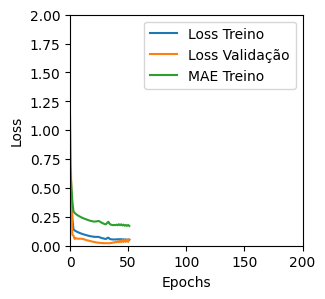

Tempo de treino: 0.173491104443868 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16681203246116638 , MAE = 0.3103824555873871'

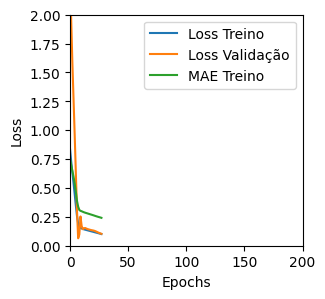

Tempo de treino: 0.12605344851811726 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32753434777259827 , MAE = 0.44397640228271484'

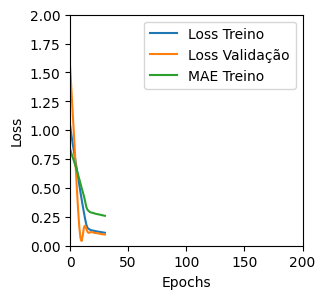

Tempo de treino: 0.07163527806599936 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15473361313343048 , MAE = 0.29344838857650757'

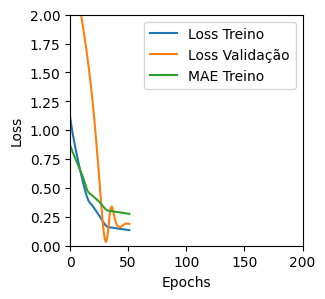

Tempo de treino: 0.11424606243769328 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.051429033279418945 , MAE = 0.18159893155097961'

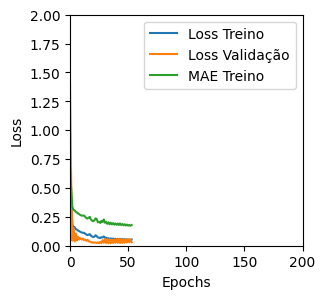

Tempo de treino: 0.2048201322555542 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1384940892457962 , MAE = 0.2838227450847626'

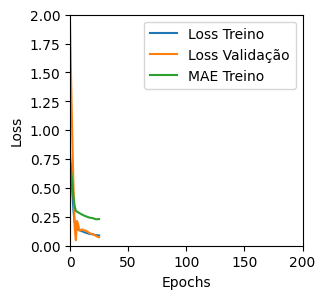

Tempo de treino: 0.1175362745920817 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14325463771820068 , MAE = 0.29004281759262085'

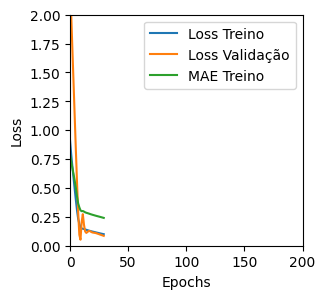

Tempo de treino: 0.11693837245305379 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14977693557739258 , MAE = 0.2888021767139435'

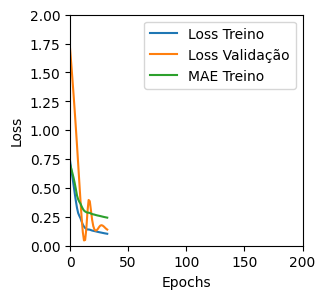

Tempo de treino: 0.08616803089777629 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4914097785949707 , MAE = 0.5402749180793762'

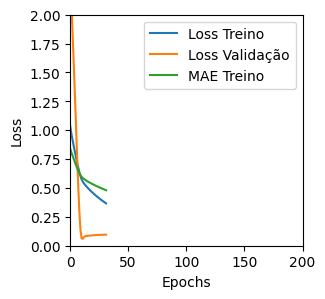

Tempo de treino: 0.20445441007614135 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14320659637451172 , MAE = 0.2831684648990631'

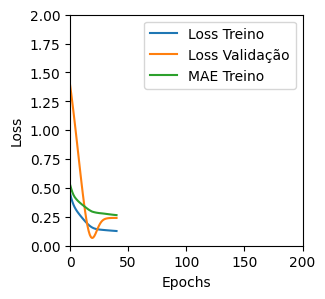

Tempo de treino: 0.10427019198735556 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15966655313968658 , MAE = 0.2936384081840515'

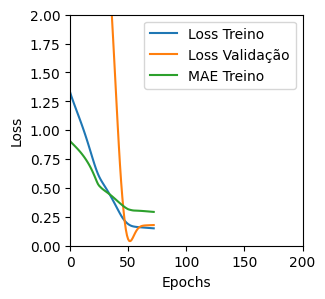

Tempo de treino: 0.1023369828859965 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14358973503112793 , MAE = 0.28135985136032104'

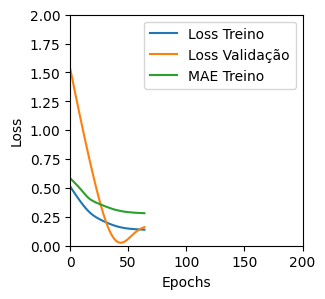

Tempo de treino: 0.115061883131663 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13878385722637177 , MAE = 0.2791183292865753'

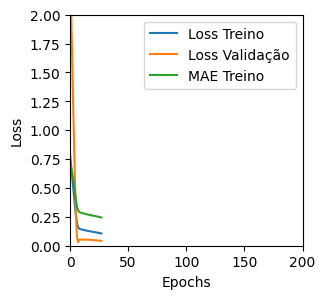

Tempo de treino: 0.11677631537119547 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11791511625051498 , MAE = 0.2610417306423187'

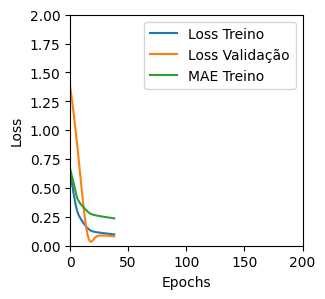

Tempo de treino: 0.10633469820022583 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3144983649253845 , MAE = 0.43916040658950806'

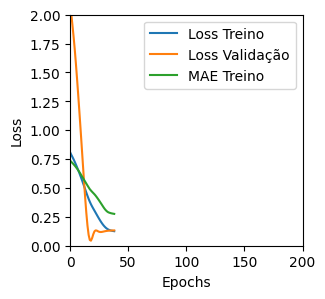

Tempo de treino: 0.0830405871073405 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1770726889371872 , MAE = 0.30560019612312317'

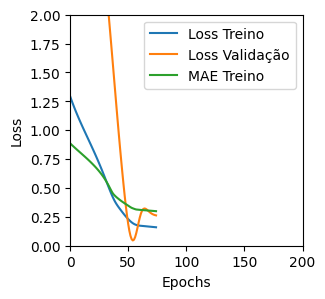

Tempo de treino: 0.10043960412343343 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15409237146377563 , MAE = 0.29318681359291077'

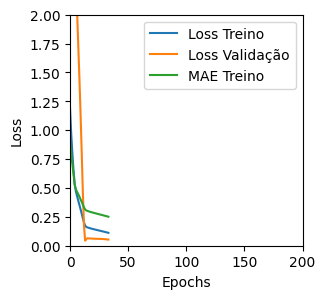

Tempo de treino: 0.20476079384485882 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14671377837657928 , MAE = 0.2844066619873047'

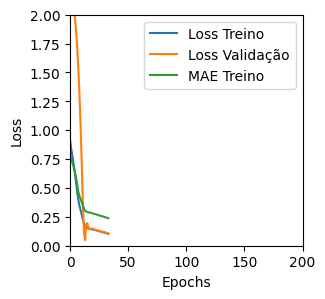

Tempo de treino: 0.09638445774714152 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12973088026046753 , MAE = 0.2650337815284729'

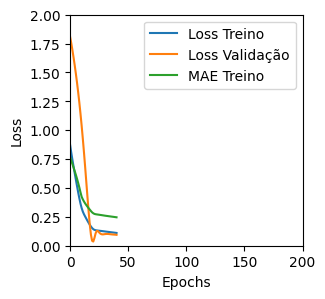

Tempo de treino: 0.09428953329722087 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16074824333190918 , MAE = 0.3030158579349518'

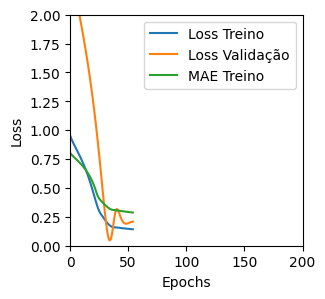

Tempo de treino: 0.08192468086878459 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05518574267625809 , MAE = 0.18665078282356262'

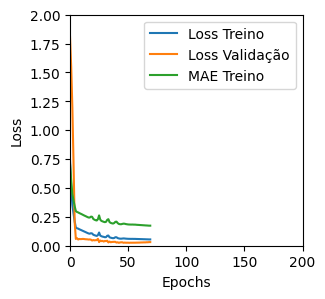

Tempo de treino: 0.2556850671768188 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14229696989059448 , MAE = 0.28300878405570984'

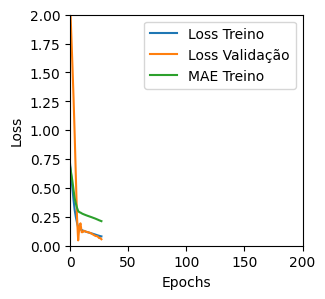

Tempo de treino: 0.12874176104863486 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1485074907541275 , MAE = 0.288328617811203'

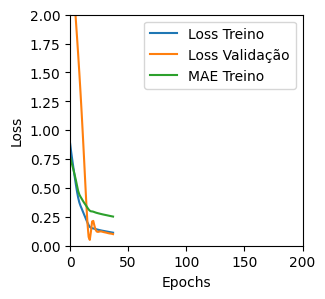

Tempo de treino: 0.08741988738377889 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1437515765428543 , MAE = 0.2842988073825836'

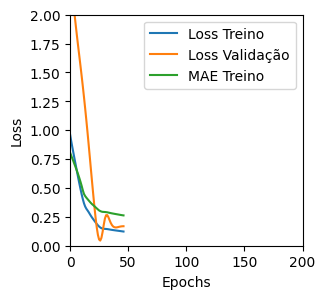

Tempo de treino: 0.08404789368311565 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07443532347679138 , MAE = 0.22342871129512787'

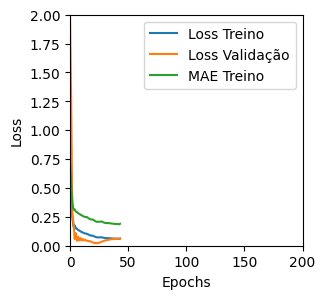

Tempo de treino: 0.20381789207458495 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06558631360530853 , MAE = 0.18425185978412628'

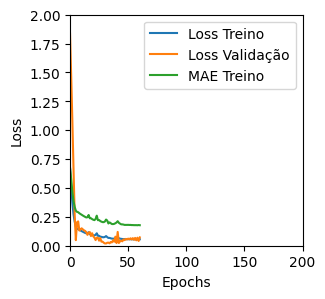

Tempo de treino: 0.20355925957361856 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0702231153845787 , MAE = 0.19624896347522736'

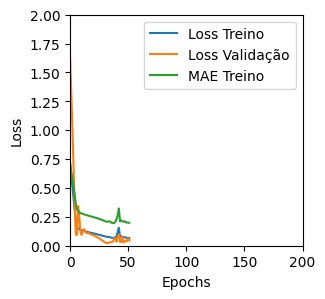

Tempo de treino: 0.0929153323173523 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14771778881549835 , MAE = 0.2896532416343689'

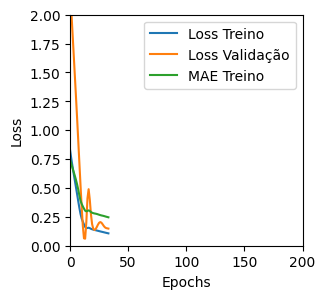

Tempo de treino: 0.10901075998942057 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=6, units=4, batch=4


'TRAINING set. Loss = 0.392405241727829 , MAE = 0.44161558151245117'

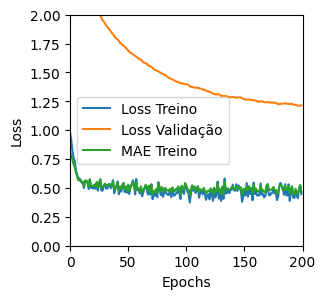

Tempo de treino: 0.7196000059445699 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19057020545005798 , MAE = 0.3398594856262207'

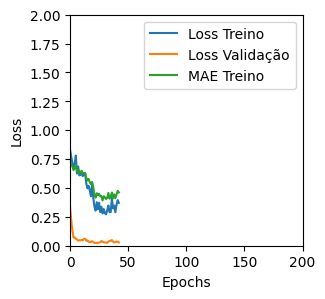

Tempo de treino: 0.12785656452178956 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14516036212444305 , MAE = 0.2940659523010254'

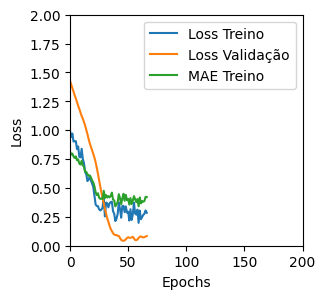

Tempo de treino: 0.20285800298055012 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5857753157615662 , MAE = 0.5634973645210266'

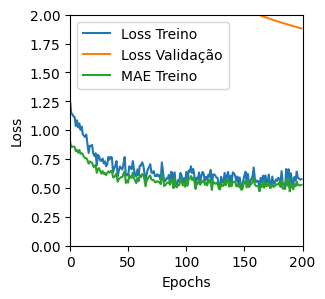

Tempo de treino: 0.20428223609924318 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15962059795856476 , MAE = 0.307979017496109'

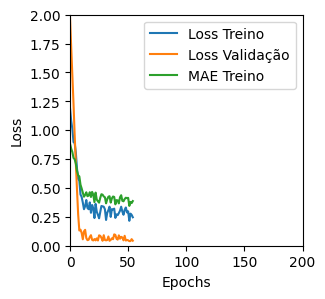

Tempo de treino: 0.203109876314799 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17741312086582184 , MAE = 0.31697332859039307'

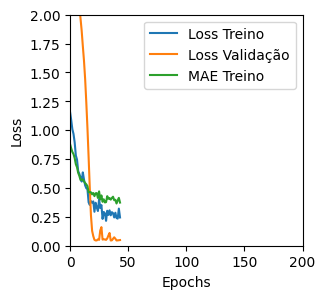

Tempo de treino: 0.13519630034764607 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38853567838668823 , MAE = 0.4289616346359253'

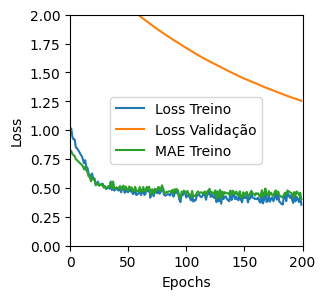

Tempo de treino: 0.3793088356653849 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18213693797588348 , MAE = 0.31976255774497986'

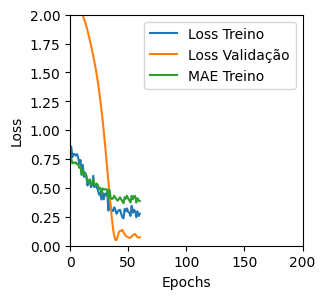

Tempo de treino: 0.12262656291325887 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07471051067113876 , MAE = 0.2074979692697525'

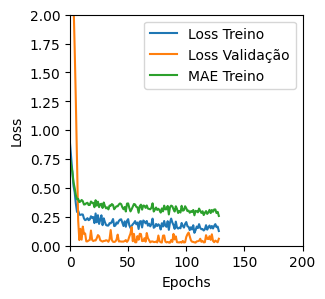

Tempo de treino: 0.37566059827804565 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08769727498292923 , MAE = 0.2131432294845581'

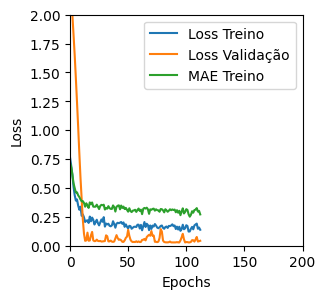

Tempo de treino: 0.2197708527247111 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10742568969726562 , MAE = 0.2418692260980606'

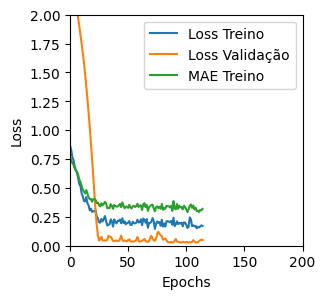

Tempo de treino: 0.20333250363667807 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14802038669586182 , MAE = 0.2922070622444153'

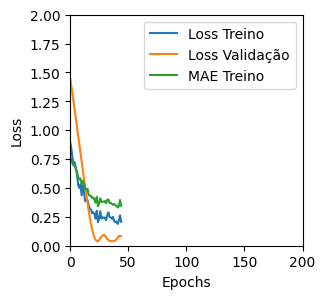

Tempo de treino: 0.07196239233016968 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06152516230940819 , MAE = 0.1894170492887497'

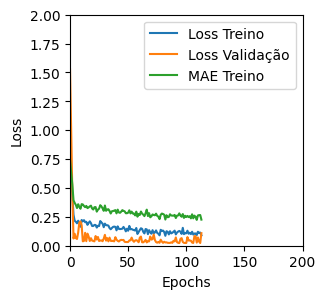

Tempo de treino: 0.35957733790079754 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.059283871203660965 , MAE = 0.185587078332901'

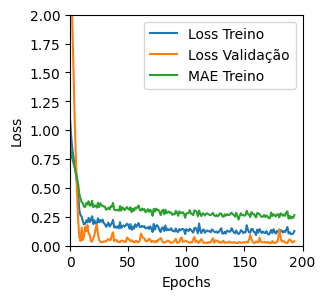

Tempo de treino: 0.367305068174998 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14777860045433044 , MAE = 0.29092058539390564'

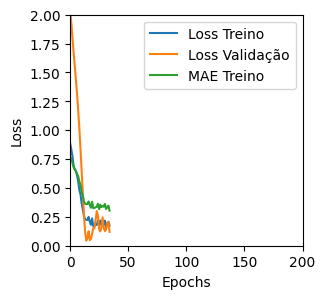

Tempo de treino: 0.07397408882776896 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3564670979976654 , MAE = 0.46077919006347656'

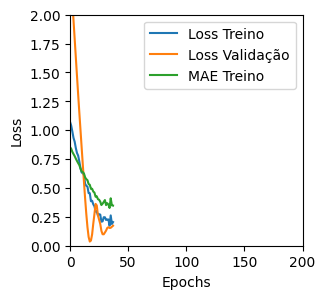

Tempo de treino: 0.08143282731374105 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05068599432706833 , MAE = 0.16672690212726593'

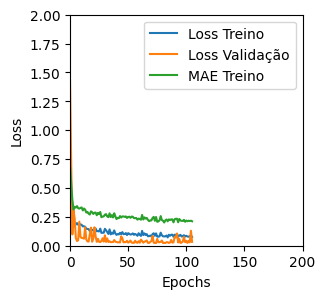

Tempo de treino: 0.32578306992848716 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06333065032958984 , MAE = 0.19115453958511353'

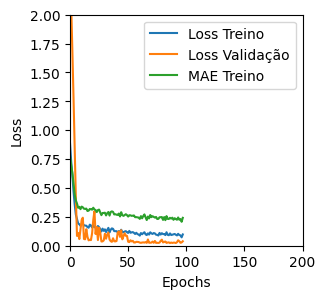

Tempo de treino: 0.37388859589894613 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1270221471786499 , MAE = 0.26843196153640747'

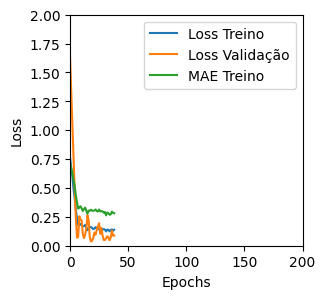

Tempo de treino: 0.10456792910893759 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15159182250499725 , MAE = 0.2921178638935089'

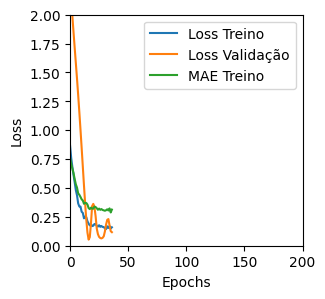

Tempo de treino: 0.08240754206975301 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com GRU_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.043640103191137314 , MAE = 0.1614559441804886'

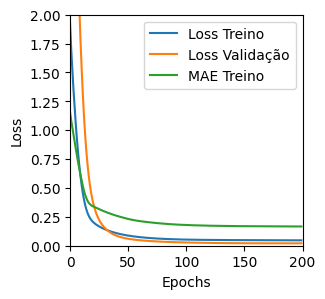

Tempo de treino: 0.7311645825703939 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04545293375849724 , MAE = 0.16400372982025146'

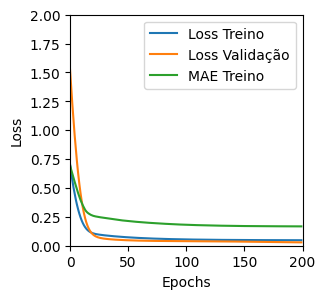

Tempo de treino: 0.3968717296918233 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048818137496709824 , MAE = 0.17061087489128113'

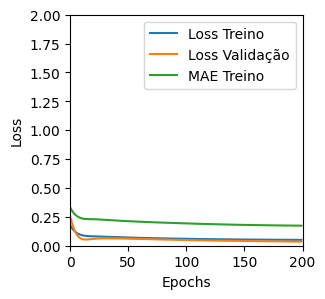

Tempo de treino: 0.2890466054280599 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04979631304740906 , MAE = 0.1755247265100479'

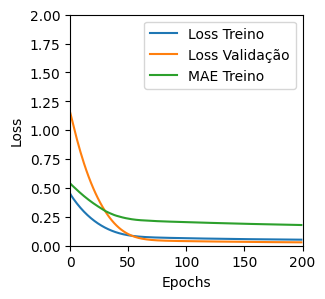

Tempo de treino: 0.39954163630803424 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04360010474920273 , MAE = 0.1604081392288208'

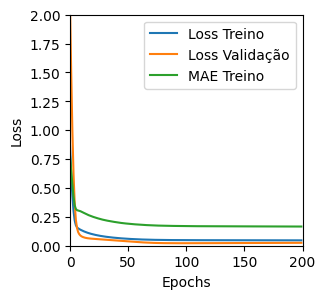

Tempo de treino: 0.7284036795298259 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042870234698057175 , MAE = 0.157805398106575'

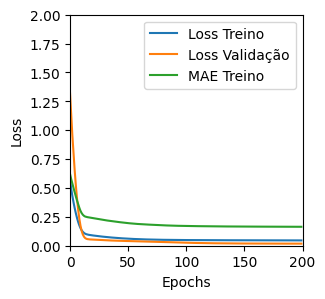

Tempo de treino: 0.4101026773452759 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.046359460800886154 , MAE = 0.16709774732589722'

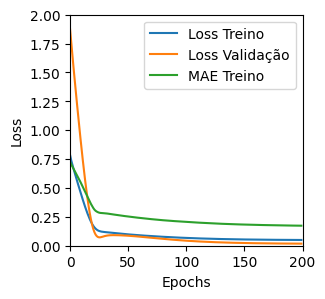

Tempo de treino: 0.39473555485407513 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12219114601612091 , MAE = 0.28235405683517456'

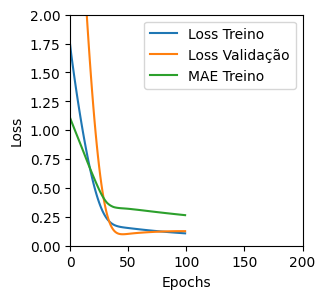

Tempo de treino: 0.16435564359029134 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04693997651338577 , MAE = 0.16837210953235626'

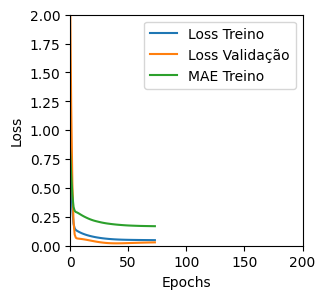

Tempo de treino: 0.26164225737253827 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.043967265635728836 , MAE = 0.16001135110855103'

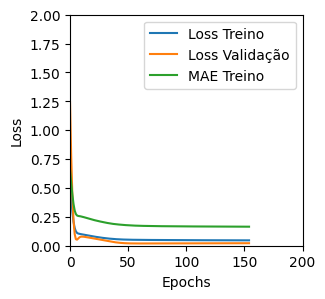

Tempo de treino: 0.395660130182902 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10288704186677933 , MAE = 0.25662997364997864'

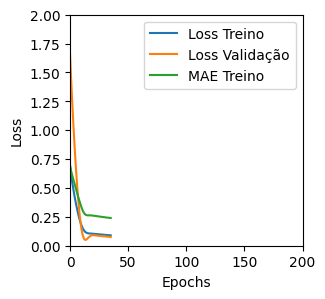

Tempo de treino: 0.1091323455174764 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.046251047402620316 , MAE = 0.1675146073102951'

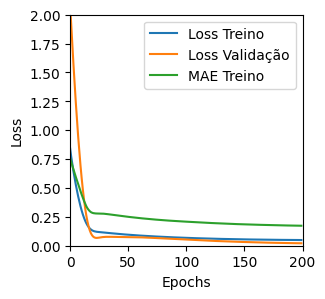

Tempo de treino: 0.40047462383906046 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05069742351770401 , MAE = 0.1760990172624588'

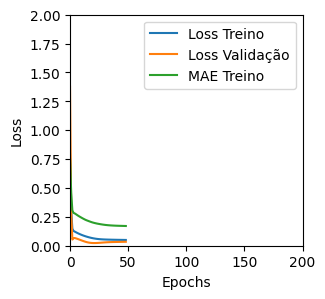

Tempo de treino: 0.19856292009353638 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04689841344952583 , MAE = 0.16595828533172607'

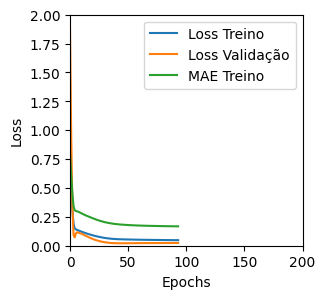

Tempo de treino: 0.3848514715830485 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12723501026630402 , MAE = 0.2824724614620209'

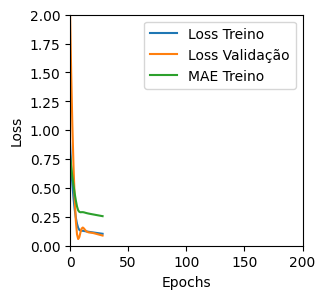

Tempo de treino: 0.08925330638885498 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10198706388473511 , MAE = 0.24983856081962585'

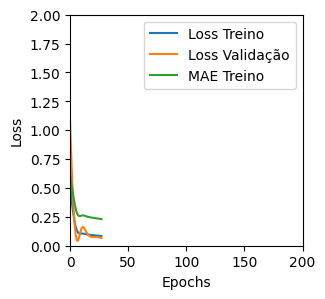

Tempo de treino: 0.08912203311920167 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0777035653591156 , MAE = 0.21643148362636566'

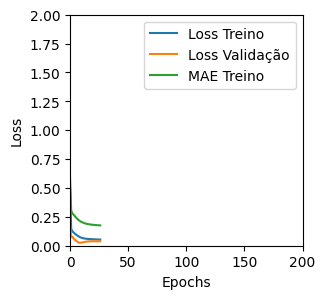

Tempo de treino: 0.14878273010253906 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048467013984918594 , MAE = 0.1693698763847351'

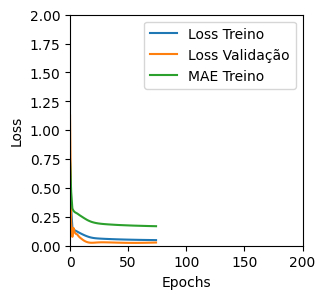

Tempo de treino: 0.2233000675837199 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05321982875466347 , MAE = 0.17979560792446136'

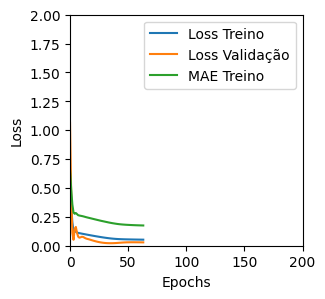

Tempo de treino: 0.1379287083943685 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07695314288139343 , MAE = 0.21802234649658203'

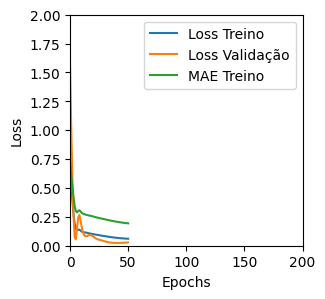

Tempo de treino: 0.12727386156717937 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07347140461206436 , MAE = 0.2074301838874817'

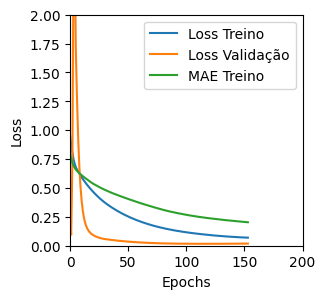

Tempo de treino: 0.41760220925013225 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3711828589439392 , MAE = 0.47965937852859497'

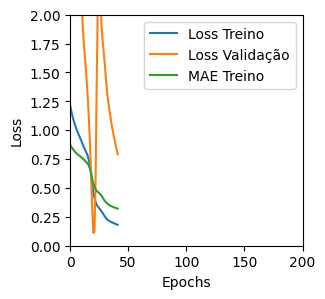

Tempo de treino: 0.0941788911819458 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2012825310230255 , MAE = 0.361070841550827'

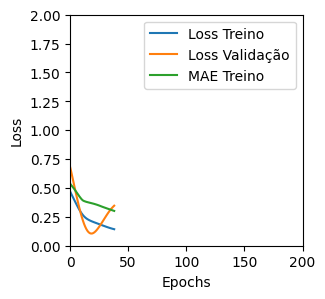

Tempo de treino: 0.11292136510213216 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35916900634765625 , MAE = 0.4700150787830353'

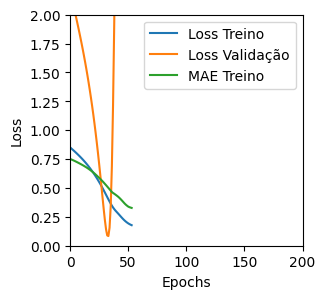

Tempo de treino: 0.08831528822580974 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05557667091488838 , MAE = 0.17745530605316162'

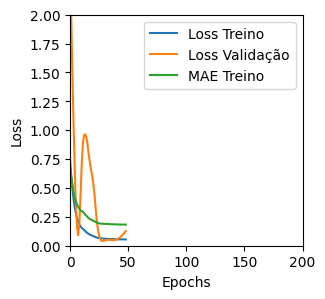

Tempo de treino: 0.19944667021433513 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17362141609191895 , MAE = 0.3068874478340149'

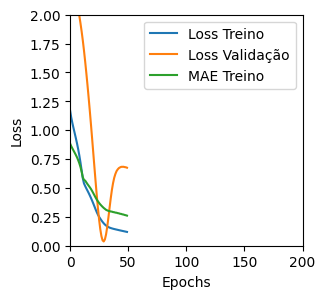

Tempo de treino: 0.11516077518463134 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4444752037525177 , MAE = 0.5124461650848389'

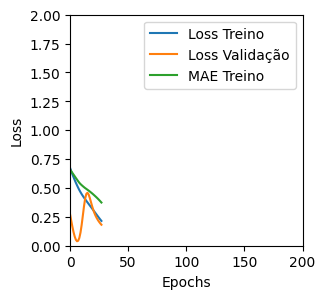

Tempo de treino: 0.06880503098169963 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14490768313407898 , MAE = 0.28182145953178406'

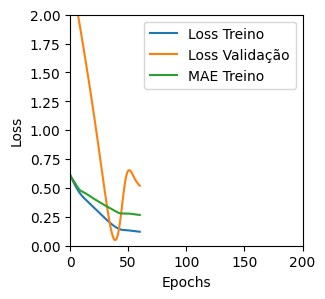

Tempo de treino: 0.13180445830027263 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21237528324127197 , MAE = 0.3424495756626129'

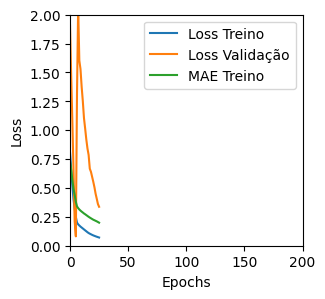

Tempo de treino: 0.09385458628336589 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21596434712409973 , MAE = 0.34561192989349365'

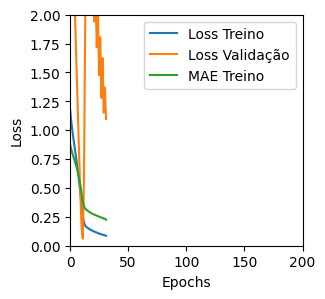

Tempo de treino: 0.11284233331680298 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18834014236927032 , MAE = 0.33059972524642944'

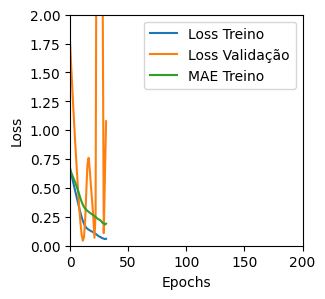

Tempo de treino: 0.06270373264948527 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27448564767837524 , MAE = 0.4103173613548279'

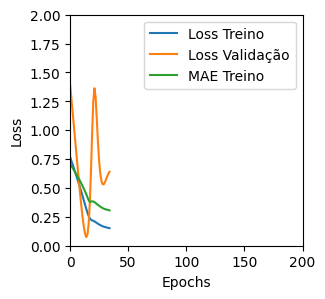

Tempo de treino: 0.07449312607447306 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.299179345369339 , MAE = 0.41996636986732483'

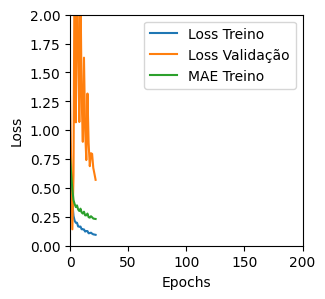

Tempo de treino: 0.10524012247721354 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2840815484523773 , MAE = 0.40599241852760315'

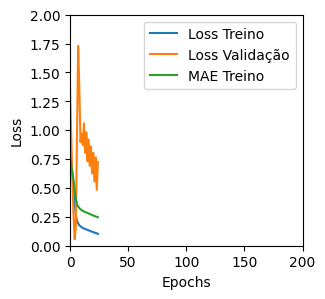

Tempo de treino: 0.11449910402297973 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23026008903980255 , MAE = 0.350286602973938'

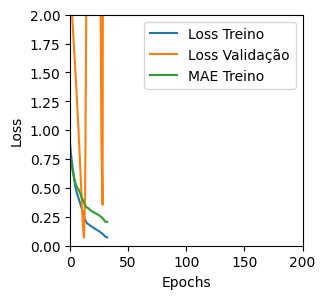

Tempo de treino: 0.11894212563832601 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4017113745212555 , MAE = 0.4904814064502716'

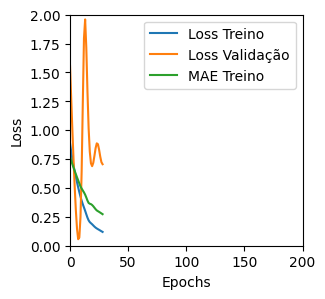

Tempo de treino: 0.07001699209213257 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07286150008440018 , MAE = 0.20087088644504547'

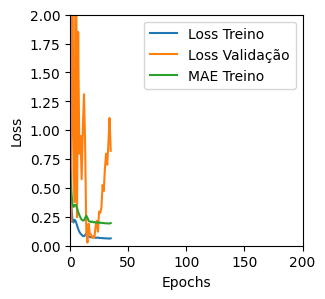

Tempo de treino: 0.14674082199732463 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23385587334632874 , MAE = 0.36666998267173767'

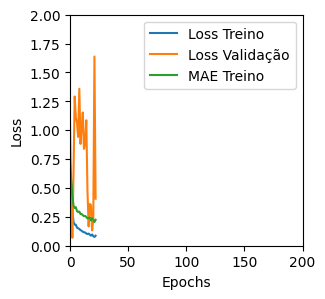

Tempo de treino: 0.08099085887273152 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29096680879592896 , MAE = 0.41991809010505676'

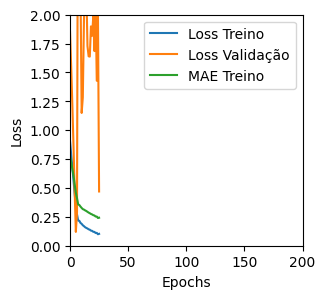

Tempo de treino: 0.07595884799957275 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19289767742156982 , MAE = 0.32448872923851013'

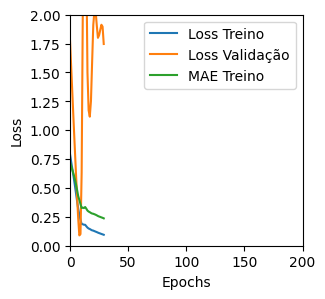

Tempo de treino: 0.074769393603007 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20356716215610504 , MAE = 0.3117855191230774'

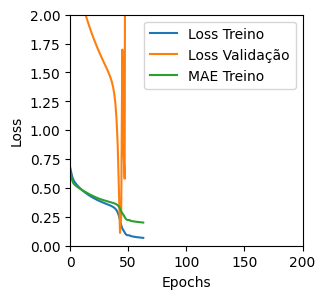

Tempo de treino: 0.19777470032374064 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04081375151872635 , MAE = 0.15133695304393768'

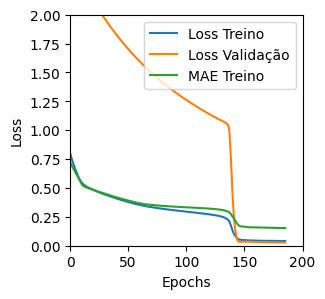

Tempo de treino: 0.3258380929629008 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4569531977176666 , MAE = 0.5568177103996277'

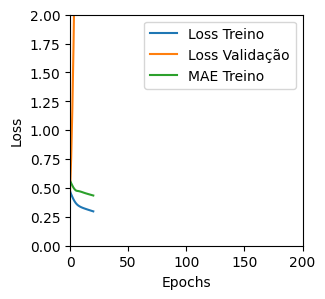

Tempo de treino: 0.07200375398000082 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2130453735589981 , MAE = 0.3572286367416382'

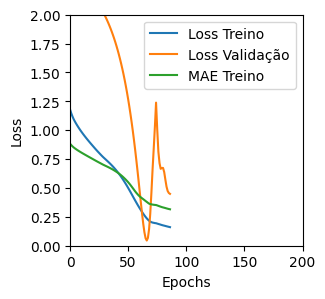

Tempo de treino: 0.2071107268333435 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2753599286079407 , MAE = 0.39345407485961914'

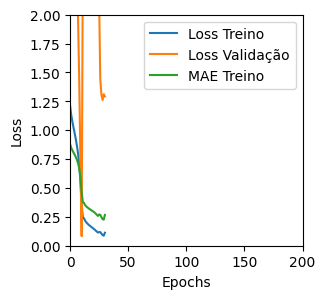

Tempo de treino: 0.12302188475926717 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.44246041774749756 , MAE = 0.5274658203125'

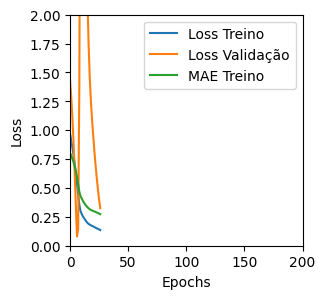

Tempo de treino: 0.11462749640146891 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5541117191314697 , MAE = 0.5758765339851379'

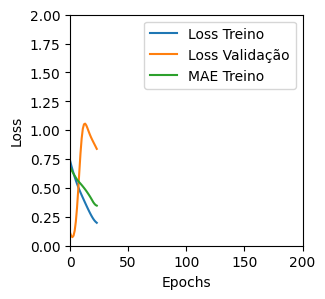

Tempo de treino: 0.07057370742162068 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22252872586250305 , MAE = 0.34319666028022766'

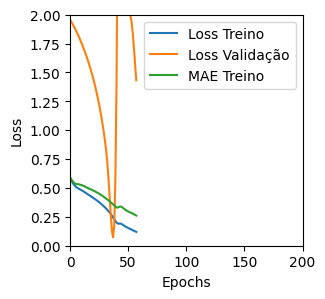

Tempo de treino: 0.08981529474258423 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06914032250642776 , MAE = 0.19005121290683746'

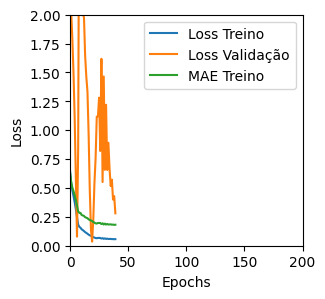

Tempo de treino: 0.19832863410313925 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.053290992975234985 , MAE = 0.17244108021259308'

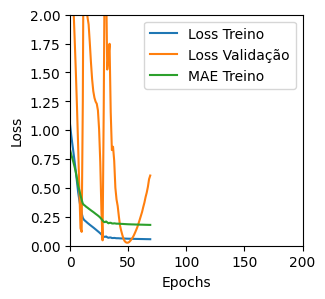

Tempo de treino: 0.17431069215138753 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2995871305465698 , MAE = 0.4271141290664673'

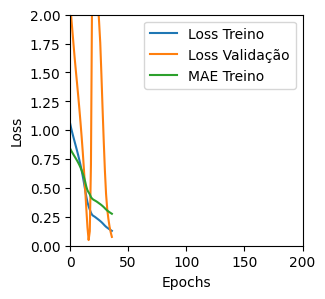

Tempo de treino: 0.11920892000198365 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2474404275417328 , MAE = 0.34660157561302185'

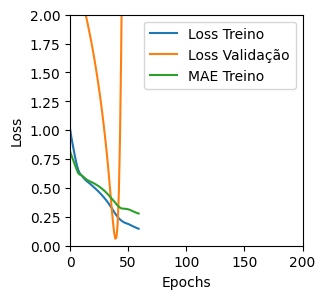

Tempo de treino: 0.12591246763865152 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07476548850536346 , MAE = 0.20120908319950104'

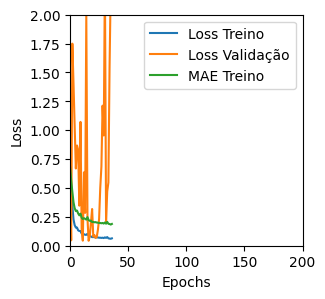

Tempo de treino: 0.13726673126220704 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22315330803394318 , MAE = 0.3574048578739166'

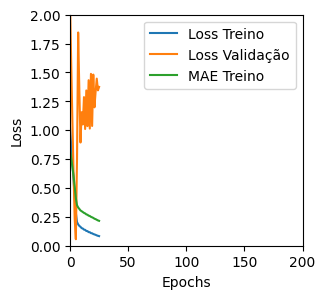

Tempo de treino: 0.1133161743481954 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37149778008461 , MAE = 0.4725492000579834'

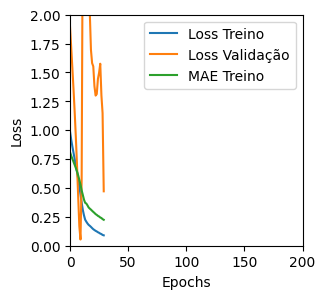

Tempo de treino: 0.07794160048166911 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27482831478118896 , MAE = 0.39150455594062805'

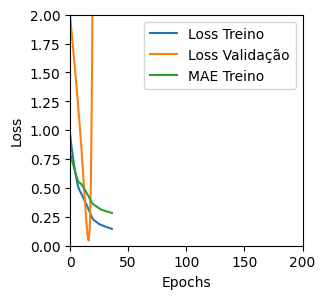

Tempo de treino: 0.07346946398417155 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07109874486923218 , MAE = 0.19504278898239136'

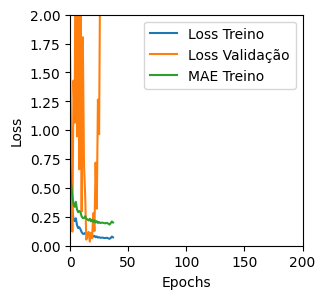

Tempo de treino: 0.15666147073109946 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0953579768538475 , MAE = 0.22459807991981506'

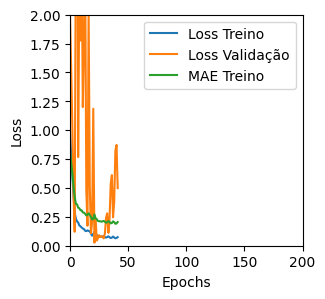

Tempo de treino: 0.21704505681991576 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.108048215508461 , MAE = 0.24424214661121368'

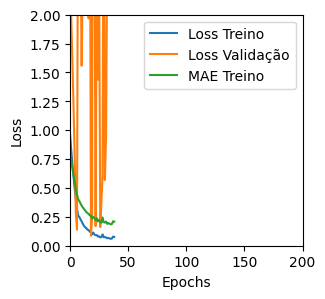

Tempo de treino: 0.11825788021087646 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2811320722103119 , MAE = 0.40616437792778015'

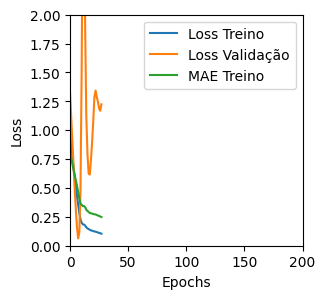

Tempo de treino: 0.07902698914210002 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18124166131019592 , MAE = 0.3288760781288147'

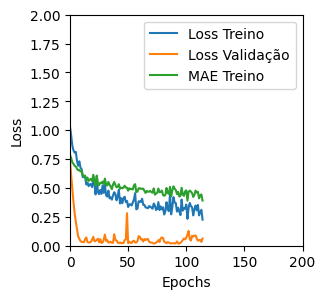

Tempo de treino: 0.2874630053838094 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16457630693912506 , MAE = 0.31559425592422485'

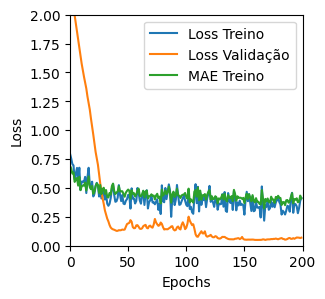

Tempo de treino: 0.37309192021687826 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7530856728553772 , MAE = 0.6925998330116272'

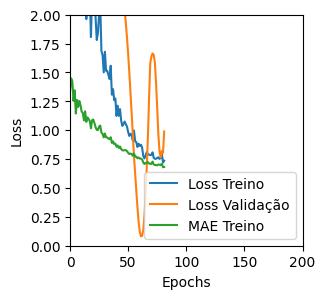

Tempo de treino: 0.1115012526512146 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.1034823656082153 , MAE = 0.8578317761421204'

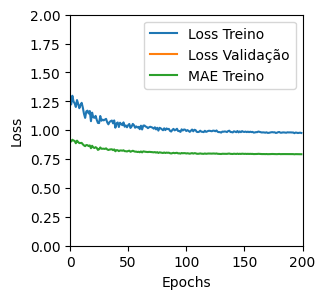

Tempo de treino: 0.2654380520184835 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07775260508060455 , MAE = 0.21385203301906586'

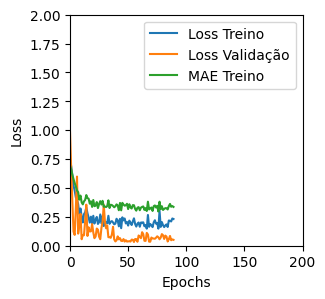

Tempo de treino: 0.39359257618586224 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14737369120121002 , MAE = 0.2848690152168274'

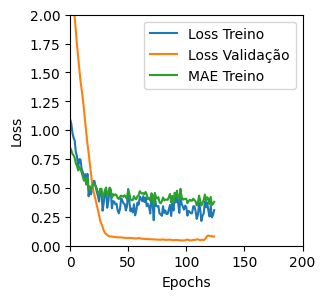

Tempo de treino: 0.3760268727938334 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3630110025405884 , MAE = 0.4742833971977234'

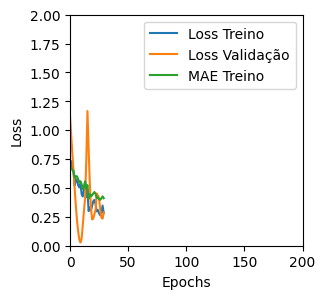

Tempo de treino: 0.07335973978042602 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.566784143447876 , MAE = 0.5856086611747742'

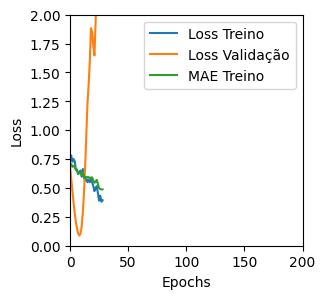

Tempo de treino: 0.06581081549326578 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28154298663139343 , MAE = 0.38659045100212097'

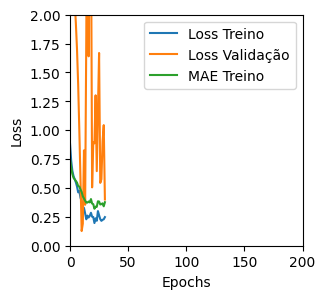

Tempo de treino: 0.10122944116592407 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22205078601837158 , MAE = 0.3419867753982544'

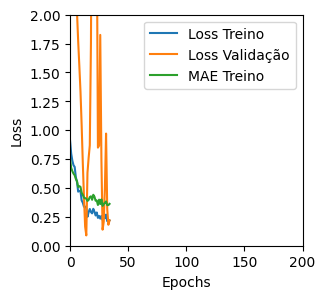

Tempo de treino: 0.11316224336624145 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2393532693386078 , MAE = 0.34573161602020264'

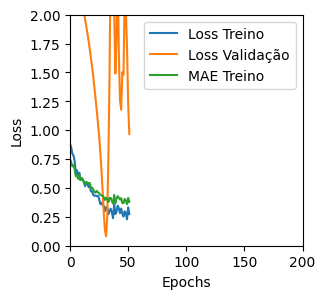

Tempo de treino: 0.07179412841796876 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2982276678085327 , MAE = 0.400240957736969'

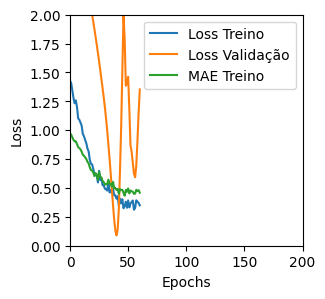

Tempo de treino: 0.09592180649439494 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0781702846288681 , MAE = 0.20653139054775238'

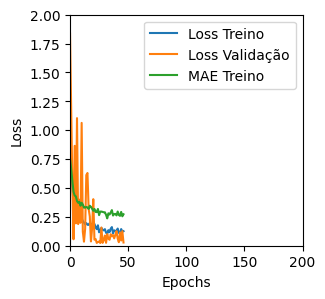

Tempo de treino: 0.15078362226486205 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20346970856189728 , MAE = 0.32864582538604736'

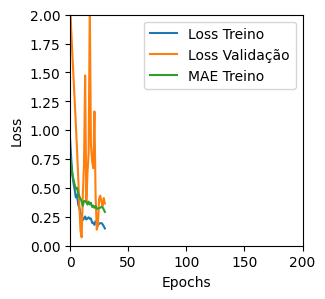

Tempo de treino: 0.11445460319519044 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2657921314239502 , MAE = 0.38719016313552856'

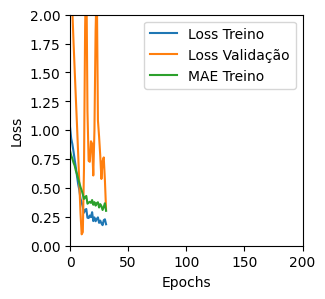

Tempo de treino: 0.06956311066945393 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21715600788593292 , MAE = 0.35361796617507935'

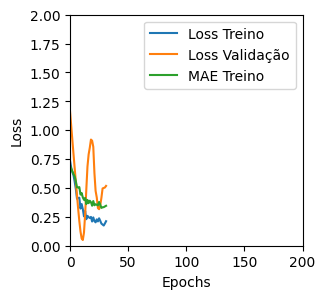

Tempo de treino: 0.06323960224787394 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.058357011526823044 , MAE = 0.17650482058525085'

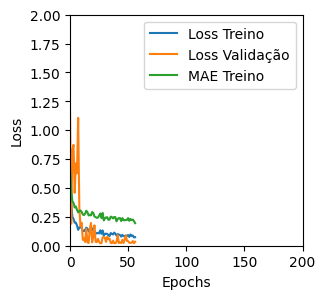

Tempo de treino: 0.20859096844991049 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0826934278011322 , MAE = 0.21591058373451233'

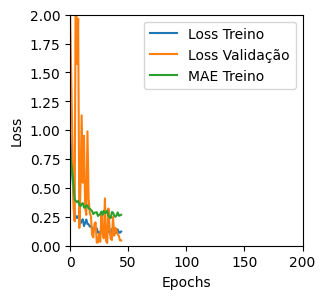

Tempo de treino: 0.10752028624216715 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24007318913936615 , MAE = 0.35636523365974426'

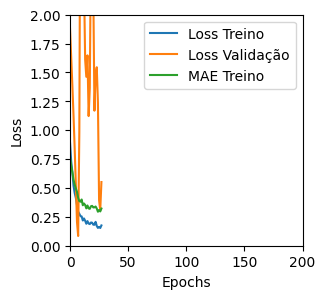

Tempo de treino: 0.06784183979034424 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2886258363723755 , MAE = 0.4142484664916992'

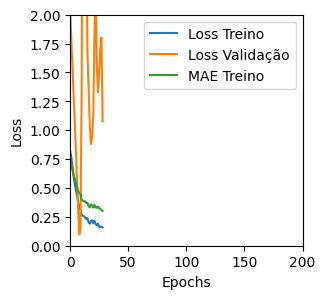

Tempo de treino: 0.09947631359100342 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com GRU_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042965296655893326 , MAE = 0.1598075032234192'

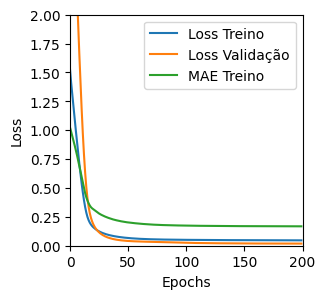

Tempo de treino: 0.5012991825739542 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.053947921842336655 , MAE = 0.1802007406949997'

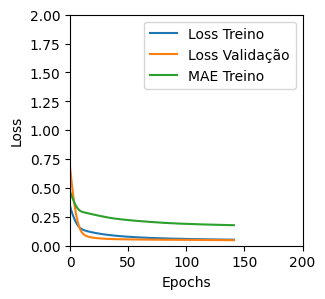

Tempo de treino: 0.2648711323738098 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07106273621320724 , MAE = 0.21413131058216095'

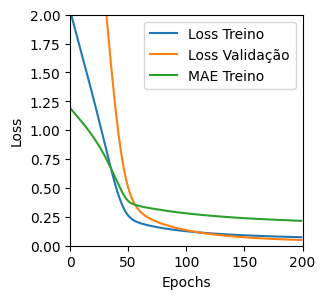

Tempo de treino: 0.23600869178771972 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09054645895957947 , MAE = 0.2420986294746399'

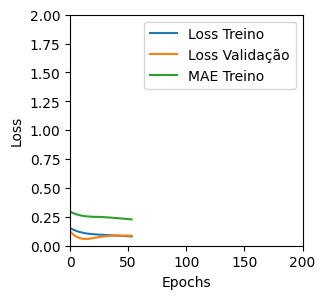

Tempo de treino: 0.12719200452168783 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.041958875954151154 , MAE = 0.1577165573835373'

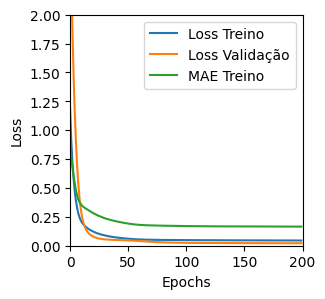

Tempo de treino: 0.7451054493586222 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04219378903508186 , MAE = 0.15732935070991516'

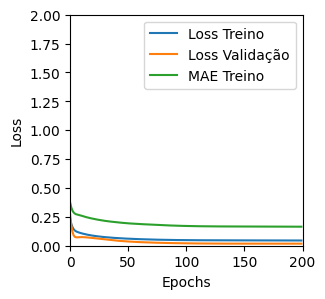

Tempo de treino: 0.3499593695004781 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.050164852291345596 , MAE = 0.17379212379455566'

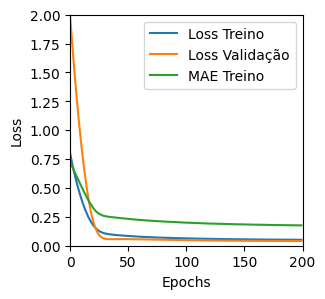

Tempo de treino: 0.3759501854578654 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09956014901399612 , MAE = 0.2561858892440796'

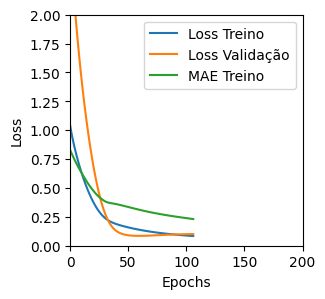

Tempo de treino: 0.1384807546933492 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04272913560271263 , MAE = 0.1568164974451065'

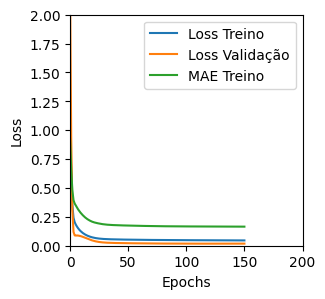

Tempo de treino: 0.4029308040936788 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0425308458507061 , MAE = 0.1587667018175125'

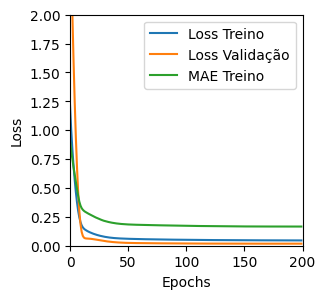

Tempo de treino: 0.39968210061391196 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.043464526534080505 , MAE = 0.16137228906154633'

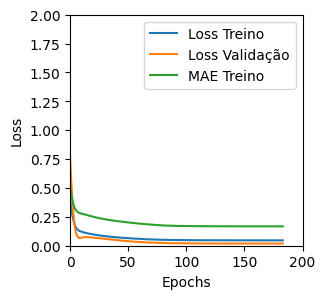

Tempo de treino: 0.2172722021738688 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04469049349427223 , MAE = 0.16418607532978058'

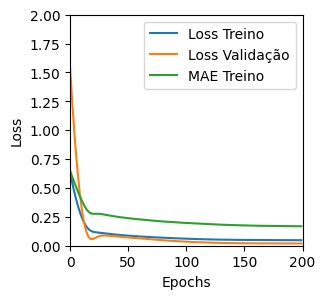

Tempo de treino: 0.22616490125656127 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.041076287627220154 , MAE = 0.15335234999656677'

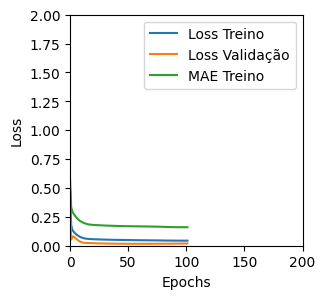

Tempo de treino: 0.3861553192138672 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04278044402599335 , MAE = 0.15781165659427643'

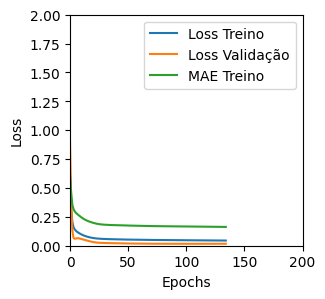

Tempo de treino: 0.3804726243019104 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04234533756971359 , MAE = 0.15845486521720886'

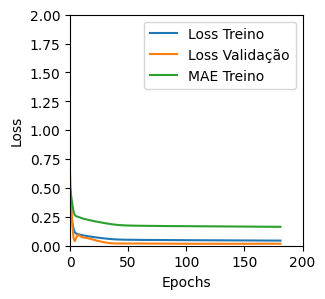

Tempo de treino: 0.2757394750912984 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11188942193984985 , MAE = 0.2650615870952606'

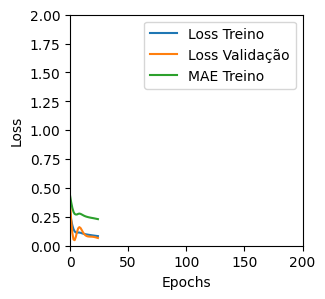

Tempo de treino: 0.09446177482604981 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.043146226555109024 , MAE = 0.1567019373178482'

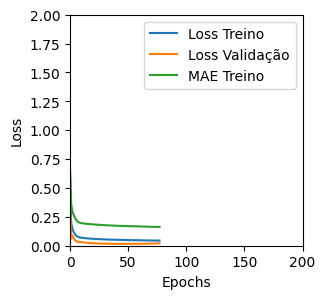

Tempo de treino: 0.3806572953859965 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04313839226961136 , MAE = 0.15782244503498077'

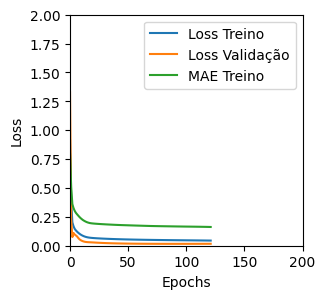

Tempo de treino: 0.3786080757776896 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04138670489192009 , MAE = 0.15567974746227264'

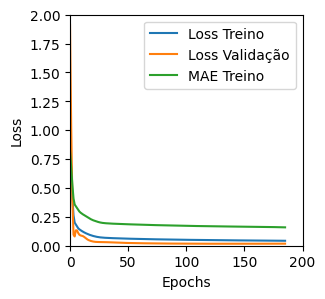

Tempo de treino: 0.3756451408068339 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04288651421666145 , MAE = 0.1594228446483612'

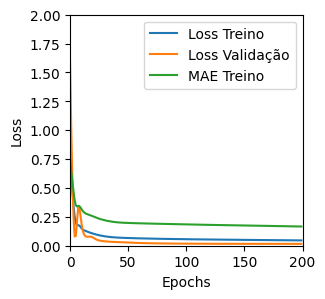

Tempo de treino: 0.30233715375264486 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6105827689170837 , MAE = 0.5924496650695801'

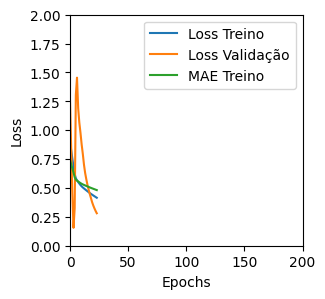

Tempo de treino: 0.211787211894989 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3736134171485901 , MAE = 0.41500431299209595'

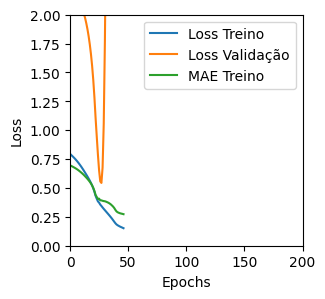

Tempo de treino: 0.20429857969284057 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7366353273391724 , MAE = 0.6732673048973083'

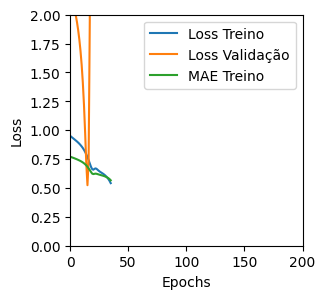

Tempo de treino: 0.10012226899464925 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31556469202041626 , MAE = 0.44379520416259766'

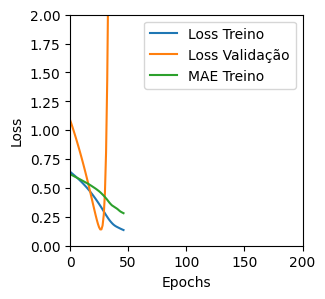

Tempo de treino: 0.08060948848724366 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3363126218318939 , MAE = 0.4289332628250122'

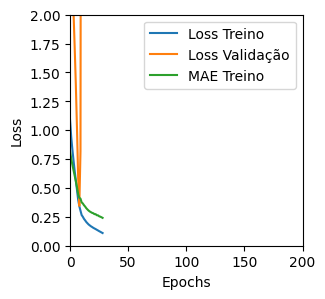

Tempo de treino: 0.20570100943247477 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.62322598695755 , MAE = 0.6197149753570557'

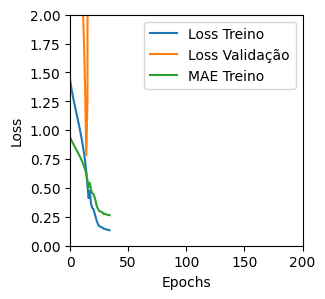

Tempo de treino: 0.21940809885660809 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4401491582393646 , MAE = 0.5125423073768616'

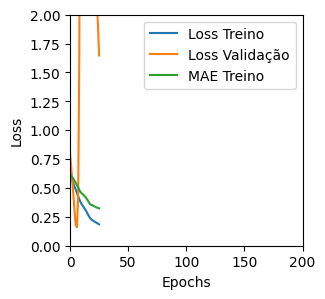

Tempo de treino: 0.11869199673334757 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.630387544631958 , MAE = 0.6254414916038513'

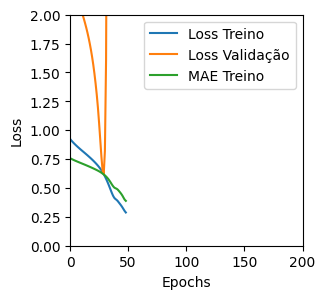

Tempo de treino: 0.0851084033648173 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36573290824890137 , MAE = 0.44357627630233765'

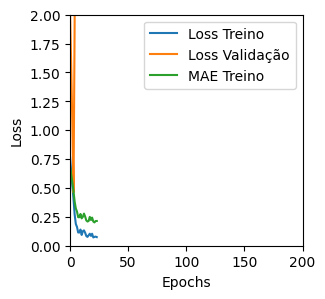

Tempo de treino: 0.14801667928695678 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4437800645828247 , MAE = 0.4841603934764862'

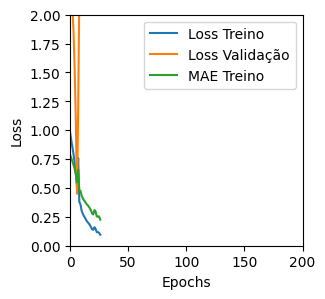

Tempo de treino: 0.09880871375401815 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.640818178653717 , MAE = 0.6148756742477417'

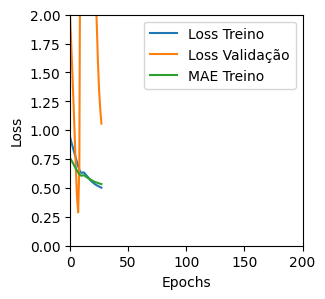

Tempo de treino: 0.0897470990816752 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38373565673828125 , MAE = 0.4662696123123169'

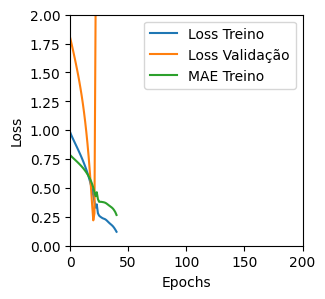

Tempo de treino: 0.10520283778508505 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3381044268608093 , MAE = 0.4478392004966736'

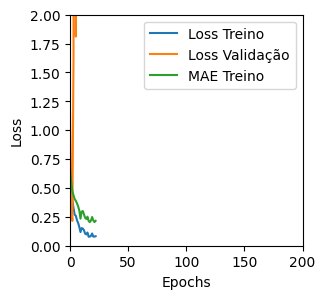

Tempo de treino: 0.15391153891881307 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39331528544425964 , MAE = 0.47808465361595154'

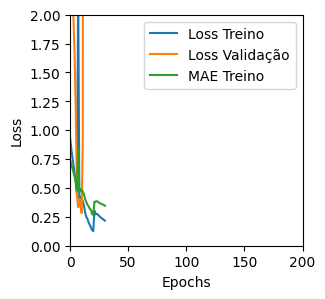

Tempo de treino: 0.204310933748881 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3681330382823944 , MAE = 0.4520260691642761'

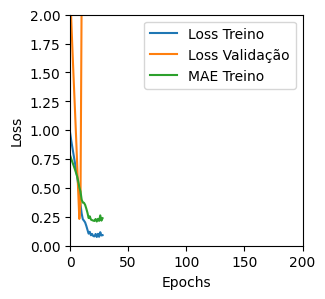

Tempo de treino: 0.0833142876625061 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5366010665893555 , MAE = 0.5601440668106079'

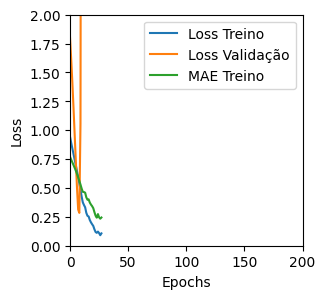

Tempo de treino: 0.07247506777445475 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07729842513799667 , MAE = 0.21688131988048553'

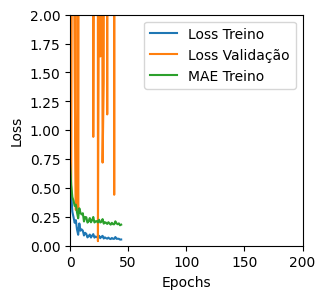

Tempo de treino: 0.2620850205421448 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37505224347114563 , MAE = 0.45902714133262634'

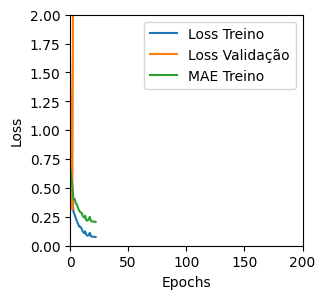

Tempo de treino: 0.11619407335917155 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27901244163513184 , MAE = 0.40229418873786926'

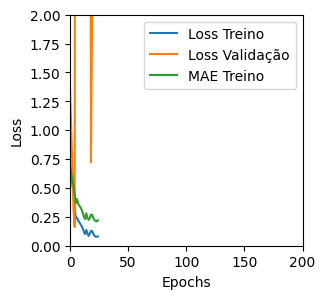

Tempo de treino: 0.09889602661132812 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49640944600105286 , MAE = 0.5420729517936707'

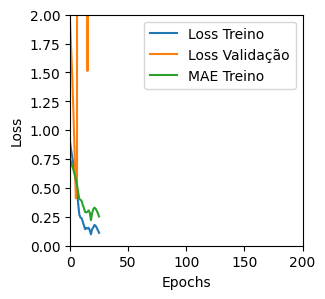

Tempo de treino: 0.08173303604125977 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11164193600416183 , MAE = 0.2417445331811905'

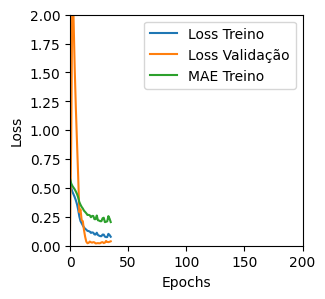

Tempo de treino: 0.21548868815104166 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2541719079017639 , MAE = 0.384329229593277'

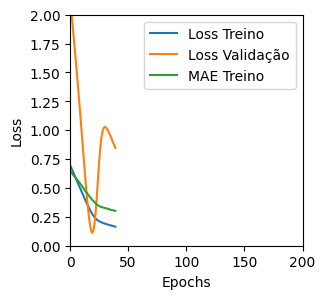

Tempo de treino: 0.13628280957539876 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6916301846504211 , MAE = 0.5983102917671204'

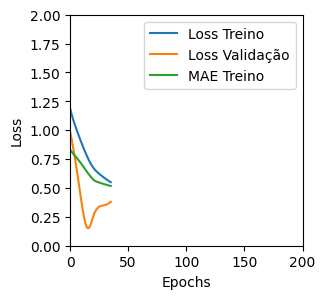

Tempo de treino: 0.10475601355234782 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26393210887908936 , MAE = 0.4083639085292816'

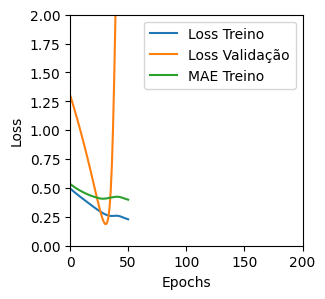

Tempo de treino: 0.09176696936289469 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33981961011886597 , MAE = 0.4356996417045593'

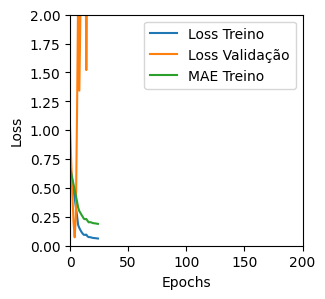

Tempo de treino: 0.20673147042592366 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08713551610708237 , MAE = 0.22241735458374023'

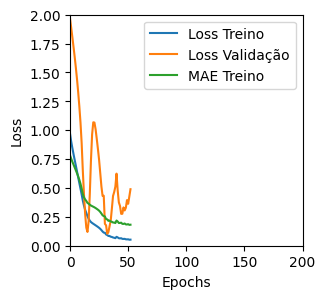

Tempo de treino: 0.23433992465337117 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2932840585708618 , MAE = 0.39182817935943604'

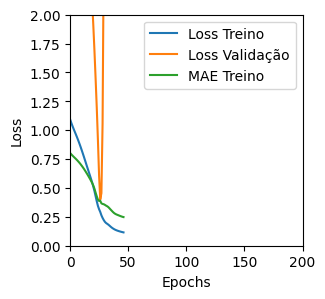

Tempo de treino: 0.13368027607599894 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0856558084487915 , MAE = 0.23246566951274872'

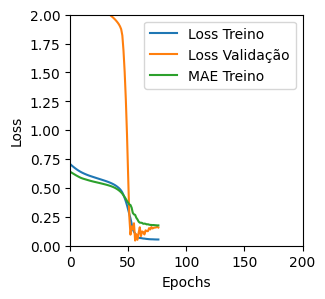

Tempo de treino: 0.14193758567174275 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19180357456207275 , MAE = 0.33228155970573425'

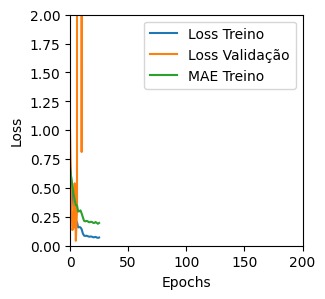

Tempo de treino: 0.16365582545598348 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5427125692367554 , MAE = 0.5687587261199951'

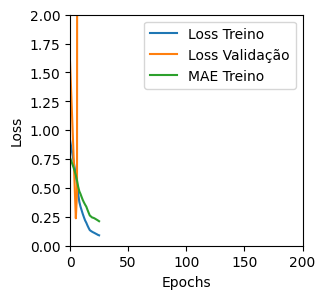

Tempo de treino: 0.10603144168853759 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23173879086971283 , MAE = 0.36779651045799255'

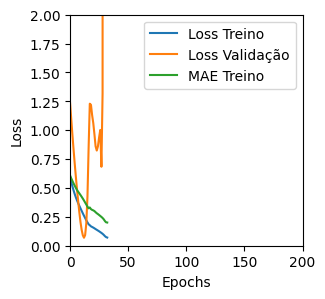

Tempo de treino: 0.11722916762034098 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.454353928565979 , MAE = 0.5162200927734375'

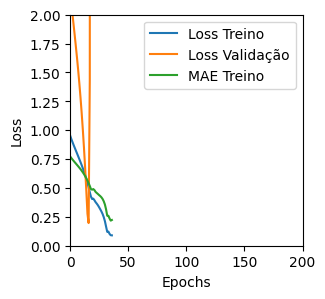

Tempo de treino: 0.0990986188252767 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5142892003059387 , MAE = 0.551389753818512'

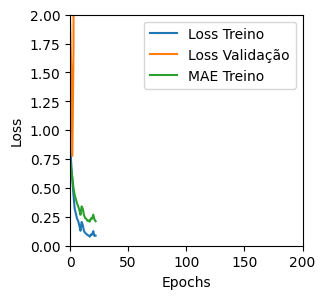

Tempo de treino: 0.1677926500638326 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33176189661026 , MAE = 0.4360238015651703'

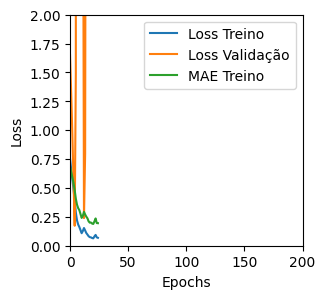

Tempo de treino: 0.11696900526682535 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29759037494659424 , MAE = 0.40889623761177063'

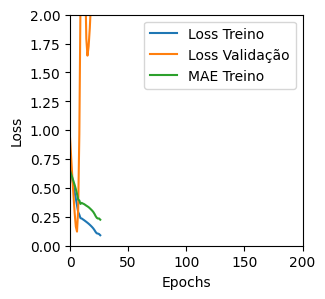

Tempo de treino: 0.12558749516805012 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08867819607257843 , MAE = 0.23951728641986847'

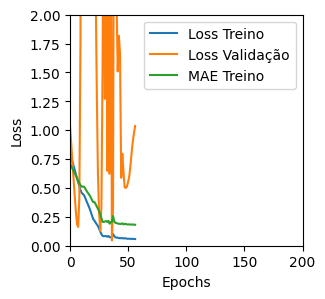

Tempo de treino: 0.20491911172866822 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3016033470630646 , MAE = 0.41279202699661255'

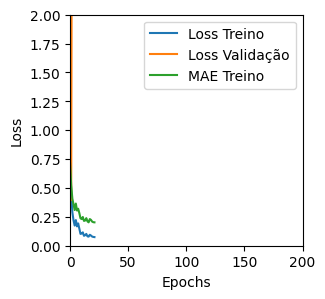

Tempo de treino: 0.16807709534962972 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4488697350025177 , MAE = 0.5092869997024536'

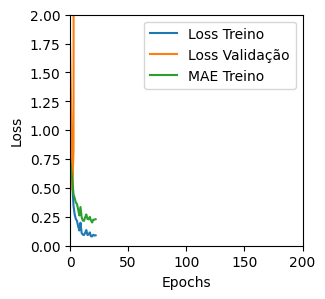

Tempo de treino: 0.10307224988937377 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36798936128616333 , MAE = 0.437542200088501'

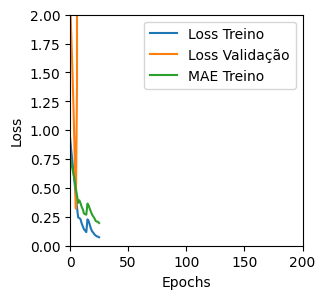

Tempo de treino: 0.149782129128774 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41420796513557434 , MAE = 0.4931640326976776'

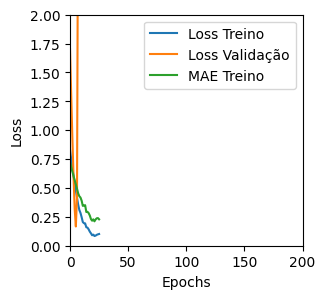

Tempo de treino: 0.0946978251139323 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11251042038202286 , MAE = 0.25368472933769226'

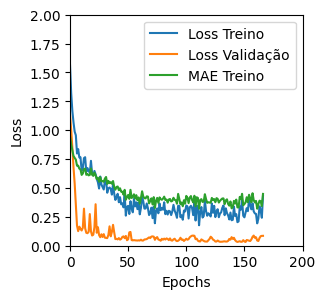

Tempo de treino: 0.7696352044741313 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20037071406841278 , MAE = 0.34487384557724'

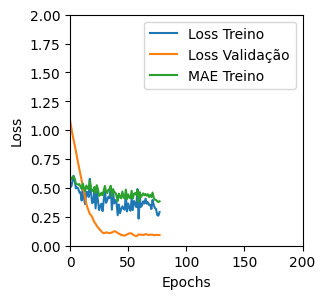

Tempo de treino: 0.263467268149058 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17823494970798492 , MAE = 0.32371053099632263'

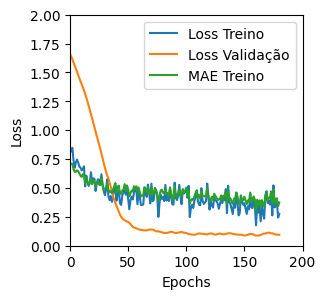

Tempo de treino: 0.37745364507039386 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7973835468292236 , MAE = 0.6830639839172363'

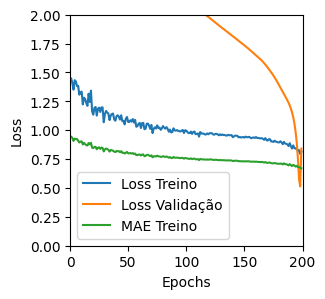

Tempo de treino: 0.2862618327140808 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6335185170173645 , MAE = 0.6036592721939087'

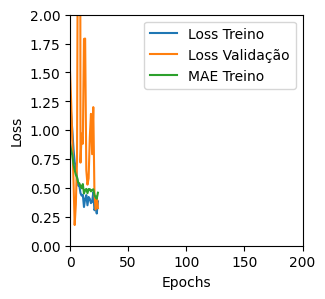

Tempo de treino: 0.20664982398351034 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v3 , timesteps=24, units=8, batch=8


'TRAINING set. Loss = 0.35184037685394287 , MAE = 0.42555829882621765'

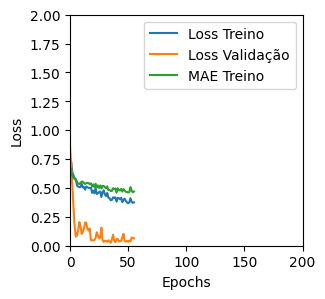

Tempo de treino: 0.20165268580118814 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5726571679115295 , MAE = 0.5839001536369324'

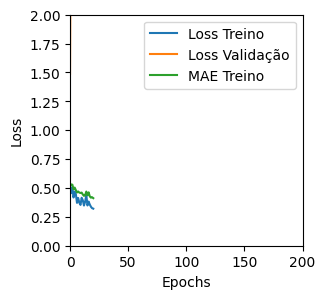

Tempo de treino: 0.0797931989034017 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5645875930786133 , MAE = 0.5558061599731445'

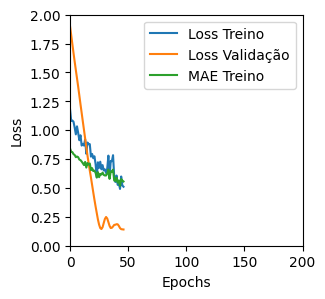

Tempo de treino: 0.10499873161315917 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08389049023389816 , MAE = 0.21757876873016357'

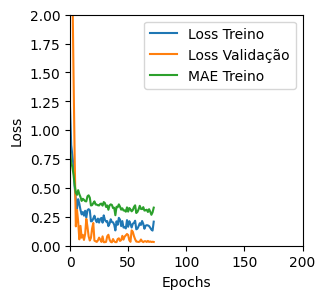

Tempo de treino: 0.3486733396848043 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3431328237056732 , MAE = 0.4138268232345581'

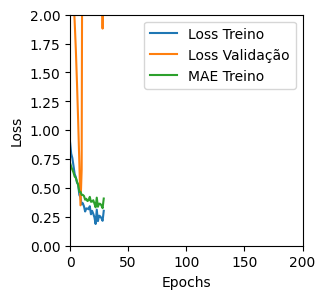

Tempo de treino: 0.10959927638371786 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2897999584674835 , MAE = 0.3912973999977112'

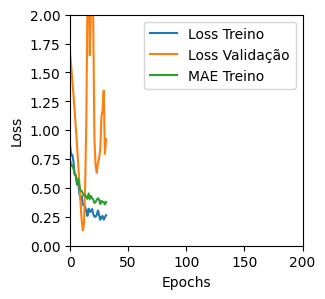

Tempo de treino: 0.11668719053268432 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5818918943405151 , MAE = 0.5732786655426025'

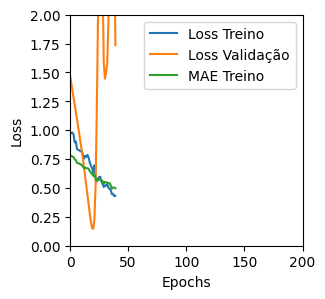

Tempo de treino: 0.13871230284372965 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12622788548469543 , MAE = 0.24706652760505676'

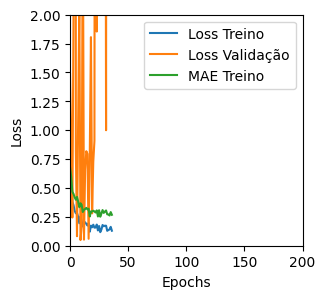

Tempo de treino: 0.39666614929835003 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08722700923681259 , MAE = 0.22008192539215088'

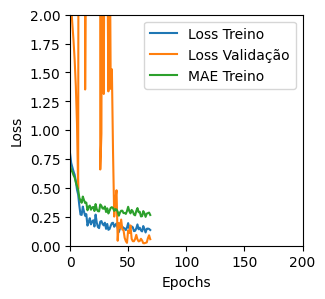

Tempo de treino: 0.2326895515124003 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13271690905094147 , MAE = 0.2536998391151428'

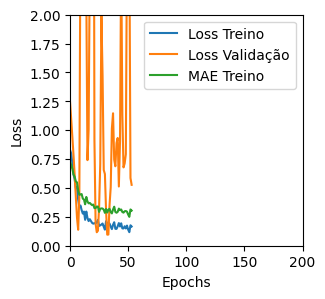

Tempo de treino: 0.21215225458145143 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3272880017757416 , MAE = 0.4286210834980011'

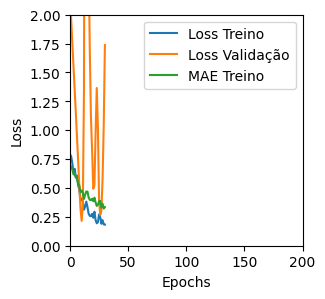

Tempo de treino: 0.07843457063039144 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08962342888116837 , MAE = 0.2290879189968109'

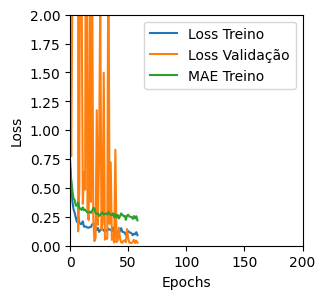

Tempo de treino: 0.33089067935943606 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3053809404373169 , MAE = 0.41961532831192017'

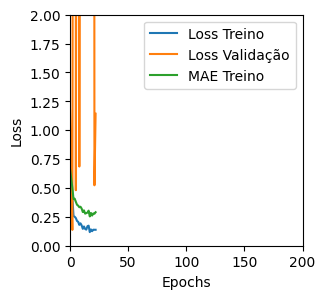

Tempo de treino: 0.12898577451705934 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2726510167121887 , MAE = 0.37304171919822693'

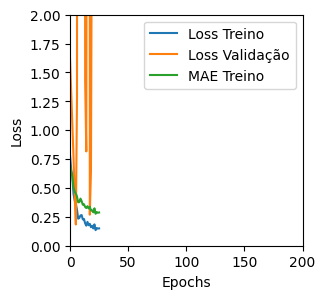

Tempo de treino: 0.12246881326039633 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4010772705078125 , MAE = 0.48738202452659607'

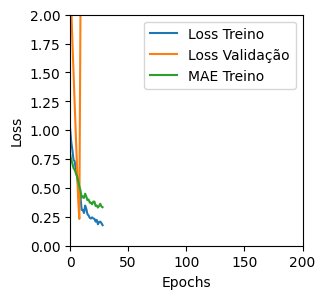

Tempo de treino: 0.07734434207280477 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com GRU_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0484205037355423 , MAE = 0.1695462018251419'

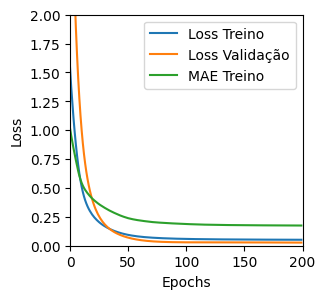

Tempo de treino: 1.4148866573969523 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.056512173265218735 , MAE = 0.1855619251728058'

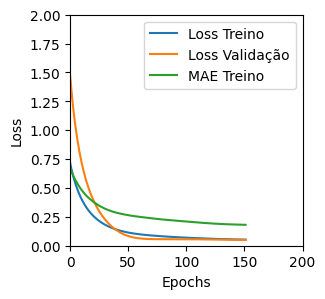

Tempo de treino: 0.722970712184906 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05273318663239479 , MAE = 0.18068978190422058'

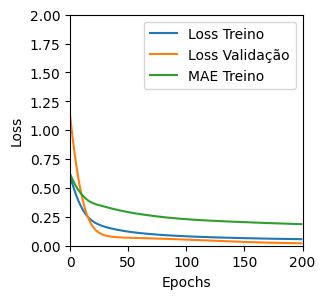

Tempo de treino: 0.43655422925949094 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07723742723464966 , MAE = 0.21897441148757935'

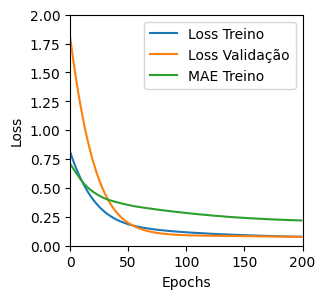

Tempo de treino: 0.3030782183011373 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.045224279165267944 , MAE = 0.16466425359249115'

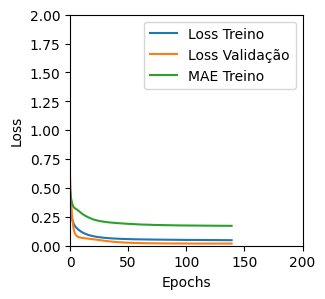

Tempo de treino: 1.4331639130910239 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04661277309060097 , MAE = 0.16783587634563446'

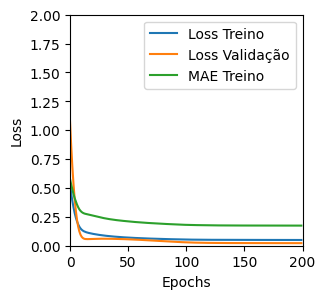

Tempo de treino: 0.601759155591329 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.050931304693222046 , MAE = 0.17440639436244965'

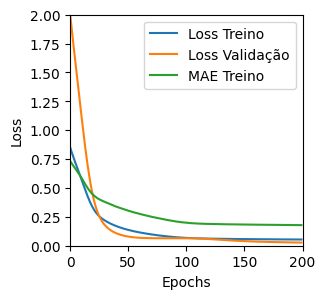

Tempo de treino: 0.38523830970128375 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13012637197971344 , MAE = 0.29407215118408203'

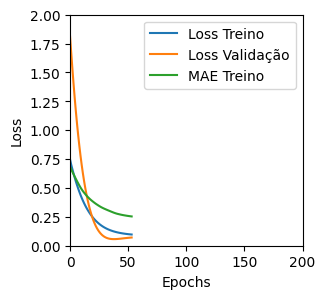

Tempo de treino: 0.15435250600179037 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04060618579387665 , MAE = 0.15565674006938934'

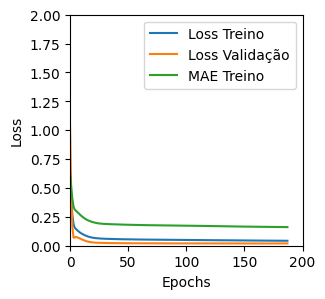

Tempo de treino: 1.012712001800537 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0450713150203228 , MAE = 0.16271954774856567'

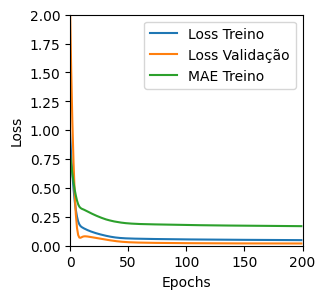

Tempo de treino: 0.7269878268241883 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05244922265410423 , MAE = 0.17620126903057098'

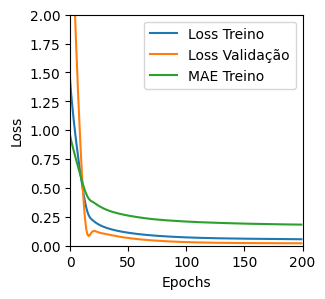

Tempo de treino: 0.4023256540298462 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2299579232931137 , MAE = 0.38281533122062683'

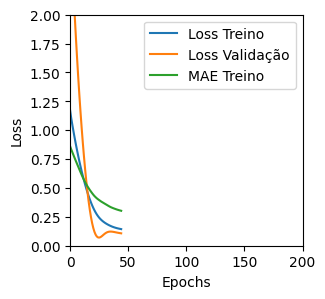

Tempo de treino: 0.1522403120994568 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.044061653316020966 , MAE = 0.1625998616218567'

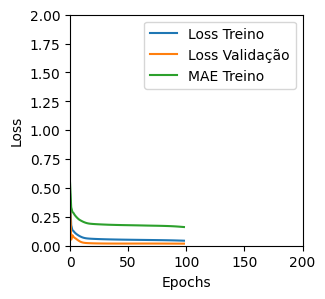

Tempo de treino: 0.7395727634429932 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.033441975712776184 , MAE = 0.1378546953201294'

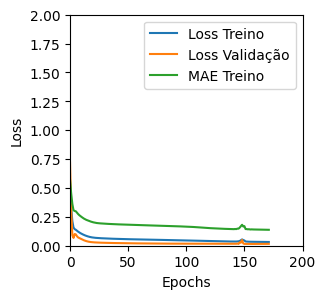

Tempo de treino: 0.569303286075592 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05001699924468994 , MAE = 0.17159956693649292'

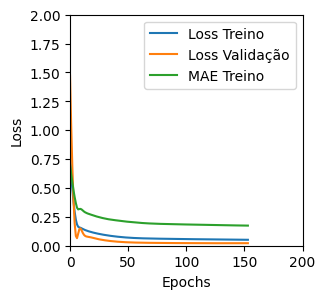

Tempo de treino: 0.38368548154830934 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.052197109907865524 , MAE = 0.1749032437801361'

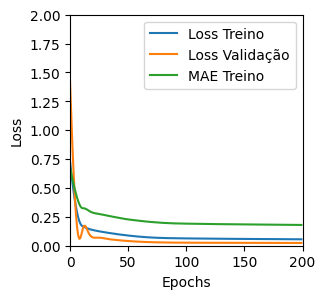

Tempo de treino: 0.38614666064580283 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.039747849106788635 , MAE = 0.151089146733284'

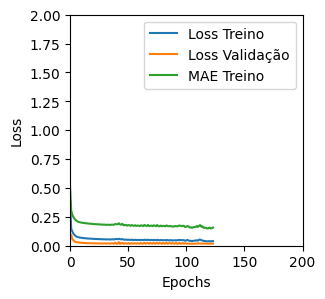

Tempo de treino: 1.4358684539794921 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.03964611887931824 , MAE = 0.15323595702648163'

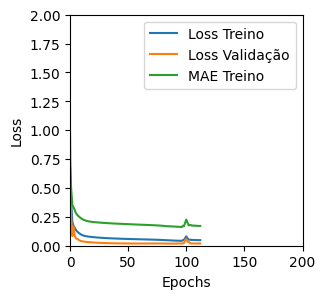

Tempo de treino: 0.4249016006787618 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05018862336874008 , MAE = 0.1713285744190216'

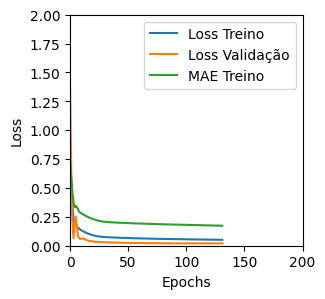

Tempo de treino: 0.38601491451263426 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05443998798727989 , MAE = 0.1784100979566574'

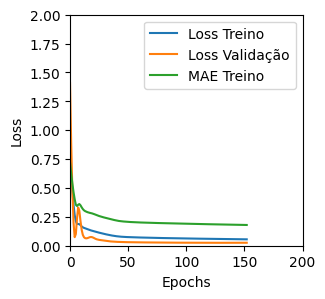

Tempo de treino: 0.38648736476898193 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.052029624581336975 , MAE = 0.17767900228500366'

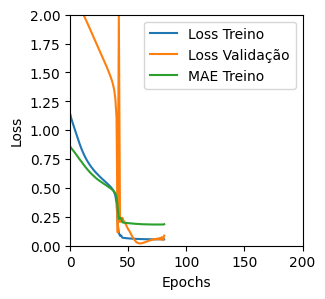

Tempo de treino: 0.745458988348643 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.8957005739212036 , MAE = 0.6694164276123047'

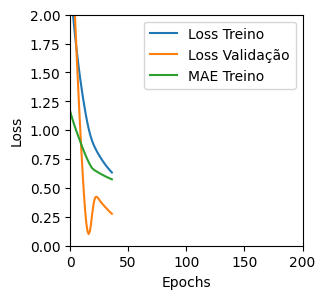

Tempo de treino: 0.16101792653401692 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5822510123252869 , MAE = 0.5980687141418457'

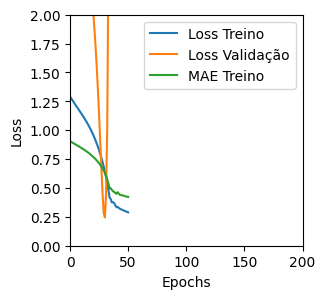

Tempo de treino: 0.20459147691726684 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5970042943954468 , MAE = 0.5223743915557861'

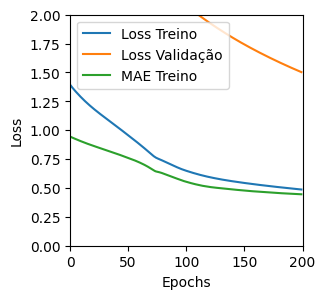

Tempo de treino: 0.2639350732167562 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04926355928182602 , MAE = 0.17475642263889313'

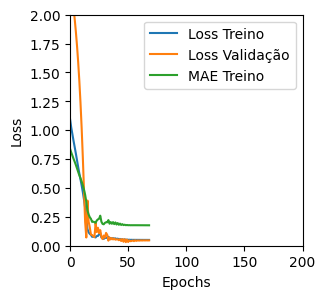

Tempo de treino: 0.7159044941266378 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6566218733787537 , MAE = 0.6351692080497742'

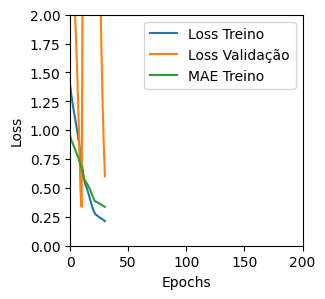

Tempo de treino: 0.12170313994089763 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7448459267616272 , MAE = 0.674481987953186'

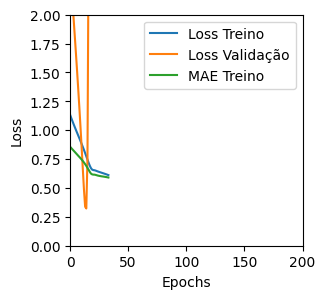

Tempo de treino: 0.12802795569101968 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6447505950927734 , MAE = 0.6150808930397034'

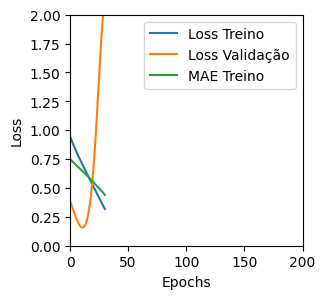

Tempo de treino: 0.10439074436823527 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08723420649766922 , MAE = 0.21920236945152283'

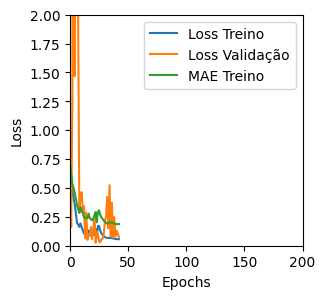

Tempo de treino: 0.2748987634976705 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41841602325439453 , MAE = 0.49288785457611084'

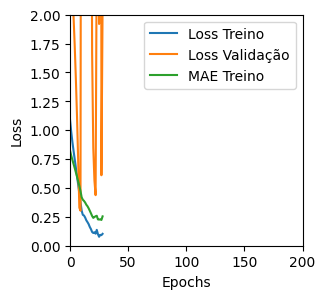

Tempo de treino: 0.12324630816777547 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3835829198360443 , MAE = 0.4665129780769348'

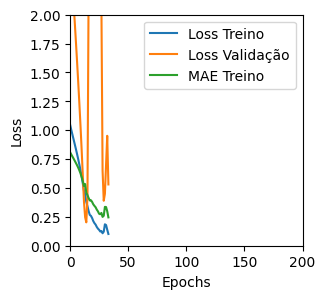

Tempo de treino: 0.13182438214619954 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11578981578350067 , MAE = 0.2524206042289734'

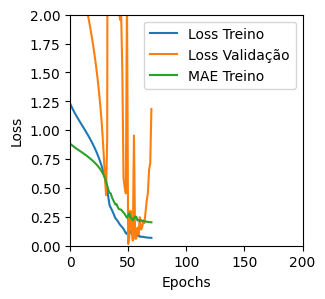

Tempo de treino: 0.12633353074391682 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04768410325050354 , MAE = 0.16395966708660126'

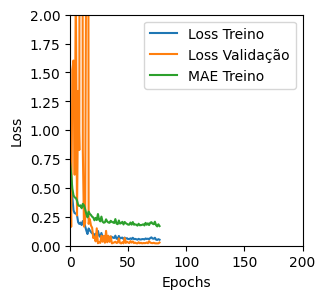

Tempo de treino: 0.44691619873046873 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4175149202346802 , MAE = 0.4958727955818176'

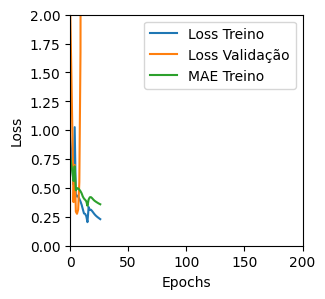

Tempo de treino: 0.14498738845189413 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16139830648899078 , MAE = 0.3035765290260315'

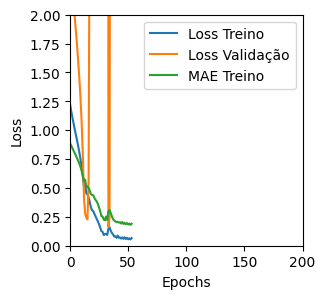

Tempo de treino: 0.21643530925114948 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31432345509529114 , MAE = 0.4387603998184204'

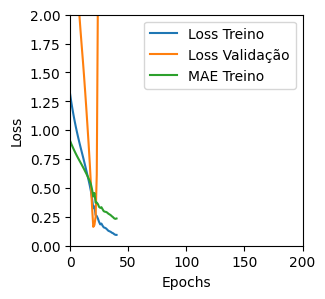

Tempo de treino: 0.11958585977554322 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11898654699325562 , MAE = 0.2951928377151489'

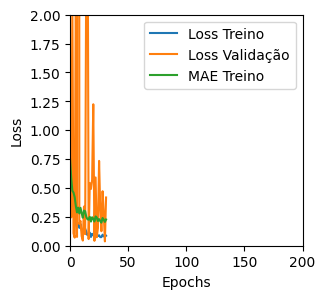

Tempo de treino: 0.23642162481943765 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34997662901878357 , MAE = 0.45691996812820435'

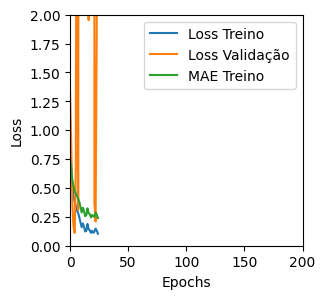

Tempo de treino: 0.13742054303487142 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4757187068462372 , MAE = 0.5341043472290039'

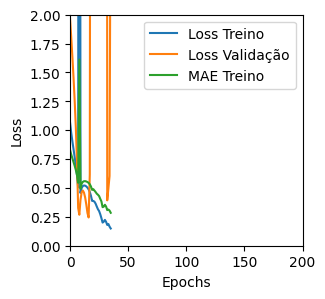

Tempo de treino: 0.12569404443105062 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07777012884616852 , MAE = 0.21189551055431366'

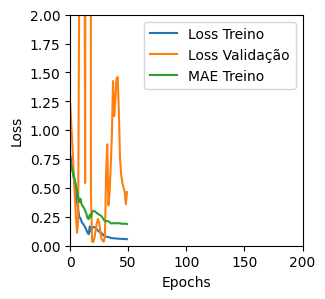

Tempo de treino: 0.1171761393547058 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5417354702949524 , MAE = 0.5759038329124451'

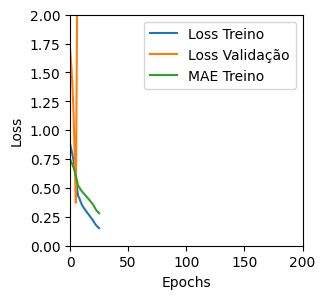

Tempo de treino: 0.229958975315094 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25626900792121887 , MAE = 0.36627301573753357'

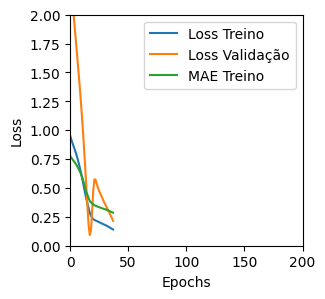

Tempo de treino: 0.16215311288833617 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2070399522781372 , MAE = 0.3305759131908417'

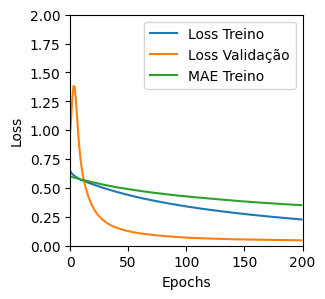

Tempo de treino: 0.7173382401466369 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5275431871414185 , MAE = 0.4918060004711151'

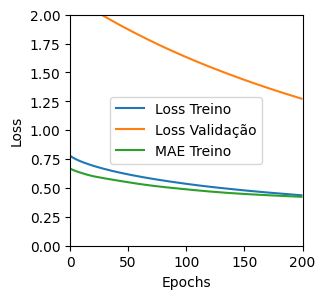

Tempo de treino: 0.2659933845202128 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7504594326019287 , MAE = 0.671515941619873'

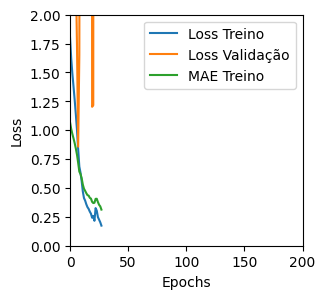

Tempo de treino: 0.19036717017491658 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5241239666938782 , MAE = 0.5790093541145325'

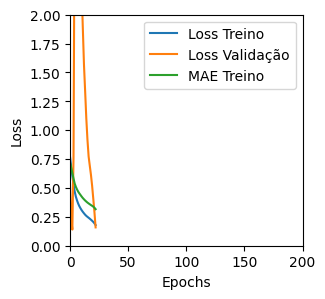

Tempo de treino: 0.10868933200836181 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5810643434524536 , MAE = 0.5816425085067749'

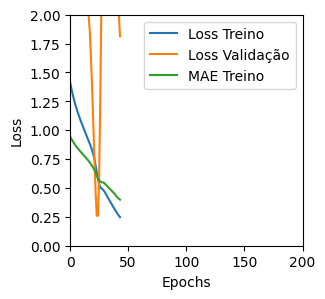

Tempo de treino: 0.11160122950871786 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4933452904224396 , MAE = 0.5520811080932617'

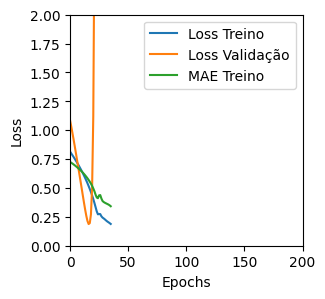

Tempo de treino: 0.11805489063262939 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15591128170490265 , MAE = 0.29860660433769226'

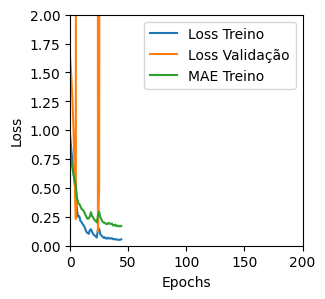

Tempo de treino: 0.2786353826522827 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2799973487854004 , MAE = 0.3748580515384674'

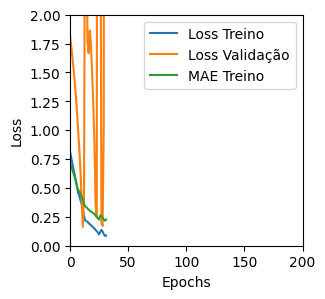

Tempo de treino: 0.2056568702061971 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20194554328918457 , MAE = 0.32662129402160645'

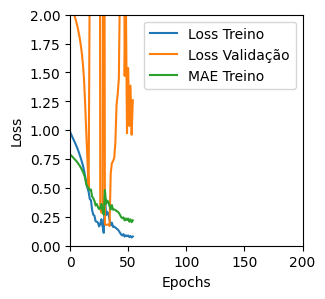

Tempo de treino: 0.1441942811012268 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4006001949310303 , MAE = 0.47796717286109924'

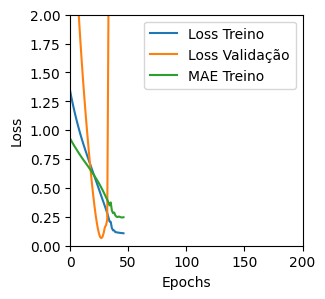

Tempo de treino: 0.11682705084482829 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0653817281126976 , MAE = 0.1966557502746582'

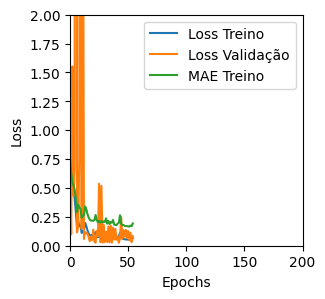

Tempo de treino: 0.3746931076049805 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17724700272083282 , MAE = 0.308447927236557'

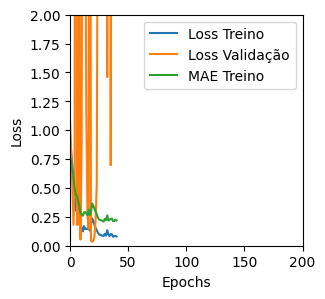

Tempo de treino: 0.2019266645113627 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2202674001455307 , MAE = 0.3652285635471344'

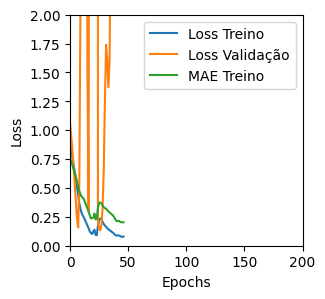

Tempo de treino: 0.22479534546534222 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.381820410490036 , MAE = 0.4688073694705963'

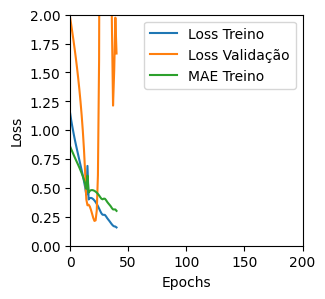

Tempo de treino: 0.10469366312026977 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15812842547893524 , MAE = 0.27899959683418274'

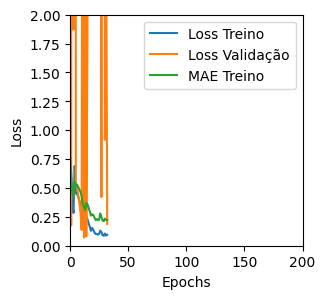

Tempo de treino: 0.23860583702723184 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1273883581161499 , MAE = 0.25940120220184326'

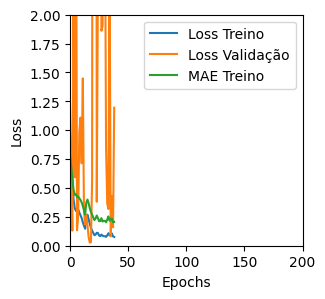

Tempo de treino: 0.18774358034133912 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27091526985168457 , MAE = 0.3809208869934082'

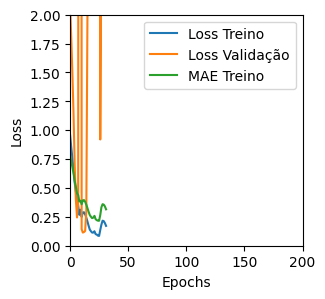

Tempo de treino: 0.11704748471577962 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16416944563388824 , MAE = 0.2986699342727661'

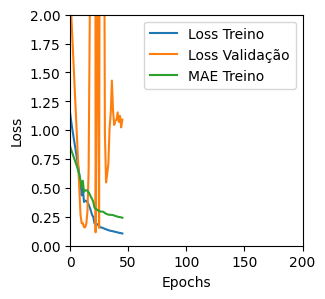

Tempo de treino: 0.11172526280085246 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14522427320480347 , MAE = 0.2901064157485962'

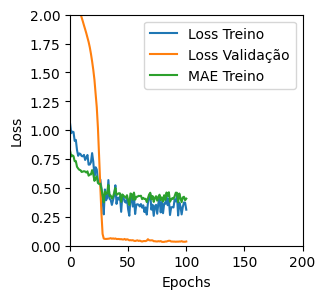

Tempo de treino: 0.7149500449498495 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17171582579612732 , MAE = 0.3138769865036011'

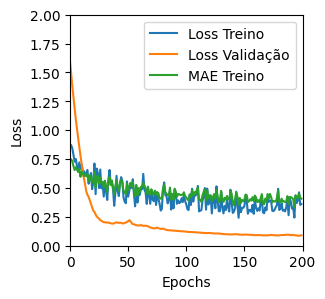

Tempo de treino: 0.7453635176022847 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6290550827980042 , MAE = 0.5796109437942505'

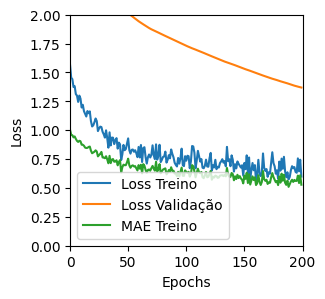

Tempo de treino: 0.3860462864240011 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2064802199602127 , MAE = 0.34231287240982056'

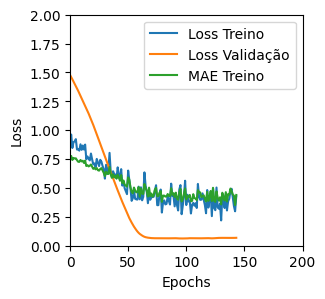

Tempo de treino: 0.20437371333440144 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6998165845870972 , MAE = 0.6483219861984253'

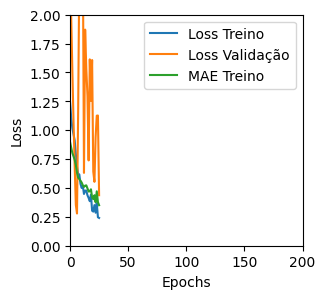

Tempo de treino: 0.20521157185236613 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11171217262744904 , MAE = 0.25177401304244995'

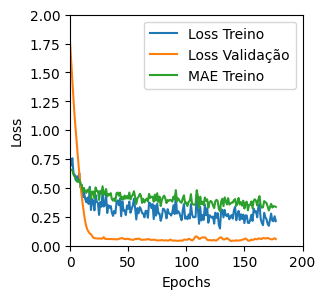

Tempo de treino: 0.5734137813250224 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1841692179441452 , MAE = 0.3276464343070984'

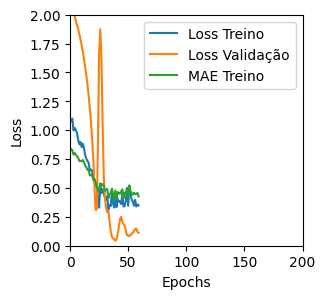

Tempo de treino: 0.132487952709198 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.8133418560028076 , MAE = 0.6439517140388489'

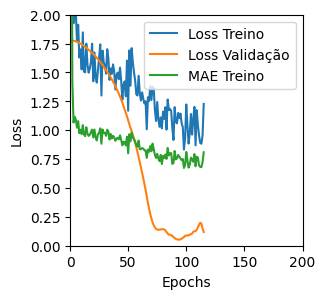

Tempo de treino: 0.23488160769144695 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16459476947784424 , MAE = 0.3001726269721985'

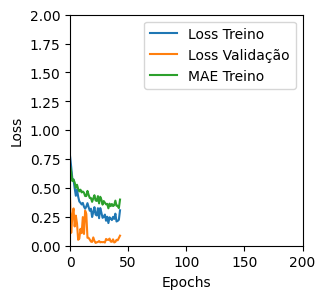

Tempo de treino: 0.27587401469548545 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1546018272638321 , MAE = 0.2904190421104431'

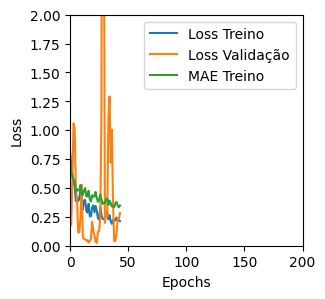

Tempo de treino: 0.20662870407104492 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4275737404823303 , MAE = 0.498896986246109'

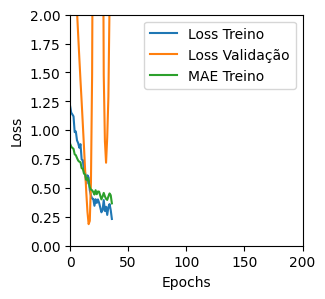

Tempo de treino: 0.09908604621887207 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10736189037561417 , MAE = 0.24038437008857727'

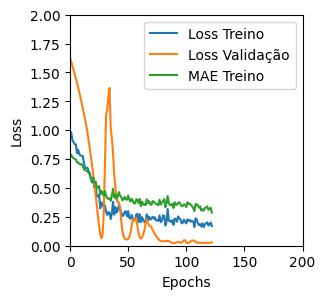

Tempo de treino: 0.18062705198923748 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09032990038394928 , MAE = 0.21373750269412994'

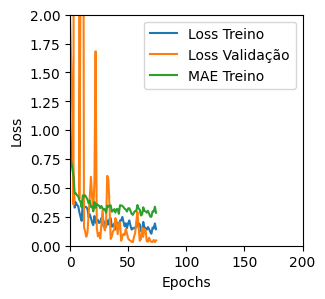

Tempo de treino: 0.7152115265528362 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14909926056861877 , MAE = 0.26567956805229187'

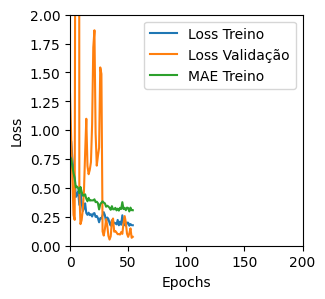

Tempo de treino: 0.21703834533691407 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6473764777183533 , MAE = 0.6163182854652405'

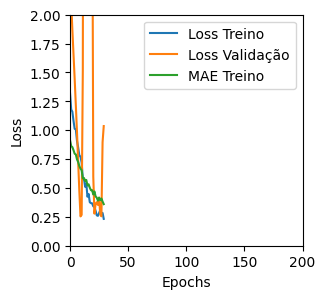

Tempo de treino: 0.14335410197575887 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5934428572654724 , MAE = 0.5981956720352173'

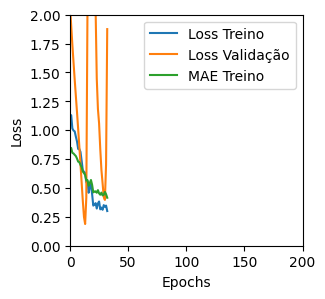

Tempo de treino: 0.12284036080042521 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12850655615329742 , MAE = 0.26842591166496277'

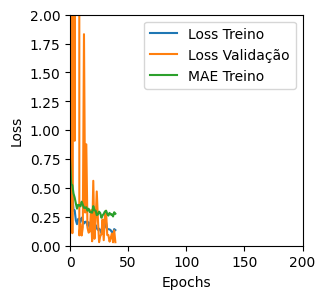

Tempo de treino: 0.3782022436459859 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10644184052944183 , MAE = 0.23538857698440552'

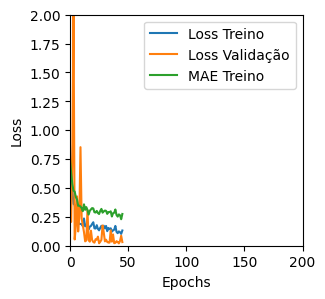

Tempo de treino: 0.37812336285909015 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18889950215816498 , MAE = 0.3179764747619629'

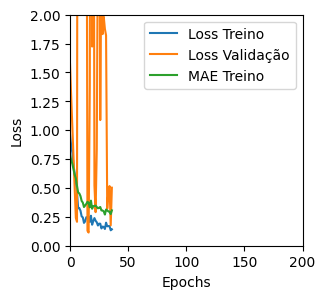

Tempo de treino: 0.11994564930597941 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4809337556362152 , MAE = 0.5316314101219177'

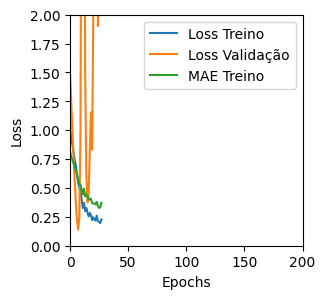

Tempo de treino: 0.08158165216445923 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com GRU_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04926721751689911 , MAE = 0.1687021553516388'

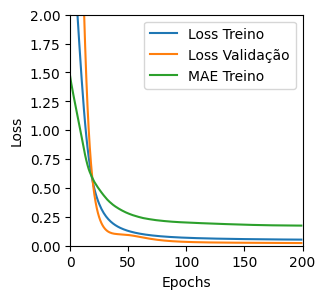

Tempo de treino: 1.4080098112424215 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05083413049578667 , MAE = 0.1761500984430313'

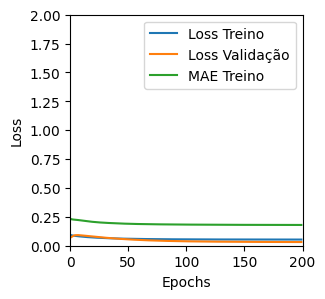

Tempo de treino: 1.4277230302492778 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07847407460212708 , MAE = 0.2222345620393753'

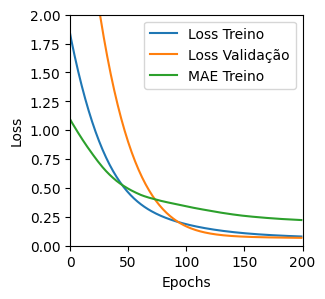

Tempo de treino: 0.45685019890467327 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10313837230205536 , MAE = 0.2541291117668152'

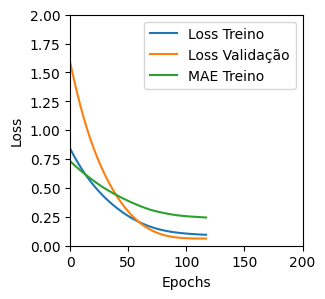

Tempo de treino: 0.21355187495549519 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04627322033047676 , MAE = 0.1652906835079193'

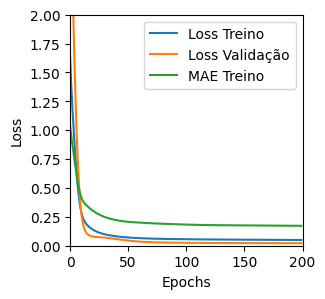

Tempo de treino: 1.4084028720855712 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20427179336547852 , MAE = 0.35484230518341064'

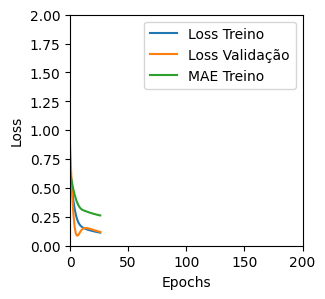

Tempo de treino: 0.18249603907267253 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14413531124591827 , MAE = 0.2961045205593109'

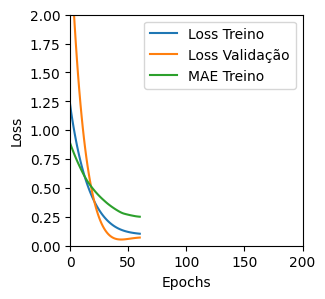

Tempo de treino: 0.2179886261622111 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14618496596813202 , MAE = 0.30085328221321106'

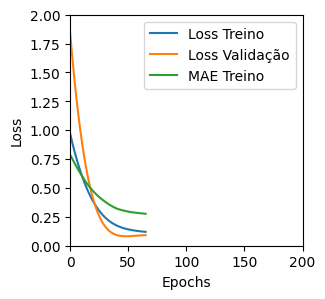

Tempo de treino: 0.2140221953392029 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04528316482901573 , MAE = 0.16609930992126465'

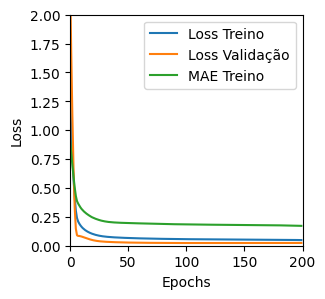

Tempo de treino: 1.4090741157531739 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04961245507001877 , MAE = 0.17277373373508453'

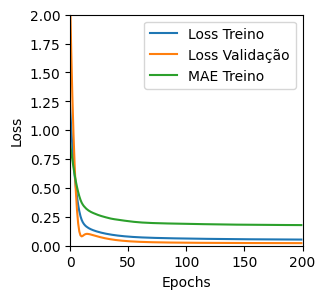

Tempo de treino: 1.4079925576845804 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18866688013076782 , MAE = 0.34547850489616394'

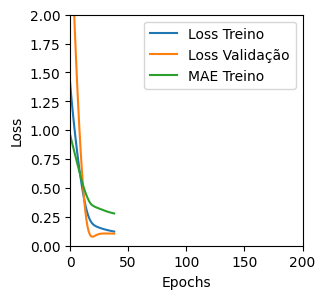

Tempo de treino: 0.23233518203099568 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.158406063914299 , MAE = 0.30553025007247925'

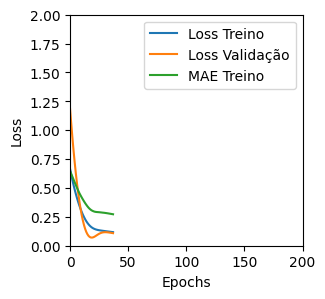

Tempo de treino: 0.11374339262644449 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04795224592089653 , MAE = 0.16957005858421326'

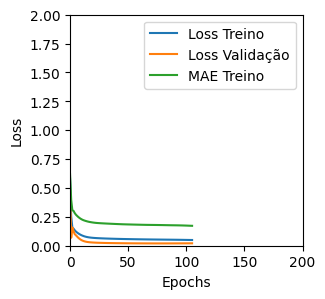

Tempo de treino: 1.408750096956889 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04913327097892761 , MAE = 0.1720668077468872'

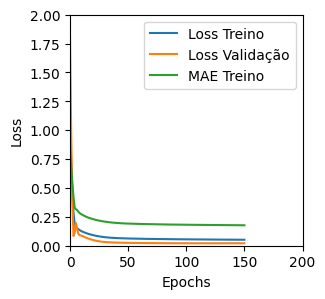

Tempo de treino: 0.72598371108373 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16633674502372742 , MAE = 0.31286147236824036'

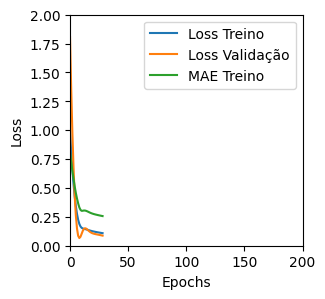

Tempo de treino: 0.14944105545679728 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1523820012807846 , MAE = 0.29676321148872375'

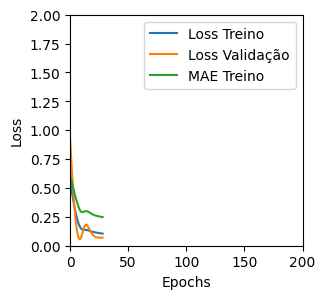

Tempo de treino: 0.13234403530756633 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04580286145210266 , MAE = 0.1641300469636917'

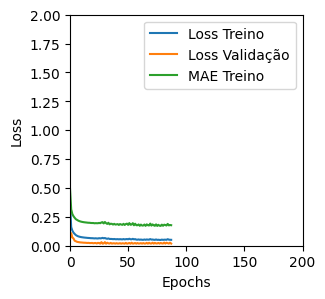

Tempo de treino: 0.7282528201738994 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04823532700538635 , MAE = 0.17009536921977997'

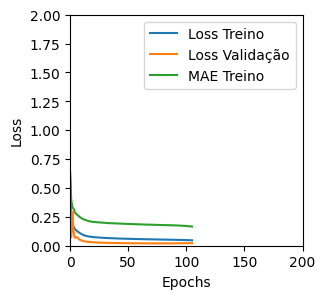

Tempo de treino: 0.7258466760317485 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.051612839102745056 , MAE = 0.17423516511917114'

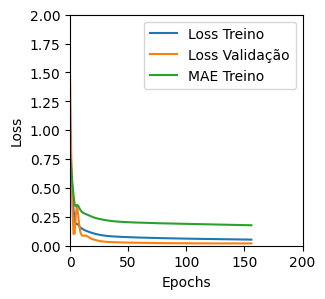

Tempo de treino: 0.7244237502415974 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04747447744011879 , MAE = 0.16891932487487793'

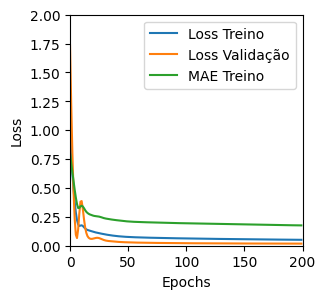

Tempo de treino: 0.4169187943140666 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5414594411849976 , MAE = 0.5614268183708191'

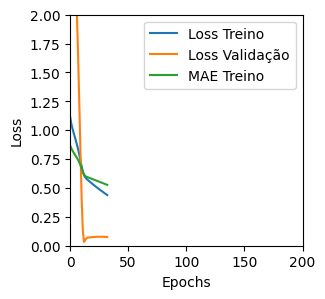

Tempo de treino: 0.13792945543924967 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.519619882106781 , MAE = 0.5460742115974426'

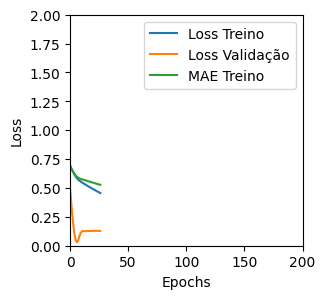

Tempo de treino: 0.0908344030380249 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10664039850234985 , MAE = 0.24994397163391113'

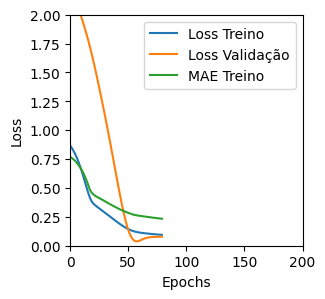

Tempo de treino: 0.14681654771169025 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5348360538482666 , MAE = 0.5588332414627075'

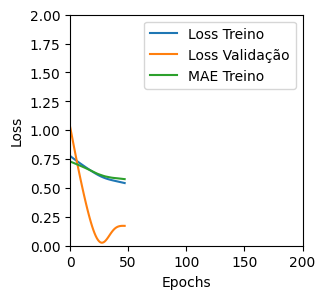

Tempo de treino: 0.09984864393870035 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07784959673881531 , MAE = 0.21620747447013855'

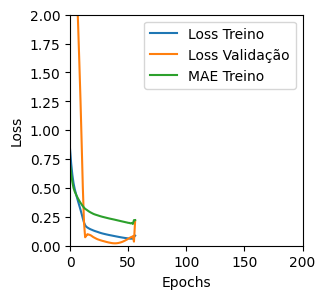

Tempo de treino: 0.20058121681213378 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12823422253131866 , MAE = 0.2769410312175751'

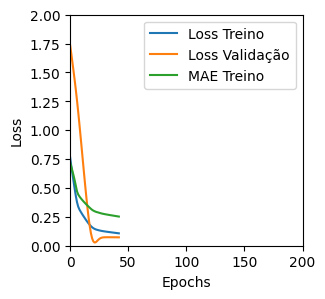

Tempo de treino: 0.23734740813573202 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1681780070066452 , MAE = 0.3037457764148712'

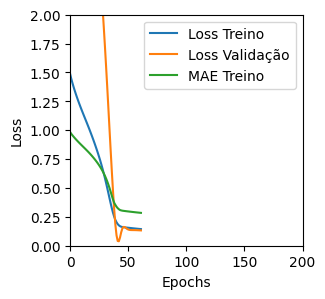

Tempo de treino: 0.1354367772738139 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49330705404281616 , MAE = 0.5286358594894409'

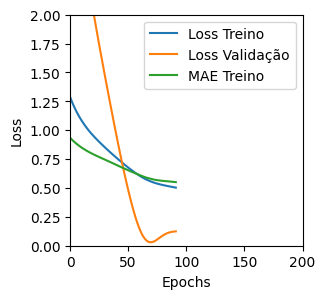

Tempo de treino: 0.22536592483520507 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05049007385969162 , MAE = 0.17250502109527588'

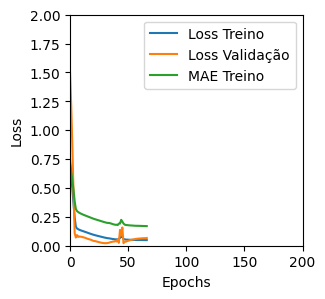

Tempo de treino: 0.386560312906901 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18885211646556854 , MAE = 0.3406306803226471'

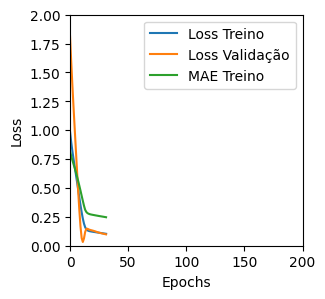

Tempo de treino: 0.11435245672861735 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12625980377197266 , MAE = 0.27238258719444275'

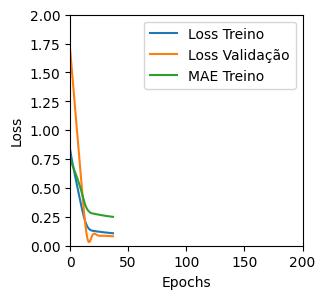

Tempo de treino: 0.08731809059778849 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3220747113227844 , MAE = 0.4445752799510956'

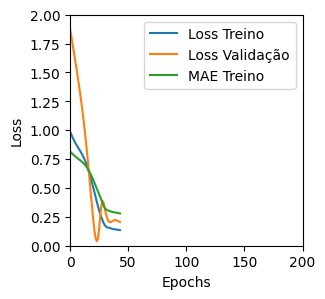

Tempo de treino: 0.1307416081428528 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05208921805024147 , MAE = 0.1821887046098709'

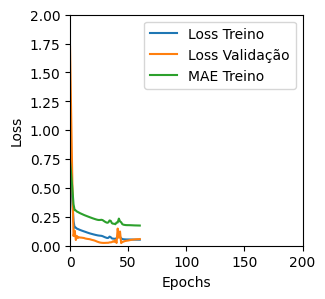

Tempo de treino: 0.28456165790557864 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1572747826576233 , MAE = 0.2969427704811096'

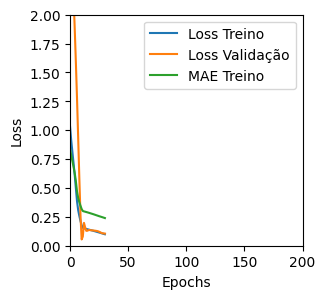

Tempo de treino: 0.14310725927352905 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1350269764661789 , MAE = 0.27772727608680725'

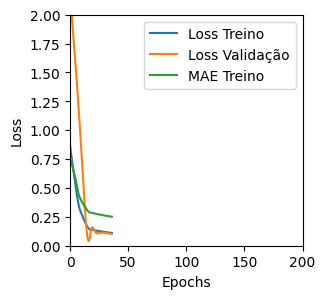

Tempo de treino: 0.12575880686442056 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13681142032146454 , MAE = 0.2783394455909729'

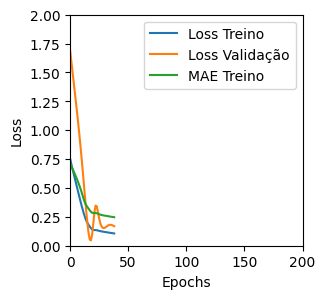

Tempo de treino: 0.08293483654658 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.046548228710889816 , MAE = 0.16968193650245667'

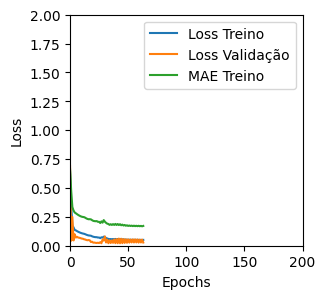

Tempo de treino: 0.23710472583770753 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13611286878585815 , MAE = 0.2816007435321808'

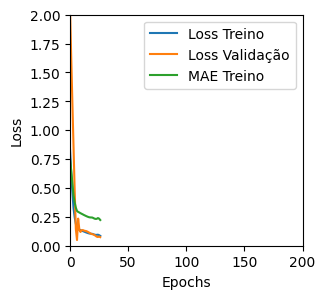

Tempo de treino: 0.12160746653874716 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18791566789150238 , MAE = 0.33544203639030457'

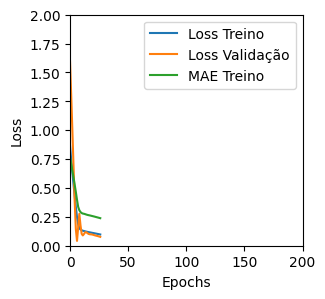

Tempo de treino: 0.07688948313395182 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14544716477394104 , MAE = 0.28519800305366516'

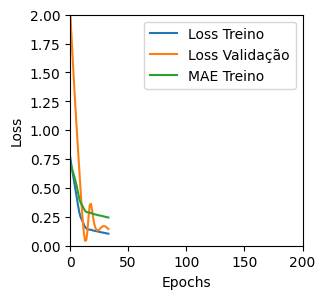

Tempo de treino: 0.15551664034525553 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11257903277873993 , MAE = 0.2579791843891144'

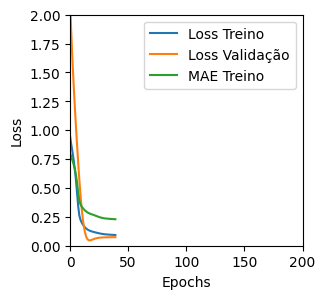

Tempo de treino: 0.21009037097295125 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.227679044008255 , MAE = 0.31724417209625244'

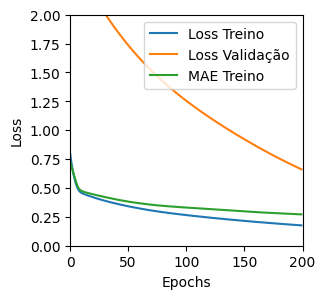

Tempo de treino: 0.7221073190371196 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07068741321563721 , MAE = 0.2082243263721466'

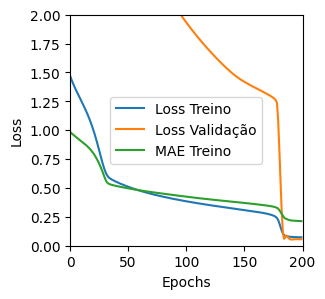

Tempo de treino: 0.3826165994008382 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5842063426971436 , MAE = 0.5871290564537048'

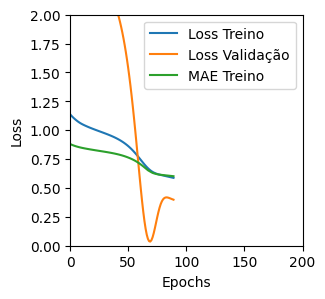

Tempo de treino: 0.21519942283630372 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.062066733837127686 , MAE = 0.18398331105709076'

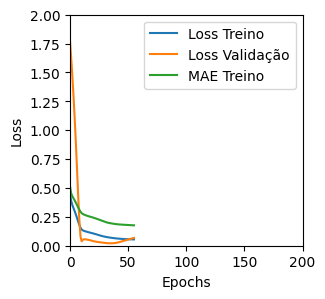

Tempo de treino: 0.20784142017364501 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1271858513355255 , MAE = 0.2682546079158783'

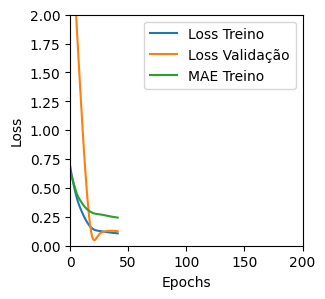

Tempo de treino: 0.12072126865386963 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12390884011983871 , MAE = 0.26755768060684204'

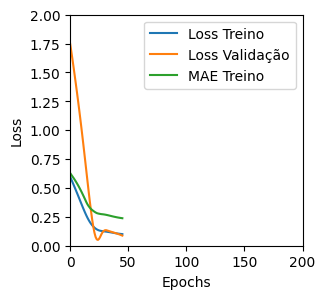

Tempo de treino: 0.1682995637257894 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11906109750270844 , MAE = 0.2669462561607361'

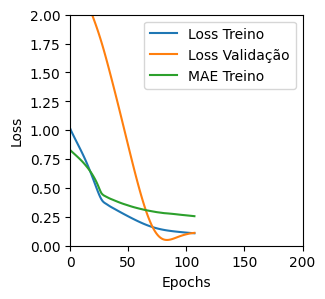

Tempo de treino: 0.16801453828811647 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13759057223796844 , MAE = 0.2787350118160248'

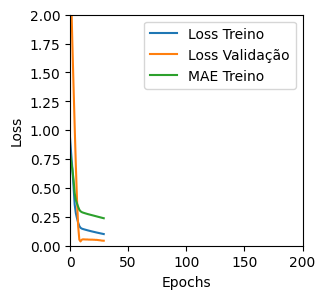

Tempo de treino: 0.14508943955103557 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14047347009181976 , MAE = 0.2773863673210144'

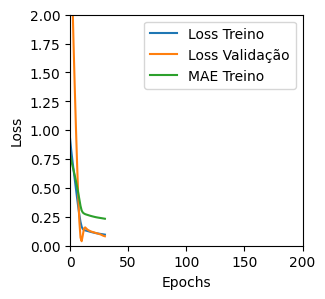

Tempo de treino: 0.1269510587056478 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15402284264564514 , MAE = 0.29671433568000793'

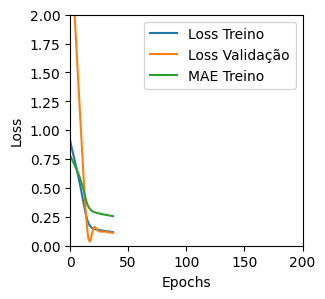

Tempo de treino: 0.10031136671702066 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14424289762973785 , MAE = 0.2774142920970917'

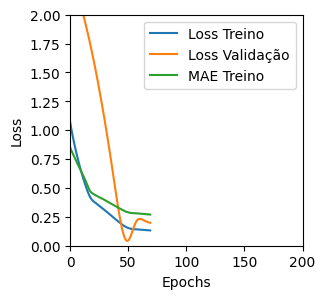

Tempo de treino: 0.12089602947235108 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04828093945980072 , MAE = 0.16607074439525604'

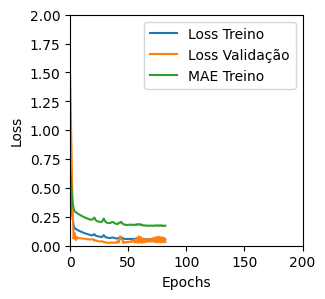

Tempo de treino: 0.29641488393147786 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15432994067668915 , MAE = 0.2941972315311432'

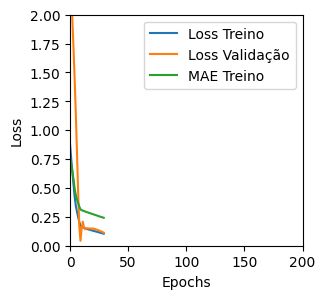

Tempo de treino: 0.15750948588053384 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v2 , timesteps=6, units=32, batch=16


'TRAINING set. Loss = 0.16071267426013947 , MAE = 0.30416014790534973'

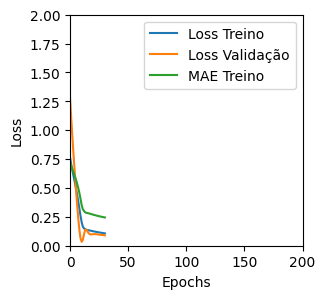

Tempo de treino: 0.14159423510233562 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14378391206264496 , MAE = 0.2784847617149353'

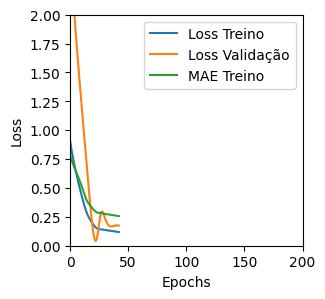

Tempo de treino: 0.1268666426340739 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05210400000214577 , MAE = 0.1748599410057068'

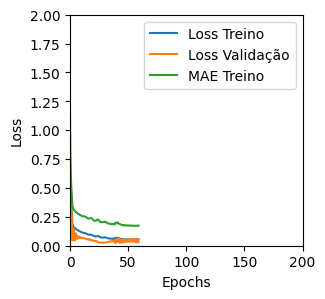

Tempo de treino: 0.38053723573684695 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14408740401268005 , MAE = 0.2826036214828491'

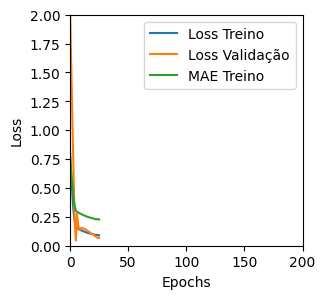

Tempo de treino: 0.08975331783294678 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16480755805969238 , MAE = 0.3084619343280792'

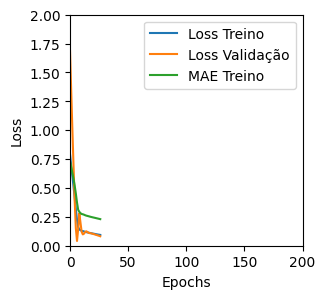

Tempo de treino: 0.08142240047454834 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27830570936203003 , MAE = 0.4139271676540375'

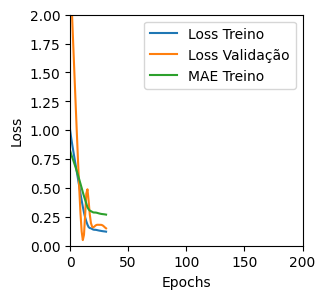

Tempo de treino: 0.0778877298037211 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3406006097793579 , MAE = 0.4611179232597351'

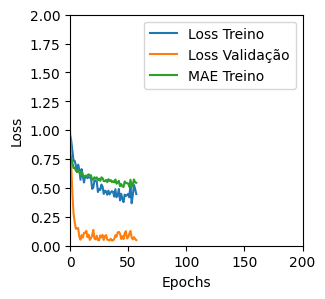

Tempo de treino: 0.24390113751093548 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14160138368606567 , MAE = 0.29353654384613037'

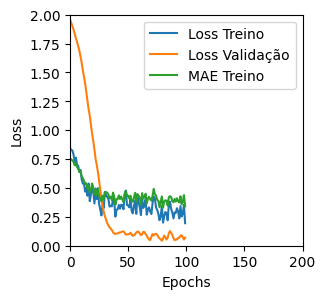

Tempo de treino: 0.23641268809636434 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1435866504907608 , MAE = 0.288571298122406'

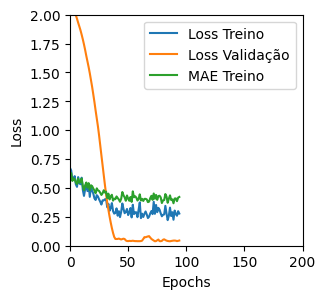

Tempo de treino: 0.21258688767751058 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5930464267730713 , MAE = 0.5904170870780945'

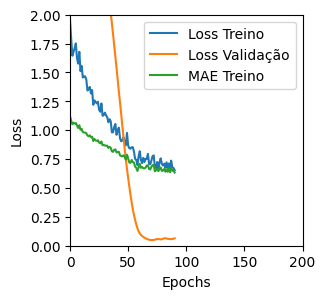

Tempo de treino: 0.14174930651982626 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11150738596916199 , MAE = 0.25180619955062866'

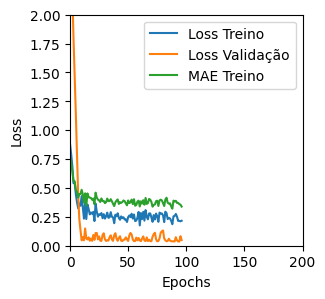

Tempo de treino: 0.3799471696217855 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12600907683372498 , MAE = 0.2619026303291321'

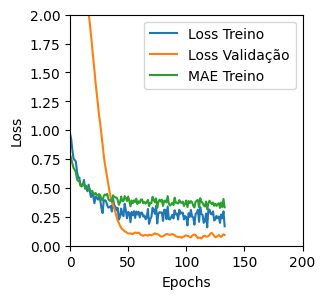

Tempo de treino: 0.2823389967282613 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17494161427021027 , MAE = 0.3126274645328522'

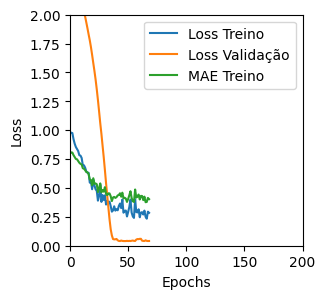

Tempo de treino: 0.20723594427108766 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14045082032680511 , MAE = 0.28392595052719116'

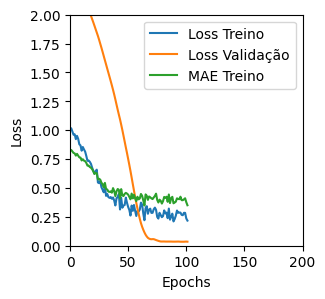

Tempo de treino: 0.25406549374262494 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09490341693162918 , MAE = 0.231750950217247'

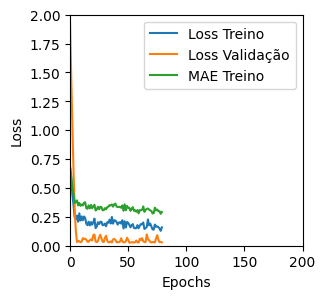

Tempo de treino: 0.3117226481437683 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11898501962423325 , MAE = 0.25282803177833557'

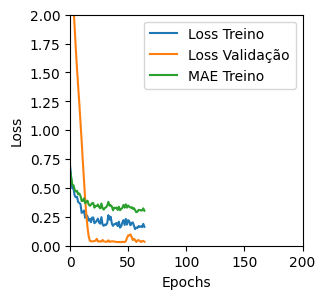

Tempo de treino: 0.212294602394104 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13710135221481323 , MAE = 0.2755003273487091'

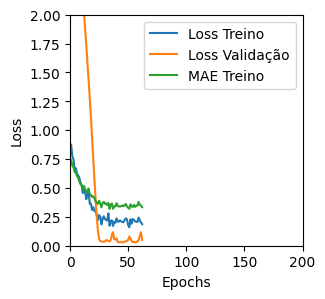

Tempo de treino: 0.21025307575861613 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14847218990325928 , MAE = 0.28602537512779236'

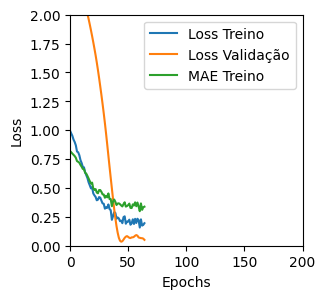

Tempo de treino: 0.12295634349187215 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05739060416817665 , MAE = 0.18119855225086212'

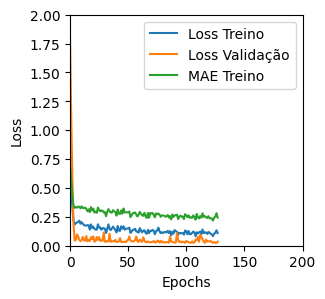

Tempo de treino: 0.7194564382235209 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08504392206668854 , MAE = 0.21372635662555695'

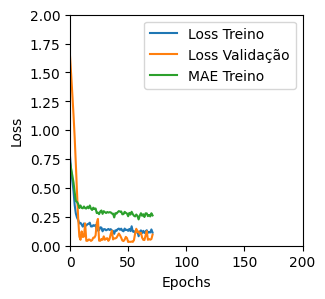

Tempo de treino: 0.2059330701828003 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11048716306686401 , MAE = 0.25127214193344116'

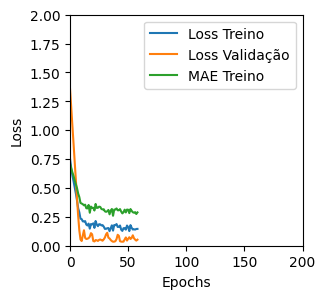

Tempo de treino: 0.222908087571462 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16501598060131073 , MAE = 0.3059227168560028'

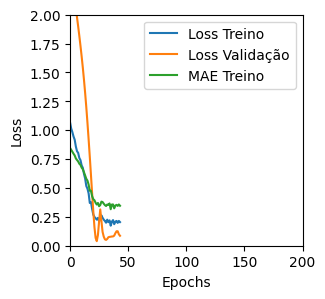

Tempo de treino: 0.1338494062423706 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05750633403658867 , MAE = 0.18288913369178772'

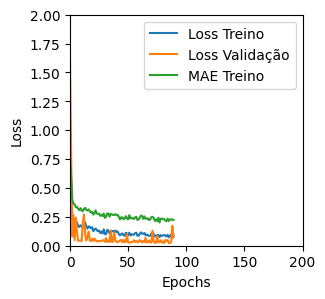

Tempo de treino: 0.3667325536410014 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12546177208423615 , MAE = 0.266014963388443'

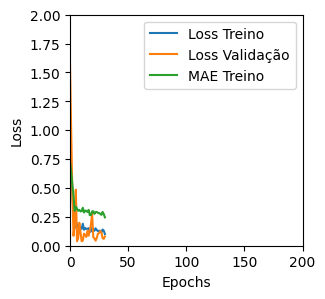

Tempo de treino: 0.12502263784408568 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.054462891072034836 , MAE = 0.17333440482616425'

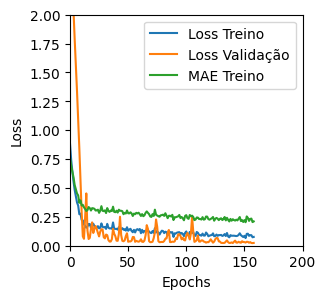

Tempo de treino: 0.29914539655049643 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1620183140039444 , MAE = 0.3074752688407898'

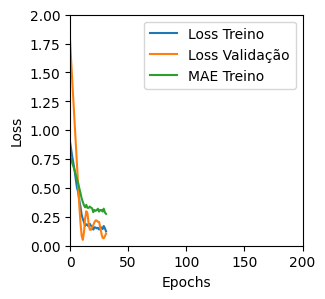

Tempo de treino: 0.08428700764973958 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com GRU_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04484773054718971 , MAE = 0.16254979372024536'

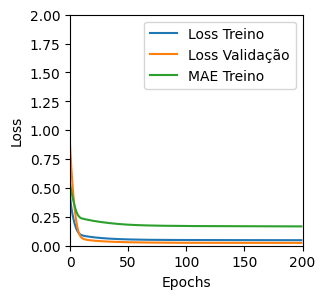

Tempo de treino: 0.7334586103757222 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.043459273874759674 , MAE = 0.1598476767539978'

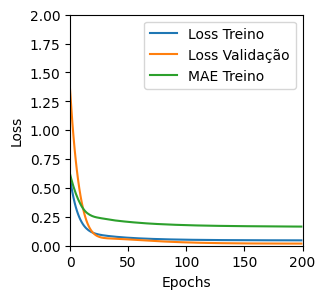

Tempo de treino: 0.49786497751871744 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048751670867204666 , MAE = 0.1710648536682129'

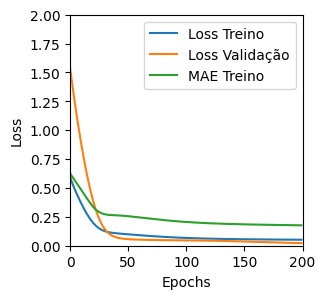

Tempo de treino: 0.39568291505177816 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05481364205479622 , MAE = 0.1833023875951767'

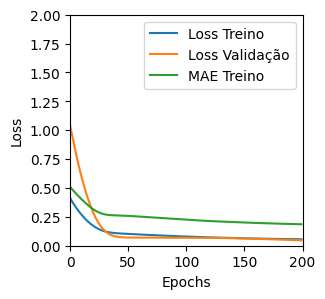

Tempo de treino: 0.3927814722061157 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04454146325588226 , MAE = 0.16230228543281555'

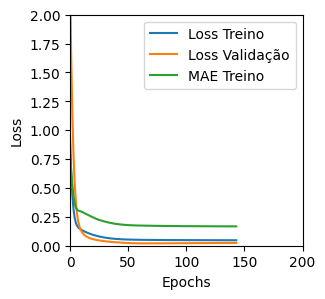

Tempo de treino: 0.7347822348276775 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04327686131000519 , MAE = 0.15906992554664612'

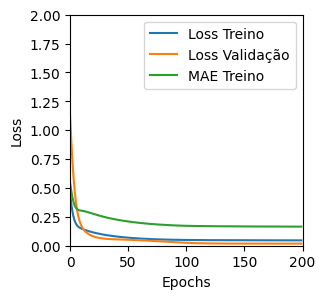

Tempo de treino: 0.5272580782572428 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04700953885912895 , MAE = 0.16866376996040344'

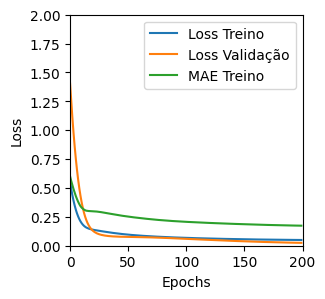

Tempo de treino: 0.3603375991185506 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07650488615036011 , MAE = 0.2179967612028122'

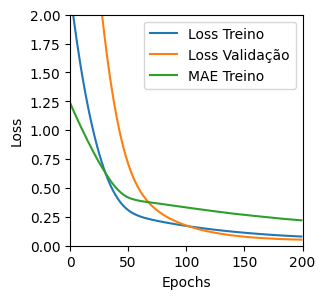

Tempo de treino: 0.391504963239034 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04754336550831795 , MAE = 0.1684853434562683'

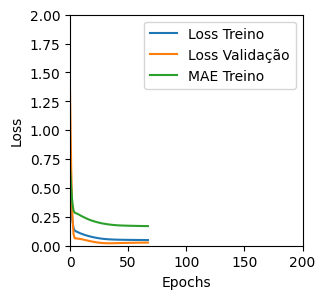

Tempo de treino: 0.38964632352193196 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04785046726465225 , MAE = 0.16761963069438934'

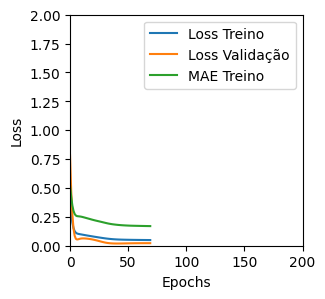

Tempo de treino: 0.3884560187657674 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12171543389558792 , MAE = 0.2829769551753998'

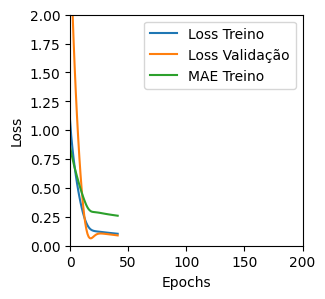

Tempo de treino: 0.1322734793027242 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04461418464779854 , MAE = 0.16313257813453674'

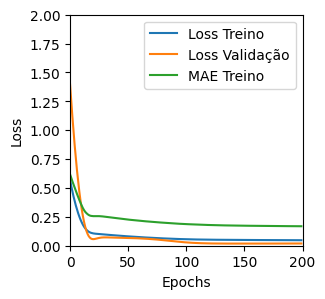

Tempo de treino: 0.2680878480275472 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.050453025847673416 , MAE = 0.17471618950366974'

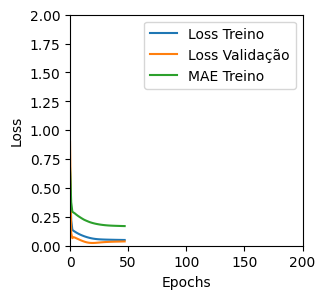

Tempo de treino: 0.2132948915163676 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04647185280919075 , MAE = 0.16588708758354187'

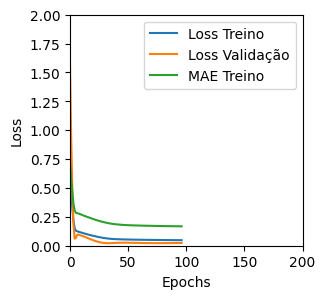

Tempo de treino: 0.23448766072591146 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04921896383166313 , MAE = 0.1715368777513504'

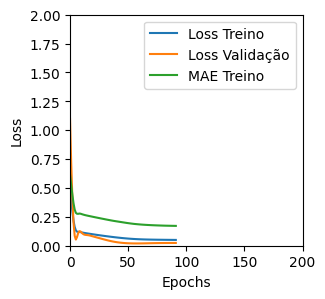

Tempo de treino: 0.20987752278645833 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13473398983478546 , MAE = 0.288136750459671'

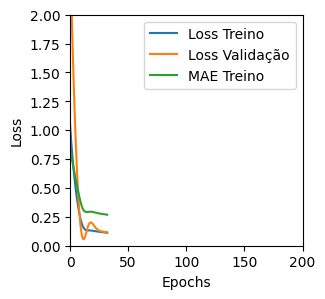

Tempo de treino: 0.0912932276725769 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.056753844022750854 , MAE = 0.18595188856124878'

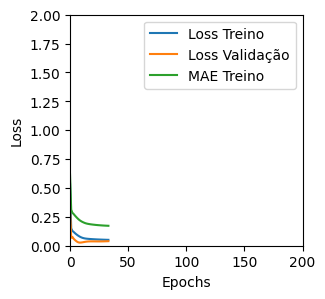

Tempo de treino: 0.1670561671257019 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0709715336561203 , MAE = 0.20631462335586548'

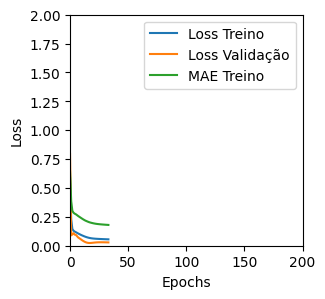

Tempo de treino: 0.1298777977625529 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08238264918327332 , MAE = 0.22395937144756317'

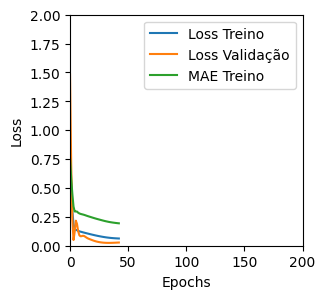

Tempo de treino: 0.13552134831746418 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08233679831027985 , MAE = 0.22456341981887817'

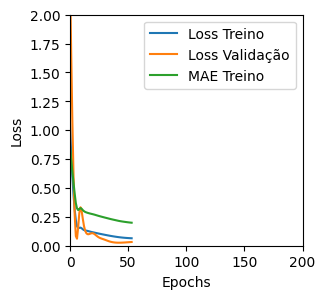

Tempo de treino: 0.12548051277796426 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49101370573043823 , MAE = 0.5445488691329956'

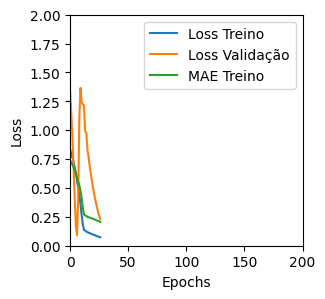

Tempo de treino: 0.10700271129608155 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16291432082653046 , MAE = 0.2921445965766907'

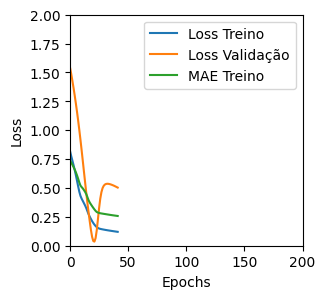

Tempo de treino: 0.10210198561350504 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4922042191028595 , MAE = 0.5499503016471863'

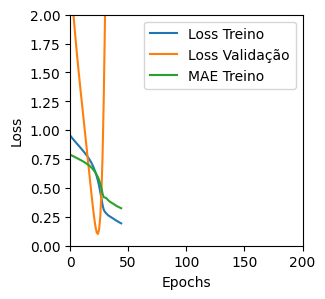

Tempo de treino: 0.07778996626536051 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.42424169182777405 , MAE = 0.43728235363960266'

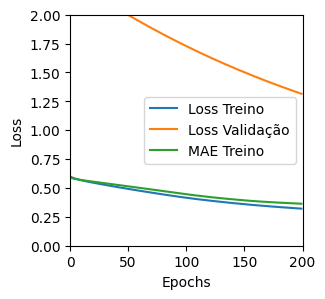

Tempo de treino: 0.23646448055903116 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1446470469236374 , MAE = 0.2810027301311493'

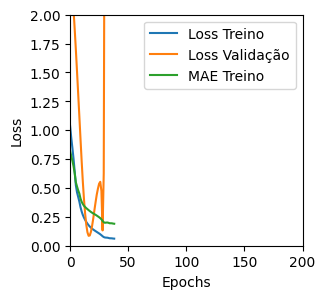

Tempo de treino: 0.20780456066131592 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4294207692146301 , MAE = 0.5122801065444946'

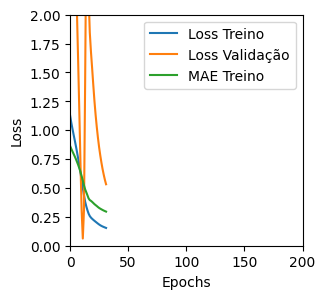

Tempo de treino: 0.12271445194880168 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14224764704704285 , MAE = 0.26736927032470703'

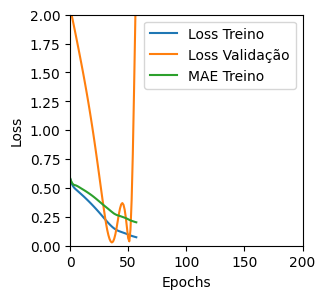

Tempo de treino: 0.14028952916463217 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18481679260730743 , MAE = 0.322361022233963'

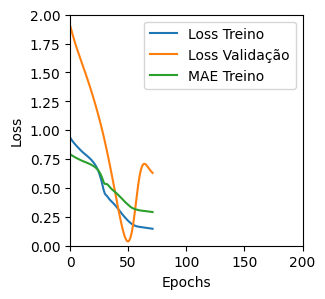

Tempo de treino: 0.12681453227996825 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4721466302871704 , MAE = 0.5486448407173157'

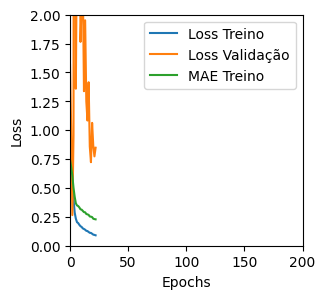

Tempo de treino: 0.1263378063837687 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30070799589157104 , MAE = 0.4184332489967346'

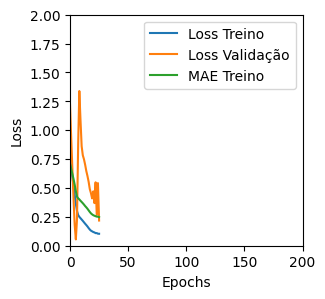

Tempo de treino: 0.11711687246958415 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18121948838233948 , MAE = 0.3176290988922119'

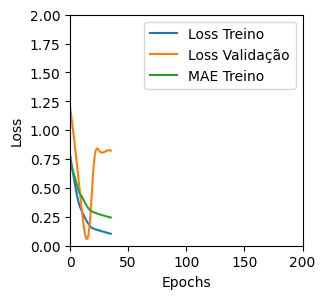

Tempo de treino: 0.07382163206736246 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4236295819282532 , MAE = 0.5096617341041565'

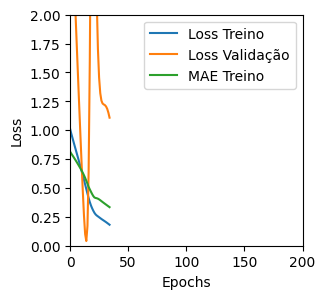

Tempo de treino: 0.07166843016942342 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06524255871772766 , MAE = 0.19215629994869232'

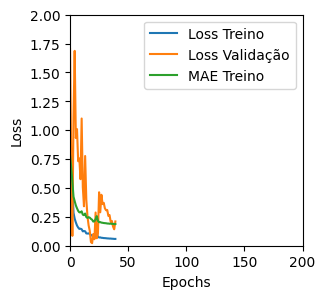

Tempo de treino: 0.14589446783065796 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07222779095172882 , MAE = 0.2042672336101532'

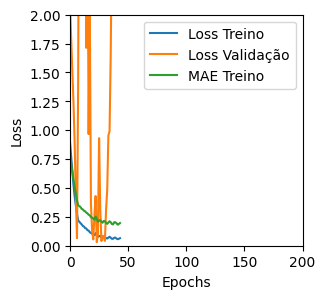

Tempo de treino: 0.11660733620325724 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09300431609153748 , MAE = 0.23185469210147858'

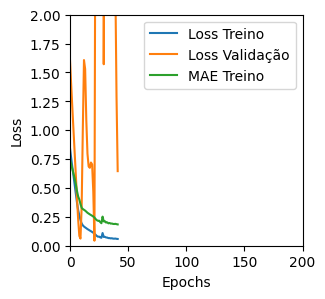

Tempo de treino: 0.14375446240107217 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22236423194408417 , MAE = 0.3626728653907776'

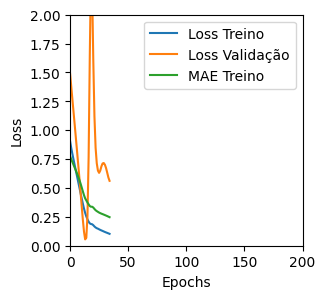

Tempo de treino: 0.09778614441553751 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07964684069156647 , MAE = 0.21630719304084778'

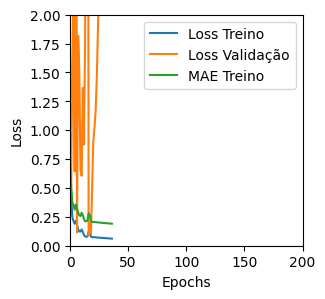

Tempo de treino: 0.17267115116119386 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07746761292219162 , MAE = 0.20506808161735535'

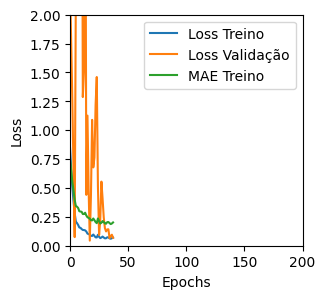

Tempo de treino: 0.11895645062128703 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0786777064204216 , MAE = 0.21005675196647644'

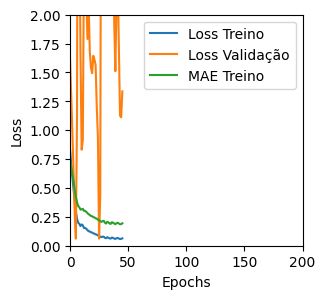

Tempo de treino: 0.10600905418395996 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23127609491348267 , MAE = 0.37107598781585693'

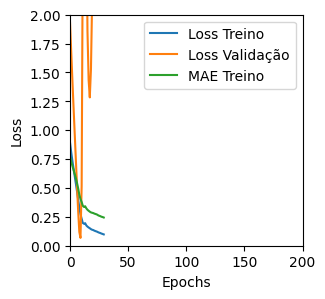

Tempo de treino: 0.06222283442815145 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06055136024951935 , MAE = 0.1830025017261505'

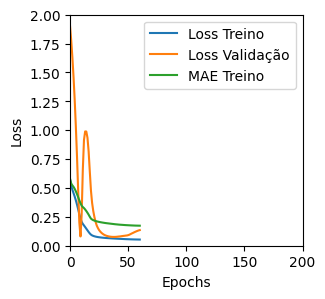

Tempo de treino: 0.16962648232777913 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.587520956993103 , MAE = 0.5773418545722961'

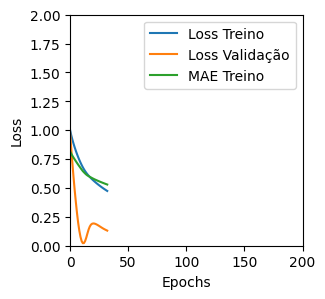

Tempo de treino: 0.07711955308914184 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07020332664251328 , MAE = 0.20539014041423798'

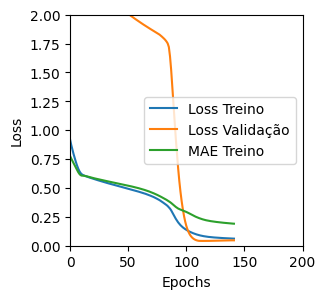

Tempo de treino: 0.27945207357406615 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.848955512046814 , MAE = 0.699032723903656'

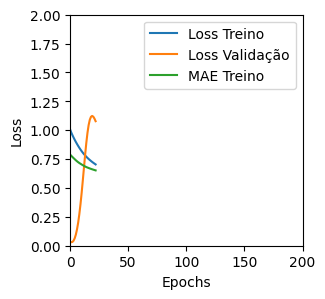

Tempo de treino: 0.08934799830118816 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19591626524925232 , MAE = 0.32058581709861755'

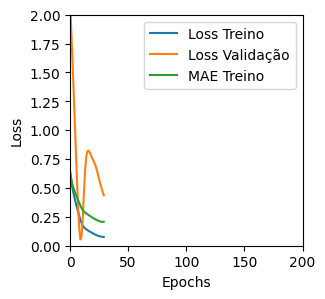

Tempo de treino: 0.20295250415802002 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6014430522918701 , MAE = 0.6152439117431641'

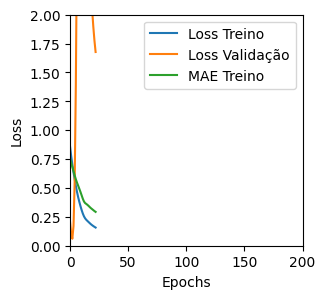

Tempo de treino: 0.08662845293680826 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3196752369403839 , MAE = 0.4242715537548065'

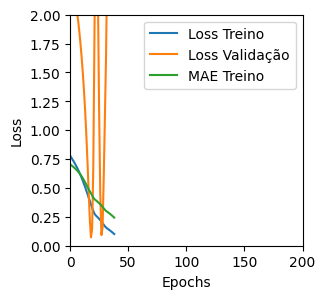

Tempo de treino: 0.12198279698689779 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2641099691390991 , MAE = 0.3806789517402649'

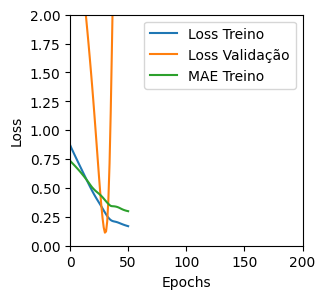

Tempo de treino: 0.09325967232386272 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10042083263397217 , MAE = 0.24402780830860138'

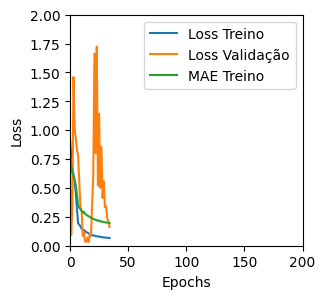

Tempo de treino: 0.20702932278315225 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5496278405189514 , MAE = 0.571224570274353'

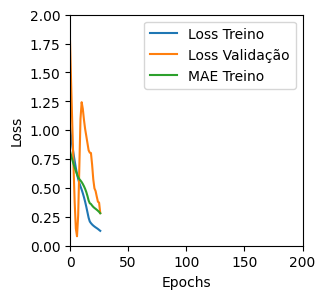

Tempo de treino: 0.14481618404388427 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31621333956718445 , MAE = 0.42119377851486206'

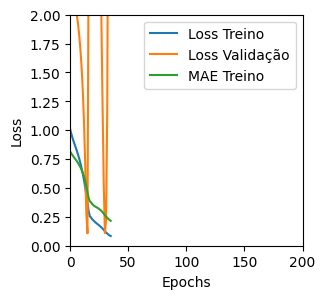

Tempo de treino: 0.11982452472050985 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22682203352451324 , MAE = 0.37485381960868835'

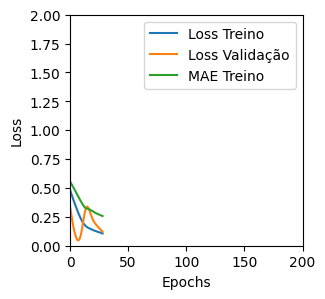

Tempo de treino: 0.07149834235509236 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23753371834754944 , MAE = 0.3568436801433563'

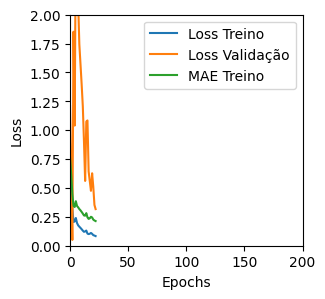

Tempo de treino: 0.10538169145584106 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06160717457532883 , MAE = 0.18682463467121124'

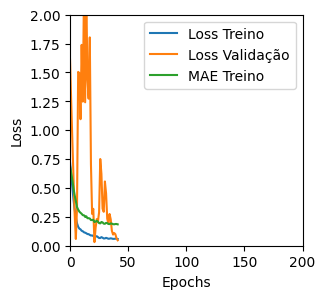

Tempo de treino: 0.10226129293441773 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2725816071033478 , MAE = 0.3834122121334076'

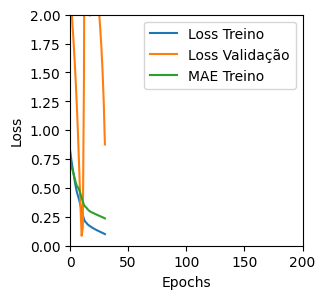

Tempo de treino: 0.11424173514048258 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21523551642894745 , MAE = 0.35471469163894653'

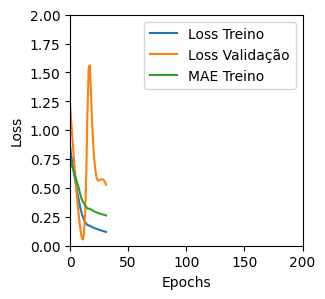

Tempo de treino: 0.06866647799809773 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08091374486684799 , MAE = 0.2204115241765976'

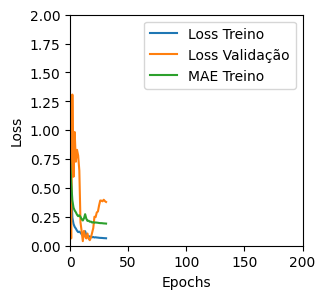

Tempo de treino: 0.13709102471669515 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07989534735679626 , MAE = 0.22057867050170898'

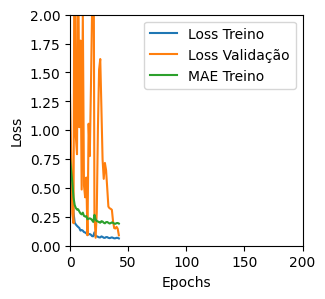

Tempo de treino: 0.1417629877726237 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2358950972557068 , MAE = 0.3563755452632904'

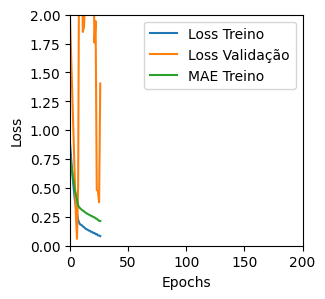

Tempo de treino: 0.08304548660914103 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2464563399553299 , MAE = 0.3621106445789337'

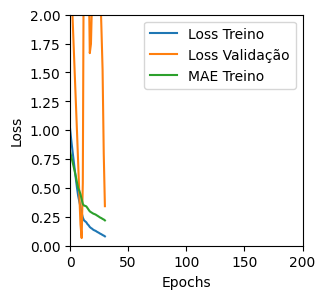

Tempo de treino: 0.080391792456309 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1300872564315796 , MAE = 0.2749314606189728'

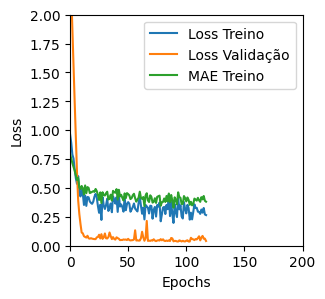

Tempo de treino: 0.37477651437123616 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36115318536758423 , MAE = 0.45568153262138367'

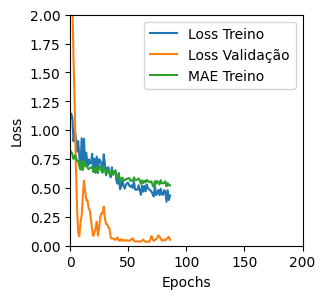

Tempo de treino: 0.17192426522572835 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26232630014419556 , MAE = 0.3951947093009949'

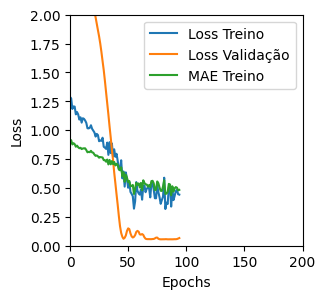

Tempo de treino: 0.12192320028940837 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18955901265144348 , MAE = 0.33096304535865784'

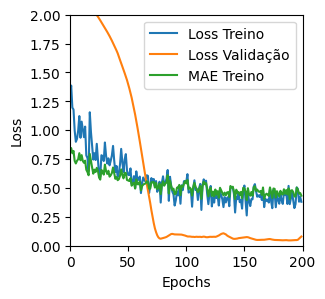

Tempo de treino: 0.2167150616645813 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.096199631690979 , MAE = 0.2305450439453125'

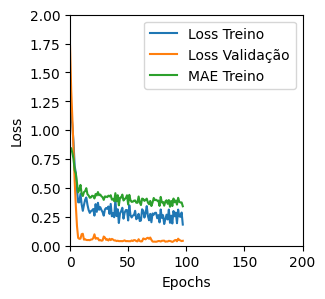

Tempo de treino: 0.30948615074157715 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29276806116104126 , MAE = 0.38774582743644714'

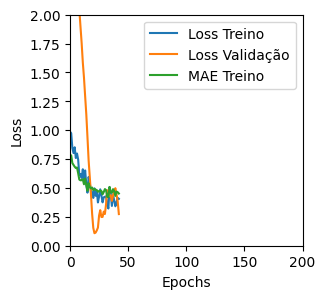

Tempo de treino: 0.12365999221801757 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5295060276985168 , MAE = 0.551652729511261'

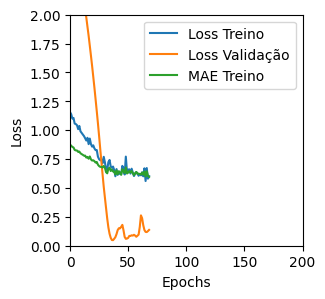

Tempo de treino: 0.12355650266011556 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6259090900421143 , MAE = 0.5901538729667664'

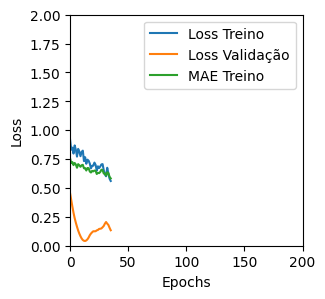

Tempo de treino: 0.083835236231486 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39716705679893494 , MAE = 0.4940110743045807'

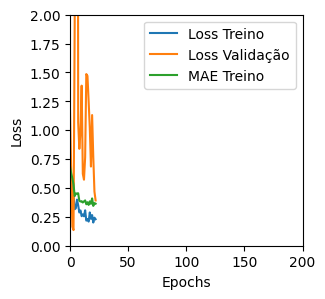

Tempo de treino: 0.09682360887527466 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2165357917547226 , MAE = 0.3389452397823334'

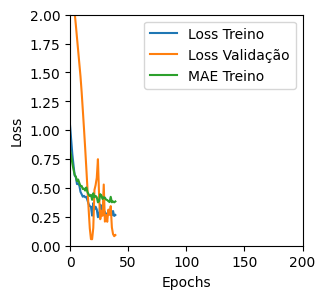

Tempo de treino: 0.09565619230270386 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22063475847244263 , MAE = 0.3404722809791565'

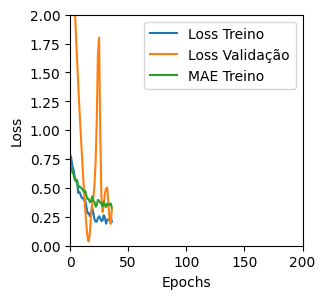

Tempo de treino: 0.08192471663157146 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.446068674325943 , MAE = 0.4938438832759857'

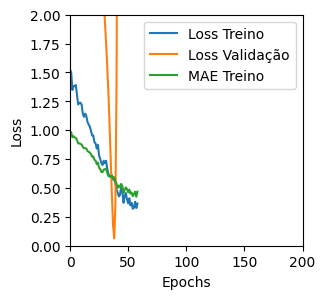

Tempo de treino: 0.12002034584681193 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07174499332904816 , MAE = 0.19696955382823944'

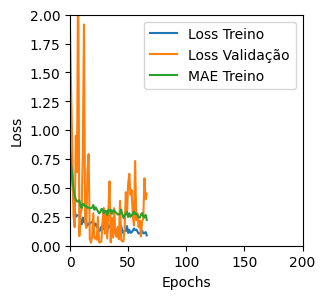

Tempo de treino: 0.2610308170318604 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07450644671916962 , MAE = 0.2017882913351059'

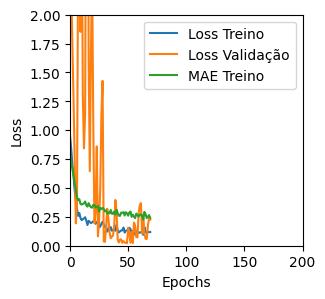

Tempo de treino: 0.15789907375971476 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23095494508743286 , MAE = 0.35167190432548523'

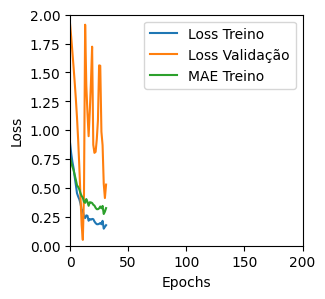

Tempo de treino: 0.08743404944737752 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23584899306297302 , MAE = 0.3528650104999542'

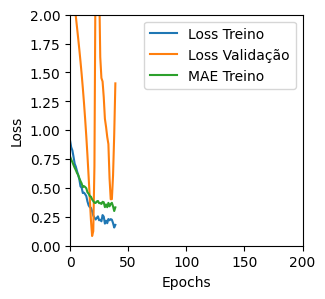

Tempo de treino: 0.08101654052734375 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07048047333955765 , MAE = 0.19522106647491455'

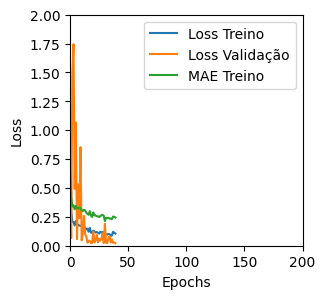

Tempo de treino: 0.1627350091934204 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11334671825170517 , MAE = 0.23964394629001617'

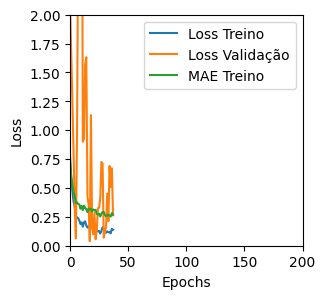

Tempo de treino: 0.11820971965789795 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2950499653816223 , MAE = 0.41367098689079285'

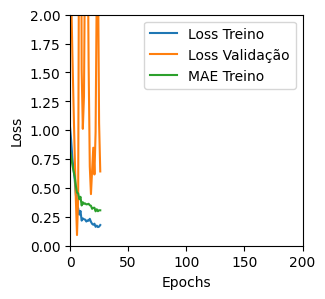

Tempo de treino: 0.06979464689890544 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.43035948276519775 , MAE = 0.5060575008392334'

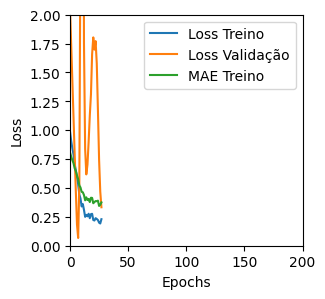

Tempo de treino: 0.07803719441095988 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com GRU_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04841949790716171 , MAE = 0.17181843519210815'

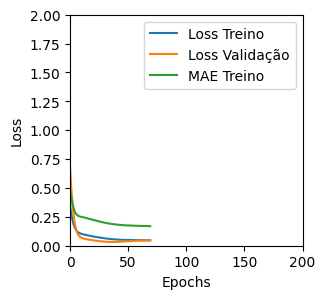

Tempo de treino: 0.2682044227917989 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04846549779176712 , MAE = 0.17040477693080902'

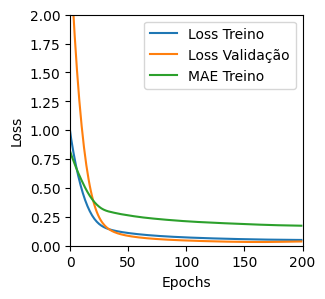

Tempo de treino: 0.3878551443417867 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.059470709413290024 , MAE = 0.19075962901115417'

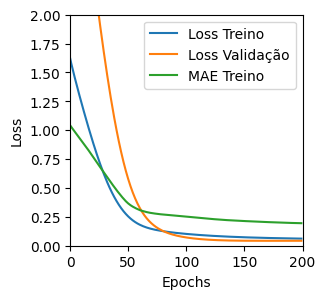

Tempo de treino: 0.3957350174585978 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06558775901794434 , MAE = 0.20503239333629608'

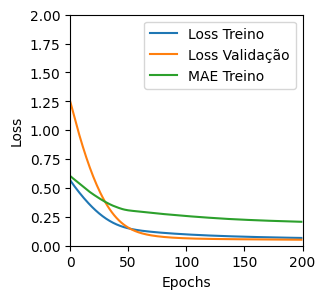

Tempo de treino: 0.39650667111078897 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.041790470480918884 , MAE = 0.15523630380630493'

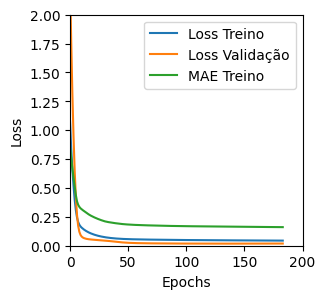

Tempo de treino: 0.5448920925458273 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04328518360853195 , MAE = 0.16067327558994293'

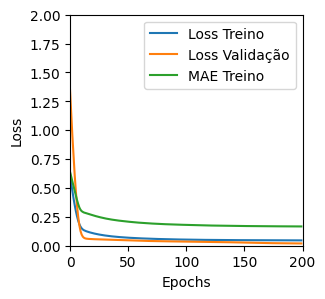

Tempo de treino: 0.48237833976745603 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04493553191423416 , MAE = 0.1620342880487442'

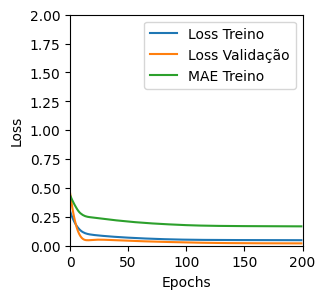

Tempo de treino: 0.3154545585314433 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06675753742456436 , MAE = 0.20400869846343994'

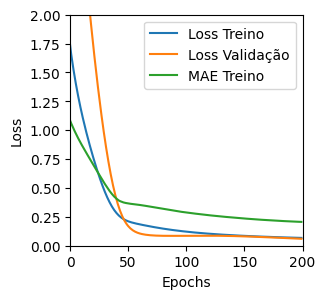

Tempo de treino: 0.30397195418675743 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04181089624762535 , MAE = 0.15619736909866333'

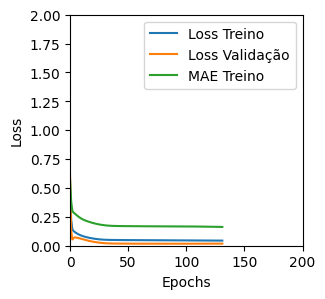

Tempo de treino: 0.7260621865590413 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04317069798707962 , MAE = 0.15886512398719788'

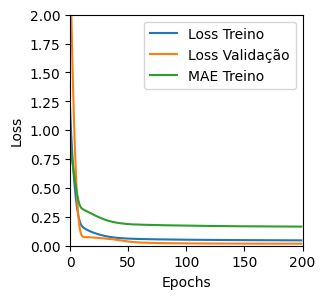

Tempo de treino: 0.40551985502243043 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0465187169611454 , MAE = 0.1647440642118454'

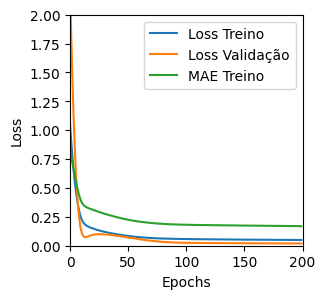

Tempo de treino: 0.3819068710009257 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com GRU_v1 , timesteps=12, units=16, batch=32


'TRAINING set. Loss = 0.05014437809586525 , MAE = 0.17749333381652832'

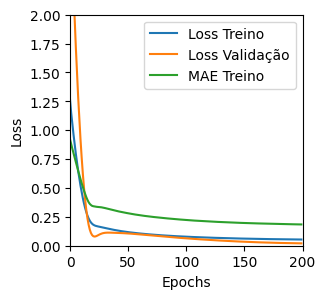

Tempo de treino: 0.3176273822784424 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04320652410387993 , MAE = 0.1578211635351181'

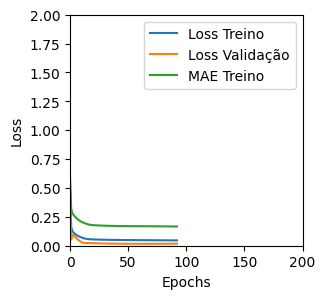

Tempo de treino: 0.33505072196324664 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.03925830498337746 , MAE = 0.14959080517292023'

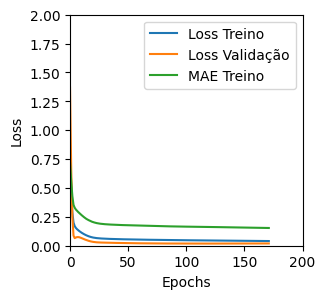

Tempo de treino: 0.38166279792785646 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04214572161436081 , MAE = 0.1572214663028717'

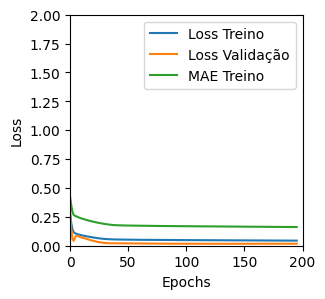

Tempo de treino: 0.2769476612408956 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04484138637781143 , MAE = 0.16378262639045715'

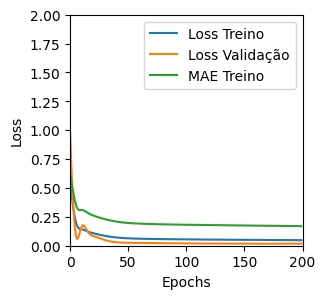

Tempo de treino: 0.4057436148325602 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04196763411164284 , MAE = 0.153702974319458'

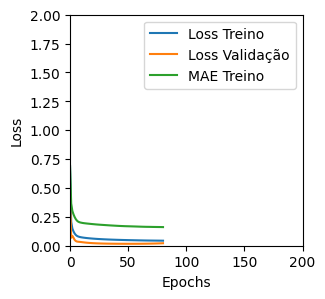

Tempo de treino: 0.3905417799949646 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04201202467083931 , MAE = 0.15580330789089203'

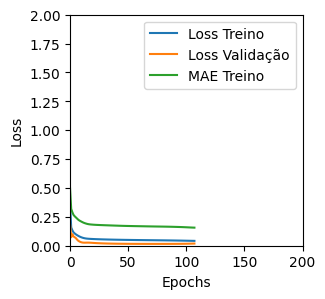

Tempo de treino: 0.3834086775779724 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.043254345655441284 , MAE = 0.15821358561515808'

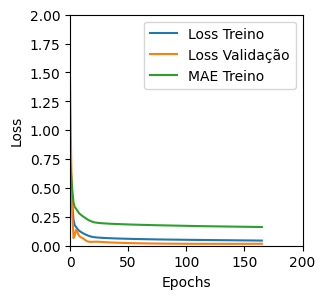

Tempo de treino: 0.23650794426600139 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04324313625693321 , MAE = 0.16061274707317352'

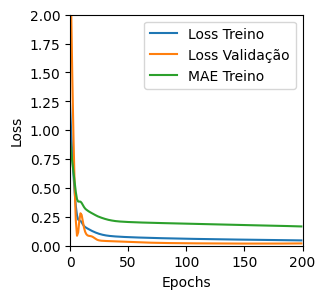

Tempo de treino: 0.26560525099436444 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05719105899333954 , MAE = 0.18264581263065338'

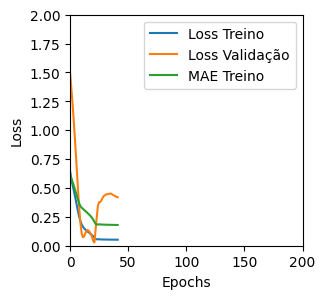

Tempo de treino: 0.3898615638415019 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32992687821388245 , MAE = 0.3990305960178375'

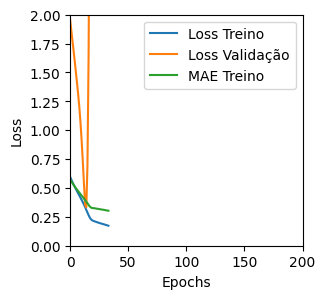

Tempo de treino: 0.17330116430918377 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4170209467411041 , MAE = 0.4330994188785553'

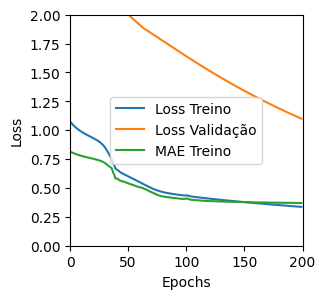

Tempo de treino: 0.3889762202898661 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7711207270622253 , MAE = 0.6567959785461426'

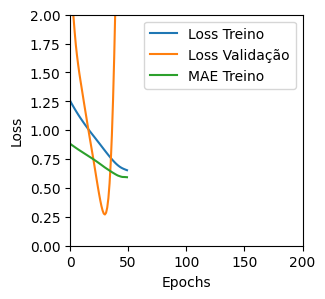

Tempo de treino: 0.12244451840718587 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4858049750328064 , MAE = 0.5305044054985046'

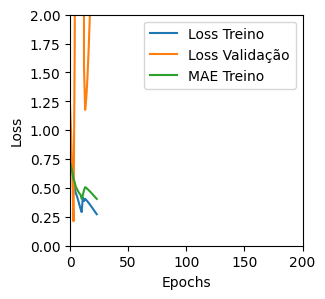

Tempo de treino: 0.13998281558354694 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5762650370597839 , MAE = 0.5757736563682556'

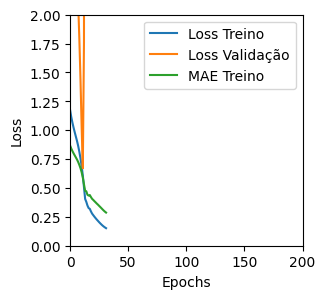

Tempo de treino: 0.1303615927696228 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33364784717559814 , MAE = 0.4223793148994446'

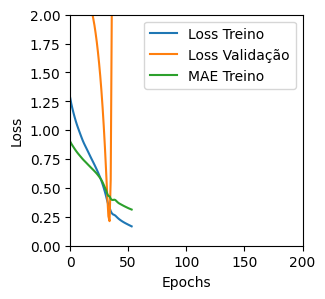

Tempo de treino: 0.20373845497767132 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5780820846557617 , MAE = 0.5863584280014038'

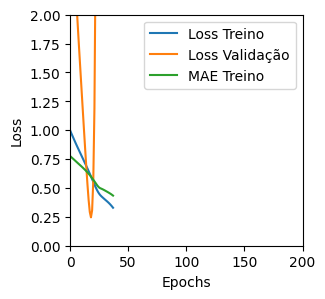

Tempo de treino: 0.11946918169657389 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36466333270072937 , MAE = 0.4536984860897064'

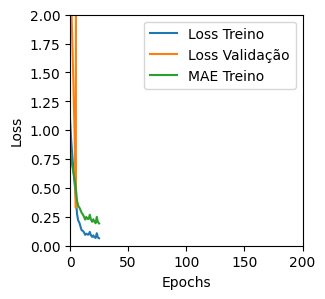

Tempo de treino: 0.2104767918586731 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5430490970611572 , MAE = 0.5653815865516663'

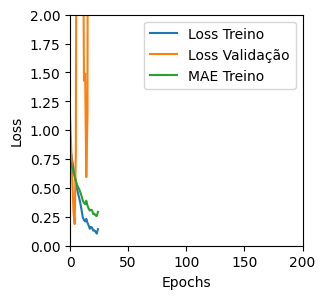

Tempo de treino: 0.14904868602752686 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4423210322856903 , MAE = 0.5077222585678101'

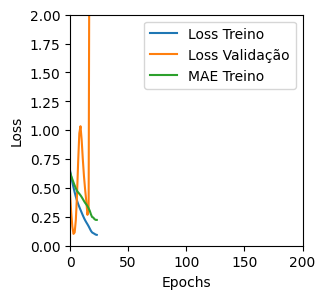

Tempo de treino: 0.09349066416422526 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3634060323238373 , MAE = 0.4692762494087219'

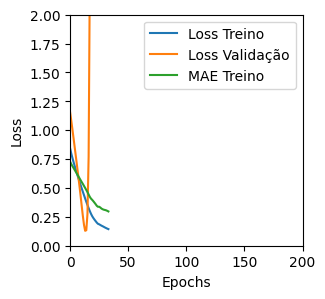

Tempo de treino: 0.08139851490656534 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.043762389570474625 , MAE = 0.16323372721672058'

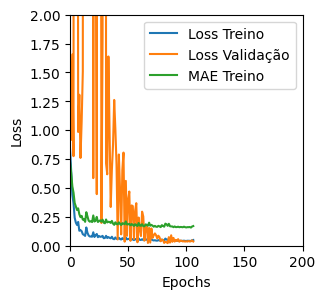

Tempo de treino: 0.5517390052477519 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1512267142534256 , MAE = 0.295073539018631'

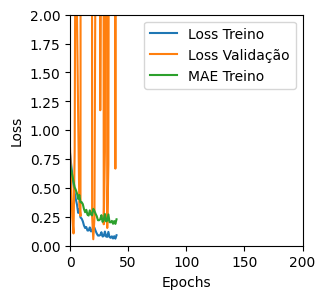

Tempo de treino: 0.20497555335362752 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27180349826812744 , MAE = 0.36984890699386597'

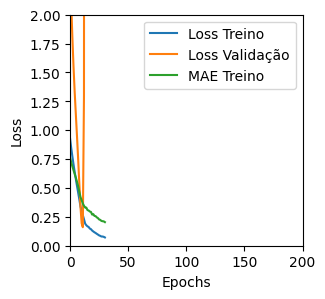

Tempo de treino: 0.08591037591298421 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4020331799983978 , MAE = 0.4938099980354309'

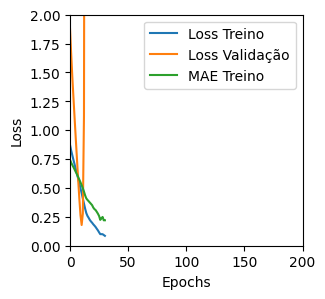

Tempo de treino: 0.1257274349530538 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10632608830928802 , MAE = 0.2467227727174759'

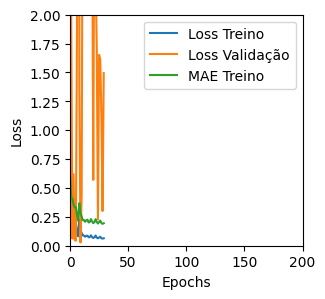

Tempo de treino: 0.24570169448852539 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.46588563919067383 , MAE = 0.5235917568206787'

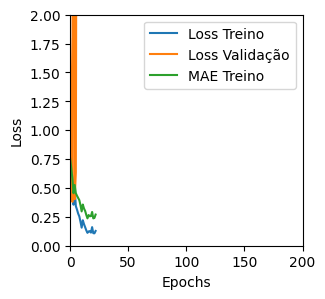

Tempo de treino: 0.21234559615453083 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3405287265777588 , MAE = 0.41295334696769714'

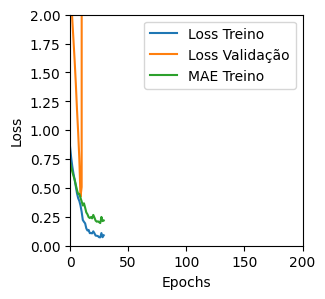

Tempo de treino: 0.11690776348114014 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39522263407707214 , MAE = 0.47672387957572937'

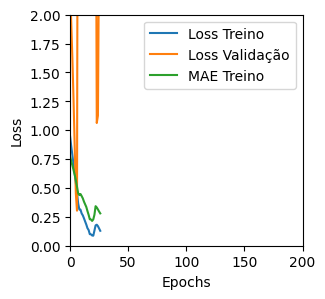

Tempo de treino: 0.08092320760091146 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.863120436668396 , MAE = 0.7177480459213257'

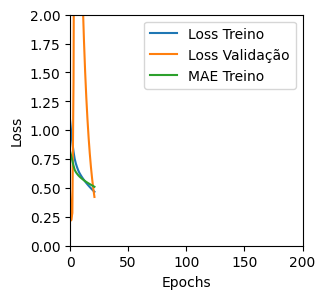

Tempo de treino: 0.14502705335617067 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31438612937927246 , MAE = 0.38564130663871765'

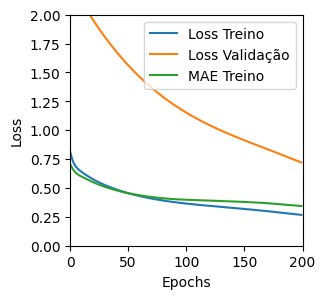

Tempo de treino: 0.5555668354034424 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16573558747768402 , MAE = 0.31546348333358765'

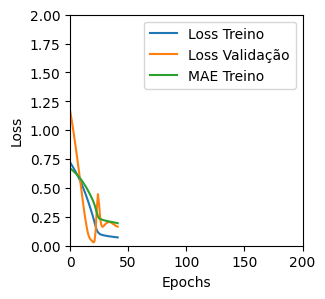

Tempo de treino: 0.13174835046132405 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.8479406833648682 , MAE = 0.6966832876205444'

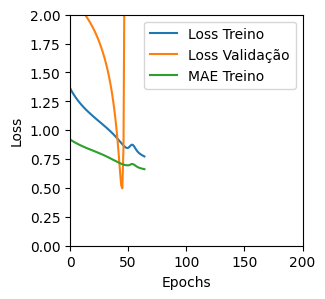

Tempo de treino: 0.23377585411071777 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35383036732673645 , MAE = 0.43286314606666565'

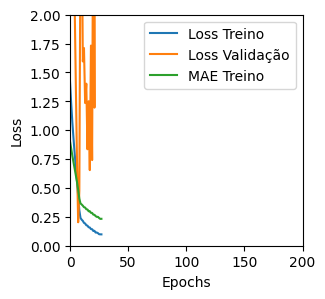

Tempo de treino: 0.22829527854919435 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49539968371391296 , MAE = 0.5553117990493774'

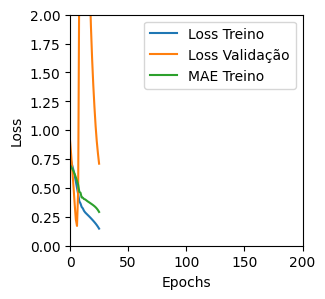

Tempo de treino: 0.14363067150115966 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20573195815086365 , MAE = 0.32951119542121887'

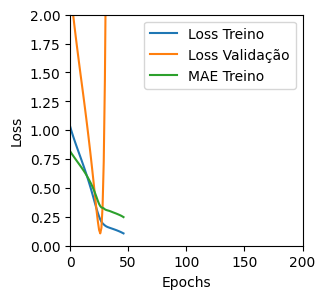

Tempo de treino: 0.2103663961092631 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6878305077552795 , MAE = 0.6360152363777161'

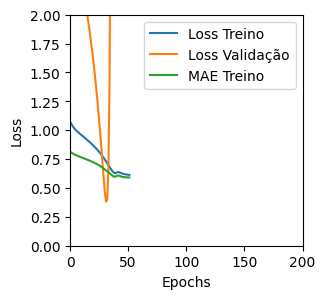

Tempo de treino: 0.10264817476272584 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2306596338748932 , MAE = 0.3761324882507324'

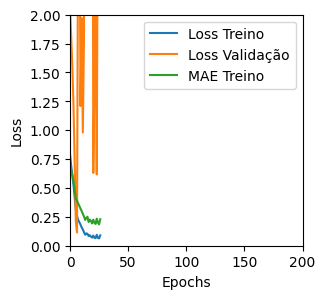

Tempo de treino: 0.1735872467358907 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3280576169490814 , MAE = 0.41975295543670654'

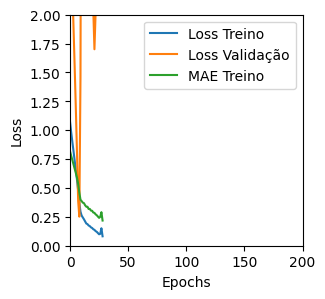

Tempo de treino: 0.133383842309316 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37940487265586853 , MAE = 0.47512897849082947'

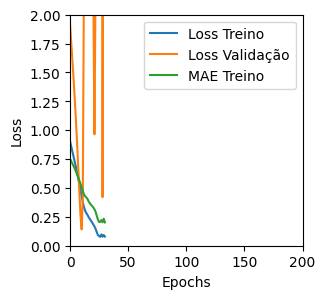

Tempo de treino: 0.1285865068435669 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4881833791732788 , MAE = 0.5340204834938049'

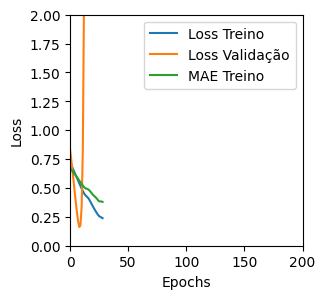

Tempo de treino: 0.144498614470164 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.03979850560426712 , MAE = 0.1463531106710434'

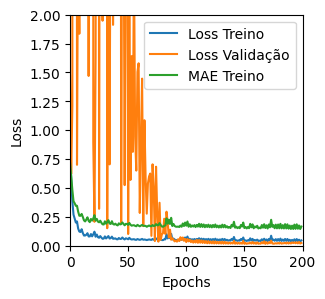

Tempo de treino: 1.4166483879089355 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4265277683734894 , MAE = 0.4994061589241028'

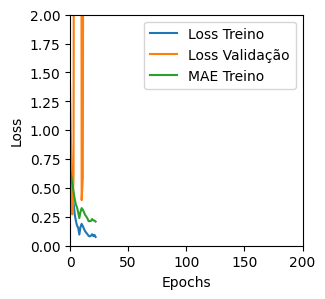

Tempo de treino: 0.12235512336095174 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47806328535079956 , MAE = 0.524867832660675'

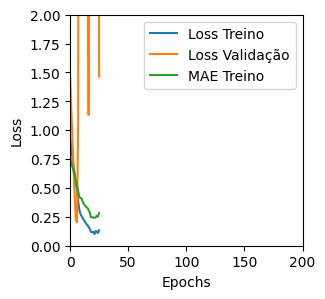

Tempo de treino: 0.08251540660858155 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35137656331062317 , MAE = 0.415213942527771'

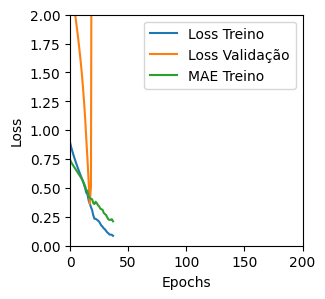

Tempo de treino: 0.09069443146387736 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0656329095363617 , MAE = 0.20359103381633759'

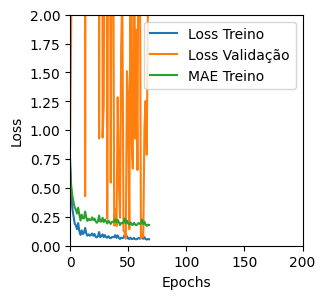

Tempo de treino: 0.40931063095728554 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33549952507019043 , MAE = 0.4431144893169403'

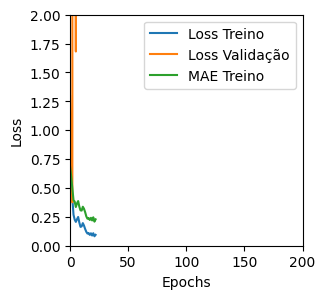

Tempo de treino: 0.14866269032160442 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21730050444602966 , MAE = 0.35110822319984436'

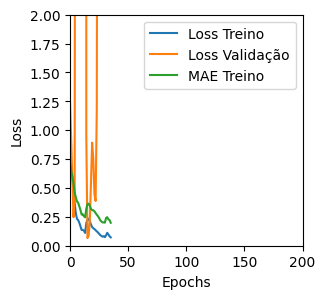

Tempo de treino: 0.2151548147201538 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41054588556289673 , MAE = 0.48148584365844727'

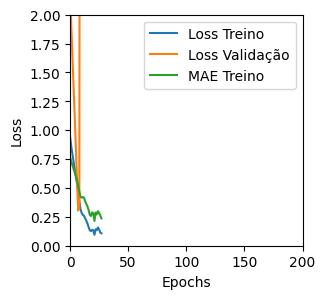

Tempo de treino: 0.09951945940653482 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22572772204875946 , MAE = 0.35391294956207275'

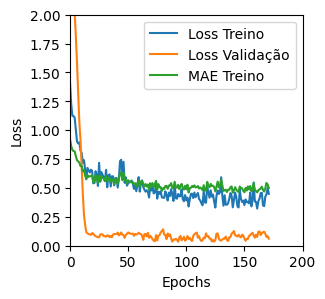

Tempo de treino: 1.4087044715881347 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3856184184551239 , MAE = 0.44799888134002686'

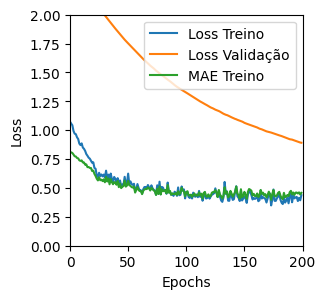

Tempo de treino: 0.5372859915097554 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.9234151244163513 , MAE = 0.7595006227493286'

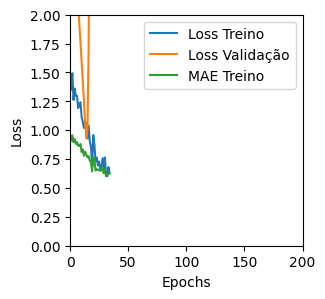

Tempo de treino: 0.10266283750534058 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31489476561546326 , MAE = 0.43370726704597473'

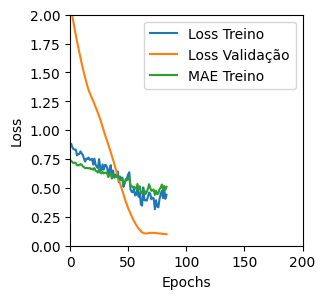

Tempo de treino: 0.1247784694035848 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1220034807920456 , MAE = 0.25662800669670105'

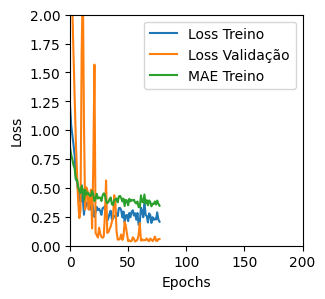

Tempo de treino: 0.41224162181218466 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6127722859382629 , MAE = 0.6202213764190674'

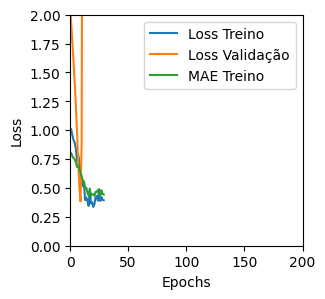

Tempo de treino: 0.13861138025919598 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1853688359260559 , MAE = 0.30683958530426025'

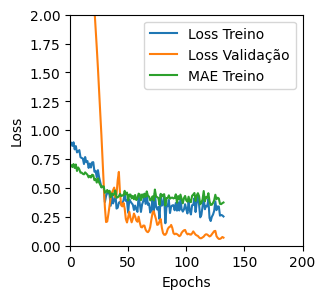

Tempo de treino: 0.38174280325571697 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.43094608187675476 , MAE = 0.4942522346973419'

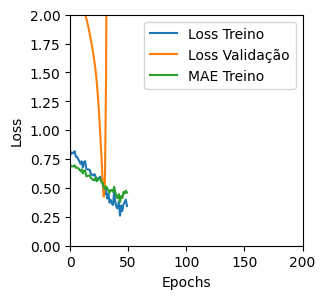

Tempo de treino: 0.12305728594462077 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.439341276884079 , MAE = 0.48891302943229675'

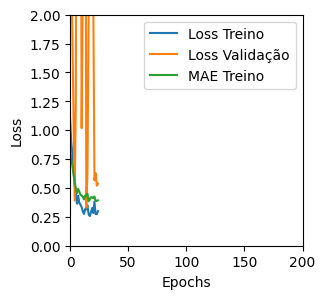

Tempo de treino: 0.21134493350982667 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1009109765291214 , MAE = 0.2330712080001831'

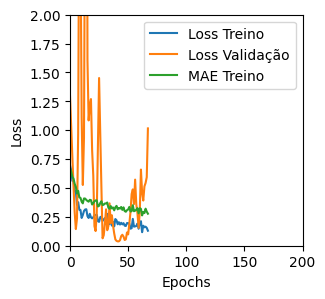

Tempo de treino: 0.21408549149831135 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09781967103481293 , MAE = 0.2296355962753296'

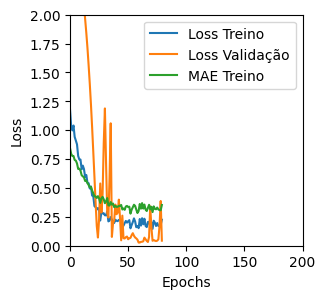

Tempo de treino: 0.20549376010894777 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3535609245300293 , MAE = 0.44671064615249634'

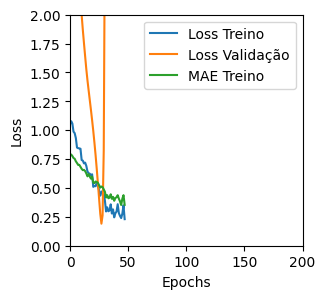

Tempo de treino: 0.12220791578292847 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05537053197622299 , MAE = 0.17728522419929504'

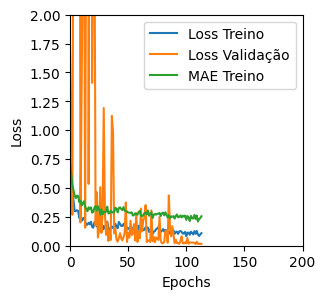

Tempo de treino: 0.7407425880432129 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1374264359474182 , MAE = 0.26738861203193665'

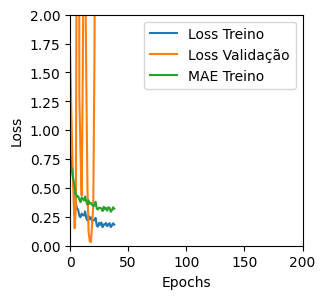

Tempo de treino: 0.15893543163935345 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41272586584091187 , MAE = 0.49922308325767517'

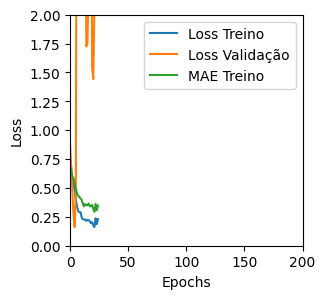

Tempo de treino: 0.07938295205434164 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.42020705342292786 , MAE = 0.49837204813957214'

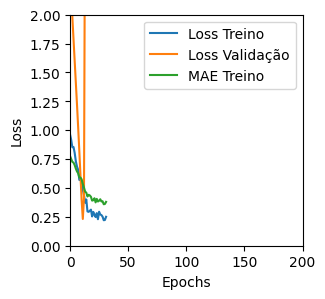

Tempo de treino: 0.09332153797149659 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0612696036696434 , MAE = 0.1892348825931549'

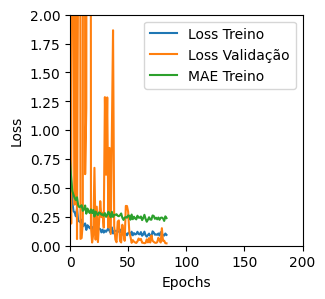

Tempo de treino: 0.7213678359985352 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3857254087924957 , MAE = 0.459807813167572'

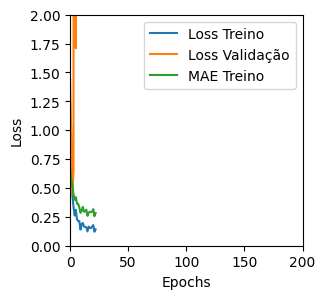

Tempo de treino: 0.11283357540766398 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29655539989471436 , MAE = 0.3905249834060669'

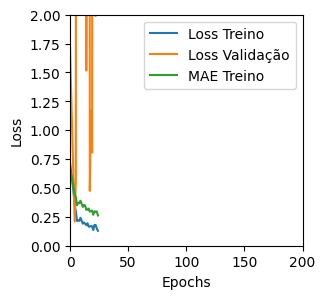

Tempo de treino: 0.14696088631947835 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3300325870513916 , MAE = 0.42065978050231934'

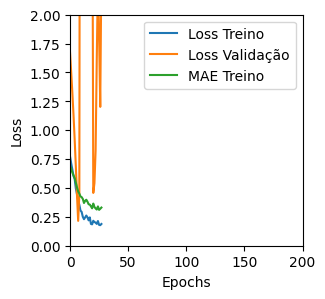

Tempo de treino: 0.09363776445388794 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com GRU_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04593189060688019 , MAE = 0.1640024483203888'

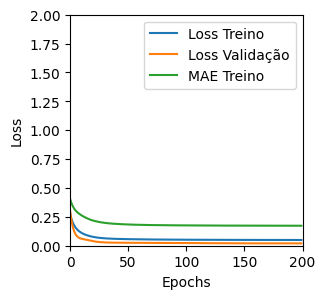

Tempo de treino: 1.4185343384742737 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.055422019213438034 , MAE = 0.18262265622615814'

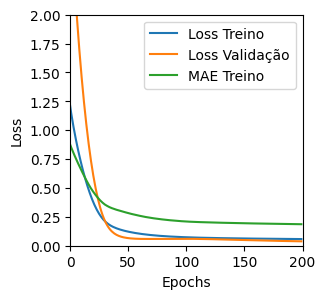

Tempo de treino: 0.6643033822377523 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08921574801206589 , MAE = 0.22837355732917786'

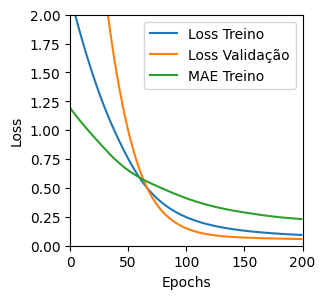

Tempo de treino: 0.7258794029553731 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13652370870113373 , MAE = 0.30854031443595886'

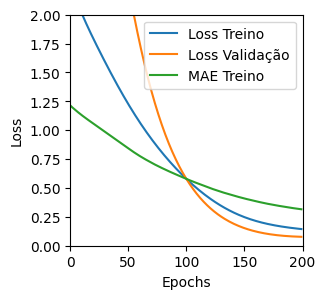

Tempo de treino: 0.39357850948969525 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.037544820457696915 , MAE = 0.1509522795677185'

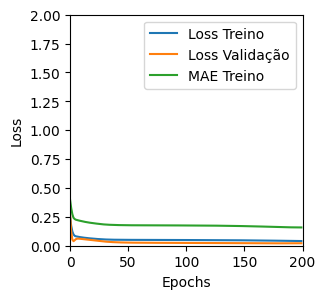

Tempo de treino: 1.4239134828249613 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048056576400995255 , MAE = 0.16741785407066345'

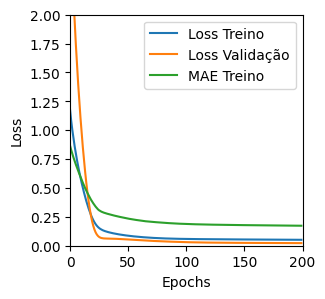

Tempo de treino: 0.6475314140319824 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04832514747977257 , MAE = 0.17000381648540497'

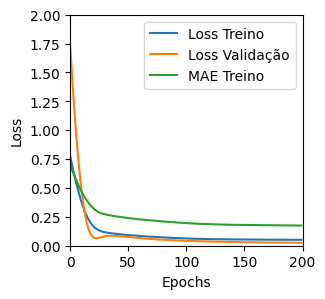

Tempo de treino: 0.4304543217023214 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06248394027352333 , MAE = 0.1964179277420044'

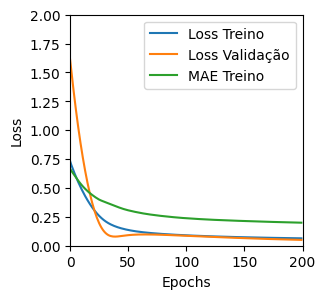

Tempo de treino: 0.3364652593930562 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.045362912118434906 , MAE = 0.16393065452575684'

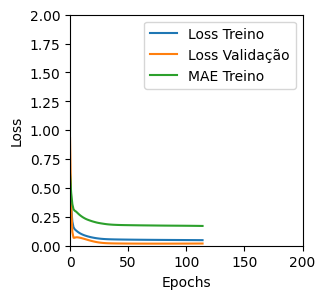

Tempo de treino: 1.4575761675834655 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.046060167253017426 , MAE = 0.1642134189605713'

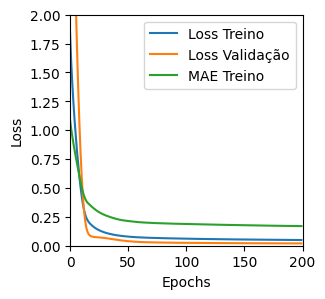

Tempo de treino: 0.6671511014302571 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04746883362531662 , MAE = 0.16883139312267303'

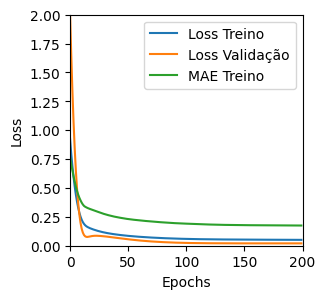

Tempo de treino: 0.4142372290293376 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27433863282203674 , MAE = 0.41749972105026245'

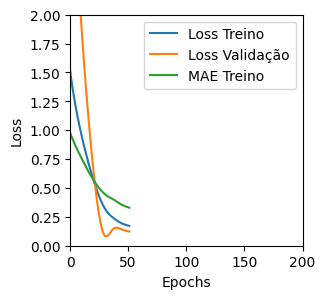

Tempo de treino: 0.13057451645533244 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04484046995639801 , MAE = 0.1634775996208191'

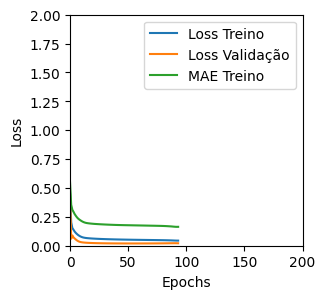

Tempo de treino: 0.5907580057779948 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04108301177620888 , MAE = 0.15485049784183502'

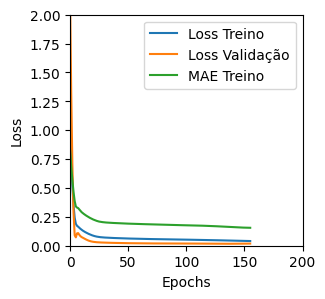

Tempo de treino: 0.5355163097381592 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04725189879536629 , MAE = 0.16681411862373352'

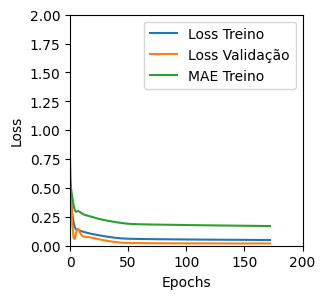

Tempo de treino: 0.7286519328753154 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05371374636888504 , MAE = 0.17703720927238464'

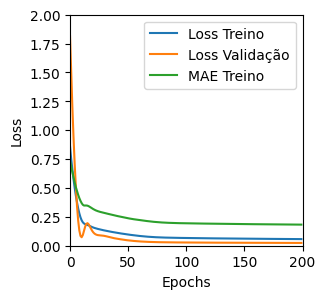

Tempo de treino: 0.38424408435821533 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06043863296508789 , MAE = 0.18875932693481445'

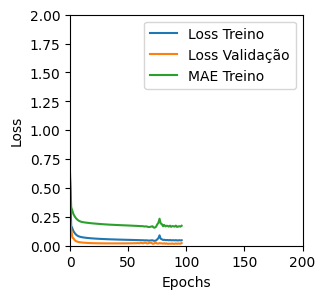

Tempo de treino: 0.5868508179982503 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04211921989917755 , MAE = 0.15735064446926117'

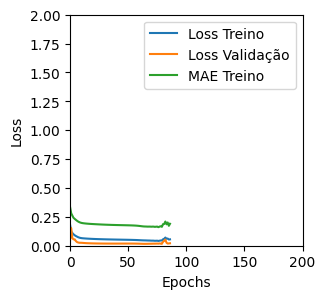

Tempo de treino: 0.351935887336731 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04793258756399155 , MAE = 0.16735681891441345'

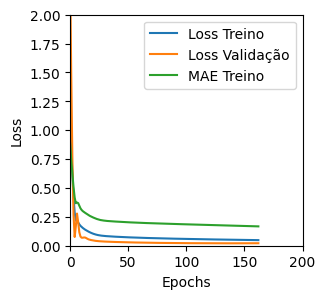

Tempo de treino: 0.3780505617459615 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.052441660314798355 , MAE = 0.17524592578411102'

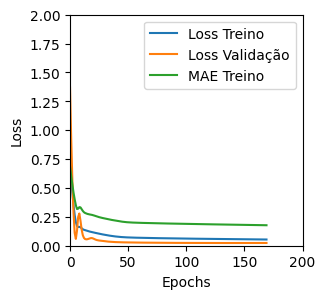

Tempo de treino: 0.2784915010134379 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.049957189708948135 , MAE = 0.1766984611749649'

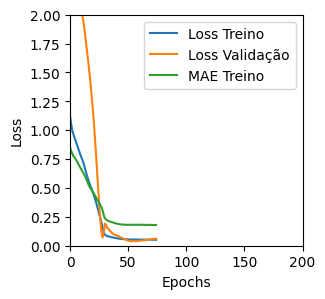

Tempo de treino: 0.38823612928390505 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5545943975448608 , MAE = 0.5473710894584656'

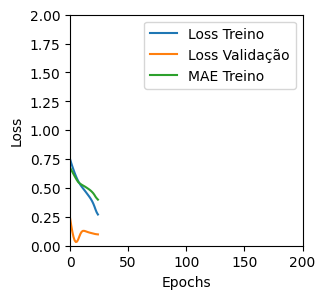

Tempo de treino: 0.1350281556447347 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.0159873962402344 , MAE = 0.7624896168708801'

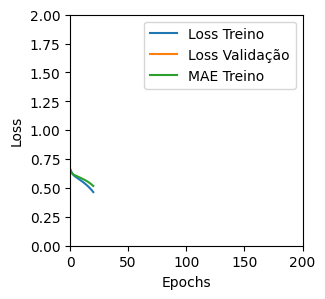

Tempo de treino: 0.08469472726186117 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15362802147865295 , MAE = 0.3026292026042938'

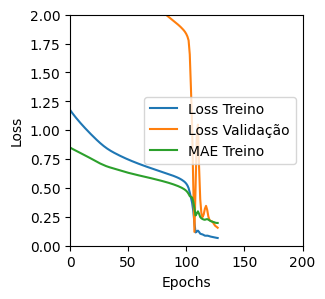

Tempo de treino: 0.21444390614827474 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04332708194851875 , MAE = 0.15939763188362122'

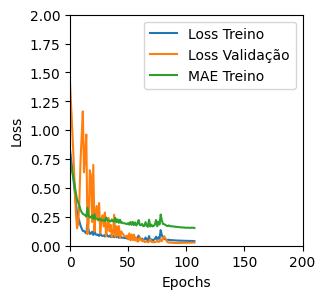

Tempo de treino: 0.7251794656117757 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31304657459259033 , MAE = 0.4249546229839325'

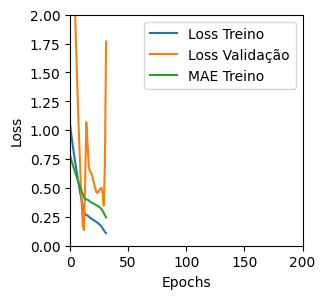

Tempo de treino: 0.14687816699345907 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.44950956106185913 , MAE = 0.44849708676338196'

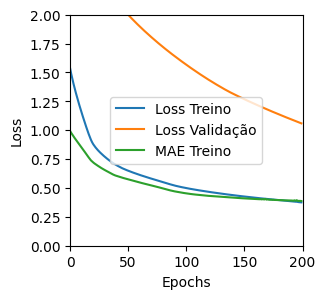

Tempo de treino: 0.3607263922691345 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.548392117023468 , MAE = 0.4968894422054291'

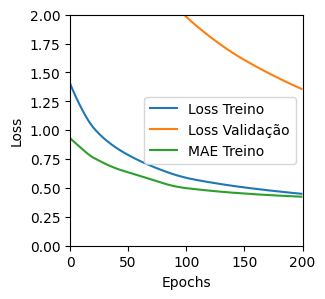

Tempo de treino: 0.3835703134536743 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33567896485328674 , MAE = 0.4359188377857208'

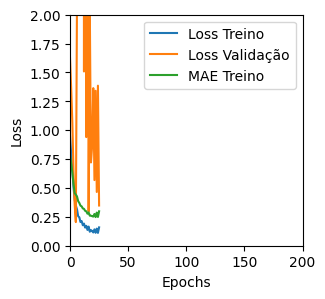

Tempo de treino: 0.20463342269261678 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7643839716911316 , MAE = 0.6751325130462646'

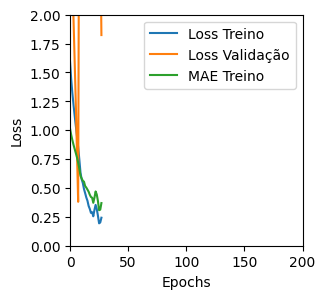

Tempo de treino: 0.1593208948771159 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5935947895050049 , MAE = 0.5993846654891968'

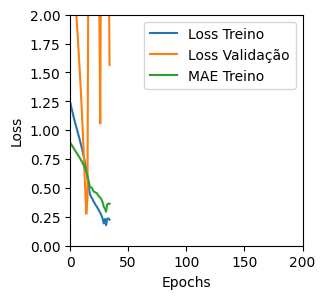

Tempo de treino: 0.11785966157913208 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3779713213443756 , MAE = 0.47239503264427185'

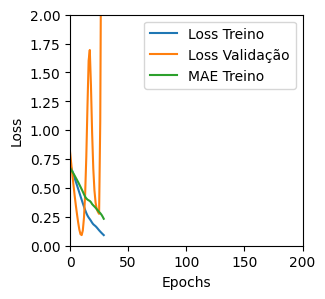

Tempo de treino: 0.07915221055348715 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.057992685586214066 , MAE = 0.1785551905632019'

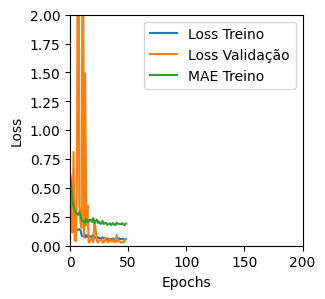

Tempo de treino: 0.3186919609705607 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35595598816871643 , MAE = 0.4533482789993286'

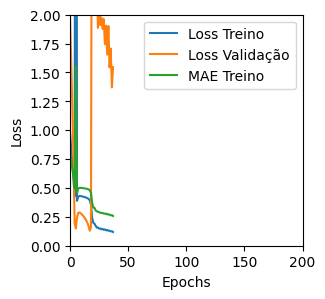

Tempo de treino: 0.15814633369445802 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41341766715049744 , MAE = 0.46882233023643494'

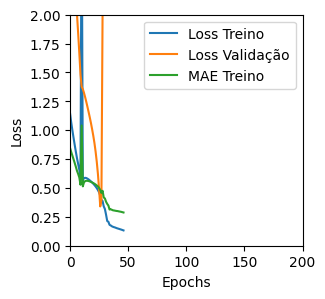

Tempo de treino: 0.20411205689112347 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4360002279281616 , MAE = 0.505511462688446'

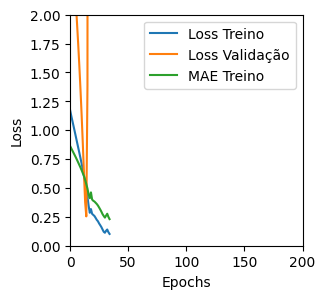

Tempo de treino: 0.11812903483708699 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07957971841096878 , MAE = 0.22150486707687378'

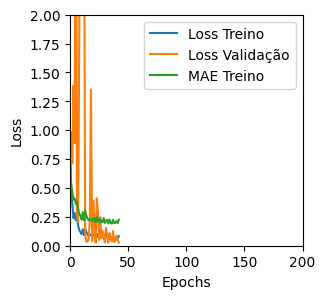

Tempo de treino: 0.34706198374430336 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11818645894527435 , MAE = 0.2518334984779358'

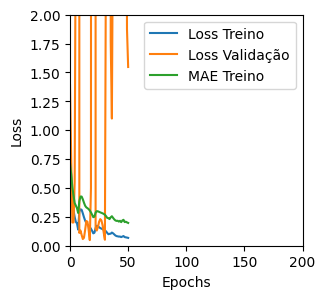

Tempo de treino: 0.24397752285003663 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09001385420560837 , MAE = 0.23213373124599457'

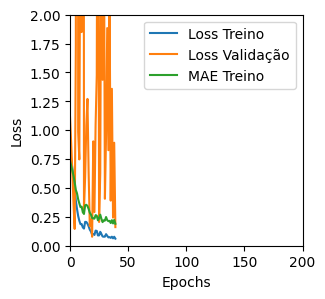

Tempo de treino: 0.12154355446497599 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4542399048805237 , MAE = 0.5185402035713196'

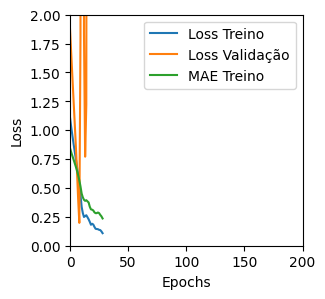

Tempo de treino: 0.09229283332824707 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12120366096496582 , MAE = 0.25598984956741333'

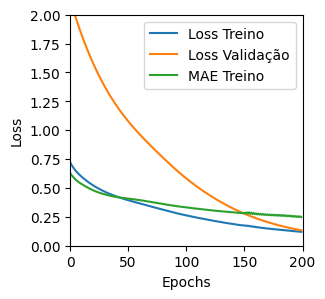

Tempo de treino: 1.4002866705258687 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05681004002690315 , MAE = 0.17476873099803925'

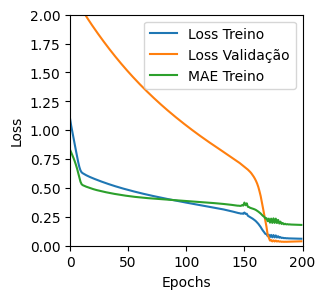

Tempo de treino: 0.7169561107953389 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.9200853109359741 , MAE = 0.7554458975791931'

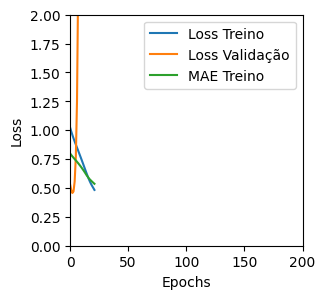

Tempo de treino: 0.118718155225118 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6009047031402588 , MAE = 0.5932865142822266'

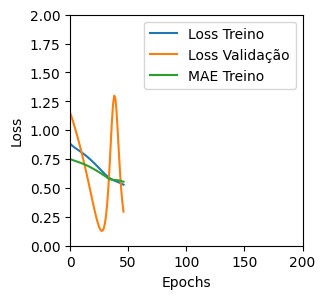

Tempo de treino: 0.11912991603215535 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06456062197685242 , MAE = 0.19704781472682953'

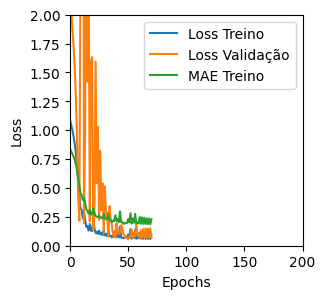

Tempo de treino: 0.3970645229021708 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4859986901283264 , MAE = 0.5206495523452759'

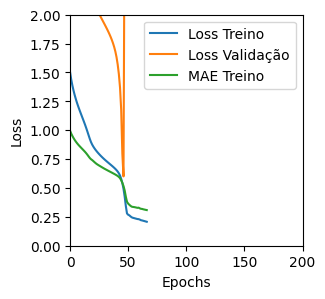

Tempo de treino: 0.3824179569880168 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.511717677116394 , MAE = 0.5210421085357666'

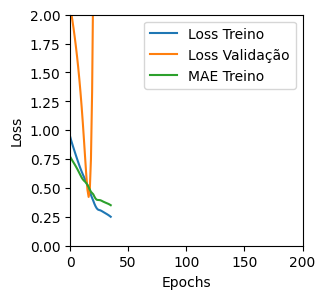

Tempo de treino: 0.12126712004343669 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.536077618598938 , MAE = 0.5366132259368896'

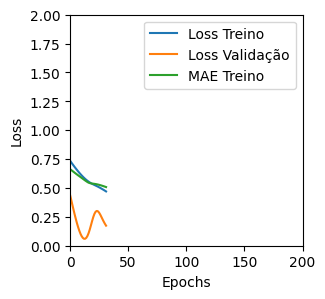

Tempo de treino: 0.07653201421101888 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06999128311872482 , MAE = 0.19474200904369354'

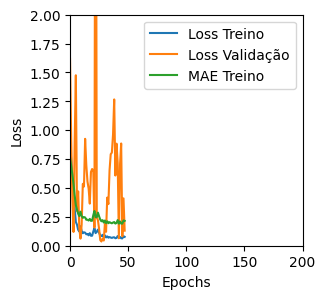

Tempo de treino: 0.2915342410405477 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35988396406173706 , MAE = 0.42374396324157715'

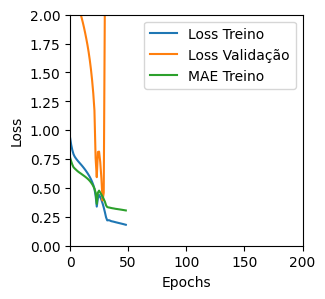

Tempo de treino: 0.1812352697054545 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v2 , timesteps=36, units=16, batch=16


'TRAINING set. Loss = 0.17736491560935974 , MAE = 0.3195275664329529'

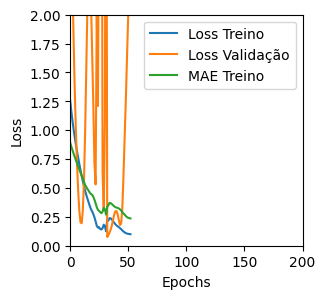

Tempo de treino: 0.21450653076171874 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.9495210647583008 , MAE = 0.7577124238014221'

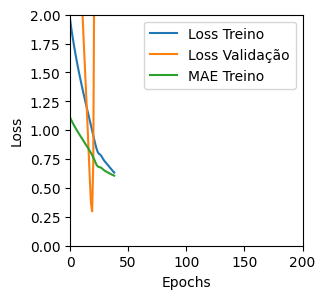

Tempo de treino: 0.12433506647745768 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10490124672651291 , MAE = 0.2406359314918518'

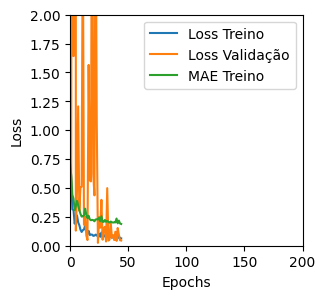

Tempo de treino: 0.3851835608482361 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.060337431728839874 , MAE = 0.18850785493850708'

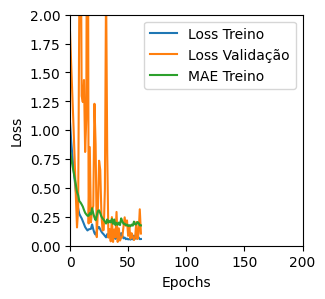

Tempo de treino: 0.37731021642684937 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2720891237258911 , MAE = 0.39756691455841064'

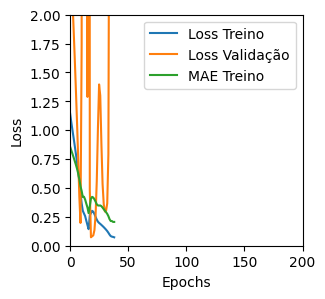

Tempo de treino: 0.20466142098108928 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3055753707885742 , MAE = 0.3914404809474945'

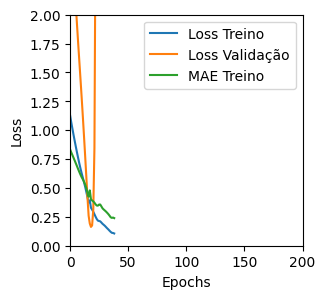

Tempo de treino: 0.11786196231842042 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09834256768226624 , MAE = 0.2391127049922943'

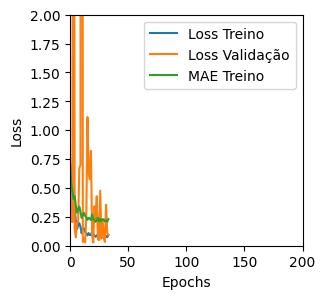

Tempo de treino: 0.2626229802767436 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13533681631088257 , MAE = 0.2600450813770294'

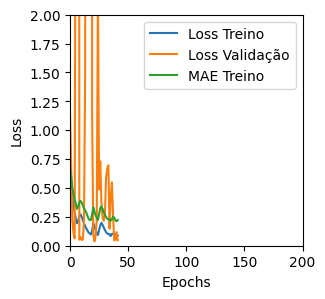

Tempo de treino: 0.215327779452006 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27029454708099365 , MAE = 0.4006558358669281'

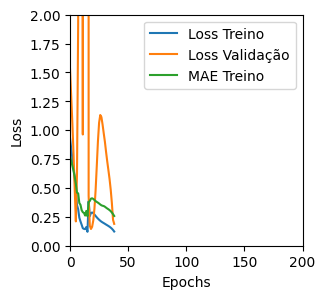

Tempo de treino: 0.20822763442993164 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33359217643737793 , MAE = 0.4409749507904053'

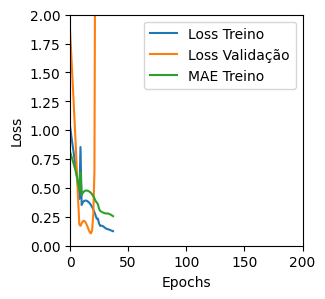

Tempo de treino: 0.12244518597920735 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09722088277339935 , MAE = 0.2361491173505783'

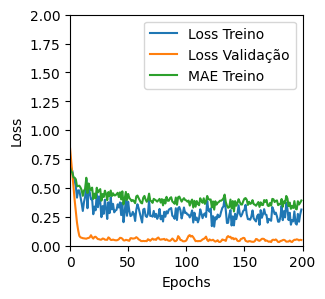

Tempo de treino: 1.4017407417297363 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23836977779865265 , MAE = 0.372087299823761'

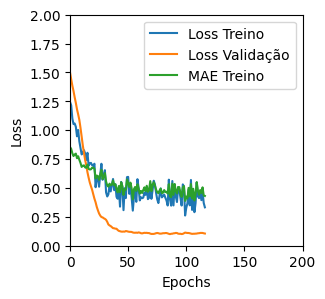

Tempo de treino: 0.36190094947814944 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2041955143213272 , MAE = 0.32570382952690125'

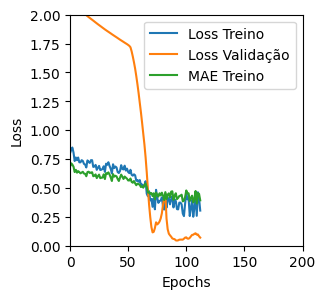

Tempo de treino: 0.2228539983431498 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4965825080871582 , MAE = 0.5386247634887695'

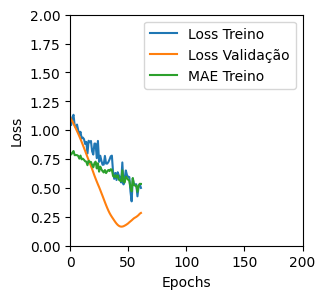

Tempo de treino: 0.126849095026652 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4950786232948303 , MAE = 0.5506466627120972'

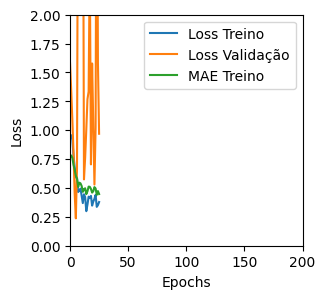

Tempo de treino: 0.20879018306732178 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5728902816772461 , MAE = 0.5694261789321899'

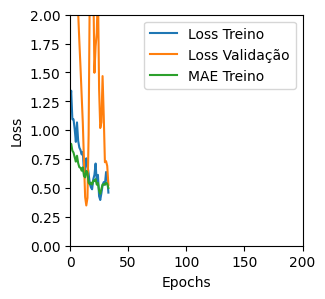

Tempo de treino: 0.15423046350479125 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4607665240764618 , MAE = 0.5040642619132996'

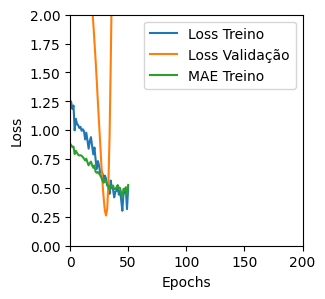

Tempo de treino: 0.15720264514287313 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4172769784927368 , MAE = 0.4945354163646698'

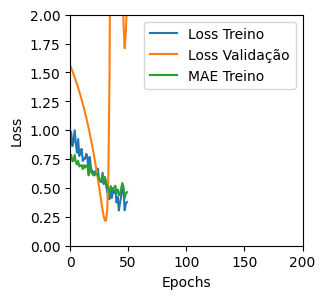

Tempo de treino: 0.09469905694325766 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11981283128261566 , MAE = 0.24551470577716827'

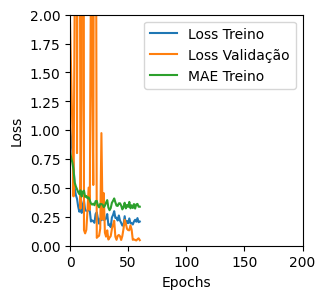

Tempo de treino: 0.37770346403121946 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.46537578105926514 , MAE = 0.5076515078544617'

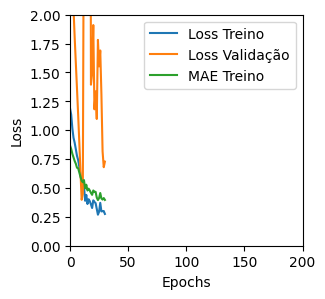

Tempo de treino: 0.20538689692815146 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3999752700328827 , MAE = 0.45569607615470886'

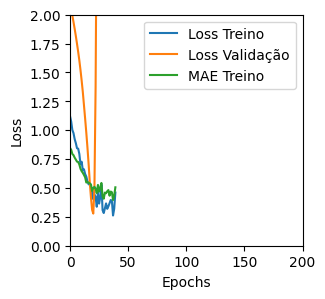

Tempo de treino: 0.12136967579523722 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3665049970149994 , MAE = 0.45270833373069763'

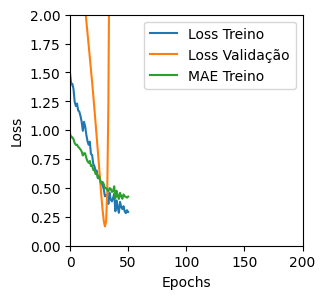

Tempo de treino: 0.1264402151107788 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08332396298646927 , MAE = 0.2161247283220291'

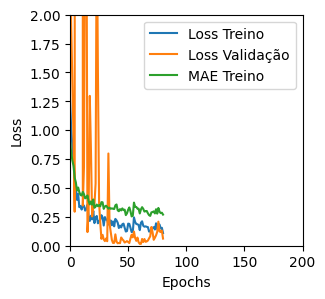

Tempo de treino: 0.7266342639923096 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0757913738489151 , MAE = 0.20446453988552094'

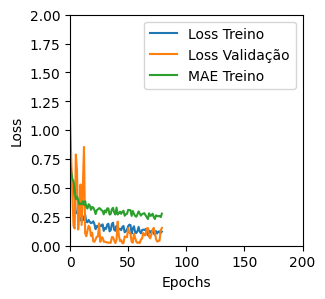

Tempo de treino: 0.29765520095825193 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6093602180480957 , MAE = 0.605003833770752'

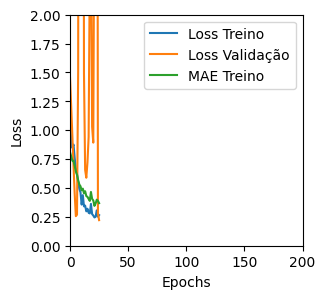

Tempo de treino: 0.10283844073613485 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5323200821876526 , MAE = 0.5622516870498657'

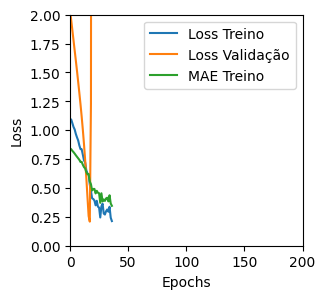

Tempo de treino: 0.12058436473210653 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10317341983318329 , MAE = 0.23021014034748077'

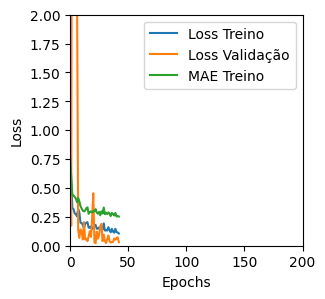

Tempo de treino: 0.3798459847768148 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09042955189943314 , MAE = 0.2196751832962036'

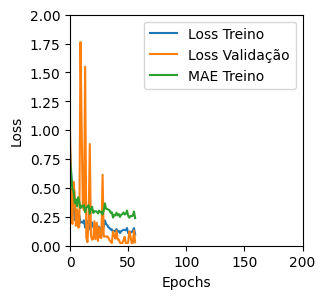

Tempo de treino: 0.23804840246836345 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49050888419151306 , MAE = 0.542048454284668'

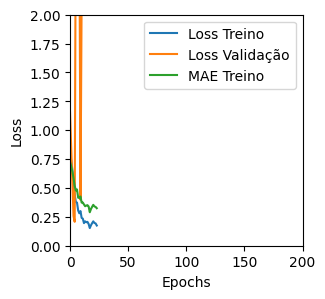

Tempo de treino: 0.13559883038202922 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3126106262207031 , MAE = 0.41570115089416504'

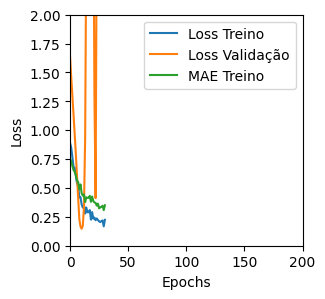

Tempo de treino: 0.09742337862650553 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com GRU_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048802707344293594 , MAE = 0.16845768690109253'

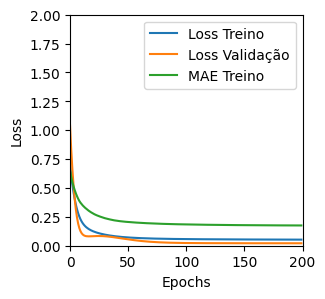

Tempo de treino: 1.4245308081309 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11679856479167938 , MAE = 0.27353015542030334'

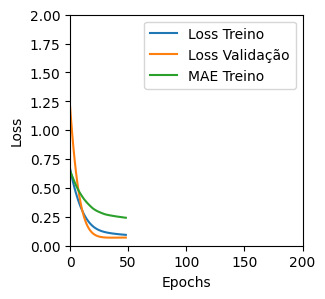

Tempo de treino: 0.3969634373982747 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06310153007507324 , MAE = 0.19631701707839966'

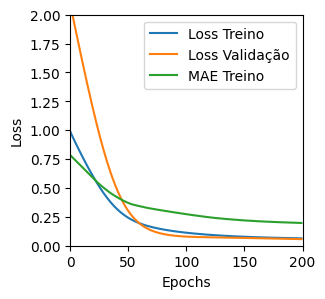

Tempo de treino: 0.7366795698801677 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15653406083583832 , MAE = 0.3210105895996094'

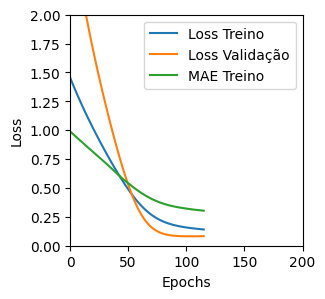

Tempo de treino: 0.38213045994440714 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.045650970190763474 , MAE = 0.16457046568393707'

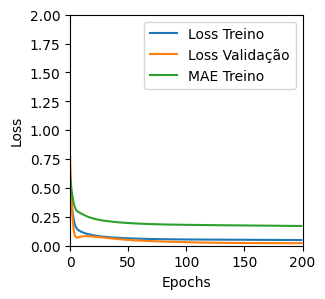

Tempo de treino: 1.4187935789426167 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05390968918800354 , MAE = 0.1807325929403305'

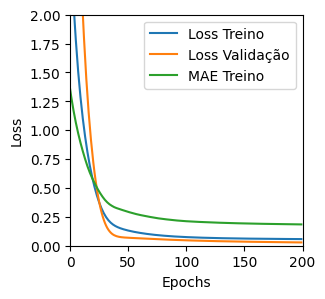

Tempo de treino: 0.7549877921740215 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12362239509820938 , MAE = 0.2818232774734497'

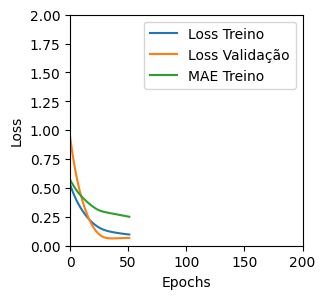

Tempo de treino: 0.15020191272099812 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14922109246253967 , MAE = 0.31306192278862'

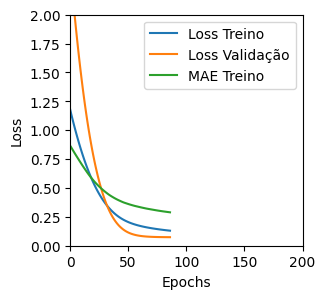

Tempo de treino: 0.16882671117782594 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04579711705446243 , MAE = 0.1663796454668045'

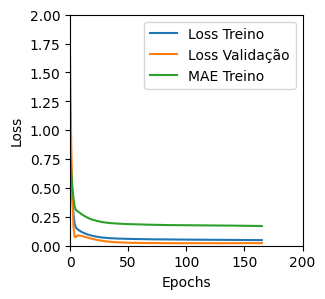

Tempo de treino: 1.1176459034283956 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048658549785614014 , MAE = 0.17042352259159088'

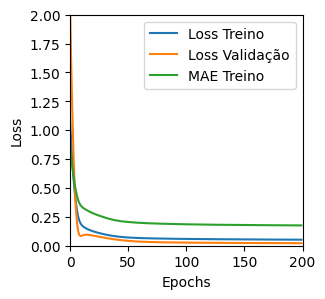

Tempo de treino: 1.4216084520022074 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3235437870025635 , MAE = 0.45853370428085327'

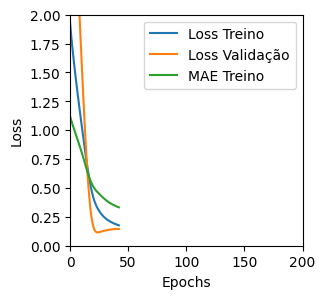

Tempo de treino: 0.1367785652478536 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2002073973417282 , MAE = 0.3469427824020386'

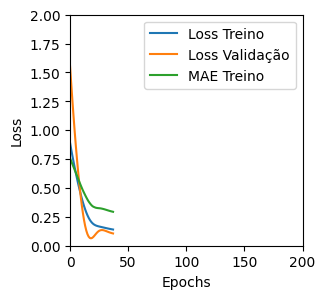

Tempo de treino: 0.14068644046783446 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04613753408193588 , MAE = 0.16624745726585388'

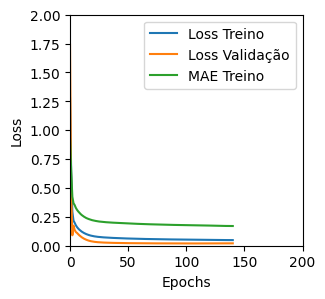

Tempo de treino: 1.4082414229710898 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048540931195020676 , MAE = 0.17075525224208832'

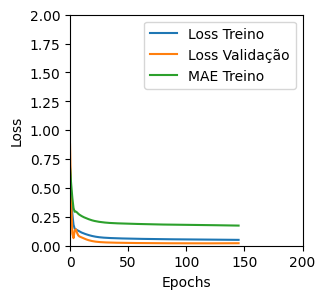

Tempo de treino: 0.752407185236613 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05149535834789276 , MAE = 0.17473876476287842'

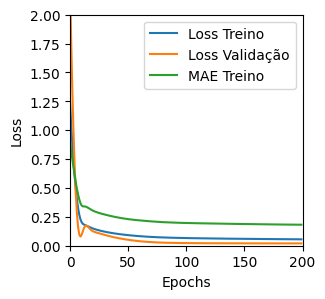

Tempo de treino: 0.4700353066126505 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05197284743189812 , MAE = 0.17730411887168884'

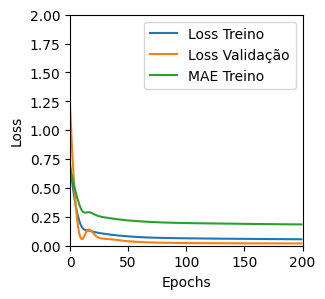

Tempo de treino: 0.38372541666030885 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05140982195734978 , MAE = 0.1737484484910965'

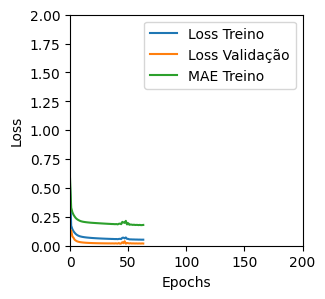

Tempo de treino: 0.7257375637690227 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04640282317996025 , MAE = 0.1657465249300003'

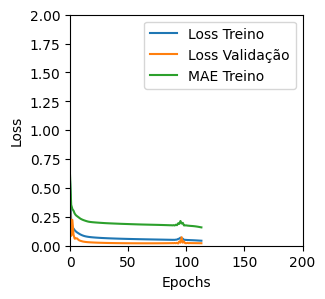

Tempo de treino: 0.7405497948328654 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.052093636244535446 , MAE = 0.17510506510734558'

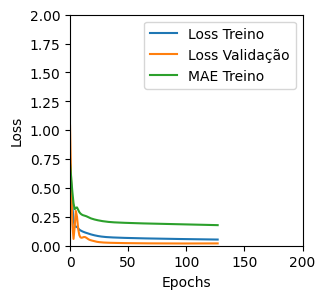

Tempo de treino: 0.40044031540552777 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04993829131126404 , MAE = 0.17386923730373383'

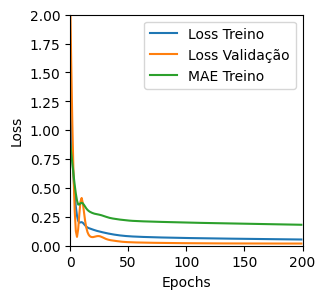

Tempo de treino: 0.3935732086499532 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14412949979305267 , MAE = 0.2674131989479065'

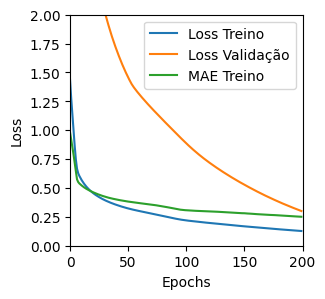

Tempo de treino: 0.7170957366625468 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2692722678184509 , MAE = 0.35524871945381165'

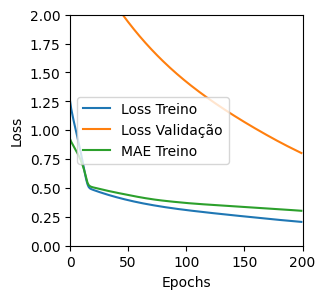

Tempo de treino: 0.30963052113850914 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5215754508972168 , MAE = 0.5477338433265686'

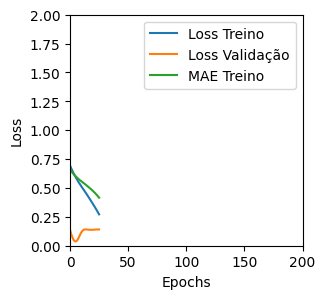

Tempo de treino: 0.08271595239639282 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13706493377685547 , MAE = 0.2994536757469177'

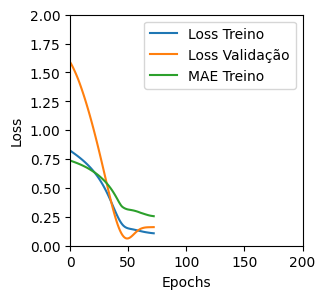

Tempo de treino: 0.11276317040125529 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13069720566272736 , MAE = 0.2716037631034851'

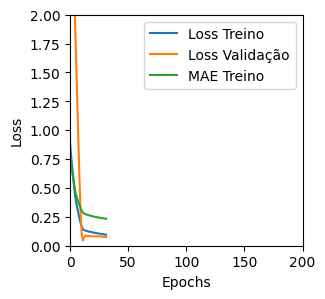

Tempo de treino: 0.12921048005421956 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16243015229701996 , MAE = 0.3133375644683838'

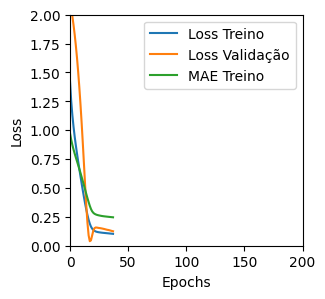

Tempo de treino: 0.12219421863555908 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12466271966695786 , MAE = 0.2657112777233124'

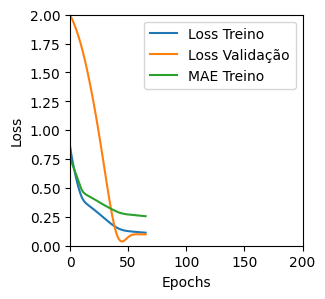

Tempo de treino: 0.09761370023091634 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13636288046836853 , MAE = 0.2751045227050781'

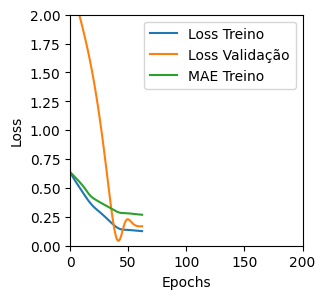

Tempo de treino: 0.11884887218475342 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12995697557926178 , MAE = 0.2689608037471771'

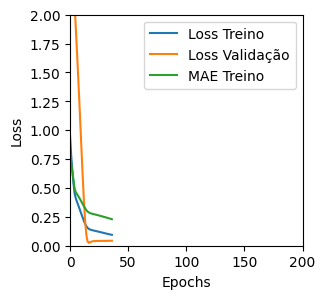

Tempo de treino: 0.11707303126653036 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1407918930053711 , MAE = 0.2838906943798065'

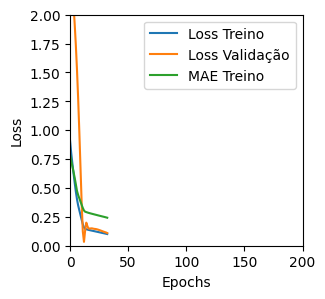

Tempo de treino: 0.09376501639684041 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15091606974601746 , MAE = 0.2850556969642639'

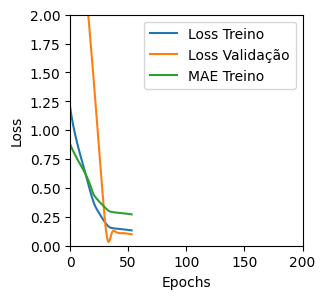

Tempo de treino: 0.08266644875208537 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17022700607776642 , MAE = 0.3061056137084961'

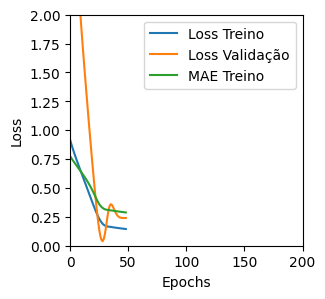

Tempo de treino: 0.14655885696411133 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05264974385499954 , MAE = 0.1850951462984085'

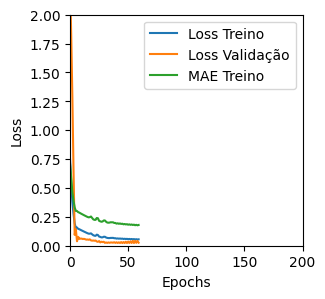

Tempo de treino: 0.21957381963729858 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13716930150985718 , MAE = 0.2795168161392212'

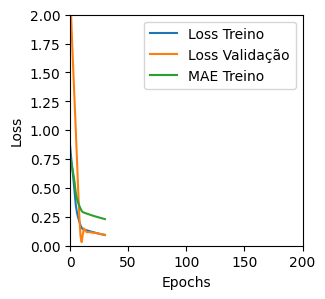

Tempo de treino: 0.12239649295806884 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15661494433879852 , MAE = 0.295786589384079'

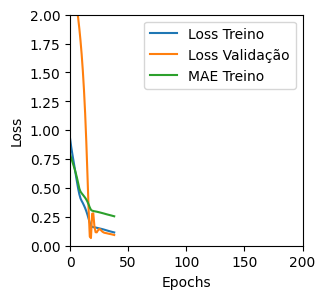

Tempo de treino: 0.07727903127670288 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14641287922859192 , MAE = 0.29206162691116333'

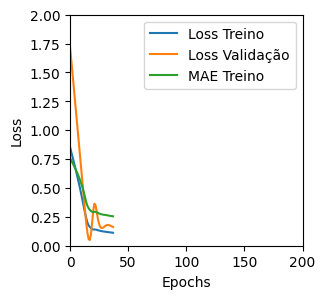

Tempo de treino: 0.0775425910949707 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04970080405473709 , MAE = 0.17829486727714539'

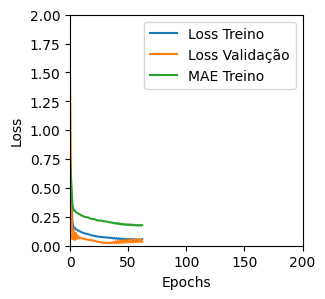

Tempo de treino: 0.2035374164581299 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05410892143845558 , MAE = 0.17931358516216278'

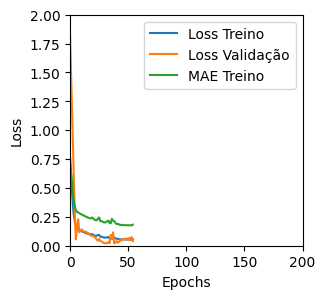

Tempo de treino: 0.12787197430928549 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15498657524585724 , MAE = 0.29369744658470154'

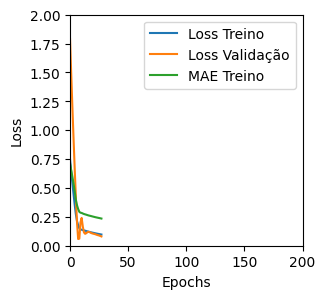

Tempo de treino: 0.10283383131027221 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15306356549263 , MAE = 0.29250386357307434'

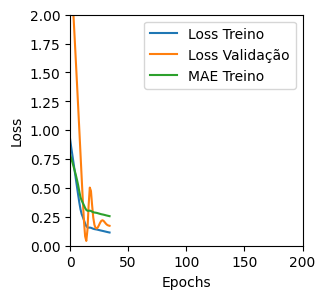

Tempo de treino: 0.08796350161234538 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5145912170410156 , MAE = 0.5459859371185303'

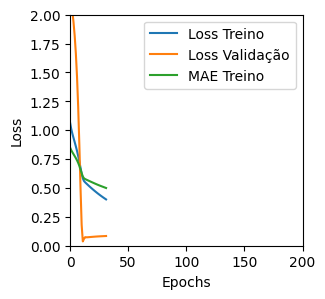

Tempo de treino: 0.12510604858398439 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5125710964202881 , MAE = 0.5544171929359436'

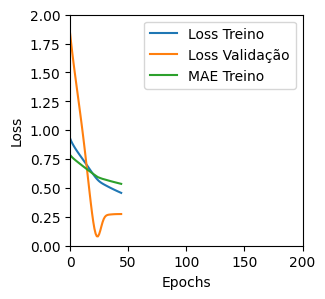

Tempo de treino: 0.12488873402277628 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16171051561832428 , MAE = 0.29179680347442627'

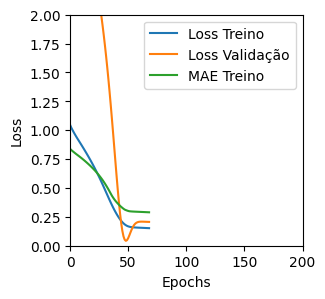

Tempo de treino: 0.11970167954762777 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.45757585763931274 , MAE = 0.505684494972229'

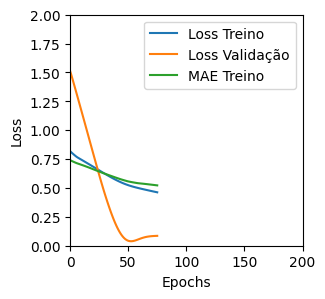

Tempo de treino: 0.11860597928365071 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14935840666294098 , MAE = 0.2837790250778198'

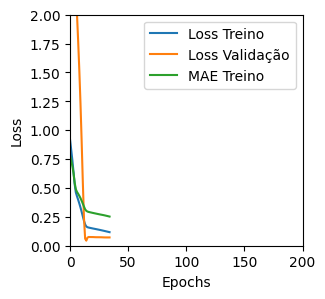

Tempo de treino: 0.21104692618052165 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15058588981628418 , MAE = 0.29038524627685547'

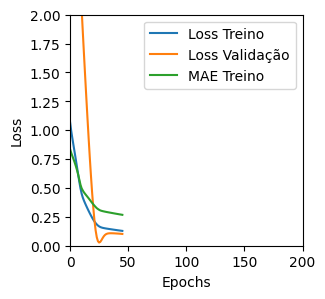

Tempo de treino: 0.11035784482955932 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1657256782054901 , MAE = 0.3057194948196411'

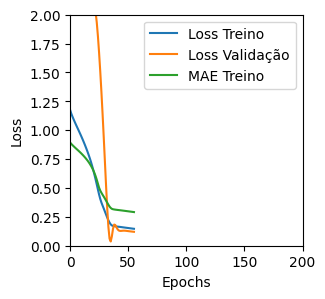

Tempo de treino: 0.12735721270243328 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1845976710319519 , MAE = 0.3376769721508026'

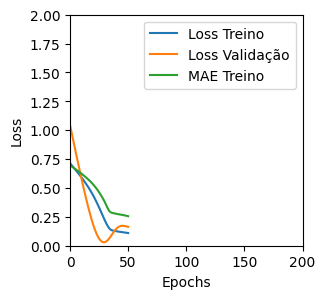

Tempo de treino: 0.08893410762151083 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15636304020881653 , MAE = 0.3003794848918915'

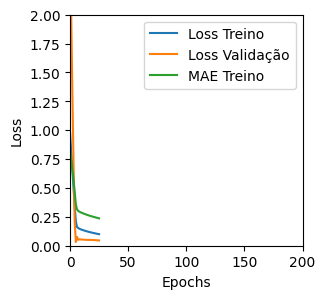

Tempo de treino: 0.12563087940216064 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1722426861524582 , MAE = 0.31447768211364746'

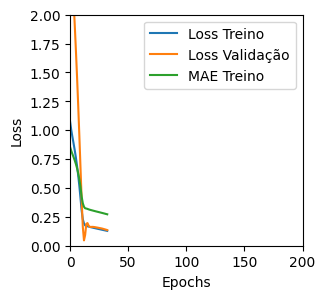

Tempo de treino: 0.12272812525431315 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13216274976730347 , MAE = 0.26870614290237427'

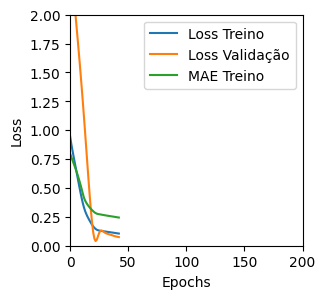

Tempo de treino: 0.1186202088991801 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1314912885427475 , MAE = 0.28010621666908264'

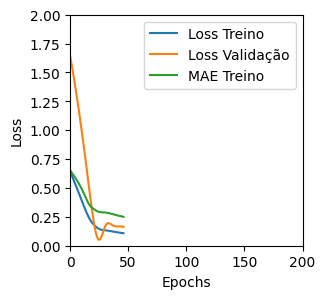

Tempo de treino: 0.06782492796579996 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05880897119641304 , MAE = 0.19426186382770538'

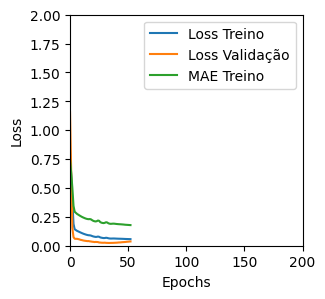

Tempo de treino: 0.20424951712290446 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.061369918286800385 , MAE = 0.18423764407634735'

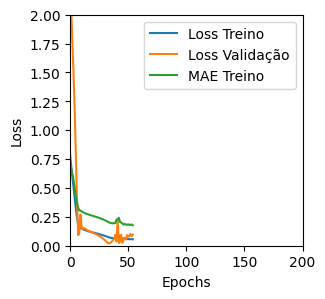

Tempo de treino: 0.23047180573145548 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14652128517627716 , MAE = 0.28799960017204285'

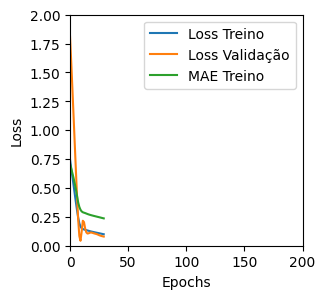

Tempo de treino: 0.0873296856880188 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1463017612695694 , MAE = 0.2848796844482422'

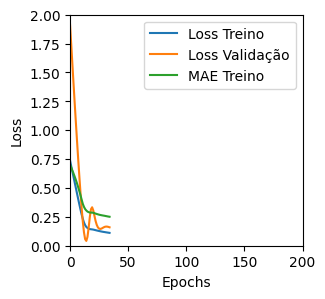

Tempo de treino: 0.06797611316045125 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05433797836303711 , MAE = 0.18196338415145874'

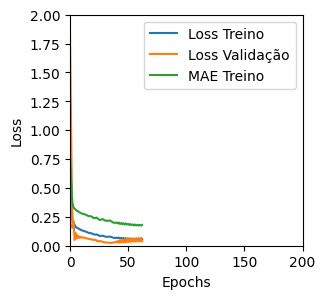

Tempo de treino: 0.2068153222401937 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06188659742474556 , MAE = 0.18190528452396393'

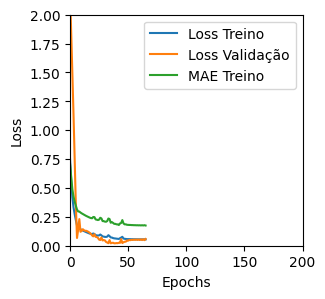

Tempo de treino: 0.20420206785202027 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1460883468389511 , MAE = 0.29099568724632263'

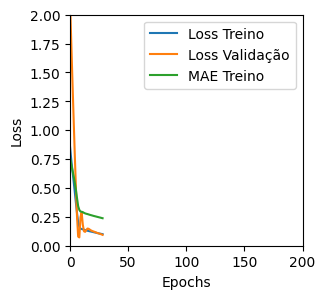

Tempo de treino: 0.06597313880920411 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1494394838809967 , MAE = 0.29285478591918945'

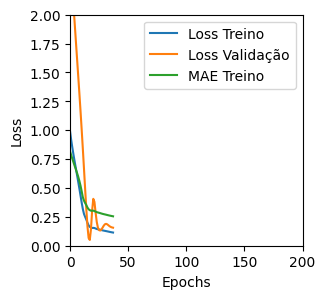

Tempo de treino: 0.08560842275619507 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16002899408340454 , MAE = 0.31202924251556396'

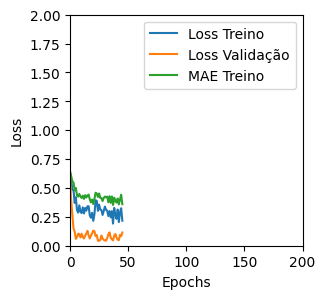

Tempo de treino: 0.23255942662556967 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12710903584957123 , MAE = 0.2612611651420593'

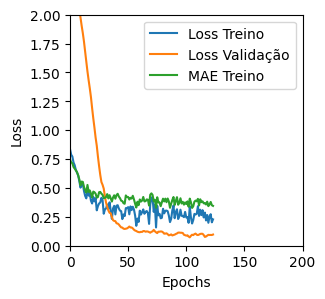

Tempo de treino: 0.38463351329167683 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4774562120437622 , MAE = 0.5210974216461182'

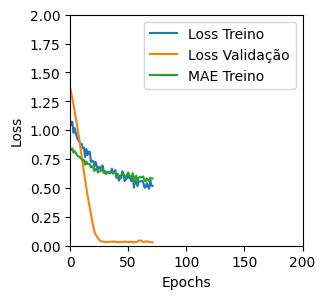

Tempo de treino: 0.12653584480285646 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5625349283218384 , MAE = 0.5798736810684204'

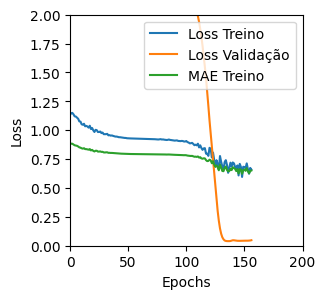

Tempo de treino: 0.15028947989145916 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12704139947891235 , MAE = 0.26810362935066223'

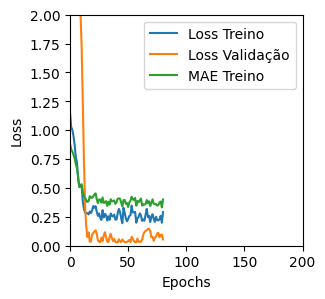

Tempo de treino: 0.22849001487096152 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1819668561220169 , MAE = 0.321480929851532'

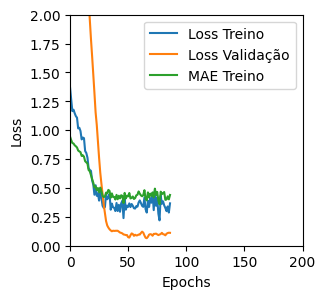

Tempo de treino: 0.2161765178044637 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.161691352725029 , MAE = 0.3044300377368927'

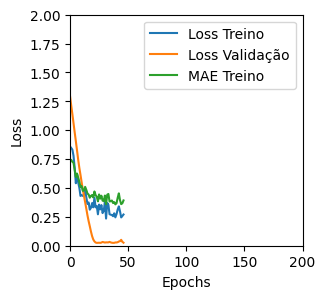

Tempo de treino: 0.09295316537221272 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.404350221157074 , MAE = 0.4864393472671509'

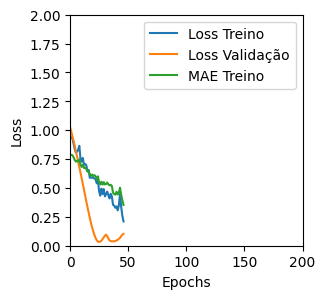

Tempo de treino: 0.1074110229810079 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12135422229766846 , MAE = 0.26257655024528503'

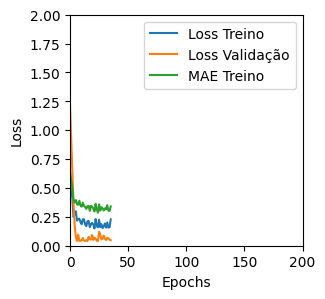

Tempo de treino: 0.13917539914449056 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13588614761829376 , MAE = 0.2767157256603241'

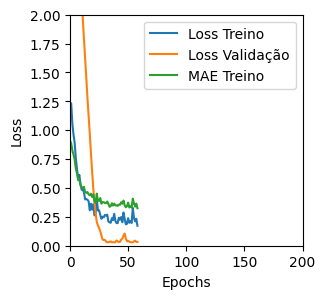

Tempo de treino: 0.20974622964859008 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11547330021858215 , MAE = 0.25600332021713257'

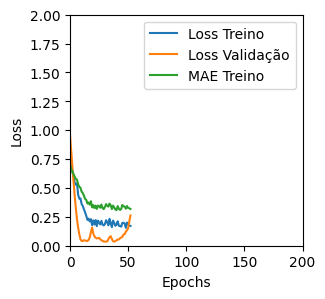

Tempo de treino: 0.12088329394658406 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1493208259344101 , MAE = 0.2945127487182617'

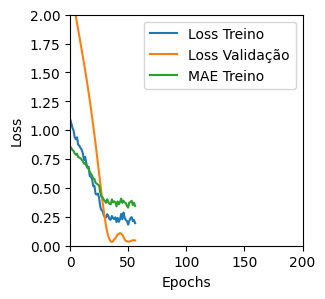

Tempo de treino: 0.1217821995417277 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05482063814997673 , MAE = 0.17224553227424622'

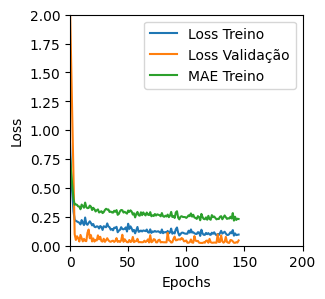

Tempo de treino: 0.7225948015848795 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07060816138982773 , MAE = 0.19893722236156464'

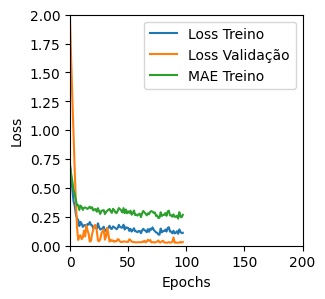

Tempo de treino: 0.18805291652679443 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12185736745595932 , MAE = 0.2613581120967865'

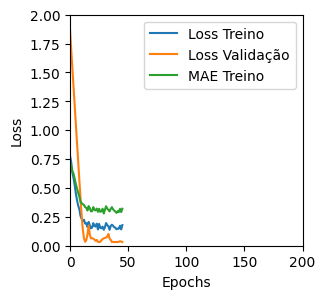

Tempo de treino: 0.10391737222671509 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13260234892368317 , MAE = 0.2744254469871521'

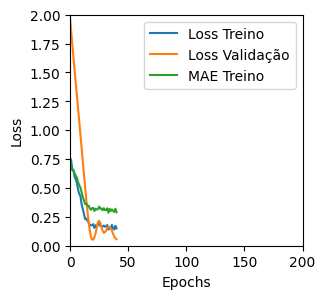

Tempo de treino: 0.09837390979131062 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.050198525190353394 , MAE = 0.17032977938652039'

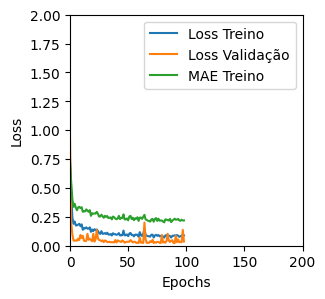

Tempo de treino: 0.30669787724812825 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05342046171426773 , MAE = 0.17299479246139526'

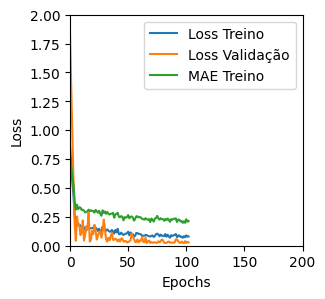

Tempo de treino: 0.38787797689437864 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.056462548673152924 , MAE = 0.17904488742351532'

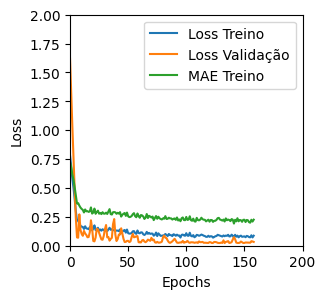

Tempo de treino: 0.21445418198903402 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1512841135263443 , MAE = 0.29462921619415283'

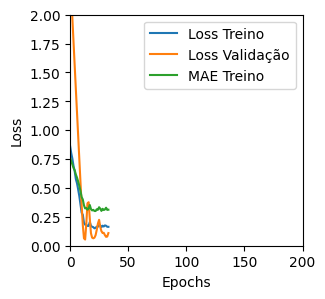

Tempo de treino: 0.07770947217941285 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com GRU_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04075482860207558 , MAE = 0.15530557930469513'

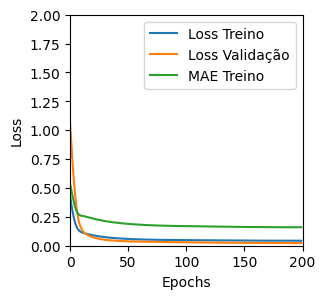

Tempo de treino: 0.725494925181071 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04904373362660408 , MAE = 0.1696574091911316'

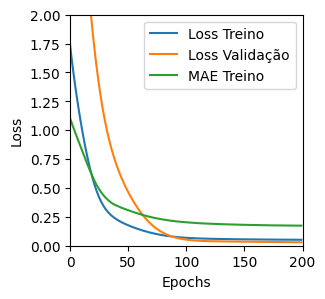

Tempo de treino: 0.7617519656817119 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06897623836994171 , MAE = 0.20635895431041718'

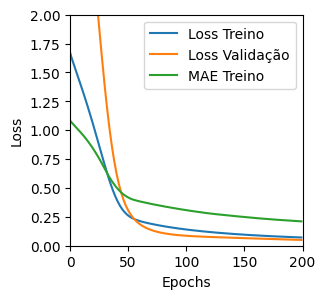

Tempo de treino: 0.2672498186429342 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.129741832613945 , MAE = 0.28853440284729004'

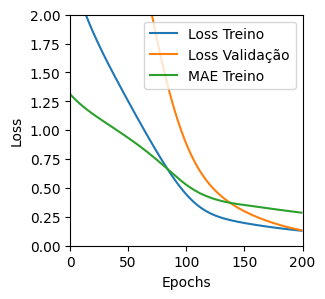

Tempo de treino: 0.2053133249282837 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04480031505227089 , MAE = 0.16270633041858673'

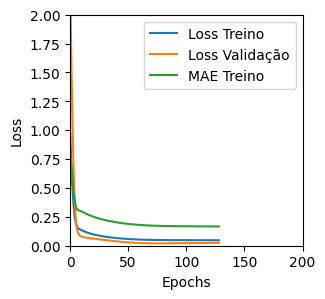

Tempo de treino: 0.3965718070665995 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04473969712853432 , MAE = 0.16241788864135742'

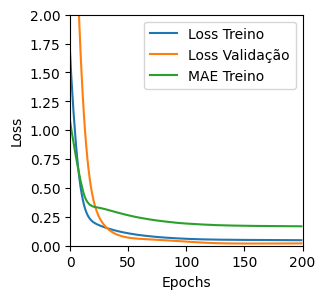

Tempo de treino: 0.3951496402422587 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.045822225511074066 , MAE = 0.1645592749118805'

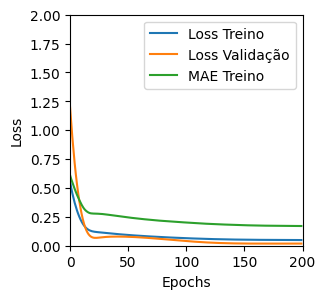

Tempo de treino: 0.42135180632273356 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.047809358686208725 , MAE = 0.17023979127407074'

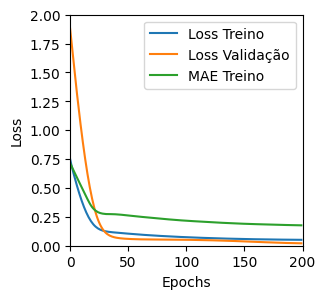

Tempo de treino: 0.2130805532137553 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04718019440770149 , MAE = 0.16874875128269196'

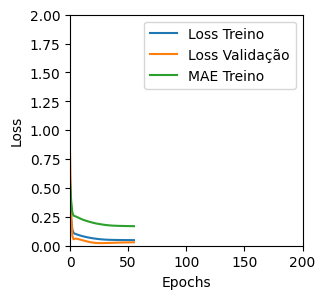

Tempo de treino: 0.2317597548166911 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.044027552008628845 , MAE = 0.16066321730613708'

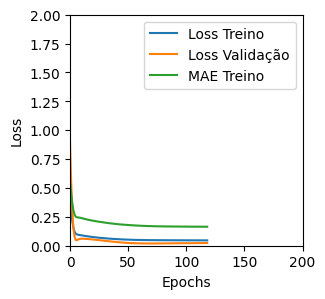

Tempo de treino: 0.39223843812942505 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04338652640581131 , MAE = 0.1595536172389984'

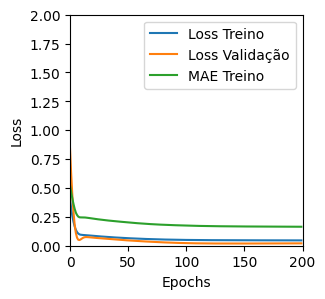

Tempo de treino: 0.26467140118281046 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.046071022748947144 , MAE = 0.16590727865695953'

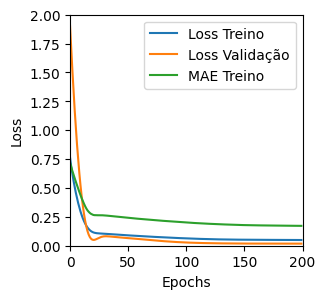

Tempo de treino: 0.4074072639147441 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0525846928358078 , MAE = 0.17959365248680115'

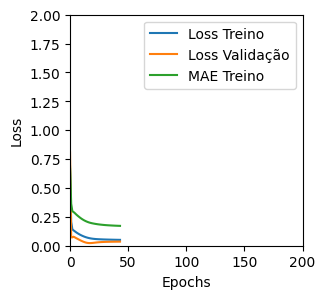

Tempo de treino: 0.21992554664611816 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048641130328178406 , MAE = 0.17085379362106323'

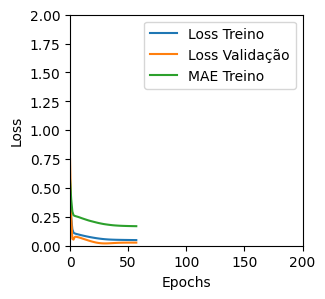

Tempo de treino: 0.21533809105555216 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14299263060092926 , MAE = 0.2978591322898865'

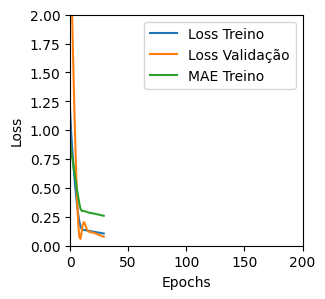

Tempo de treino: 0.08660013278325399 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13433749973773956 , MAE = 0.29155802726745605'

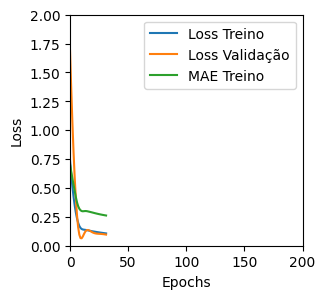

Tempo de treino: 0.11809219519297282 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05814654752612114 , MAE = 0.18828721344470978'

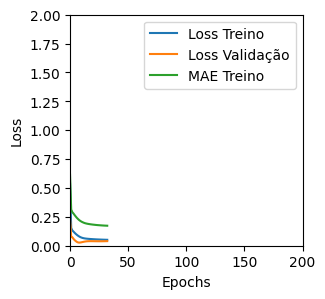

Tempo de treino: 0.17124311923980712 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04851404204964638 , MAE = 0.17004068195819855'

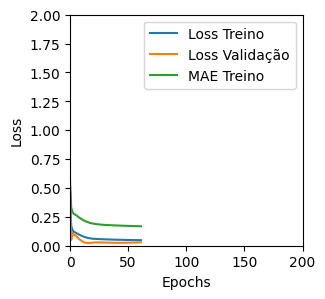

Tempo de treino: 0.21549832026163737 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05324431508779526 , MAE = 0.17913247644901276'

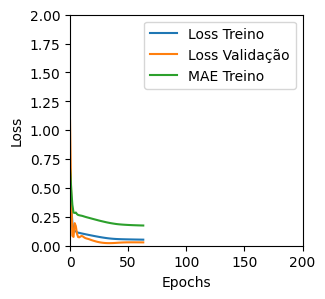

Tempo de treino: 0.11625932455062866 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07917297631502151 , MAE = 0.22012154757976532'

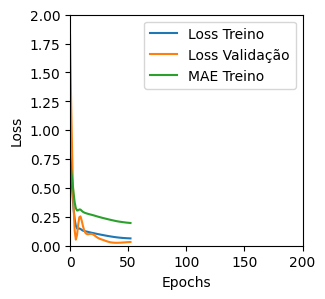

Tempo de treino: 0.10050069491068522 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21159017086029053 , MAE = 0.3208441436290741'

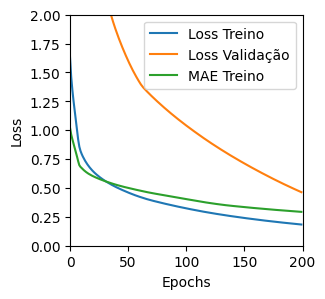

Tempo de treino: 0.516384768486023 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31363824009895325 , MAE = 0.4328620433807373'

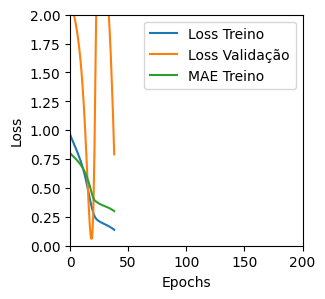

Tempo de treino: 0.12787571748097737 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3032142221927643 , MAE = 0.3781116008758545'

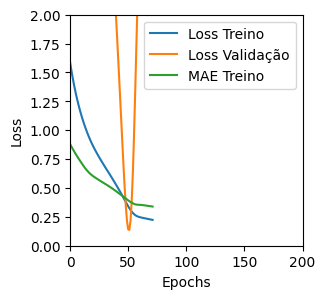

Tempo de treino: 0.09981165329615276 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5663073062896729 , MAE = 0.5747823715209961'

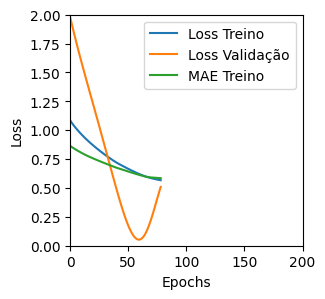

Tempo de treino: 0.11064862410227458 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38300859928131104 , MAE = 0.4915122389793396'

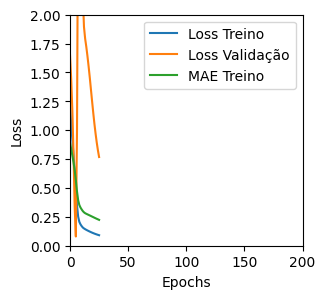

Tempo de treino: 0.09093255996704101 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16630837321281433 , MAE = 0.28574612736701965'

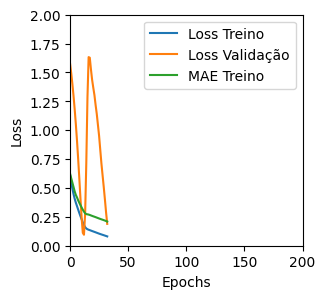

Tempo de treino: 0.12046291430791219 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2549048662185669 , MAE = 0.3723492920398712'

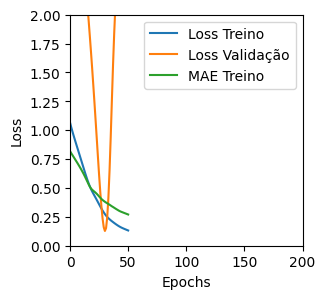

Tempo de treino: 0.11575573682785034 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2044295072555542 , MAE = 0.3507864773273468'

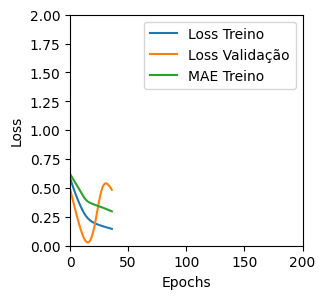

Tempo de treino: 0.06714271704355876 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3622416853904724 , MAE = 0.47523176670074463'

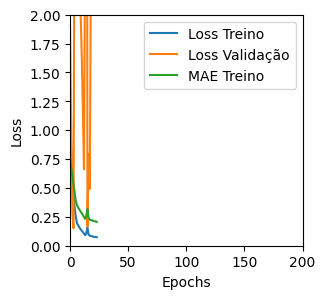

Tempo de treino: 0.09841167132059733 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2087215632200241 , MAE = 0.3388202488422394'

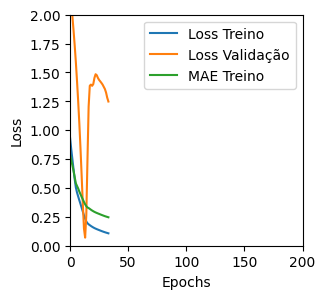

Tempo de treino: 0.12723085880279542 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.243269681930542 , MAE = 0.38747817277908325'

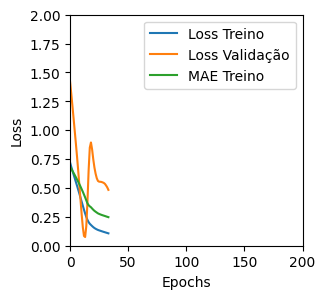

Tempo de treino: 0.07738993962605795 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19468273222446442 , MAE = 0.33114781975746155'

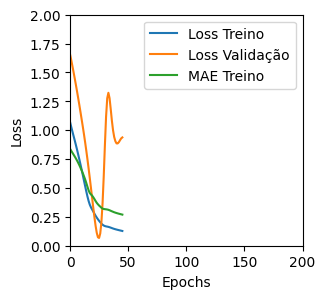

Tempo de treino: 0.13340556224187214 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06266137957572937 , MAE = 0.19585075974464417'

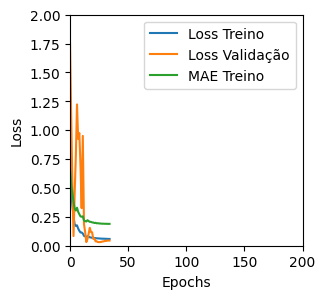

Tempo de treino: 0.12778608798980712 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21497724950313568 , MAE = 0.3305200934410095'

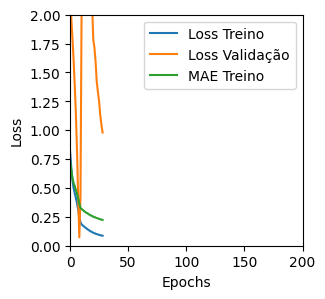

Tempo de treino: 0.11438400348027547 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24516472220420837 , MAE = 0.3836519420146942'

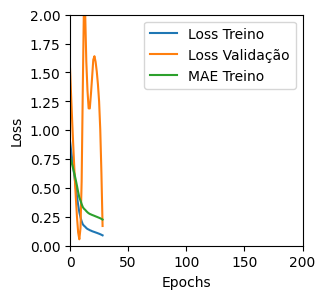

Tempo de treino: 0.07187912464141846 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21026714146137238 , MAE = 0.34370046854019165'

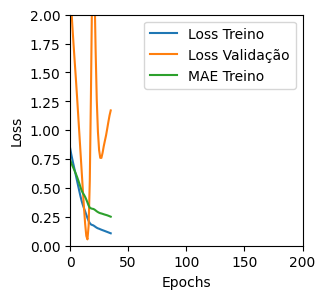

Tempo de treino: 0.07974338928858439 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07690323144197464 , MAE = 0.20665603876113892'

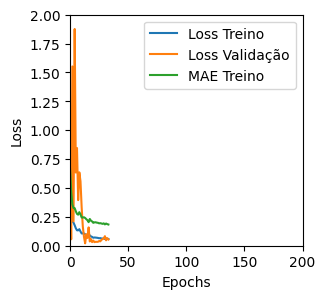

Tempo de treino: 0.13148647944132488 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0769210159778595 , MAE = 0.20909351110458374'

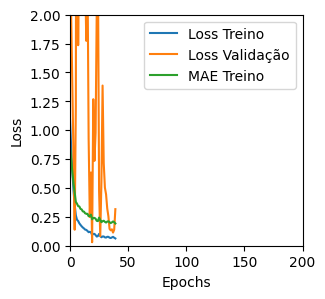

Tempo de treino: 0.12665019432703653 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4171985387802124 , MAE = 0.5050362348556519'

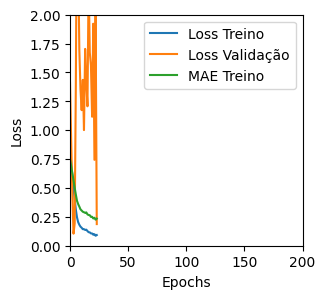

Tempo de treino: 0.07862866719563802 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32748734951019287 , MAE = 0.44489917159080505'

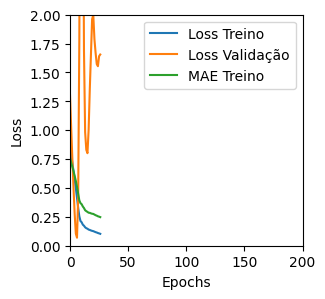

Tempo de treino: 0.07999627192815145 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.182249516248703 , MAE = 0.29743438959121704'

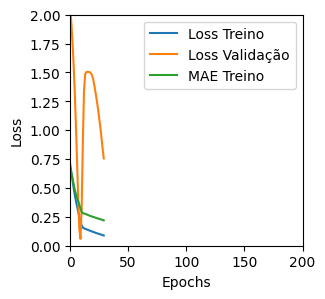

Tempo de treino: 0.10340042114257812 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4838864505290985 , MAE = 0.5385774970054626'

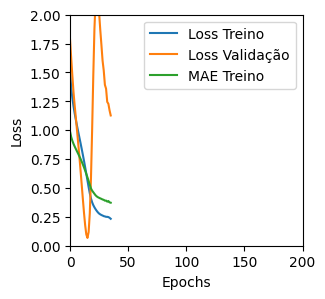

Tempo de treino: 0.12306979894638062 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6113320589065552 , MAE = 0.6108967661857605'

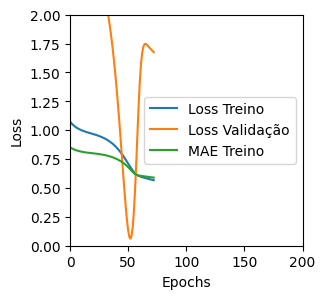

Tempo de treino: 0.10488645633061727 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14502495527267456 , MAE = 0.3013603091239929'

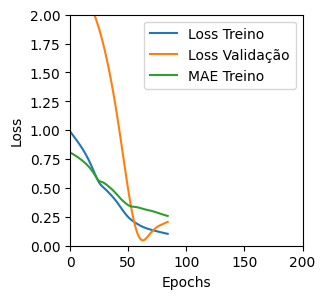

Tempo de treino: 0.10117285251617432 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29673120379447937 , MAE = 0.3940902054309845'

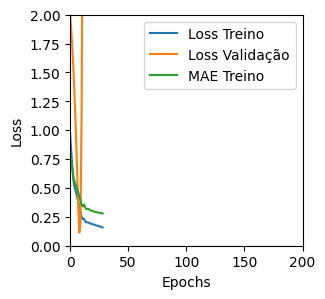

Tempo de treino: 0.1066717823346456 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0828549936413765 , MAE = 0.22009655833244324'

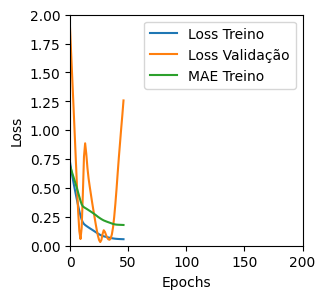

Tempo de treino: 0.12824169397354127 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.630828857421875 , MAE = 0.6031913161277771'

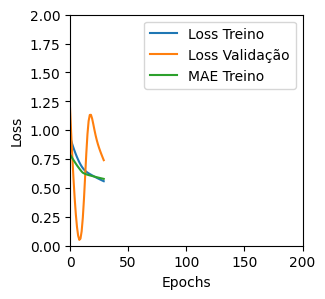

Tempo de treino: 0.07806766827901204 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5160269737243652 , MAE = 0.556678295135498'

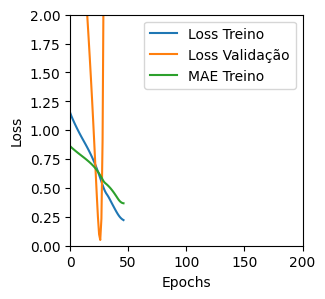

Tempo de treino: 0.08520711660385132 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07065580040216446 , MAE = 0.20045916736125946'

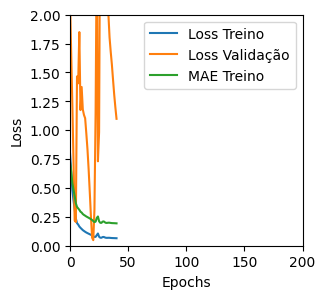

Tempo de treino: 0.20104342699050903 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25355374813079834 , MAE = 0.3675251305103302'

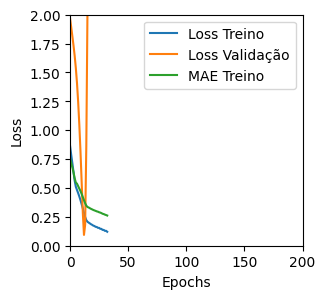

Tempo de treino: 0.07989550431569417 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16354647278785706 , MAE = 0.31902292370796204'

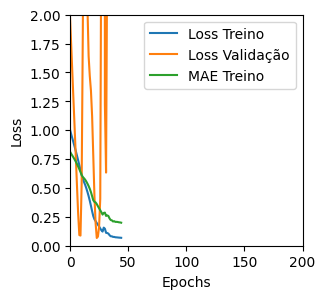

Tempo de treino: 0.0854808529218038 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26893720030784607 , MAE = 0.3929862976074219'

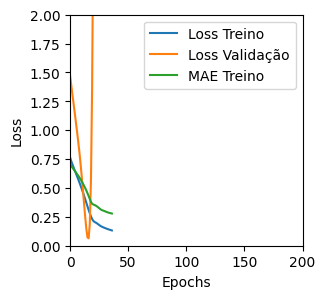

Tempo de treino: 0.06649906635284424 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07431542128324509 , MAE = 0.19658485054969788'

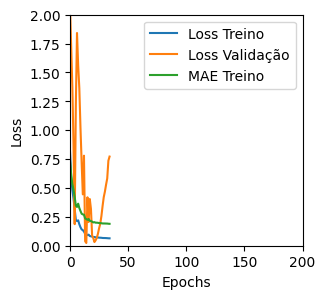

Tempo de treino: 0.12630388339360554 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09315493702888489 , MAE = 0.22659121453762054'

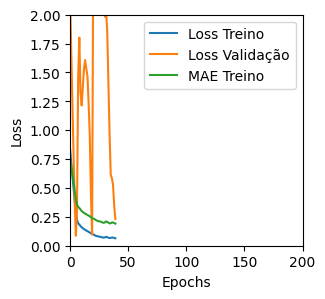

Tempo de treino: 0.13598156372706097 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2376743108034134 , MAE = 0.3568699061870575'

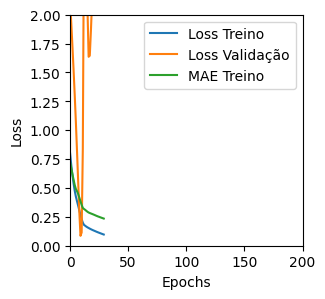

Tempo de treino: 0.07916280428568521 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2874637544155121 , MAE = 0.4059419631958008'

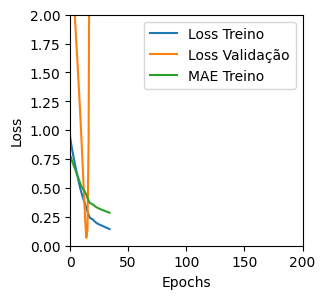

Tempo de treino: 0.07317001819610595 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07382835447788239 , MAE = 0.19864225387573242'

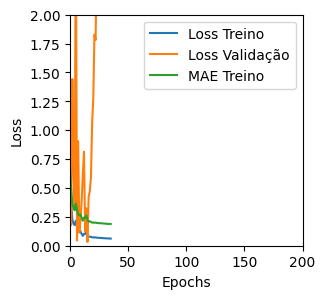

Tempo de treino: 0.14202486276626586 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08248499780893326 , MAE = 0.2178225964307785'

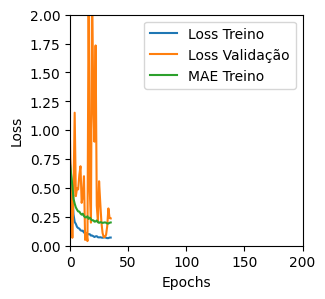

Tempo de treino: 0.09064950148264567 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3041485548019409 , MAE = 0.4241683781147003'

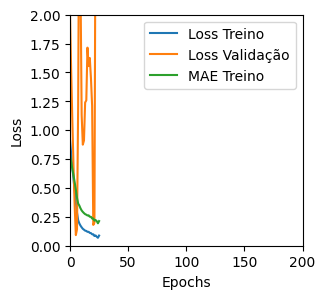

Tempo de treino: 0.0788661559422811 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21876907348632812 , MAE = 0.34344014525413513'

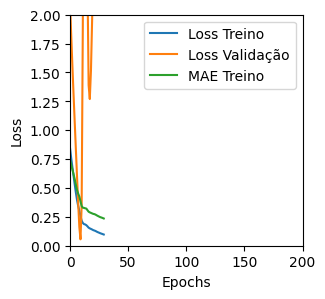

Tempo de treino: 0.06492645343144735 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20164817571640015 , MAE = 0.33806848526000977'

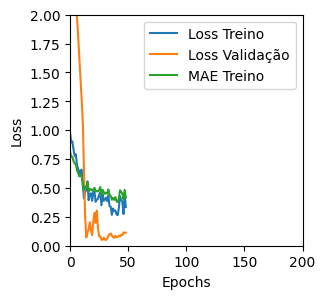

Tempo de treino: 0.1446986714998881 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1515631377696991 , MAE = 0.2826395332813263'

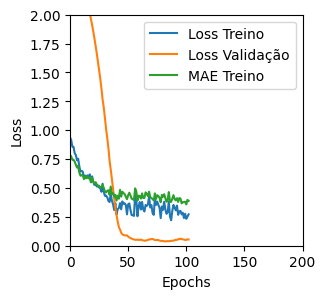

Tempo de treino: 0.2129229466120402 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4162341356277466 , MAE = 0.4832856059074402'

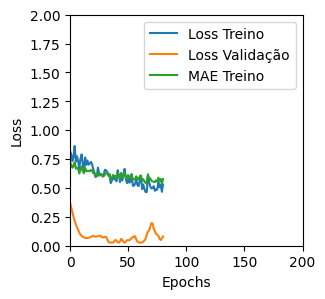

Tempo de treino: 0.11377858718236288 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6069629192352295 , MAE = 0.5680927634239197'

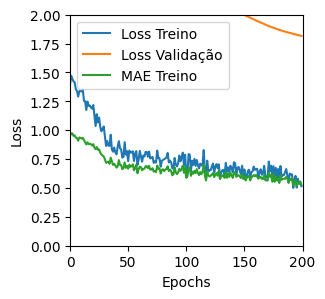

Tempo de treino: 0.2159942428270976 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6014631390571594 , MAE = 0.5934314727783203'

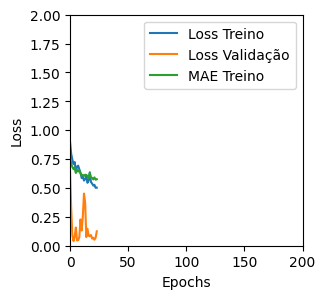

Tempo de treino: 0.12942790190378825 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3393981158733368 , MAE = 0.4410274922847748'

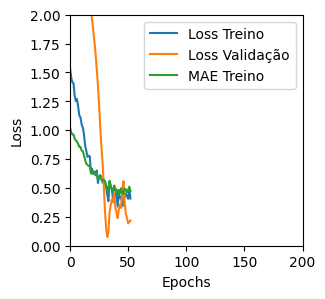

Tempo de treino: 0.11808493534723917 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25485649704933167 , MAE = 0.3665805757045746'

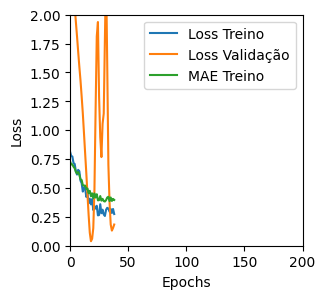

Tempo de treino: 0.06943083604176839 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18173402547836304 , MAE = 0.32094866037368774'

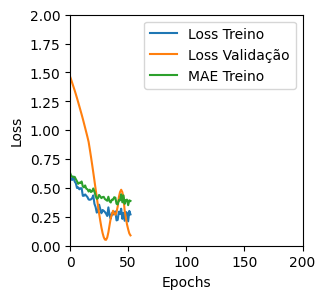

Tempo de treino: 0.1212892492612203 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5247456431388855 , MAE = 0.5700629353523254'

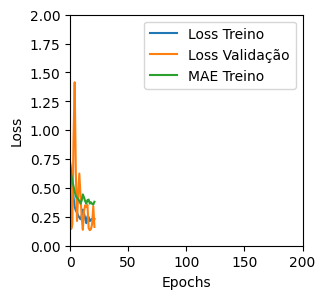

Tempo de treino: 0.1121005098025004 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14132638275623322 , MAE = 0.2824483811855316'

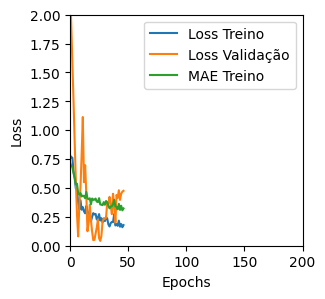

Tempo de treino: 0.20835487842559813 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22188298404216766 , MAE = 0.3476932644844055'

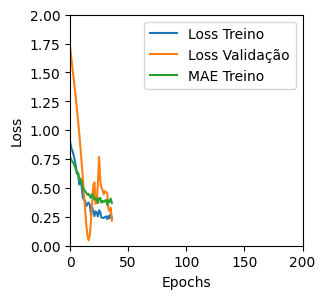

Tempo de treino: 0.07652665376663208 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2487083077430725 , MAE = 0.3728845715522766'

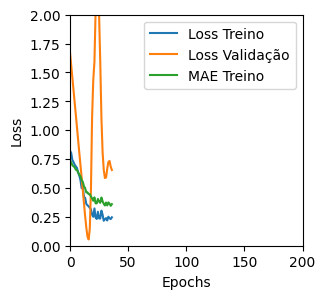

Tempo de treino: 0.08978834152221679 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05915731564164162 , MAE = 0.18321837484836578'

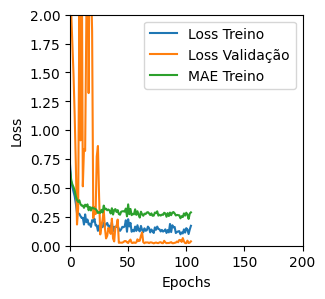

Tempo de treino: 0.38134780327479045 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08857111632823944 , MAE = 0.2190258651971817'

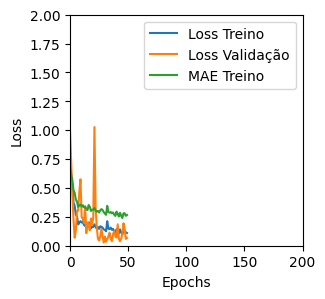

Tempo de treino: 0.11194905042648315 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25568345189094543 , MAE = 0.38078904151916504'

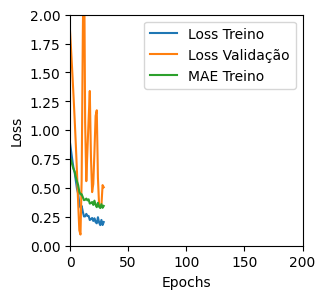

Tempo de treino: 0.1153014103571574 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30836838483810425 , MAE = 0.41628581285476685'

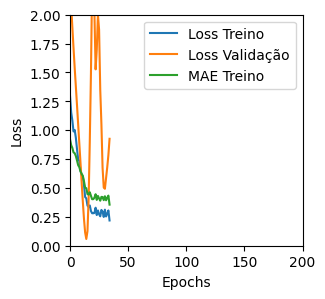

Tempo de treino: 0.06637023687362671 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07367570698261261 , MAE = 0.20741695165634155'

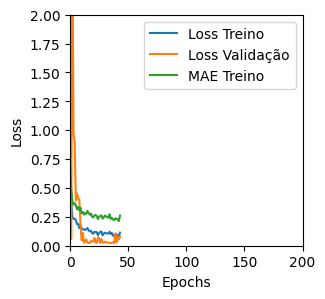

Tempo de treino: 0.2260049859682719 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06728936731815338 , MAE = 0.1950502097606659'

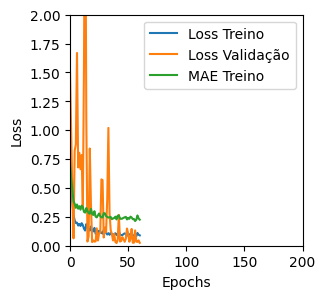

Tempo de treino: 0.16356457471847535 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24586209654808044 , MAE = 0.379032164812088'

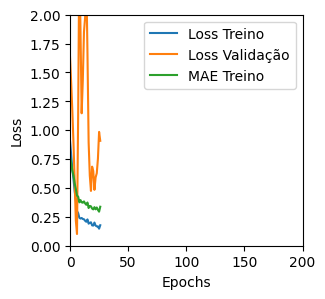

Tempo de treino: 0.07325547536214193 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2443740963935852 , MAE = 0.3697993755340576'

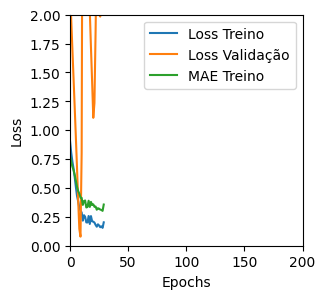

Tempo de treino: 0.08060885667800903 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com GRU_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042396433651447296 , MAE = 0.15949615836143494'

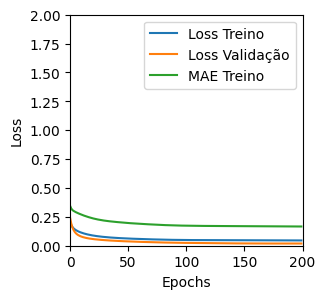

Tempo de treino: 0.5018972237904866 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.051781244575977325 , MAE = 0.1766013205051422'

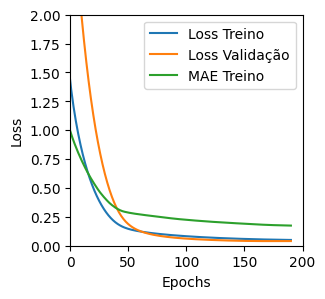

Tempo de treino: 0.38515746196111045 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06857851892709732 , MAE = 0.1995212584733963'

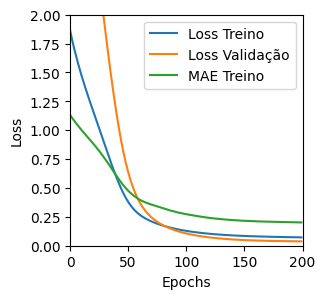

Tempo de treino: 0.22941688696543375 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0634167492389679 , MAE = 0.19822201132774353'

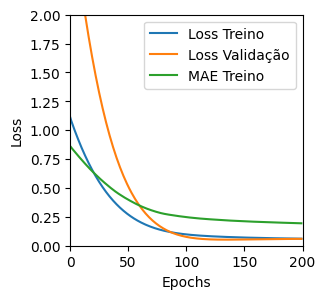

Tempo de treino: 0.4163287917772929 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.041624438017606735 , MAE = 0.1569470912218094'

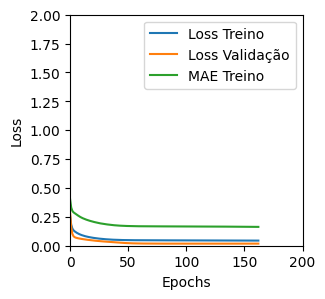

Tempo de treino: 0.4574899872144063 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04376285523176193 , MAE = 0.16099640727043152'

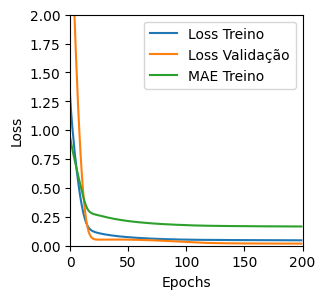

Tempo de treino: 0.33832423289616903 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05137094855308533 , MAE = 0.1761290580034256'

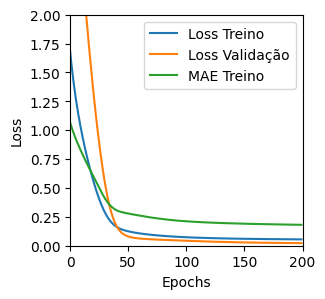

Tempo de treino: 0.2254573067029317 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08252332359552383 , MAE = 0.22979199886322021'

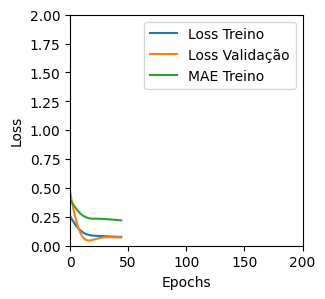

Tempo de treino: 0.13663591146469117 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.043313849717378616 , MAE = 0.15930363535881042'

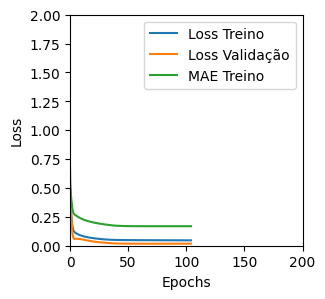

Tempo de treino: 0.39974084695180256 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04279206693172455 , MAE = 0.15810085833072662'

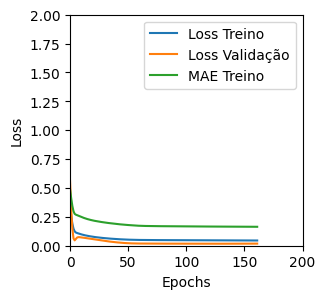

Tempo de treino: 0.3840683182080587 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04980400577187538 , MAE = 0.17343726754188538'

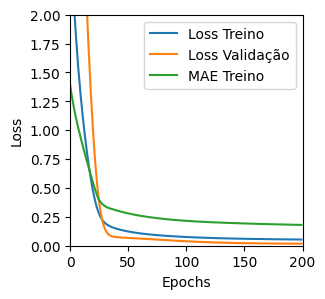

Tempo de treino: 0.23851592540740968 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04694477468729019 , MAE = 0.16841740906238556'

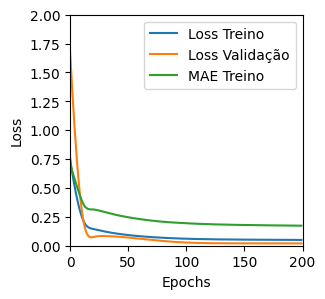

Tempo de treino: 0.23303934733072917 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04279856011271477 , MAE = 0.1571696251630783'

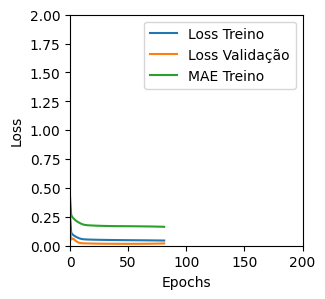

Tempo de treino: 0.3812440554300944 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.03995019569993019 , MAE = 0.15089309215545654'

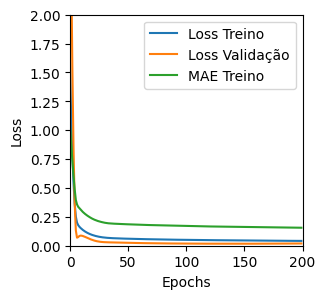

Tempo de treino: 0.3792734424273173 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04361729696393013 , MAE = 0.15883834660053253'

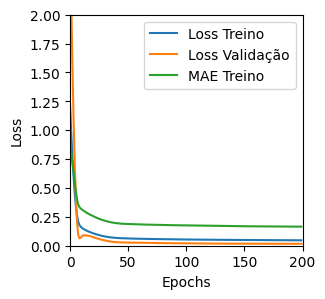

Tempo de treino: 0.31578333775202433 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04694715887308121 , MAE = 0.1689417064189911'

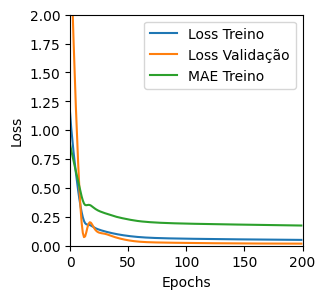

Tempo de treino: 0.3968467911084493 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04319903627038002 , MAE = 0.15691547095775604'

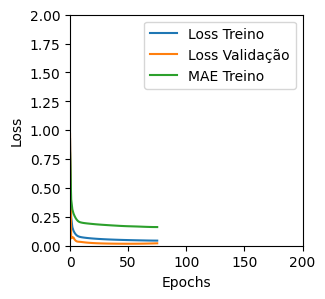

Tempo de treino: 0.39416491985321045 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04304376617074013 , MAE = 0.1573949158191681'

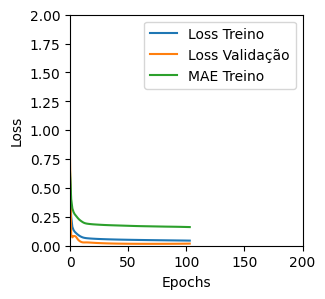

Tempo de treino: 0.22040034929911295 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04396997392177582 , MAE = 0.15937866270542145'

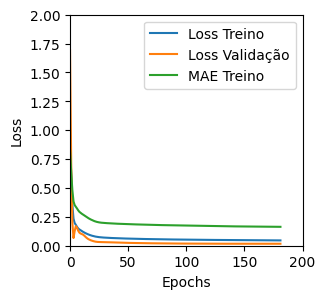

Tempo de treino: 0.23739522298177082 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.044533275067806244 , MAE = 0.16321547329425812'

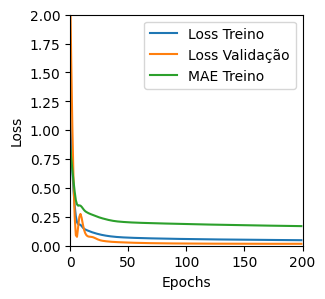

Tempo de treino: 0.3219386061032613 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.447398841381073 , MAE = 0.49845248460769653'

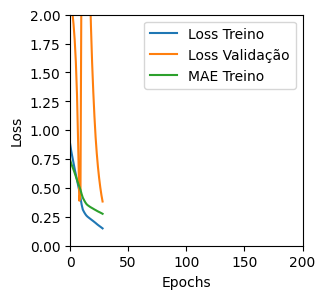

Tempo de treino: 0.1741549253463745 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19481012225151062 , MAE = 0.334809809923172'

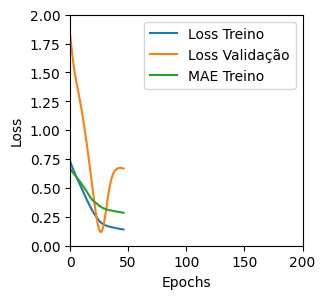

Tempo de treino: 0.20936312675476074 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13515552878379822 , MAE = 0.283455491065979'

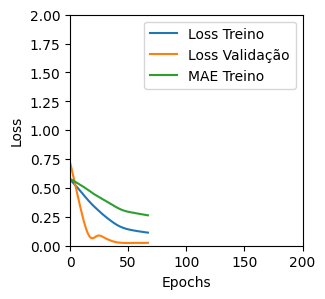

Tempo de treino: 0.1469031810760498 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.843183696269989 , MAE = 0.713079035282135'

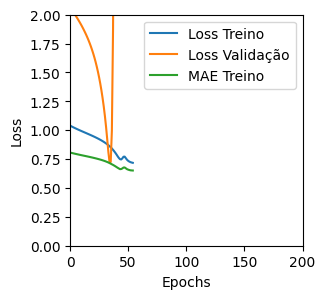

Tempo de treino: 0.12075190544128418 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4702135920524597 , MAE = 0.5217308402061462'

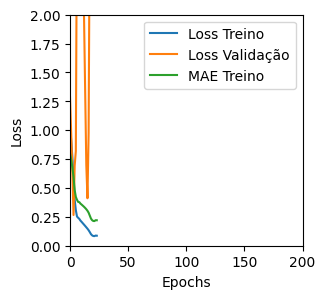

Tempo de treino: 0.21011226574579875 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5721064805984497 , MAE = 0.6050155162811279'

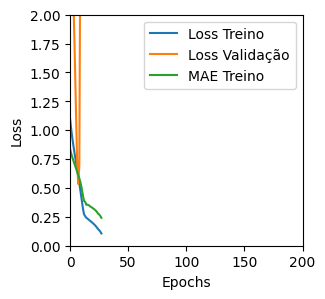

Tempo de treino: 0.11951388120651245 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35959312319755554 , MAE = 0.46144813299179077'

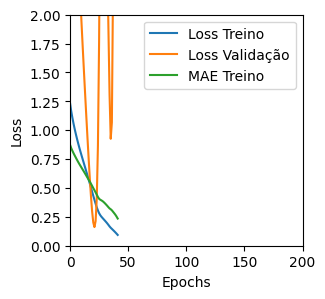

Tempo de treino: 0.13747849861780803 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1821061372756958 , MAE = 0.3355783522129059'

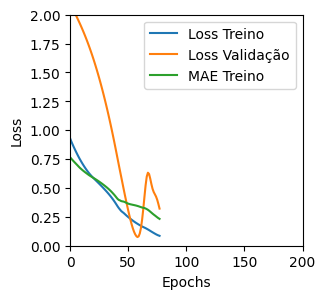

Tempo de treino: 0.14341987371444703 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4663788378238678 , MAE = 0.5260487198829651'

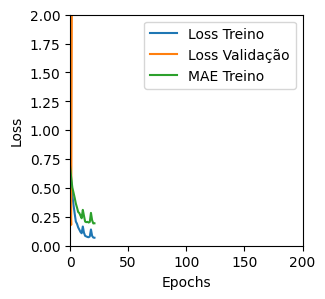

Tempo de treino: 0.15590323209762574 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6451302766799927 , MAE = 0.6178908944129944'

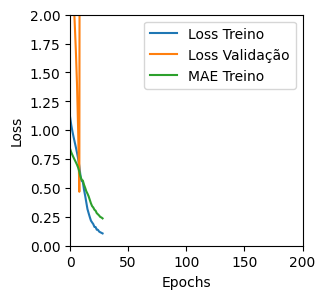

Tempo de treino: 0.12443734010060628 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5119994282722473 , MAE = 0.5409457683563232'

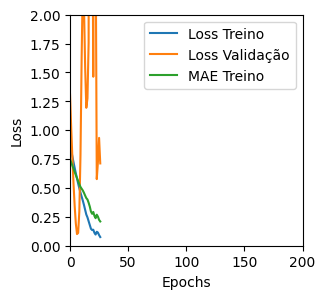

Tempo de treino: 0.12355758349100748 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2566307485103607 , MAE = 0.38094982504844666'

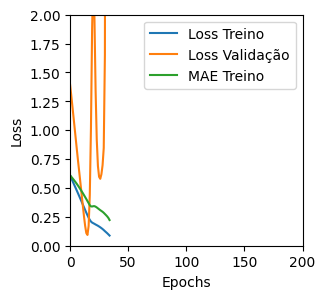

Tempo de treino: 0.08410137891769409 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.057113200426101685 , MAE = 0.18925641477108002'

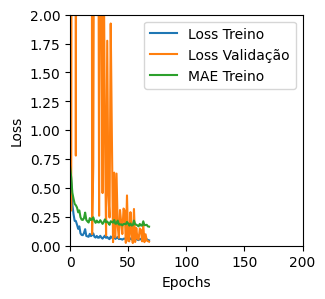

Tempo de treino: 0.3353433807690938 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4252728819847107 , MAE = 0.5065577030181885'

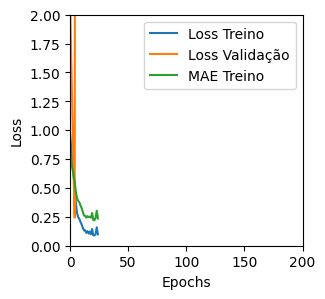

Tempo de treino: 0.11070378224054972 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29186680912971497 , MAE = 0.41010019183158875'

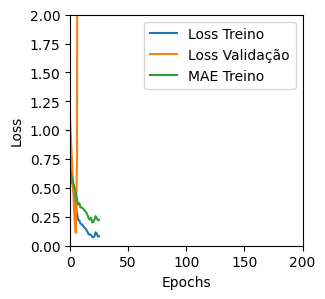

Tempo de treino: 0.11005958716074625 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3559565842151642 , MAE = 0.46036553382873535'

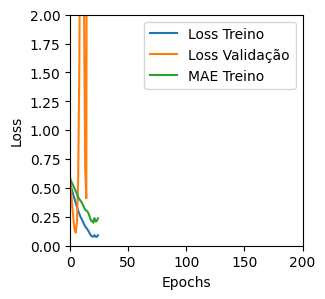

Tempo de treino: 0.12747892538706462 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1847963035106659 , MAE = 0.32711198925971985'

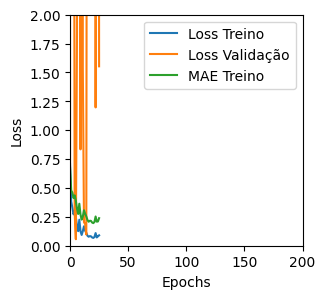

Tempo de treino: 0.214215354124705 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15358920395374298 , MAE = 0.2684372663497925'

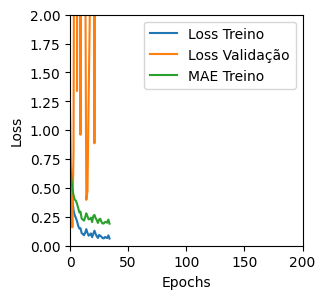

Tempo de treino: 0.15131043195724486 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39131802320480347 , MAE = 0.473042368888855'

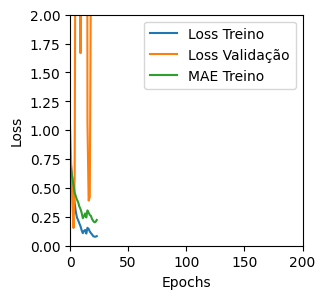

Tempo de treino: 0.08499902486801147 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12064310908317566 , MAE = 0.2588191628456116'

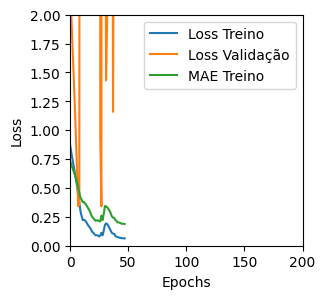

Tempo de treino: 0.1107367475827535 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31125330924987793 , MAE = 0.4318944811820984'

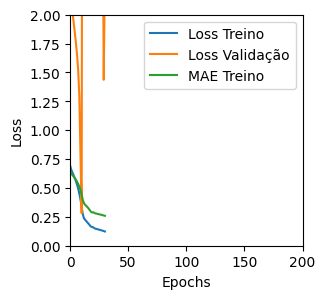

Tempo de treino: 0.21143282254536946 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6839132308959961 , MAE = 0.6526867747306824'

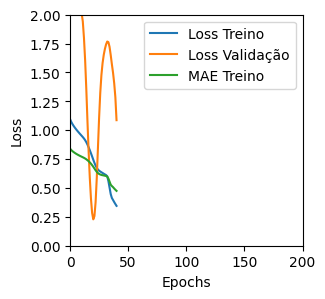

Tempo de treino: 0.15083991289138793 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5613817572593689 , MAE = 0.5693108439445496'

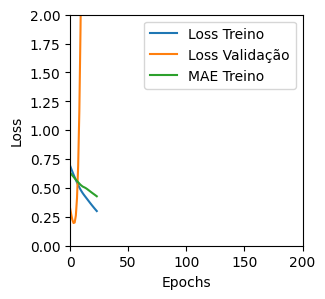

Tempo de treino: 0.1396058956782023 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12955015897750854 , MAE = 0.2697979509830475'

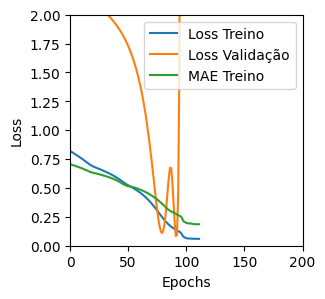

Tempo de treino: 0.17969693342844645 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.521390974521637 , MAE = 0.566011369228363'

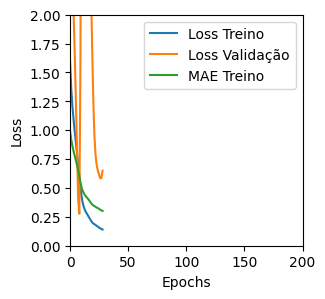

Tempo de treino: 0.21403310298919678 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6099711060523987 , MAE = 0.5977444052696228'

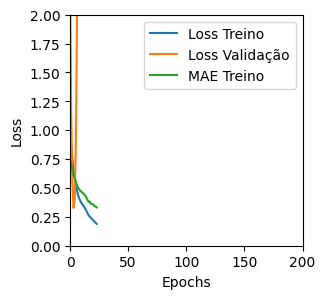

Tempo de treino: 0.12233693599700927 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4902591109275818 , MAE = 0.5279300212860107'

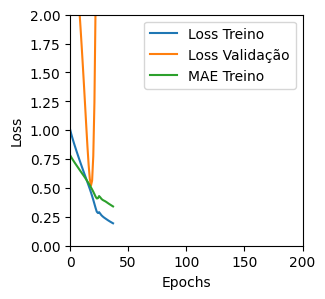

Tempo de treino: 0.12032426198323568 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47370779514312744 , MAE = 0.51973557472229'

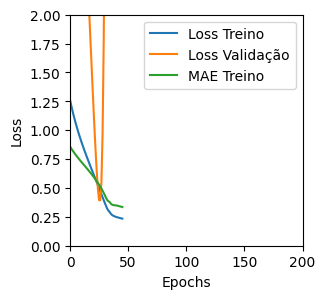

Tempo de treino: 0.12048383951187133 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34068211913108826 , MAE = 0.4239961504936218'

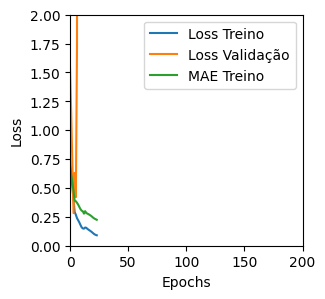

Tempo de treino: 0.14227246443430583 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2902386486530304 , MAE = 0.40052345395088196'

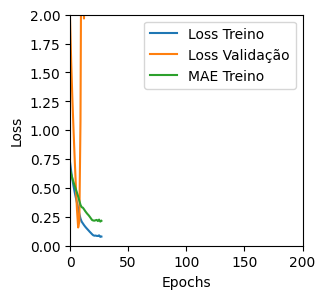

Tempo de treino: 0.14891235828399657 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37529119849205017 , MAE = 0.47043970227241516'

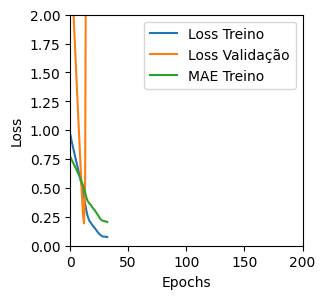

Tempo de treino: 0.12820706764856973 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49000978469848633 , MAE = 0.5251885056495667'

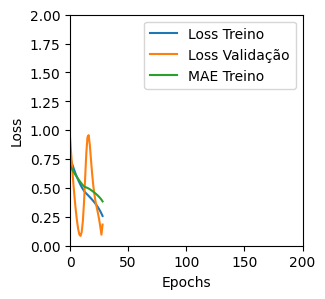

Tempo de treino: 0.07477269967397054 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0639200285077095 , MAE = 0.19385956227779388'

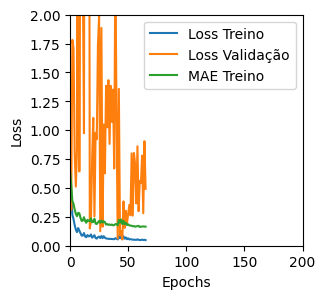

Tempo de treino: 0.3841858108838399 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2938767373561859 , MAE = 0.38875243067741394'

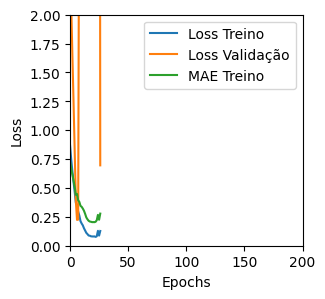

Tempo de treino: 0.12181843121846517 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41372042894363403 , MAE = 0.48785272240638733'

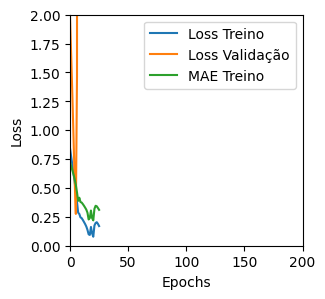

Tempo de treino: 0.12934460242589316 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36898407340049744 , MAE = 0.4518376588821411'

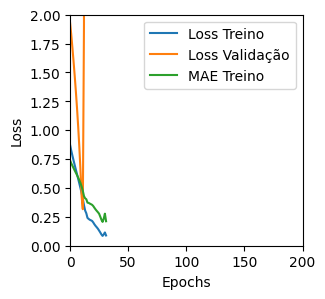

Tempo de treino: 0.0868722399075826 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5177133679389954 , MAE = 0.5702102780342102'

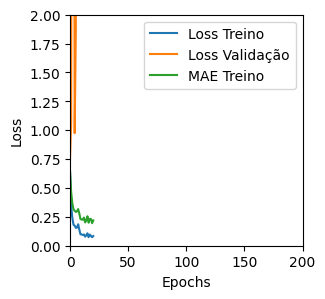

Tempo de treino: 0.2108052134513855 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1132684051990509 , MAE = 0.24427306652069092'

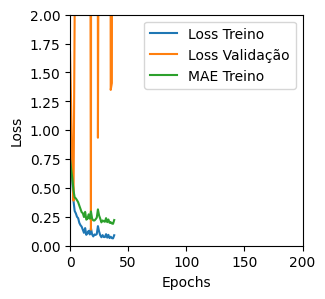

Tempo de treino: 0.19181747436523439 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3690076768398285 , MAE = 0.46091386675834656'

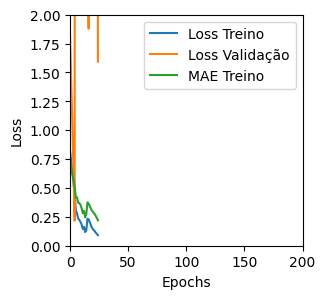

Tempo de treino: 0.12763702074686686 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.48499563336372375 , MAE = 0.5284673571586609'

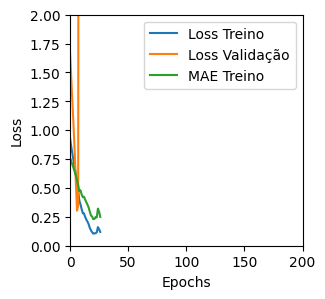

Tempo de treino: 0.08950881560643514 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15542402863502502 , MAE = 0.2943366765975952'

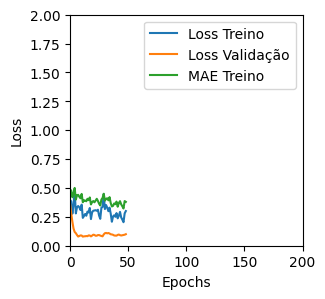

Tempo de treino: 0.38332929611206057 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23761382699012756 , MAE = 0.3818399906158447'

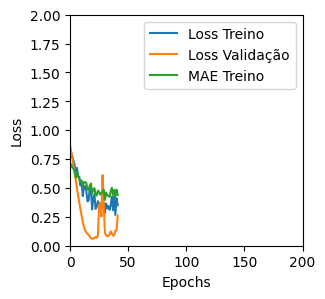

Tempo de treino: 0.13299623330434163 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.0162248611450195 , MAE = 0.7851139903068542'

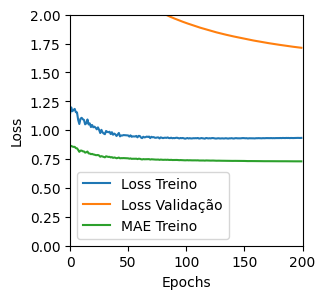

Tempo de treino: 0.38886571327845254 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5088366270065308 , MAE = 0.4896334707736969'

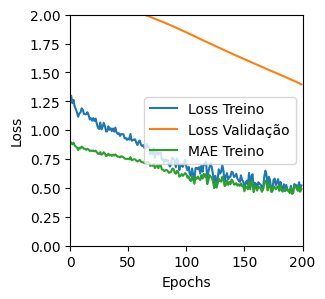

Tempo de treino: 0.24181877772013347 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13399136066436768 , MAE = 0.26457226276397705'

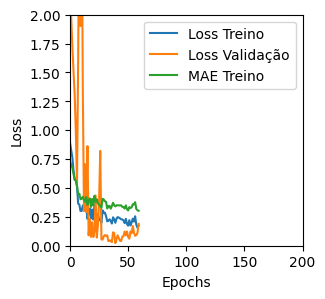

Tempo de treino: 0.33727349042892457 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29500812292099 , MAE = 0.39018985629081726'

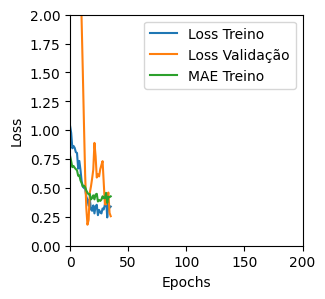

Tempo de treino: 0.1500141421953837 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49994269013404846 , MAE = 0.5394301414489746'

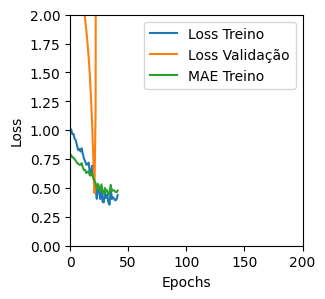

Tempo de treino: 0.12663900057474772 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.552379310131073 , MAE = 0.5637335777282715'

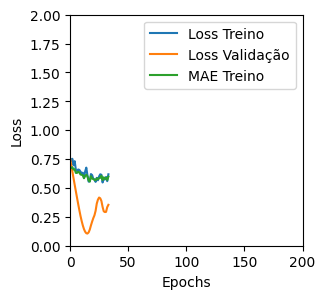

Tempo de treino: 0.0915634791056315 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18066149950027466 , MAE = 0.3104313313961029'

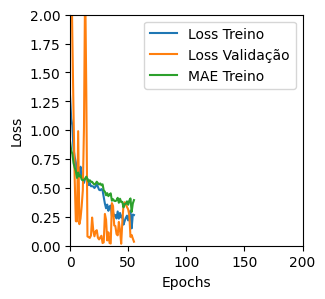

Tempo de treino: 0.3822841962178548 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07713942974805832 , MAE = 0.21269774436950684'

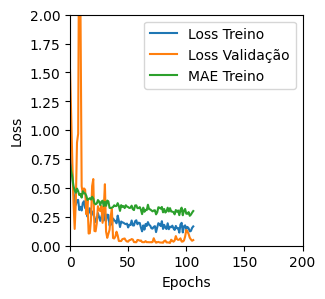

Tempo de treino: 0.29978322982788086 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30678343772888184 , MAE = 0.4054230749607086'

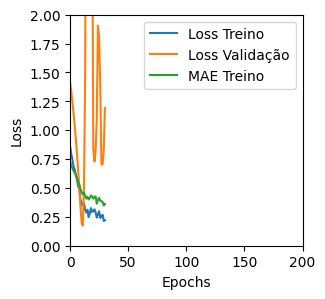

Tempo de treino: 0.12113606929779053 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3375200927257538 , MAE = 0.4176090955734253'

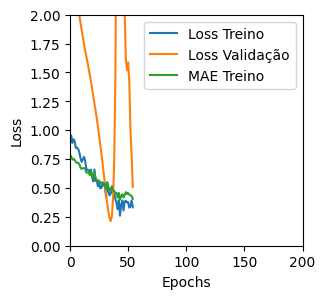

Tempo de treino: 0.09453444878260295 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09763729572296143 , MAE = 0.22505907714366913'

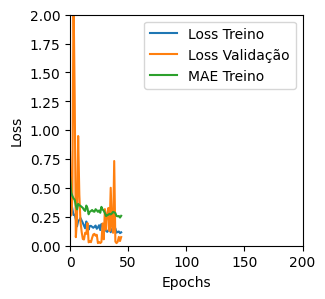

Tempo de treino: 0.29130409558614095 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.057403840124607086 , MAE = 0.18697333335876465'

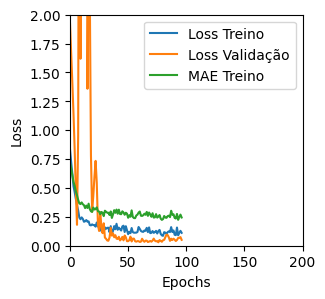

Tempo de treino: 0.3852185845375061 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27163878083229065 , MAE = 0.37510791420936584'

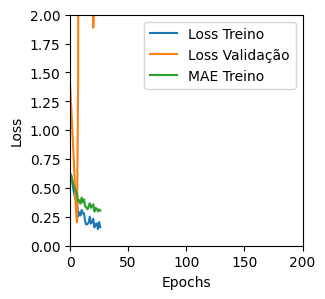

Tempo de treino: 0.08439722061157226 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34819915890693665 , MAE = 0.44872546195983887'

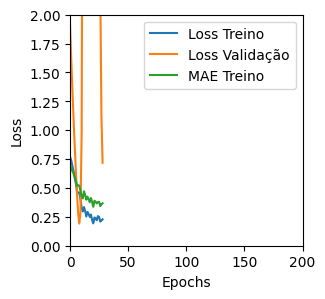

Tempo de treino: 0.07366861502329508 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0916225016117096 , MAE = 0.22746595740318298'

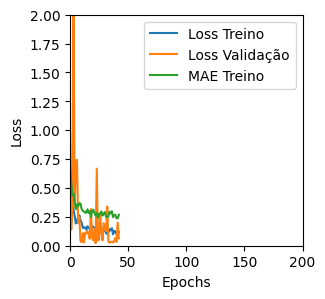

Tempo de treino: 0.2653158664703369 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37597036361694336 , MAE = 0.46631744503974915'

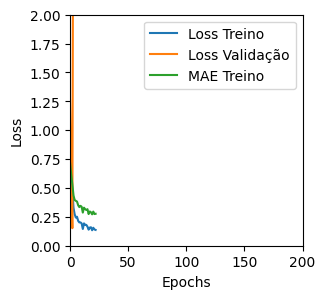

Tempo de treino: 0.10166186889012654 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16394101083278656 , MAE = 0.2917376458644867'

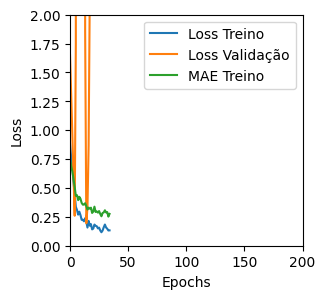

Tempo de treino: 0.11122997999191284 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4380459189414978 , MAE = 0.5067416429519653'

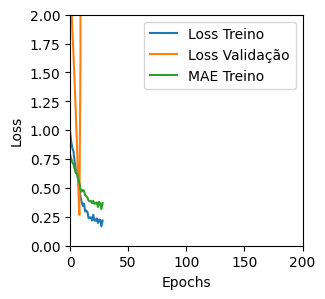

Tempo de treino: 0.1465160886446635 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com GRU_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0465179868042469 , MAE = 0.16527101397514343'

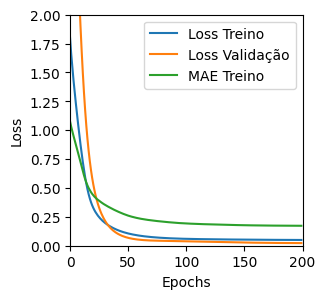

Tempo de treino: 0.9976604382197062 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048388026654720306 , MAE = 0.17213279008865356'

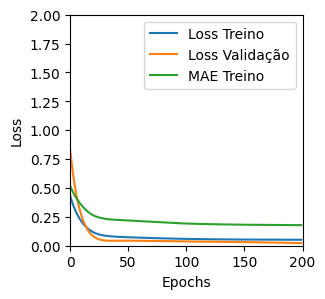

Tempo de treino: 0.7321001251538595 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18289077281951904 , MAE = 0.3502964973449707'

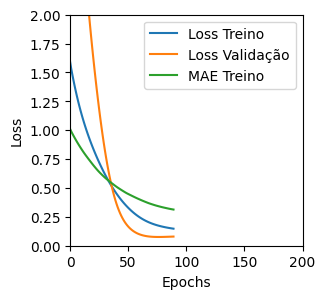

Tempo de treino: 0.2062839468320211 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07538080960512161 , MAE = 0.21458572149276733'

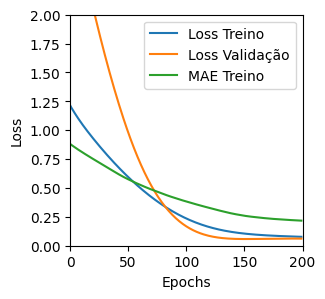

Tempo de treino: 0.28692654371261594 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com GRU_v1 , timesteps=24, units=8, batch=4


'TRAINING set. Loss = 0.042931076139211655 , MAE = 0.15922322869300842'

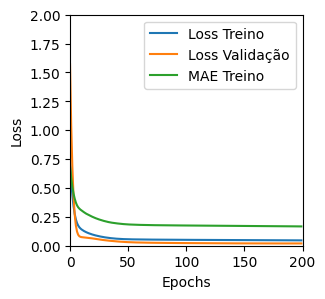

Tempo de treino: 1.438271443049113 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.047197725623846054 , MAE = 0.16834262013435364'

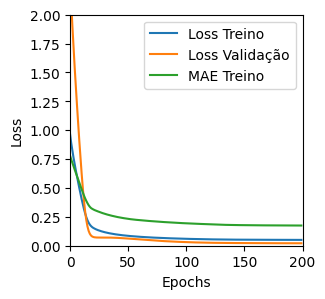

Tempo de treino: 0.7439736247062683 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04753414914011955 , MAE = 0.16976863145828247'

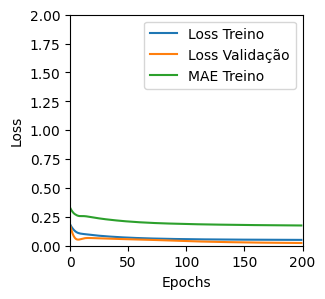

Tempo de treino: 0.7282189726829529 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21686694025993347 , MAE = 0.3846690356731415'

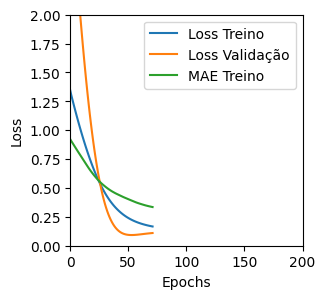

Tempo de treino: 0.13354442914326986 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04168841987848282 , MAE = 0.1561979204416275'

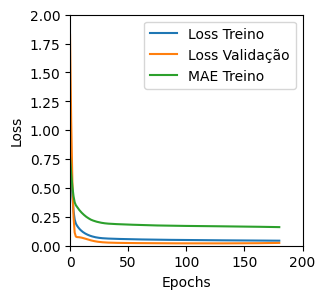

Tempo de treino: 1.4568757653236388 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.044601909816265106 , MAE = 0.16153593361377716'

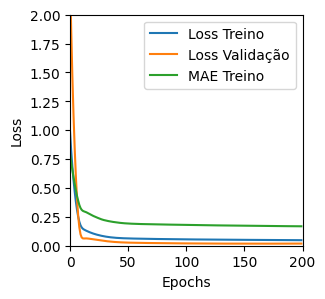

Tempo de treino: 0.6142389376958212 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18682385981082916 , MAE = 0.33707311749458313'

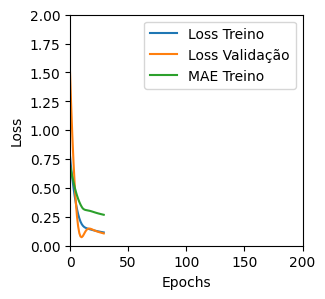

Tempo de treino: 0.10506402254104615 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.062064751982688904 , MAE = 0.19132816791534424'

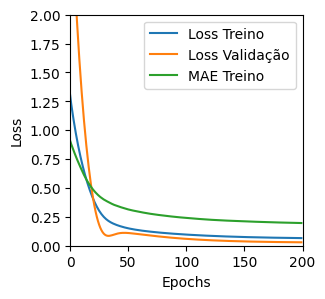

Tempo de treino: 0.3871723135312398 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04270373657345772 , MAE = 0.1570436954498291'

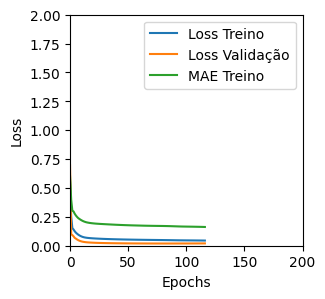

Tempo de treino: 0.7334738492965698 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com GRU_v1 , timesteps=24, units=32, batch=8


'TRAINING set. Loss = 0.045537371188402176 , MAE = 0.16340136528015137'

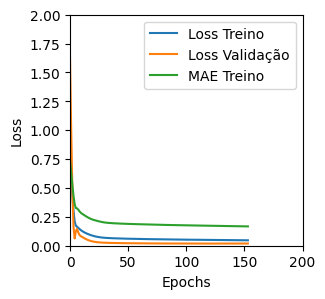

Tempo de treino: 0.7350774844487508 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04711904376745224 , MAE = 0.1658717393875122'

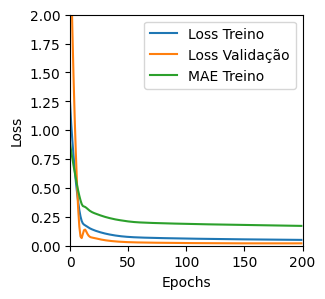

Tempo de treino: 0.4197498480478922 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05632835626602173 , MAE = 0.1808091253042221'

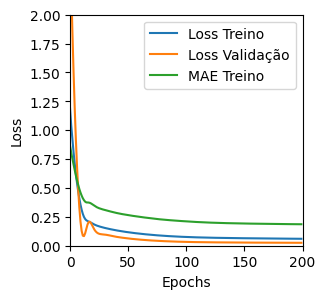

Tempo de treino: 0.4000475724538167 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.041169673204422 , MAE = 0.1559273600578308'

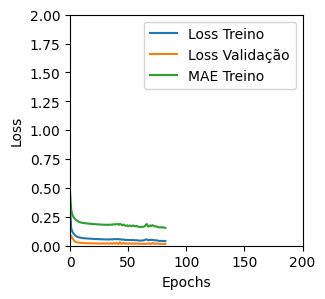

Tempo de treino: 0.7453449050585429 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04828314110636711 , MAE = 0.16810065507888794'

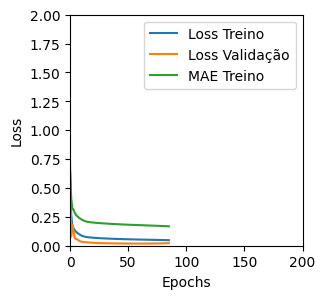

Tempo de treino: 0.3876589298248291 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04876707121729851 , MAE = 0.16896729171276093'

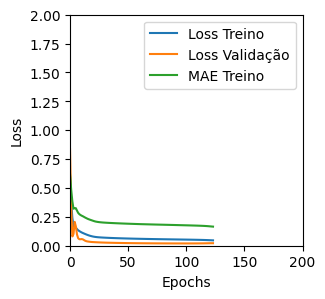

Tempo de treino: 0.3957885384559631 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.051033470779657364 , MAE = 0.1728203147649765'

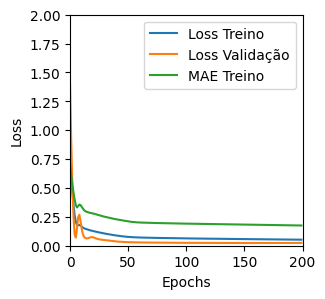

Tempo de treino: 0.3342303276062012 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.186896413564682 , MAE = 0.3136534094810486'

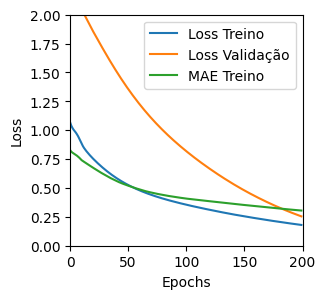

Tempo de treino: 0.996733554204305 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3077325224876404 , MAE = 0.3869488835334778'

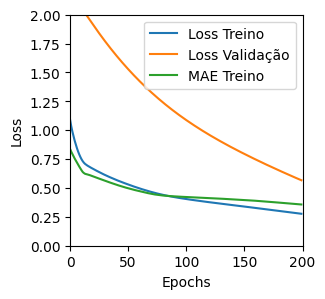

Tempo de treino: 0.7261024196942647 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5849559903144836 , MAE = 0.5690404772758484'

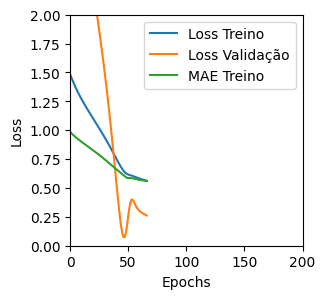

Tempo de treino: 0.1584844430287679 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7477086782455444 , MAE = 0.6819376945495605'

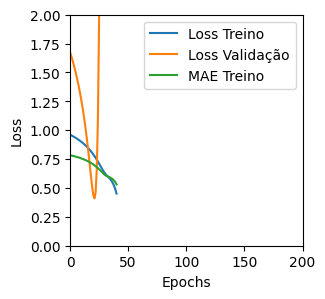

Tempo de treino: 0.07967004378636679 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1214660033583641 , MAE = 0.26941803097724915'

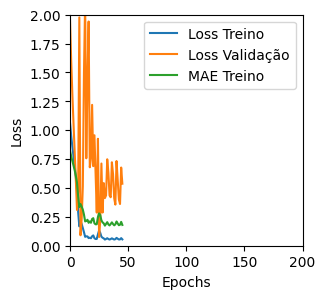

Tempo de treino: 0.4062863389650981 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04824276641011238 , MAE = 0.17170776426792145'

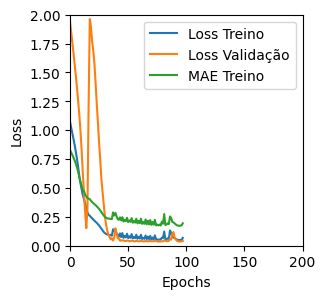

Tempo de treino: 0.3753483732541402 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5662366151809692 , MAE = 0.571985125541687'

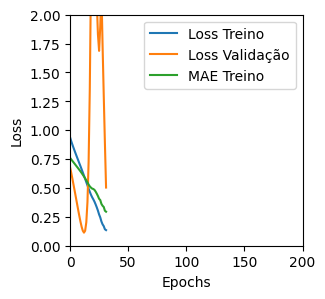

Tempo de treino: 0.09673731327056885 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4973387122154236 , MAE = 0.47370147705078125'

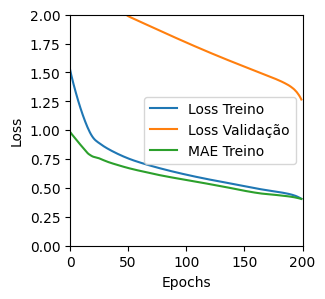

Tempo de treino: 0.27955964803695676 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19667674601078033 , MAE = 0.33151036500930786'

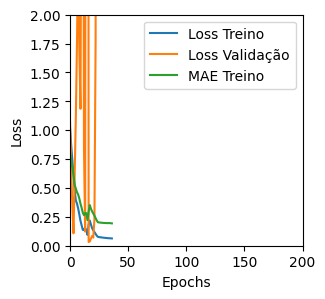

Tempo de treino: 0.3798573891321818 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04720612242817879 , MAE = 0.16664354503154755'

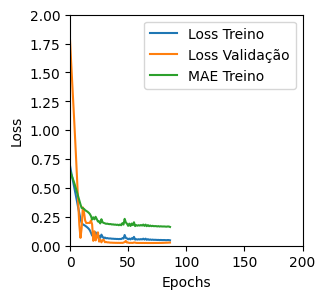

Tempo de treino: 0.37670123179753623 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3662339150905609 , MAE = 0.45257100462913513'

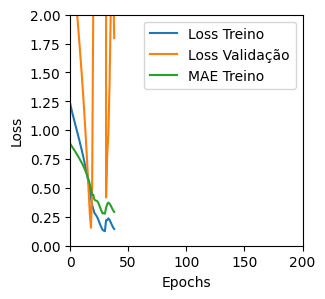

Tempo de treino: 0.12867083152135214 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.423898309469223 , MAE = 0.5020110011100769'

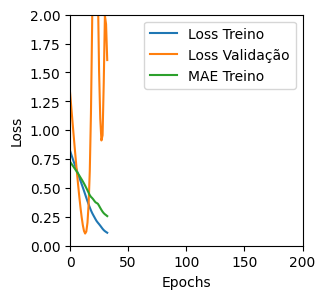

Tempo de treino: 0.07849057515462239 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05130479857325554 , MAE = 0.17853565514087677'

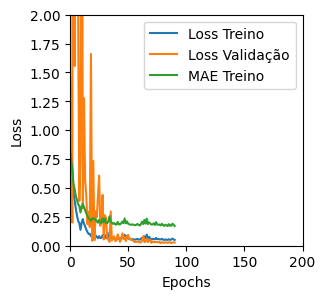

Tempo de treino: 0.7546885689099629 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2216060608625412 , MAE = 0.35819587111473083'

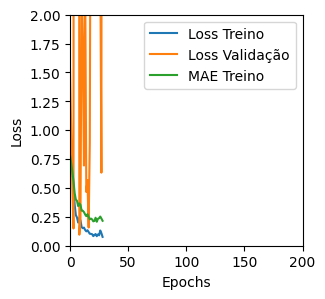

Tempo de treino: 0.21424582004547119 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13915635645389557 , MAE = 0.273396760225296'

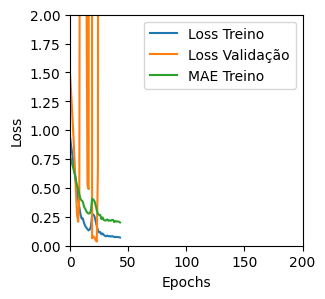

Tempo de treino: 0.1387493133544922 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3939966559410095 , MAE = 0.4609341621398926'

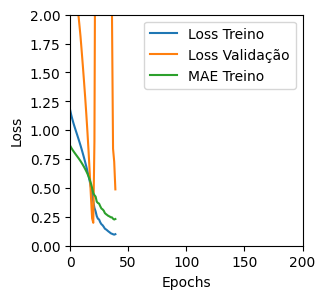

Tempo de treino: 0.12088455359141032 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05719649791717529 , MAE = 0.1798321157693863'

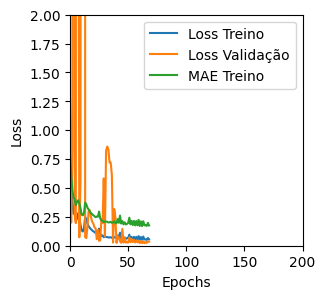

Tempo de treino: 0.7291112860043844 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.060350414365530014 , MAE = 0.19164900481700897'

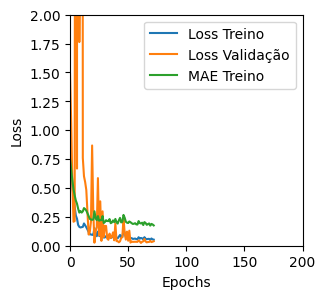

Tempo de treino: 0.29917938709259034 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25687313079833984 , MAE = 0.3830660879611969'

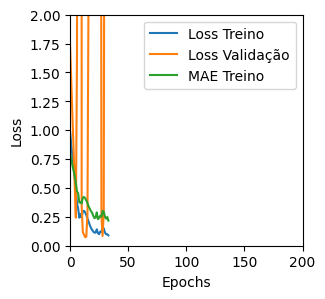

Tempo de treino: 0.12780027786890666 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.324057936668396 , MAE = 0.41858887672424316'

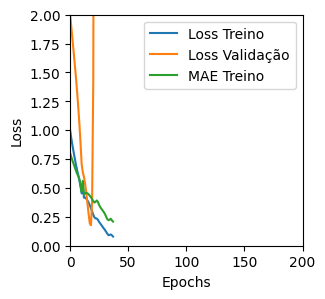

Tempo de treino: 0.11034494241078695 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4769432544708252 , MAE = 0.5434454083442688'

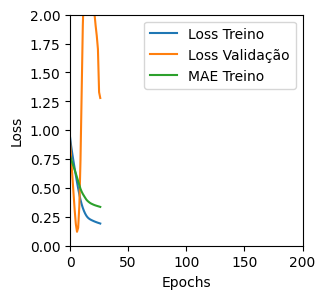

Tempo de treino: 0.2271877924601237 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29390689730644226 , MAE = 0.3757582902908325'

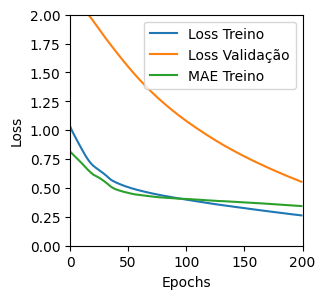

Tempo de treino: 0.7260857462882996 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5297858119010925 , MAE = 0.49388277530670166'

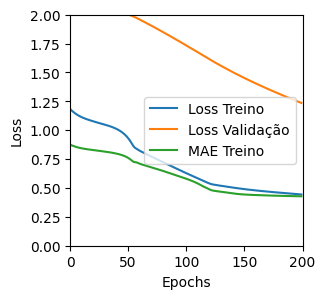

Tempo de treino: 0.3896205345789591 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5948044061660767 , MAE = 0.5285898447036743'

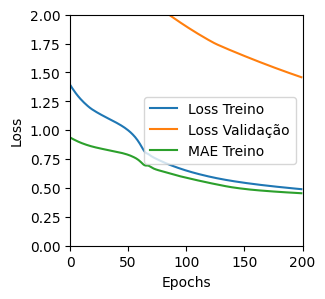

Tempo de treino: 0.3783560752868652 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05830236151814461 , MAE = 0.17755231261253357'

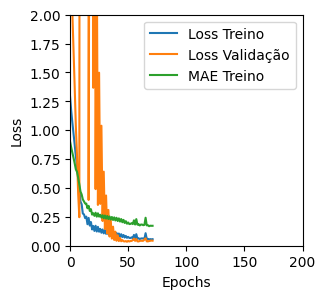

Tempo de treino: 0.7209762136141459 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.8436135053634644 , MAE = 0.723772406578064'

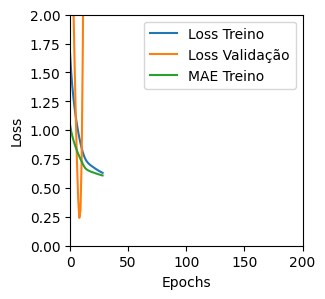

Tempo de treino: 0.11931542158126832 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.46987679600715637 , MAE = 0.5358012914657593'

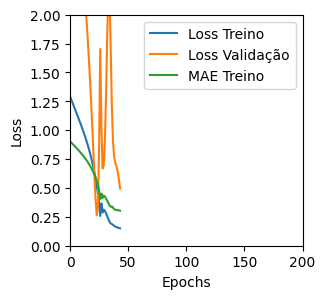

Tempo de treino: 0.12345612049102783 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29860055446624756 , MAE = 0.397368848323822'

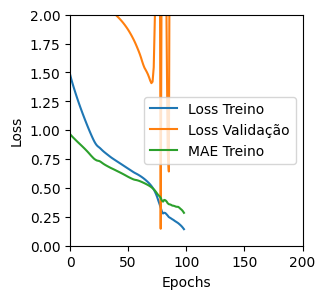

Tempo de treino: 0.23401441176732382 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04685797914862633 , MAE = 0.16260647773742676'

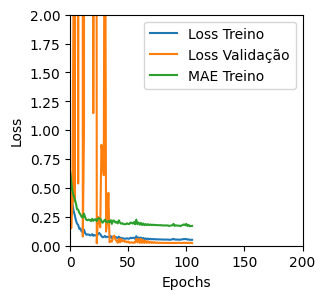

Tempo de treino: 0.727800726890564 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2694609761238098 , MAE = 0.3988840878009796'

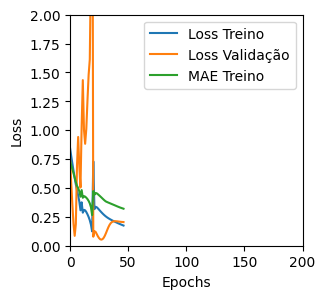

Tempo de treino: 0.21266321341196695 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5741237998008728 , MAE = 0.5787321925163269'

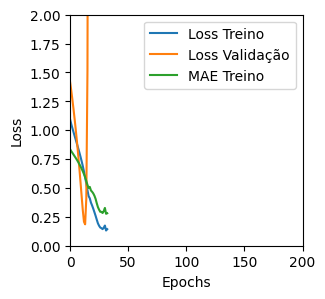

Tempo de treino: 0.1225251317024231 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47091349959373474 , MAE = 0.5156539082527161'

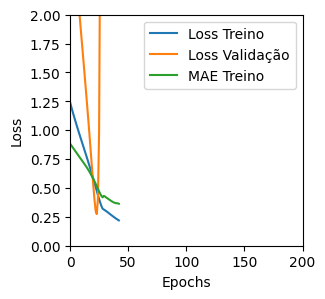

Tempo de treino: 0.1245429277420044 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07824686169624329 , MAE = 0.2103823870420456'

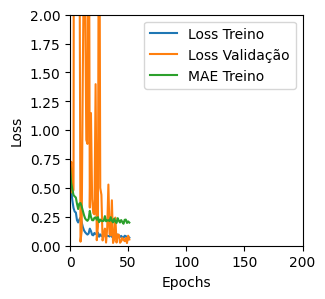

Tempo de treino: 0.3074904243151347 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32607853412628174 , MAE = 0.4403906762599945'

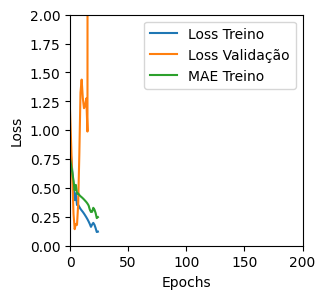

Tempo de treino: 0.1254828929901123 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25977036356925964 , MAE = 0.37001872062683105'

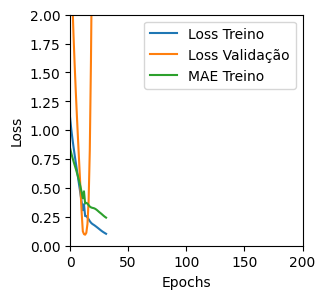

Tempo de treino: 0.14332029819488526 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.45655718445777893 , MAE = 0.5052478313446045'

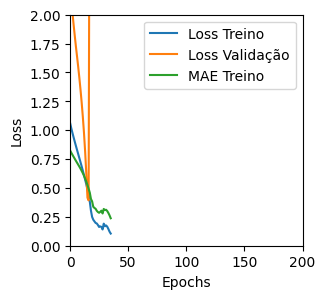

Tempo de treino: 0.12730396986007692 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.44105327129364014 , MAE = 0.5175457000732422'

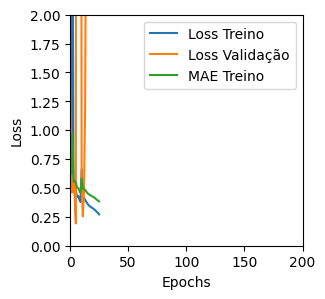

Tempo de treino: 0.21161833604176838 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2594233453273773 , MAE = 0.3853858411312103'

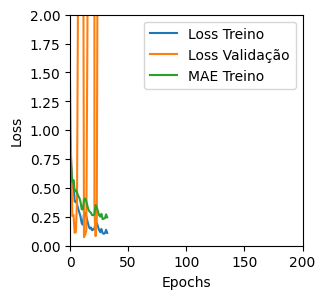

Tempo de treino: 0.16251646677652995 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4252977669239044 , MAE = 0.49282997846603394'

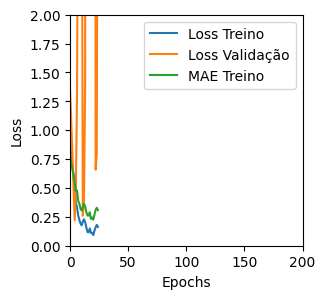

Tempo de treino: 0.12265063921610514 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3615040183067322 , MAE = 0.455037385225296'

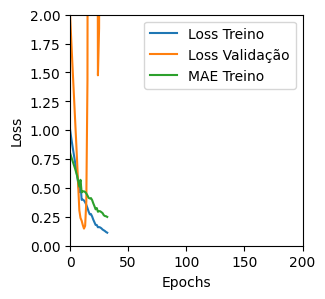

Tempo de treino: 0.08522478739420573 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4864905774593353 , MAE = 0.5399155020713806'

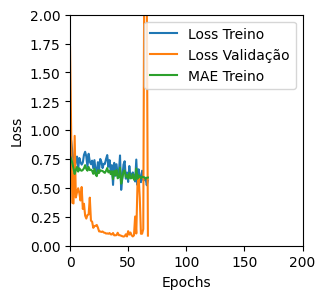

Tempo de treino: 0.36462744474411013 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4537966251373291 , MAE = 0.4969874918460846'

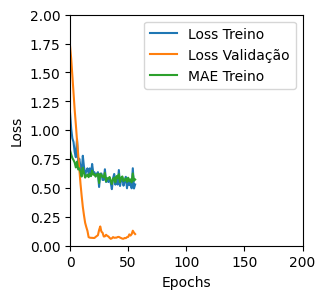

Tempo de treino: 0.24375809828440348 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.11264169216156 , MAE = 0.8407535552978516'

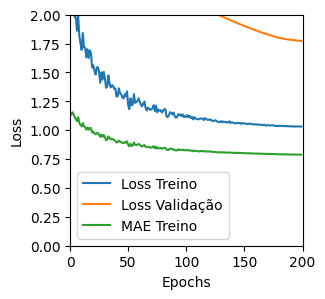

Tempo de treino: 0.4074144959449768 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 2.8070068359375 , MAE = 1.300191044807434'

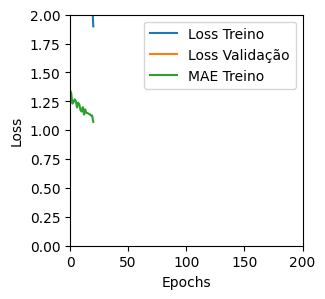

Tempo de treino: 0.07014079491297404 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19611841440200806 , MAE = 0.3108707368373871'

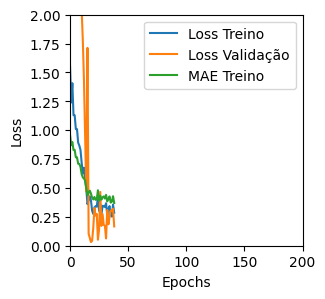

Tempo de treino: 0.390449051062266 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6322676539421082 , MAE = 0.6232553124427795'

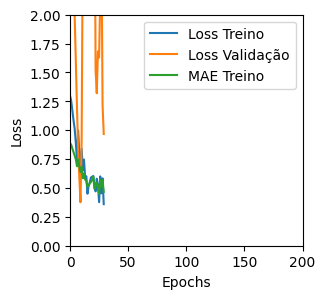

Tempo de treino: 0.2168005386988322 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2948262691497803 , MAE = 0.41049614548683167'

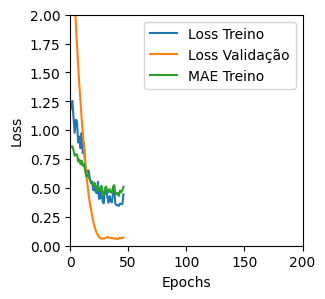

Tempo de treino: 0.12522502342859904 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.740966796875 , MAE = 0.6650984883308411'

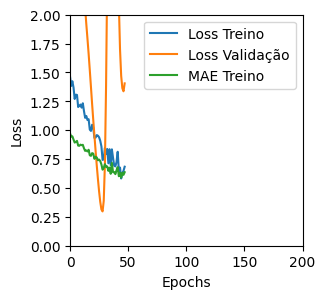

Tempo de treino: 0.0902603268623352 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08430533111095428 , MAE = 0.22345761954784393'

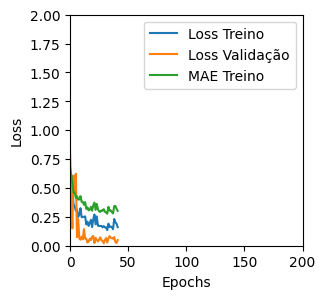

Tempo de treino: 0.4036174972852071 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13294357061386108 , MAE = 0.2610599398612976'

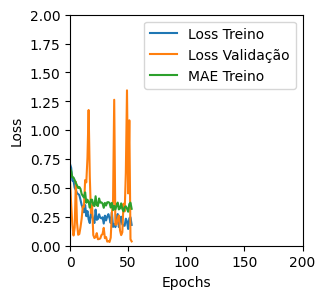

Tempo de treino: 0.21931310494740805 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5914281010627747 , MAE = 0.5713484287261963'

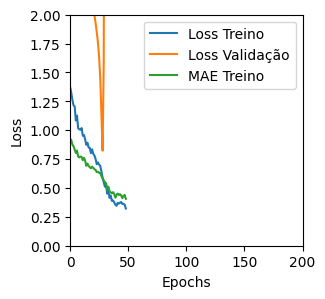

Tempo de treino: 0.22264517148335775 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29745176434516907 , MAE = 0.3984893560409546'

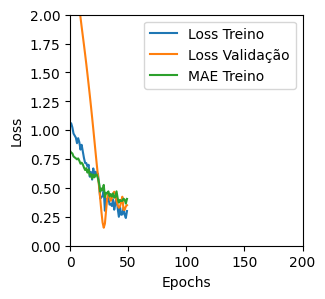

Tempo de treino: 0.11034181515375772 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10308621823787689 , MAE = 0.23087278008460999'

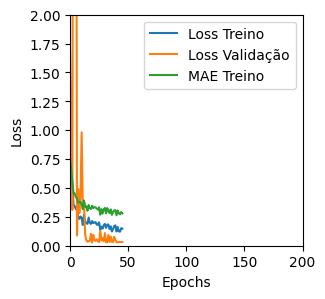

Tempo de treino: 0.2774366021156311 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07774589210748672 , MAE = 0.20246738195419312'

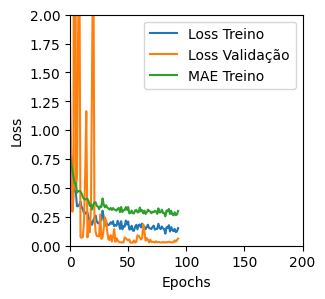

Tempo de treino: 0.3438211401303609 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33673200011253357 , MAE = 0.4147894084453583'

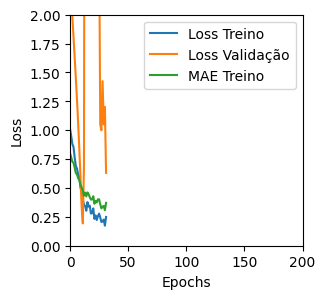

Tempo de treino: 0.12209426561991374 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5211358666419983 , MAE = 0.5614762306213379'

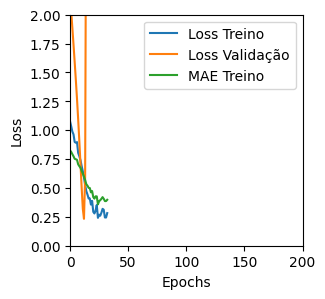

Tempo de treino: 0.08271999359130859 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09899809956550598 , MAE = 0.22484996914863586'

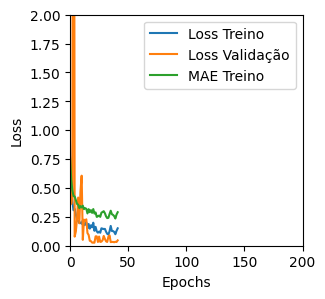

Tempo de treino: 0.34150502681732176 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09169070422649384 , MAE = 0.2204795926809311'

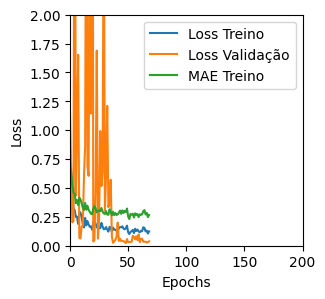

Tempo de treino: 0.3866452137629191 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22023624181747437 , MAE = 0.34990137815475464'

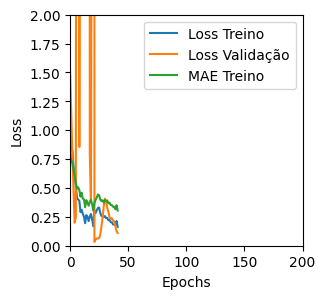

Tempo de treino: 0.21357457637786864 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4730616509914398 , MAE = 0.5294678807258606'

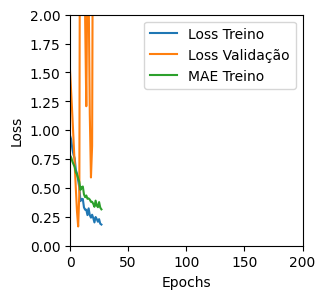

Tempo de treino: 0.08084351619084676 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com GRU_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.052136532962322235 , MAE = 0.17719267308712006'

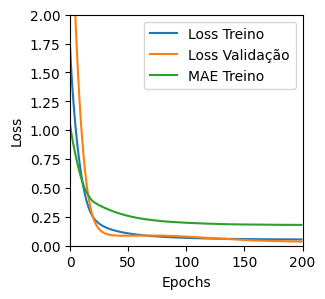

Tempo de treino: 1.1852908730506897 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1533193290233612 , MAE = 0.3085622787475586'

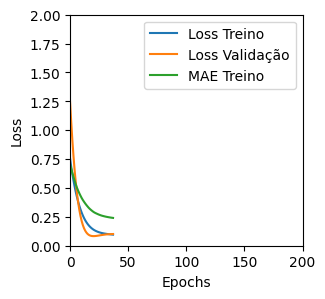

Tempo de treino: 0.21432912747065228 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14958342909812927 , MAE = 0.3115212321281433'

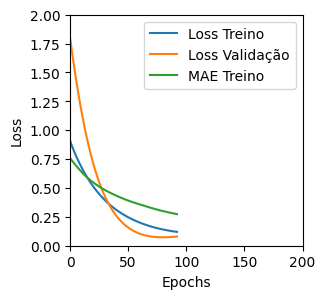

Tempo de treino: 0.3851587454477946 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09533320367336273 , MAE = 0.24974524974822998'

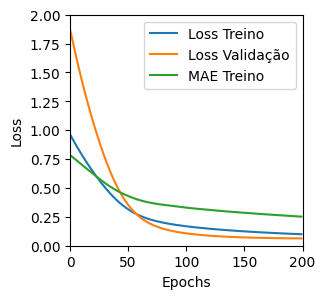

Tempo de treino: 0.3934361696243286 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04782869666814804 , MAE = 0.16998249292373657'

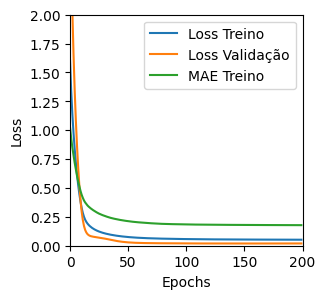

Tempo de treino: 1.4260708292325337 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04909525811672211 , MAE = 0.17140594124794006'

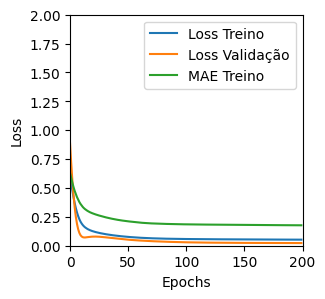

Tempo de treino: 0.7591614445050557 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11128551512956619 , MAE = 0.26359567046165466'

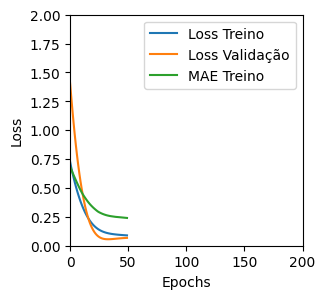

Tempo de treino: 0.15480536619822186 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1386188417673111 , MAE = 0.29888877272605896'

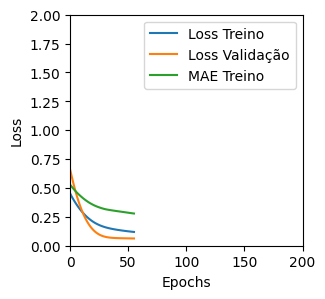

Tempo de treino: 0.18018529415130616 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.046419475227594376 , MAE = 0.16686226427555084'

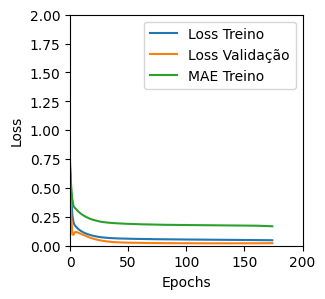

Tempo de treino: 1.1620936036109923 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05037682130932808 , MAE = 0.1731370985507965'

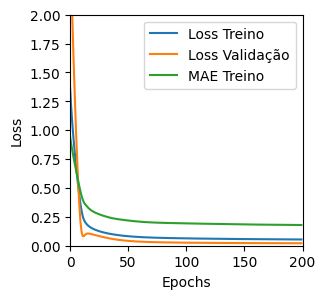

Tempo de treino: 1.414428969224294 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1933421492576599 , MAE = 0.3387141227722168'

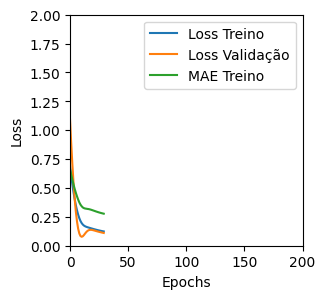

Tempo de treino: 0.11616702477137247 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12229016423225403 , MAE = 0.26830875873565674'

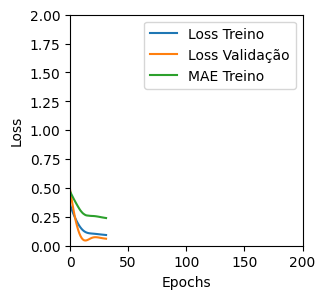

Tempo de treino: 0.1004232128461202 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.047996148467063904 , MAE = 0.16971644759178162'

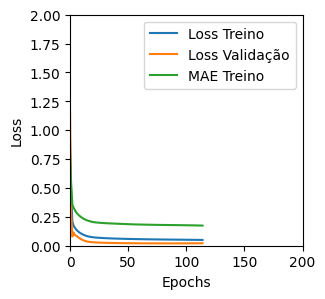

Tempo de treino: 1.4391579151153564 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.047872282564640045 , MAE = 0.17014403641223907'

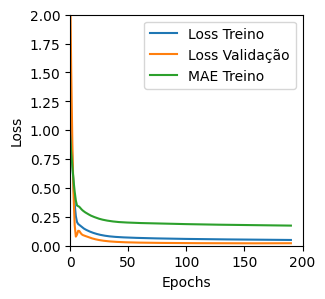

Tempo de treino: 1.4142322540283203 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05195268243551254 , MAE = 0.17536523938179016'

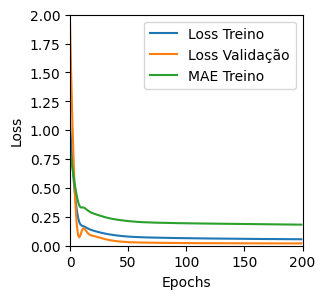

Tempo de treino: 0.7314396460851034 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1674901694059372 , MAE = 0.3108465373516083'

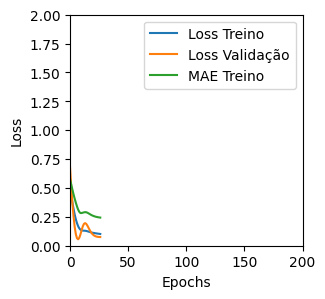

Tempo de treino: 0.0897669235865275 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04590338096022606 , MAE = 0.16545513272285461'

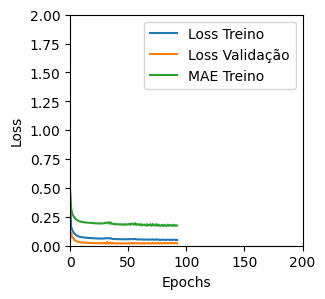

Tempo de treino: 0.7376636028289795 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04850737005472183 , MAE = 0.17017023265361786'

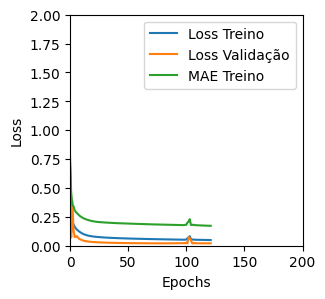

Tempo de treino: 0.5850823879241943 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.052035629749298096 , MAE = 0.1748141050338745'

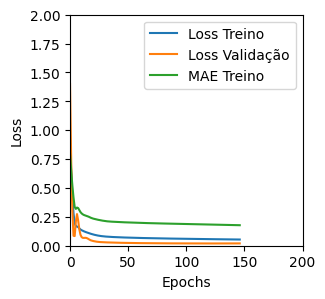

Tempo de treino: 0.7312994877497355 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.051487550139427185 , MAE = 0.1767222285270691'

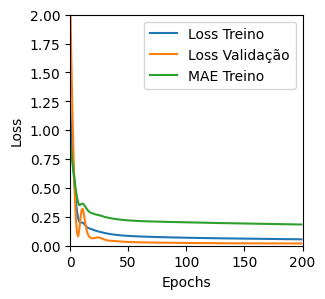

Tempo de treino: 0.3988420923550924 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


In [7]:
all_results = pd.DataFrame(columns=['model_type','model',feature,'unit','optimizer', 'batch_size', 'timesteps', 'loss','mae'])

# hyper parâmetros testados
model_hyperparams = ['LSTM_v1', 'LSTM_v2', 'LSTM_v3', 'GRU_v1']
timesteps_hyperparams = [6, 12, 24, 36]
units_hyperparams = [4, 8, 16, 32, 64]
batch_hyperparams = [4, 8, 16, 32]

epochs = 200
times_exec = 3

for times in range(times_exec):
  for timesteps in timesteps_hyperparams:
    for model_type_str in model_hyperparams:
      if model_type_str[:3] in ['LST', 'GRU']:
        scaler, X_train, X_test, y_train, y_test = preprocess(df, feature, timesteps, len(data_teste))
        print('X_train.shape, X_test.shape, y_train.shape, y_test.shape = ', X_train.shape, X_test.shape, y_train.shape, y_test.shape)
      for optimizer in ['Adam']:
        for unit in units_hyperparams:
          for batch_size in batch_hyperparams:

            inittime = time()
            print(f'Treinando com {model_type_str} , timesteps={timesteps}, units={unit}, batch={batch_size}')
            m, h = model_type(model_type_str, unit=unit, optimizer=optimizer, timesteps=timesteps, X=X_train, y=y_train, epochs=epochs, batch_size=batch_size)
            endtime = time()
            print(f'Tempo de treino: {(endtime-inittime)/60} minutos' )
            score = m.evaluate(X_test, y_test, batch_size=batch_size, verbose=0)
            all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,
                                              'optimizer':optimizer, 'batch_size':batch_size, 'timesteps':timesteps,
                                              'loss':score[0], 'mae':score[1]}, ignore_index=True)
            del m, h

### Desempenho ordenado por menor MAE na base de validação
É considerada a melhor média, em termos de MAE, das três execuções

In [8]:
print(len(all_results))
mean_mae = all_results.groupby(['model_type', 'unit', 'batch_size', 'optimizer', 'timesteps'])['mae'].mean().reset_index()
mean_mae.sort_values(by=['mae'])
print(len(mean_mae))
mean_mae

960
320


,model_type,unit,batch_size,optimizer,timesteps,mae
0,GRU_v1,4,4,Adam,6,0.139334
1,GRU_v1,4,4,Adam,12,0.150368
2,GRU_v1,4,4,Adam,24,0.142834
3,GRU_v1,4,4,Adam,36,0.148982
4,GRU_v1,4,8,Adam,6,0.155909
...,...,...,...,...,...,...
315,LSTM_v3,64,16,Adam,36,11.179591
316,LSTM_v3,64,32,Adam,6,0.495757
317,LSTM_v3,64,32,Adam,12,0.615153
318,LSTM_v3,64,32,Adam,24,0.757648


## 5) Avaliação na base de testes


Seleção dos melhores modelos de cada arquitetura


In [9]:
best_models_arr = []

for model_str in model_hyperparams:
  best_model = mean_mae[mean_mae['model_type'] == model_str].sort_values('mae', ascending=True).head(1)
  best_models_arr.append(best_model)

best_models_df = pd.concat(best_models_arr)
del best_models_arr
print("Melhores modelos")
dsp.display(best_models_df.sort_values('mae', ascending=True))



Melhores modelos


,model_type,unit,batch_size,optimizer,timesteps,mae
19,GRU_v1,8,4,Adam,36,0.130417
311,LSTM_v3,64,8,Adam,36,0.161361
145,LSTM_v1,64,4,Adam,12,0.171167
225,LSTM_v2,64,4,Adam,12,0.216431


### Avaliação últimos 12 meses - usando dados reais
Construção dos dados de predição, também usados no Boxplot e Swarmplot

Aqui treinamos novamente o modelo para aferição dos resultados anteriores e comparação com os 12 últimos meses da série

'TRAINING set. Loss = 0.06319514662027359 , MAE = 0.1860639750957489'

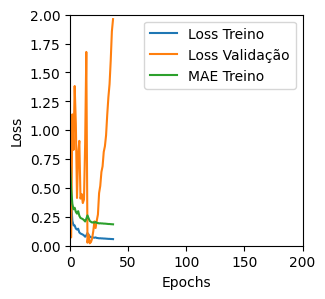

1/1 [==============================] - 0s 201ms/step


'TRAINING set. Loss = 0.0722147524356842 , MAE = 0.19950595498085022'

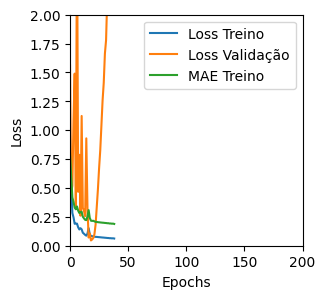

1/1 [==============================] - 0s 157ms/step


'TRAINING set. Loss = 0.17746862769126892 , MAE = 0.30365633964538574'

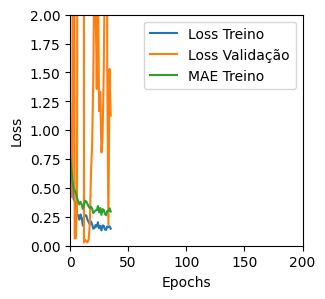

1/1 [==============================] - 0s 161ms/step


'TRAINING set. Loss = 0.048149123787879944 , MAE = 0.17047430574893951'

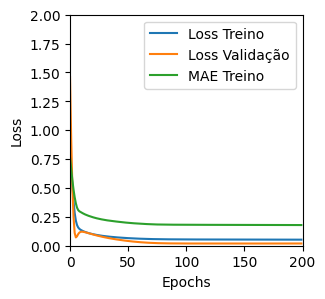

1/1 [==============================] - 0s 424ms/step
     LSTM_v1  LSTM_v1_Real   LSTM_v2  LSTM_v2_Real   LSTM_v3  LSTM_v3_Real  \
0   2.801055          2.83  2.819854          2.83  2.902853          2.83   
1   2.855099          2.85  2.872560          2.85  2.975186          2.85   
2   2.886963          2.97  2.908971          2.97  3.033556          2.97   
3   2.976768          3.01  2.991445          3.01  3.110262          3.01   
4   3.035172          3.01  3.051685          3.01  3.176984          3.01   
5   3.056064          3.18  3.070812          3.18  3.219864          3.18   
6   3.155450          3.31  3.154867          3.31  3.298050          3.31   
7   3.266819          3.29  3.260223          3.29  3.394998          3.29   
8   3.310324          3.48  3.308476          3.48  3.458375          3.48   
9   3.420789          3.58  3.406899          3.58  3.558475          3.58   
10  3.521060          3.56  3.504402          3.56  3.660565          3.56   
11  3.56152

In [10]:
aval = pd.DataFrame()

for index, setup in best_models_df.iterrows():
  scaler, X_train, X_test, y_train, y_test = preprocess(df, 'valor', setup['timesteps'], len(data_teste))
  mod, _ = model_type(setup['model_type'], setup['unit'], setup['optimizer'], setup['timesteps'], X_train, y_train,
                      epochs=epochs, batch_size=setup['batch_size'], train=True)
  best_models_df['model'] = mod
  y_pred = mod.predict(X_test)
  y_pred = scaler.inverse_transform(y_pred)
  y_real = scaler.inverse_transform(y_test)

  aval[f'{setup["model_type"]}'] = y_pred[:,0]
  aval[f'{setup["model_type"]}_Real'] = y_real[:,0]

print(aval)

#### Boxplot e Swarmplot

In [11]:
def box_swarm_plots(aval):
  fig, ax = plt.subplots(figsize=(12, 8), nrows=1, ncols=1)
  sns.boxplot(data=aval, dodge=False, palette='Blues', ax=ax)
  sns.swarmplot(data=aval, color='.25', alpha=0.8, ax=ax)

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:.25'` for same effect.
  warnings.warn(msg, FutureWarning)


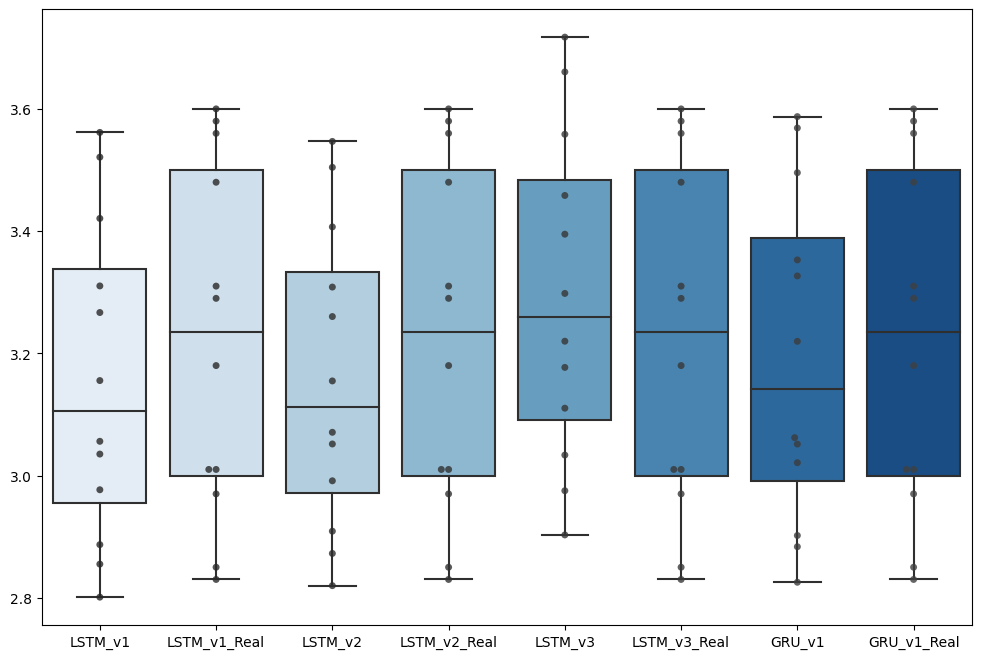

In [12]:
box_swarm_plots(aval)

#### Gráfico Linhas Real x Previsto
Figura com valor real x previsto dos últimos 12 meses da série

In [13]:
def plot_aval(aval):
  min_val, max_val = aval.min().min(), aval.max().max()
  fig, ax = plt.subplots(figsize=(30, 12), nrows=1, ncols=len(best_models_df))
  i = 0
  for model_str in best_models_df['model_type']:
    filt = aval.filter(regex=model_str)
    sns.lineplot(data=filt, palette='inferno', ax=ax[i], hue_order=filt.columns)
    ax[i].set_xlabel('Meses')
    ax[i].set_title(model_str)
    ax[i].set_ylim(min_val, max_val)
    i += 1


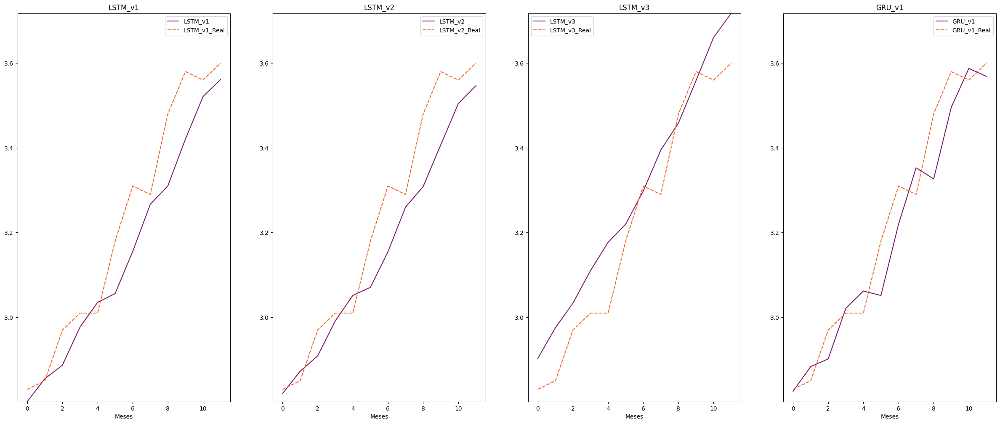

In [14]:
plot_aval(aval)

### Avaliação últimos 12 meses - usando dados previstos iterativamente
Aqui construímos novamente os dados de predição, também usados no Boxplot e Swarmplot

Mas desta vez usamos a técnica de prever no futuro, adicionando os dados previstos ao final da série e repetimos o processo 12 vezes. Este passo é necessário para identificar se o processo de prever o fututo está consistente. Ainda estamos comparando com a base de testes

Usou-se ruído nas saídas para simular curvas mais realísticas. A análise empírica deste método revelou predições superiores.

---



In [15]:
aval_pre_fut = pd.DataFrame()

future_size = 12
sharpness = 0.2
for index, setup in best_models_df.iterrows():

  mod = setup['model']
  scaler, X_train, X_test, y_train, y_test = preprocess(df, 'valor', timesteps, future_size)

  initial_sequence = X_test[0]

  # Predict future values iteratively
  predicted_values = []
  for _ in range(future_size):
    # Predict the next step
    next_step = mod.predict(np.array([initial_sequence]), verbose=False)
    # add randomization to model do not converge as a curve
    if sharpness is not None:
      next_step[0, 0] = next_step[0, 0] + next_step[0, 0]*uniform(-sharpness, sharpness)
    # Append the predicted value
    predicted_values.append(next_step[0, 0])
    # Update the initial sequence by removing the oldest value and appending the predicted value
    initial_sequence = np.roll(initial_sequence, shift=-1, axis=0)
    initial_sequence[-1] = next_step[0, 0]


  y_pred = scaler.inverse_transform(np.array(predicted_values).reshape(-1, 1))
  y_real = scaler.inverse_transform(y_test)
  aval_pre_fut[f'{setup["model_type"]}'] = y_pred[:,0]
  aval_pre_fut[f'{setup["model_type"]}_Real'] = y_real[:,0]


#### Boxplot e Swarmplot

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:.25'` for same effect.
  warnings.warn(msg, FutureWarning)


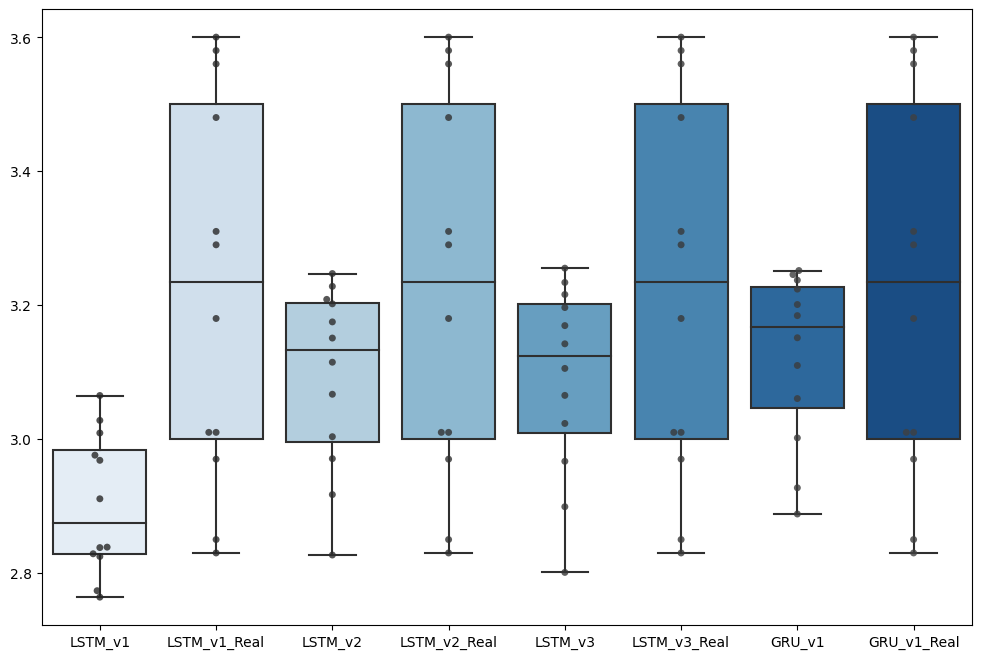

In [16]:
box_swarm_plots(aval_pre_fut)

#### Gráfico Linhas Real x Previsto
Figura com valor real x previsto (iterativo) dos últimos 12 meses da série

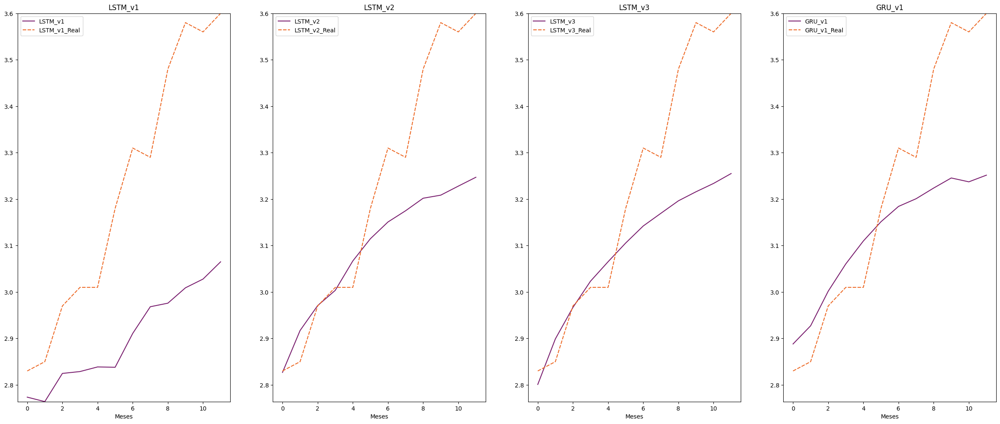

In [17]:
plot_aval(aval_pre_fut)

# Resultados

## Avaliação dos 12 meses futuros
Aqui construímos novamente os dados de predição, também usados no Boxplot e Swarmplot

Desta vez, o treinamento do modelo é refeito com todos os dados. Mais uma vez, usamos a técnica de prever no futuro, adicionando os dados previstos ao final da série e repetimos o processo 12 vezes.


---



Treinando com LSTM_v1, unit=64, opt=Adam,     timesteps=12, batch=4


'TRAINING set. Loss = 0.03707951679825783 , MAE = 0.14493295550346375'

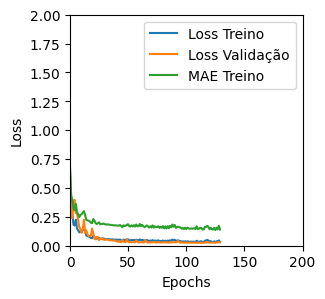

Treinando com LSTM_v2, unit=64, opt=Adam,     timesteps=12, batch=4


'TRAINING set. Loss = 0.03930053487420082 , MAE = 0.14619559049606323'

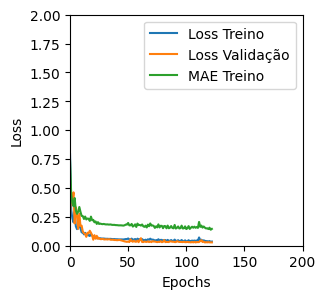

Treinando com LSTM_v3, unit=64, opt=Adam,     timesteps=36, batch=8


'TRAINING set. Loss = 0.10942091792821884 , MAE = 0.2365473508834839'

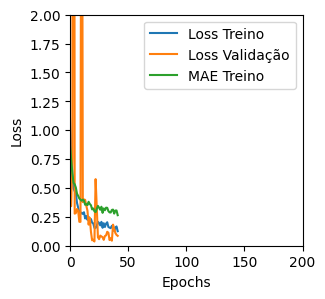

Treinando com GRU_v1, unit=8, opt=Adam,     timesteps=36, batch=4


'TRAINING set. Loss = 0.04764280095696449 , MAE = 0.16970930993556976'

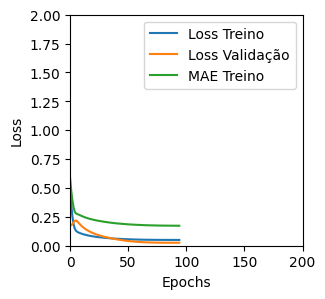

In [18]:
aval_fut = pd.DataFrame()

future_size = 12
sharpness = 0.2
for index, setup in best_models_df.iterrows():

  mod = setup['model']
  print(f'Treinando com {setup["model_type"]}, unit={setup["unit"]}, opt={setup["optimizer"]}, \
    timesteps={setup["timesteps"]}, batch={setup["batch_size"]}')
  scaler, X_train, X_test, y_train, y_test = preprocess(df, 'valor', setup['timesteps'], 0)
  mod, _ = model_type(setup['model_type'], setup['unit'], setup['optimizer'], setup['timesteps'], X_train, y_train,
                      epochs=epochs, batch_size=setup['batch_size'], train=True)

  # using last train element
  initial_sequence = X_train[-1]

  # Predict future values iteratively
  predicted_values = []
  for _ in range(future_size):
    # Predict the next step
    next_step = mod.predict(np.array([initial_sequence]), verbose=False)
    # add randomization to model do not converge as a curve
    if sharpness is not None:
      next_step[0, 0] = next_step[0, 0] + next_step[0, 0]*uniform(-sharpness, sharpness)
    # Append the predicted value
    predicted_values.append(next_step[0, 0])
    # Update the initial sequence by removing the oldest value and appending the predicted value
    initial_sequence = np.roll(initial_sequence, shift=-1, axis=0)
    initial_sequence[-1] = next_step[0, 0]


  y_pred = scaler.inverse_transform(np.array(predicted_values).reshape(-1, 1))
  aval_fut[f'{setup["model_type"]}'] = y_pred[:,0]


### Boxplot e Swarmplot

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:.25'` for same effect.
  warnings.warn(msg, FutureWarning)


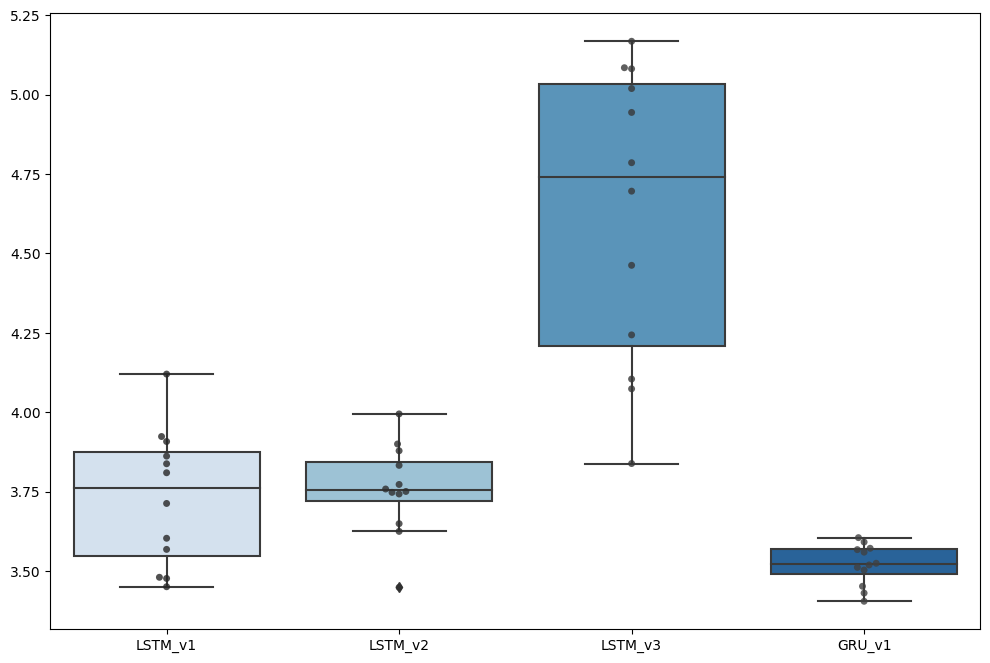

In [19]:
box_swarm_plots(aval_fut)

### Gráfico Linhas Real x Previsto
Figura com valor real x previsto (iterativo) dos últimos 12 meses da série

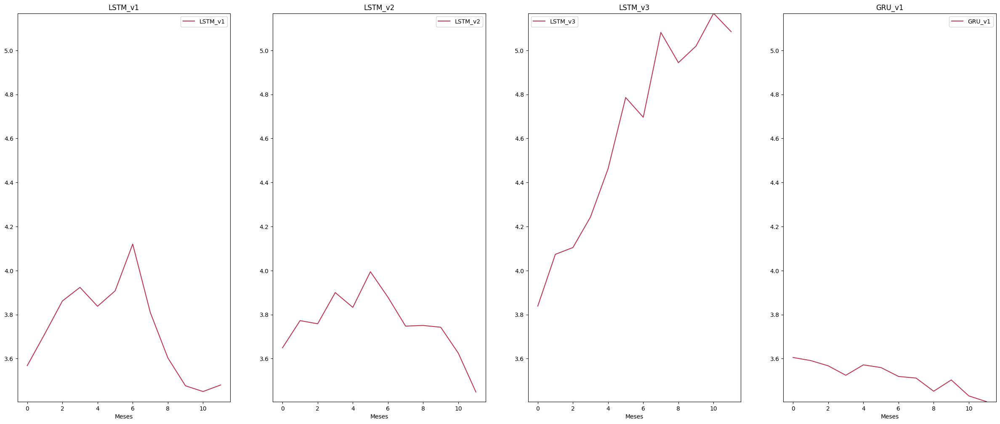

In [20]:
plot_aval(aval_fut)

# Conclusão



# REFERÊNCIAS

[1] -  https://repositorio.utfpr.edu.br/jspui/bitstream/1/19605/1/CT_GESFIN_I_2016_07.pdf

[2] - https://repositorio.ufscar.br/bitstream/handle/ufscar/13730/Trabalho_de_Conclusao_de_Curso_Lucas_Vasco.pdf?sequence=2&isAllowed=y

[3] - https://towardsdatascience.com/lstm-framework-for-univariate-time-series-prediction-d9e7252699e

[4] - https://www.datarobot.com/blog/how-much-data-is-needed-to-train-a-good-model/#:~:text=the%20time%20series.-,For%20most%20time%20series%20applications%2C%20this%20means%20that%20the%20submitted,of%20the%20maximum%20expected%20seasonality.&text=For%20example%2C%20if%20you%20have,to%20train%20a%20successful%20model.
